In [1]:
# Install a pip package in the current Jupyter kernel
import sys
#!{sys.executable} -m pip install mne-connectivity

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
import os
import gc
import pyarrow
import openpyxl
from glob import glob
import numpy as np
import scipy as sp
import sklearn
import statistics, math
import random as rd
import pandas as pd
import dataframe_image as dfi
pd.options.display.float_format = '{:,.2f}'.format

from math import sqrt, ceil

from sklearn import metrics, svm
from sklearn import decomposition, cluster
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import (classification_report, confusion_matrix, accuracy_score, f1_score, roc_auc_score, 
                             balanced_accuracy_score, precision_score, recall_score, RocCurveDisplay)
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.linear_model import LinearRegression, LogisticRegression, LogisticRegressionCV
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier

from scipy.spatial.distance import correlation
from IPython.display import display

In [4]:
import mne
#import mne_connectivity

from mne.preprocessing import (ICA, create_eog_epochs, create_ecg_epochs, corrmap, annotate_muscle_zscore, 
                               find_eog_events, find_ecg_events, ica_find_ecg_events, find_bad_channels_maxwell)
from mne.time_frequency import (tfr_morlet, tfr_multitaper, psd_multitaper, psd_welch, psd_array_multitaper, 
                                csd_array_fourier, csd_array_multitaper, csd_array_morlet)

from mne_connectivity import seed_target_indices, spectral_connectivity_epochs, spectral_connectivity_time

print(mne.__file__)
print(mne.__version__)

C:\Users\Lenovo\anaconda3\lib\site-packages\mne\__init__.py
0.23.4


In [5]:
import plotly.graph_objects as go
from gtda.time_series import SingleTakensEmbedding, TakensEmbedding, takens_embedding_optimal_parameters
from gtda.homology import VietorisRipsPersistence
from gtda.diagrams import BettiCurve, Scaler, Filtering, Amplitude, PersistenceEntropy, NumberOfPoints
from gtda.plotting import plot_point_cloud


In [6]:
# Configure the graphics engine

import matplotlib.pyplot as plt
plt.rc('figure', max_open_warning=200)
%matplotlib notebook
#%matplotlib inline
#%matplotlib qt

In [7]:
import seaborn as sns
# Apply the default theme
sns.set_theme()

In [8]:
# My modules

import my_varexplore as ve
import my_dimreduct as dr
import my_clustquality as cq
import my_stageprocess as spr


# Global variables

In [9]:
# Data destination paths

print(os.getcwd())
ft_root_path = os.getcwd()+'\\features\\m10\\'


C:\Users\Lenovo\PycharmProjects\Tibet


In [10]:
# Frequency bands

bands = [(0.9, 4, 'Delta (0.9-4 Hz)', 'D'), (4, 8, 'Theta (4-8 Hz)', 'T'), (8, 14, 'Alpha (8-14 Hz)', 'A'), 
         (14, 25, 'Beta (14-25 Hz)', 'B'), (25, 40, 'Gamma (25-40 Hz)', 'G')]

bands_test = [(0.9, 4, 'Delta (0.9-4 Hz)', 'D'), (4, 7, 'Theta (4-7 Hz)', 'T'), (7, 10, 'Alpha1 (7-10 Hz)','A1'), 
         (10, 13, 'Alpha2 (10-13 Hz)', 'A2'), (13, 20, 'Beta1 (13-20 Hz)', 'B1'), (20, 30, 'Beta2 (20-30 Hz)', 'B2'), 
         (30, 45, 'Gamma (30-45 Hz)', 'G')]

str_freq = [bands[i][3] for i in range(len(bands))]
#str_freq_rr = ['r'+_str for _str in str_freq]
str_freq_rr = str_freq
n_freq = len(str_freq_rr)


In [11]:
# Localization by scalp regions

regions = [(['Fp1','Fp2','Fpz'], 'Fp', 'Pre-frontal'), (['F7','F3','FT7','FC3'], 'LF', 'Left Frontal'), 
           (['Fz','FCz'], 'MF', 'Midline Frontal'), (['F4','F8','FC4','FT8'], 'RF', 'Right Frontal'),
           (['T3','TP7','T5'], 'LT', 'Left Temporal'), (['T4','TP8','T6'], 'RT', 'Right Temporal'), 
           (['C3','CP3'], 'LC', 'Left Central'), (['Cz','CPz'], 'MC', 'Midline Central'), (['C4','CP4'], 'RC', 'Right Central'),
           (['P3','P5'], 'LP', 'Left Parietal'), (['Pz'], 'MP', 'Midline Parietal'), (['P4','P6'], 'RP', 'Right Parietal'), 
           (['PO3','PO7','O1'], 'LO', 'Left Occipital'), (['POz','Oz'], 'MO', 'Midline Occipital'), 
           (['PO4','PO8','O2'], 'RO', 'Right Occipital')]
regions_plt = [(['Fp1','Fp2','Fpz'], 'Fp', 'Pre-frontal'), (['F7','F3','FT7','FC3'], 'LF', 'Left Frontal'), 
           (['Fz','FCz'], 'MF', 'Midline Frontal'), (['F4','F8','FC4','FT8'], 'RF', 'Right Frontal'),
           (['T3','TP7','T5'], 'LT', 'Left Temporal'), (['T4','TP8','T6'], 'RT', 'Right Temporal'), 
           (['C3','CP3','Cz','CPz','C4','CP4'], 'Cen', 'Central'), (['P3','P5','Pz','P4','P6'], 'Par', 'Parietal'), 
           (['PO3','PO7','O1','POz','Oz','PO4','PO8','O2'], 'Occ', 'Occipital')]

n_regions = len(regions)
n_regions_plt = len(regions_plt)



# Loading data

In [12]:
# Loading epochs

#epochs_filt_rr.save(os.path.join(ft_root_path, 'epochs_filt_rr-epo.fif'), overwrite=True)
epochs_filt_rr = mne.read_epochs(os.path.join(ft_root_path, 'epochs_filt_rr-epo.fif'))
print(epochs_filt_rr.get_data().shape)

sampling_rate = epochs_filt_rr.info['sfreq']
n_samples = epochs_filt_rr.__len__()
n_times = len(epochs_filt_rr.get_data()[0,0,:])

ch_names = epochs_filt_rr.ch_names
n_channels = len(ch_names)
print(ch_names)

Reading C:\Users\Lenovo\PycharmProjects\Tibet\features\m10\epochs_filt_rr-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...     500.00 ms
        0 CTF compensation matrices available
Not setting metadata
Not setting metadata
1046 matching events found
No baseline correction applied
0 projection items activated
(1046, 40, 501)
['Fp1', 'Fpz', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'FT7', 'FC3', 'FCz', 'FC4', 'FT8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'TP7', 'CP3', 'CPz', 'CP4', 'TP8', 'A1', 'T5', 'P3', 'Pz', 'P4', 'T6', 'A2', 'P5', 'PO3', 'POz', 'PO4', 'P6', 'PO7', 'O1', 'Oz', 'O2', 'PO8']


In [13]:
# Loading main features DataFrames

df_ft_psd_loc_db = pd.read_feather(os.path.join(ft_root_path, 'df_ft_psd_loc_db.feather'))
df_ft_psd_plt_db = pd.read_feather(os.path.join(ft_root_path, 'df_ft_psd_plt_db.feather'))
df_ft_psd_all_db = pd.read_feather(os.path.join(ft_root_path, 'df_ft_psd_all_db.feather'))
df_ft_psd_ind_log = pd.read_feather(os.path.join(ft_root_path, 'df_ft_psd_ind_log.feather'))
df_ft_psd_ind_plt_log = pd.read_feather(os.path.join(ft_root_path, 'df_ft_psd_ind_plt_log.feather'))

#df_ft_coh = pd.read_feather(os.path.join(ft_root_path, 'df_ft_coh.feather'))
#df_ft_plv = pd.read_feather(os.path.join(ft_root_path, 'df_ft_plv.feather'))
df_ft_coh_loc = pd.read_feather(os.path.join(ft_root_path, 'df_ft_coh_loc.feather'))
df_ft_plv_loc = pd.read_feather(os.path.join(ft_root_path, 'df_ft_plv_loc.feather'))
df_ft_coh_plt = pd.read_feather(os.path.join(ft_root_path, 'df_ft_coh_plt.feather'))
df_ft_plv_plt = pd.read_feather(os.path.join(ft_root_path, 'df_ft_plv_plt.feather'))

df_ft_coh_ind_loc = pd.read_feather(os.path.join(ft_root_path, 'df_ft_coh_ind_loc.feather'))
df_ft_plv_ind_loc = pd.read_feather(os.path.join(ft_root_path, 'df_ft_plv_ind_loc.feather'))
df_ft_coh_ind_plt = pd.read_feather(os.path.join(ft_root_path, 'df_ft_coh_ind_plt.feather'))
df_ft_plv_ind_plt = pd.read_feather(os.path.join(ft_root_path, 'df_ft_plv_ind_plt.feather'))
df_ft_coh_ind_all = pd.read_feather(os.path.join(ft_root_path, 'df_ft_coh_ind_all.feather'))
df_ft_plv_ind_all = pd.read_feather(os.path.join(ft_root_path, 'df_ft_plv_ind_all.feather'))

In [14]:
# Scaling features data

# PSD & PSD indices
ft_psd_loc_db_sc = StandardScaler().fit_transform(df_ft_psd_loc_db.to_numpy())
df_ft_psd_loc_db_sc = pd.DataFrame(ft_psd_loc_db_sc, columns=df_ft_psd_loc_db.columns)
ft_psd_all_db_sc = StandardScaler().fit_transform(df_ft_psd_all_db.to_numpy())
df_ft_psd_all_db_sc = pd.DataFrame(ft_psd_all_db_sc, columns=df_ft_psd_all_db.columns)

ft_psd_ind_log_sc = StandardScaler().fit_transform(df_ft_psd_ind_log.to_numpy())
df_ft_psd_ind_log_sc = pd.DataFrame(ft_psd_ind_log_sc, columns=df_ft_psd_ind_log.columns)

# Coherence indices
ft_coh_ind_loc_sc = StandardScaler().fit_transform(df_ft_coh_ind_loc.to_numpy())
df_ft_coh_ind_loc_sc = pd.DataFrame(ft_coh_ind_loc_sc, columns=df_ft_coh_ind_loc.columns)

# PLV indices
ft_plv_ind_loc_sc = StandardScaler().fit_transform(df_ft_plv_ind_loc.to_numpy())
df_ft_plv_ind_loc_sc = pd.DataFrame(ft_plv_ind_loc_sc, columns=df_ft_plv_ind_loc.columns)


In [15]:
# Load clusterization results

# Clusterization
#df_st_edges.to_feather(os.path.join(ft_root_path, 'df_st_edges.feather'))
df_st_edges = pd.read_feather(os.path.join(ft_root_path, 'df_st_edges.feather'))
#df_stage_metrics.to_feather(os.path.join(ft_root_path, 'df_stage_metrics.feather'))
df_stage_metrics = pd.read_feather(os.path.join(ft_root_path, 'df_stage_metrics.feather'))

#np.savetxt(os.path.join(ft_root_path, 'st_edges_median.txt'), st_edges_median)
st_edges_median = np.loadtxt(os.path.join(ft_root_path, 'st_edges_median.txt'), dtype=int)

print(st_edges_median)

[   0  128  265  490  560  682  784  857  976 1046]


<IPython.core.display.Javascript object>


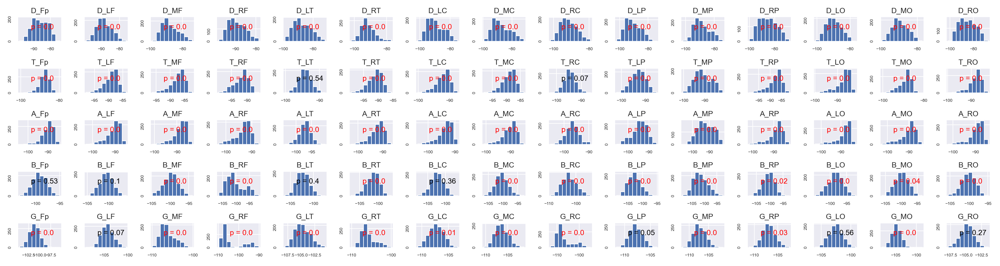

<IPython.core.display.Javascript object>


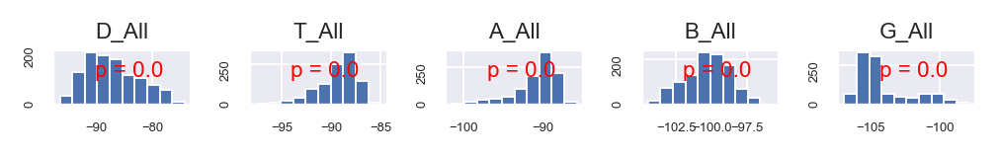

In [16]:
# PSD distribution

hist = ve.plot_ft_distr_hist(df_ft_psd_loc_db, row_length=15)
hist = ve.plot_ft_distr_hist(df_ft_psd_all_db)

<IPython.core.display.Javascript object>


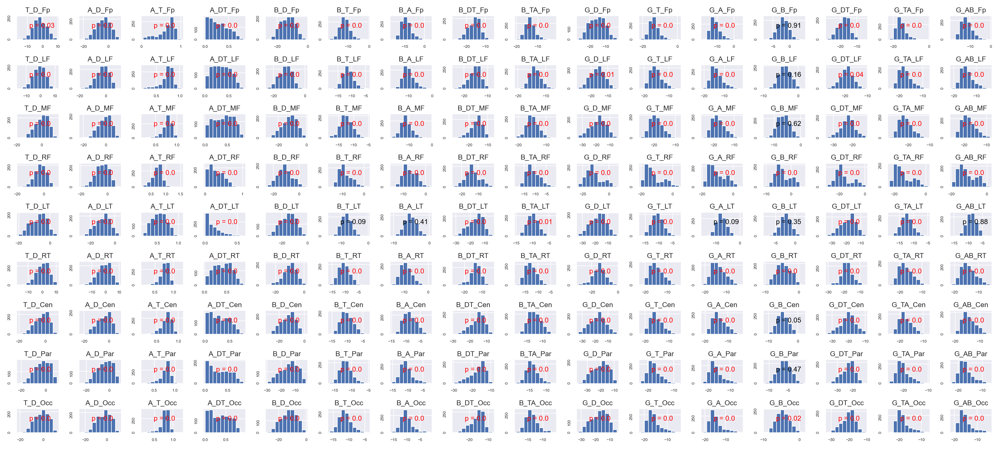

In [17]:
# Plotting PSD Indices histograms

#hist = ve.plot_ft_distr_hist(df_ft_psd_ind_log, row_length=16)
hist = ve.plot_ft_distr_hist(df_ft_psd_ind_plt_log, row_length=16)


<IPython.core.display.Javascript object>


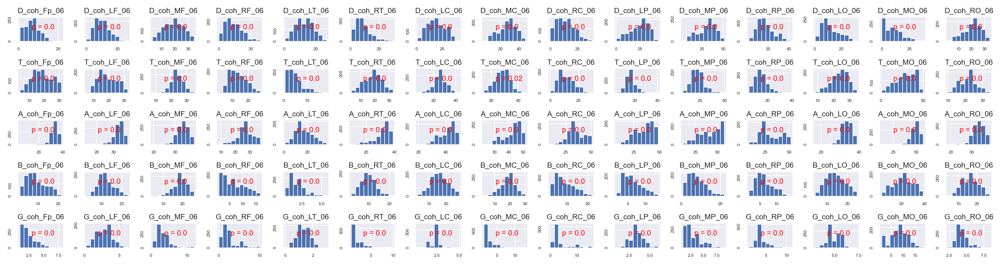

<IPython.core.display.Javascript object>


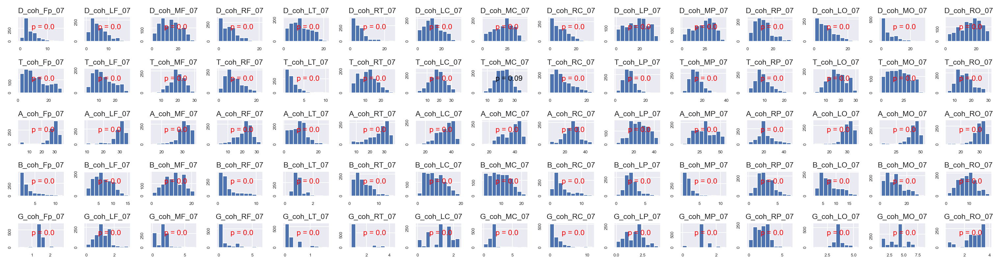

<IPython.core.display.Javascript object>


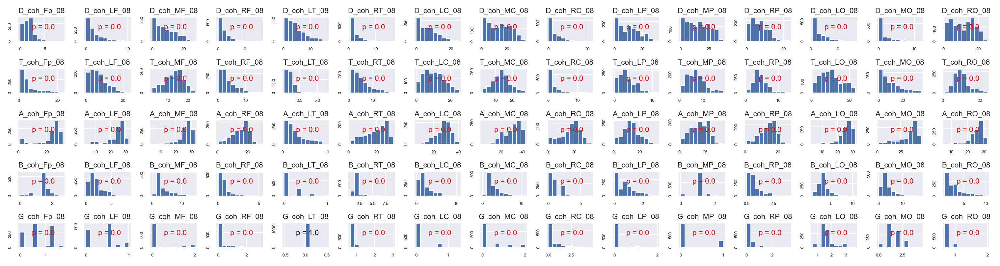

<IPython.core.display.Javascript object>


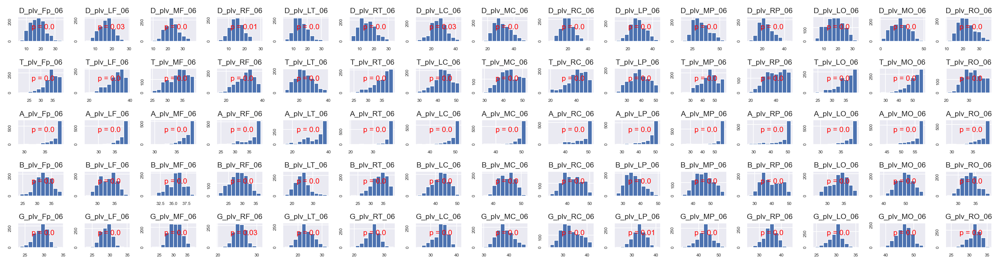

<IPython.core.display.Javascript object>


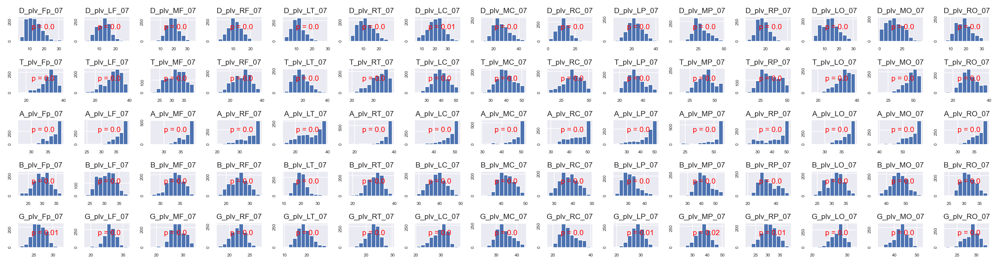

<IPython.core.display.Javascript object>


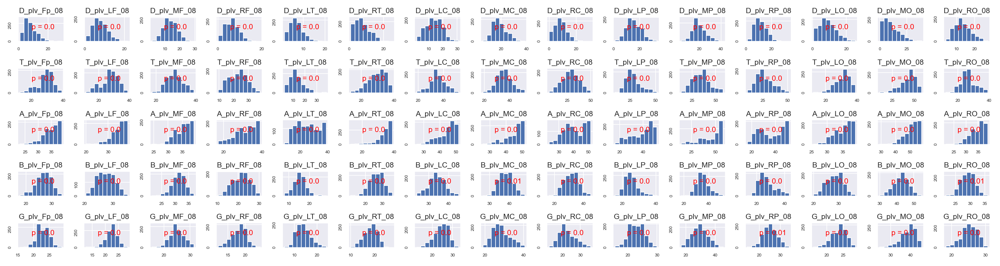

In [16]:
# Forming coherence & PLV index DataFrames

# Coherence
df_cols = [col for col in df_ft_coh_ind_loc.columns if ('06' in col)]
df_ft_coh_06_loc = df_ft_coh_ind_loc[df_cols]
df_cols = [col for col in df_ft_coh_ind_loc.columns if ('07' in col)]
df_ft_coh_07_loc = df_ft_coh_ind_loc[df_cols]
df_cols = [col for col in df_ft_coh_ind_loc.columns if ('08' in col)]
df_ft_coh_08_loc = df_ft_coh_ind_loc[df_cols]

# PLV
df_cols = [col for col in df_ft_plv_ind_loc.columns if ('06' in col)]
df_ft_plv_06_loc = df_ft_plv_ind_loc[df_cols]
df_cols = [col for col in df_ft_plv_ind_loc.columns if ('07' in col)]
df_ft_plv_07_loc = df_ft_plv_ind_loc[df_cols]
df_cols = [col for col in df_ft_plv_ind_loc.columns if ('08' in col)]
df_ft_plv_08_loc = df_ft_plv_ind_loc[df_cols]


# Distribution histograms for coherence & PLV indices

# Coherence
hist = ve.plot_ft_distr_hist(df_ft_coh_06_loc, row_length=15)
hist = ve.plot_ft_distr_hist(df_ft_coh_07_loc, row_length=15)
hist = ve.plot_ft_distr_hist(df_ft_coh_08_loc, row_length=15)

# PLV
hist = ve.plot_ft_distr_hist(df_ft_plv_06_loc, row_length=15)
hist = ve.plot_ft_distr_hist(df_ft_plv_07_loc, row_length=15)
hist = ve.plot_ft_distr_hist(df_ft_plv_08_loc, row_length=15)


# Clusterization functions

In [16]:
# Функция для расчёта оценок качетва кластеризации
def cluster_metrics_noground(name, data, labels_pred):
    results = [name]
    df_data = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])

    # Define the metrics which require only data and predicted labels
    cluster_metrics = [
        metrics.silhouette_score,
        metrics.calinski_harabasz_score,
        metrics.davies_bouldin_score
    ]
    results += [m(data, labels_pred) for m in cluster_metrics]

    df_data.loc[0] = results
    
    return df_data

In [17]:
# Функция для расчёта оценок качества кластеризации
def cluster_metrics_ground(name, data, labels_pred, labels_true):
    results = [name]
    df_data = pd.DataFrame(columns=['Method', 'Homo', 'Compl', 'V-meas' 'ARI', 'AMI'])
    
    # Define the metrics which require data, true labels and predicted labels
    cluster_metrics_with_ground = [
        metrics.homogeneity_score,
        metrics.completeness_score,
        metrics.v_measure_score,
        metrics.adjusted_rand_score,
        metrics.adjusted_mutual_info_score,
    ]
    results += [m(labels_true, labels_pred) for m in cluster_metrics_with_ground] 
    
    df_data.loc[0] = results

    return df_data

In [18]:
def apply_cluster_method(data, cl_method, name, df_metrics, **kwargs):
    method = cl_method(**kwargs).fit(data)
    
    df = cluster_metrics_noground(name, data, method.labels_)
    df_metrics = df_metrics.drop(df_metrics[df_metrics['Method']==name].index, errors='ignore')
    df_metrics = pd.concat([df_metrics, df], ignore_index=True)
    
    return method, df_metrics

In [19]:
# Матрица связности для k соседних по времени эпох
#K_NEIGHBORS = 30

def knn_con_matr(X):
    n_samples = len(X)
    sm = sp.sparse.lil_matrix((n_samples, n_samples), dtype=np.int8)
    for i in range(n_samples):
        for j in range(n_samples):
            if abs(i-j)<=k_neighbours: sm[i,j]=1
    return sm.tocsr()


## Clustering process

In [20]:
display(df_ft_psd_loc_db_sc.describe())
display(df_ft_psd_ind_log_sc.describe())
display(df_ft_coh_ind_loc_sc.describe())
display(df_ft_plv_ind_loc_sc.describe())

,D_Fp,D_LF,D_MF,D_RF,D_LT,D_RT,D_LC,D_MC,D_RC,D_LP,...,G_RT,G_LC,G_MC,G_RC,G_LP,G_MP,G_RP,G_LO,G_MO,G_RO
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,0.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,...,-0.00,0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-2.67,-2.51,-2.19,-2.16,-1.98,-2.34,-2.18,-2.02,-2.30,-2.17,...,-2.25,-2.61,-2.67,-1.65,-2.94,-2.62,-3.02,-2.97,-2.95,-2.84
25%,-0.79,-0.74,-0.76,-0.79,-0.78,-0.70,-0.79,-0.80,-0.77,-0.79,...,-0.71,-0.70,-0.72,-0.68,-0.70,-0.69,-0.67,-0.65,-0.66,-0.64
50%,-0.05,-0.08,-0.19,-0.14,-0.15,-0.18,-0.16,-0.19,-0.11,-0.15,...,-0.27,-0.00,-0.04,-0.39,-0.05,-0.07,-0.04,0.01,-0.05,0.01
75%,0.80,0.71,0.72,0.77,0.75,0.57,0.76,0.77,0.74,0.74,...,0.48,0.72,0.66,0.49,0.69,0.67,0.63,0.66,0.63,0.63
max,2.53,2.99,2.75,2.57,2.63,3.28,2.69,2.58,2.69,3.10,...,3.16,2.93,3.31,3.16,3.15,3.62,3.11,2.94,4.98,3.17


,T_D_All,A_D_All,A_T_All,A_DT_All,B_D_All,B_T_All,B_A_All,B_DT_All,B_TA_All,G_D_All,...,B_A_RO,B_DT_RO,B_TA_RO,G_D_RO,G_T_RO,G_A_RO,G_B_RO,G_DT_RO,G_TA_RO,G_AB_RO
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,-0.00,...,0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-3.55,-3.43,-4.01,-1.57,-2.63,-2.88,-2.67,-3.10,-2.93,-2.35,...,-2.50,-3.19,-2.67,-2.51,-1.91,-1.82,-3.01,-3.02,-1.88,-1.88
25%,-0.71,-0.75,-0.29,-0.92,-0.70,-0.65,-0.66,-0.60,-0.65,-0.68,...,-0.65,-0.72,-0.65,-0.79,-0.73,-0.70,-0.68,-0.70,-0.74,-0.71
50%,0.13,0.13,0.23,-0.06,0.10,-0.07,-0.14,0.20,-0.08,0.01,...,-0.12,0.20,-0.06,0.03,-0.15,-0.18,-0.04,0.18,-0.17,-0.17
75%,0.76,0.78,0.63,0.84,0.76,0.56,0.49,0.74,0.55,0.65,...,0.49,0.77,0.56,0.83,0.50,0.42,0.65,0.76,0.48,0.44
max,2.19,2.08,2.30,2.46,2.33,3.34,3.56,2.24,3.47,2.71,...,3.93,2.04,3.71,2.28,4.16,4.13,3.05,2.37,4.21,3.98


,D_coh_Fp_06,D_coh_Fp_07,D_coh_Fp_08,D_coh_LF_06,D_coh_LF_07,D_coh_LF_08,D_coh_MF_06,D_coh_MF_07,D_coh_MF_08,D_coh_RF_06,...,G_coh_RP_08,G_coh_LO_06,G_coh_LO_07,G_coh_LO_08,G_coh_MO_06,G_coh_MO_07,G_coh_MO_08,G_coh_RO_06,G_coh_RO_07,G_coh_RO_08
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,-0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,...,0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,-0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-1.76,-1.58,-1.31,-2.04,-1.52,-1.05,-2.17,-1.70,-1.23,-1.72,...,-0.57,-3.57,-3.37,-1.53,-1.95,-1.62,-1.67,-3.04,-2.27,-0.45
25%,-0.80,-0.75,-0.56,-0.76,-0.83,-0.73,-0.80,-0.83,-0.89,-0.79,...,-0.57,-0.86,-0.40,-0.60,-0.58,-0.57,-0.66,-0.58,-0.37,-0.45
50%,-0.06,-0.23,-0.19,-0.11,-0.14,-0.33,0.02,-0.09,-0.28,-0.19,...,-0.57,-0.09,0.09,-0.14,0.04,0.22,-0.15,-0.03,0.01,-0.45
75%,0.60,0.49,0.38,0.64,0.60,0.48,0.83,0.83,0.68,0.65,...,0.74,0.69,0.58,0.32,0.66,0.74,0.36,0.52,0.77,0.53
max,3.33,3.81,4.69,3.28,3.55,4.59,2.27,2.50,2.88,3.74,...,7.27,4.95,3.05,3.11,2.90,6.25,2.89,3.53,2.29,5.46


,D_plv_Fp_06,D_plv_Fp_07,D_plv_Fp_08,D_plv_LF_06,D_plv_LF_07,D_plv_LF_08,D_plv_MF_06,D_plv_MF_07,D_plv_MF_08,D_plv_RF_06,...,G_plv_RP_08,G_plv_LO_06,G_plv_LO_07,G_plv_LO_08,G_plv_MO_06,G_plv_MO_07,G_plv_MO_08,G_plv_RO_06,G_plv_RO_07,G_plv_RO_08
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,...,-0.00,-0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,-0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-2.84,-2.41,-2.04,-2.49,-2.53,-2.25,-2.80,-2.75,-2.74,-2.45,...,-4.00,-3.19,-4.05,-3.36,-3.83,-4.04,-5.21,-4.39,-4.83,-4.78
25%,-0.70,-0.73,-0.74,-0.68,-0.73,-0.74,-0.64,-0.71,-0.68,-0.71,...,-0.61,-0.72,-0.60,-0.69,-0.56,-0.61,-0.48,-0.60,-0.60,-0.62
50%,-0.05,-0.10,-0.09,-0.02,-0.07,-0.07,-0.08,-0.06,-0.03,-0.00,...,-0.02,-0.06,-0.02,-0.02,-0.04,0.14,0.09,0.06,0.11,0.14
75%,0.66,0.59,0.56,0.69,0.69,0.66,0.67,0.59,0.63,0.65,...,0.66,0.60,0.70,0.65,0.65,0.73,0.67,0.72,0.67,0.64
max,2.79,3.13,3.45,3.37,3.15,3.52,2.55,3.27,3.62,4.13,...,3.37,2.74,3.14,3.18,3.23,2.52,2.33,2.86,2.79,3.42


In [21]:
# PCA decomposition

#df_ft_tot_loc_ind_sc = pd.concat([df_ft_psd_loc_db_sc, df_ft_psd_ind_log_sc, df_ft_psd_loc_stats], axis=1)
#df_ft_tot_orig = pd.concat([df_ft_psd_loc_db_sc, df_ft_psd_ind_log_sc, df_ft_coh_06_loc_sc, df_ft_plv_07_loc_sc], axis=1)
df_ft_tot_orig = pd.concat([df_ft_psd_loc_db_sc, df_ft_psd_ind_log_sc, df_ft_coh_ind_loc_sc, df_ft_plv_ind_loc_sc], axis=1)
n_features = len(df_ft_tot_orig.columns)

pca = decomposition.PCA(n_components=0.7)
ft_tot_pca = pca.fit_transform(df_ft_tot_orig)
print(ft_tot_pca.shape)

n_pca_comps = len(ft_tot_pca[0,:])
pca_comp_names = ['PCA_'+str(i) for i in range(n_pca_comps)]
#print(n_pca_comps)
print(n_features)
print(n_samples)

df_ft_tot_pca = pd.DataFrame()
df_ft_tot_pca = pd.DataFrame(ft_tot_pca, columns=pca_comp_names)


(1046, 14)
781
1046


In [35]:
# Iterative automatic process of finding best clusterisation 

# Global variables
k_neighb_min = 20
k_neighb_max = 50
n_cl_min = 2
n_cl_max = 20

#n_stages = 8
st_dist_rate = 0.3
stage_length_threshold = 60

# Initialization
df_features = df_ft_tot_pca
print(len(df_features.columns))

df_best_metrics = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])
df_st_edges = pd.DataFrame(columns=['Len_min', 'N_clusters', 'K_neighb', 'Silh', 'St_edges'])

for n_clusters in range(n_cl_min, n_cl_max+1):
    for k_neighbours in range(k_neighb_min, k_neighb_max+1):
        # Clustering, Ward method        
        cl_name = 'ward_pca_'+str(n_clusters)+'_'+str(k_neighbours)
        cl_method, df_best_metrics = apply_cluster_method(data=df_features, cl_method=AgglomerativeClustering, 
                                                          name=cl_name, df_metrics=df_best_metrics, n_clusters=n_clusters, 
                                                          linkage='ward', connectivity=knn_con_matr)
        # Forming stages from clusters
        st_edges = spr.form_stages(cl_method.labels_)
        
        # Merging stages
        for st_len_min in range(0, stage_length_threshold+1, 20):
            st_edges = spr.merge_stages_1st_step(df_features, st_edges, len_threshold=st_len_min) 
            st_edges = spr.merge_stages_2nd_step(df_features, st_edges, dist_threshold=st_dist_rate) 
            # Insert clusterization results into DataFrame
            silh_metric = df_best_metrics[df_best_metrics['Method']==cl_name].iloc[0]['Silh']
            new_row = {'Len_min': st_len_min, 'N_clusters': n_clusters, 'K_neighb': k_neighbours, 
                                       'Silh': silh_metric, 'St_edges': st_edges}
            df_st_edges = df_st_edges.append(new_row, ignore_index = True)
            # Print results
            st_lengths = np.array([st_edges[i+1] - st_edges[i] for i in range(len(st_edges)-1)])
            print(st_len_min, n_clusters, k_neighbours, len(st_lengths), st_edges, st_lengths)

display(df_best_metrics)
display(df_st_edges)

14
0 2 20 3 [   0  237  282 1046] [237  45 764]
20 2 20 3 [   0  237  282 1046] [237  45 764]
40 2 20 3 [   0  237  282 1046] [237  45 764]
60 2 20 2 [   0  237 1046] [237 809]
0 2 21 3 [   0  237  282 1046] [237  45 764]
20 2 21 3 [   0  237  282 1046] [237  45 764]
40 2 21 3 [   0  237  282 1046] [237  45 764]
60 2 21 2 [   0  237 1046] [237 809]
0 2 22 3 [   0  237  282 1046] [237  45 764]
20 2 22 3 [   0  237  282 1046] [237  45 764]
40 2 22 3 [   0  237  282 1046] [237  45 764]
60 2 22 2 [   0  237 1046] [237 809]
0 2 23 3 [   0  235  282 1046] [235  47 764]
20 2 23 3 [   0  235  282 1046] [235  47 764]
40 2 23 3 [   0  235  282 1046] [235  47 764]
60 2 23 2 [   0  235 1046] [235 811]
0 2 24 3 [   0  235  282 1046] [235  47 764]
20 2 24 3 [   0  235  282 1046] [235  47 764]
40 2 24 3 [   0  235  282 1046] [235  47 764]
60 2 24 2 [   0  235 1046] [235 811]
0 2 25 3 [   0  235  282 1046] [235  47 764]
20 2 25 3 [   0  235  282 1046] [235  47 764]
40 2 25 3 [   0  235  282 1046] [235

0 3 32 5 [   0  104  282  509  555 1046] [104 178 227  46 491]
20 3 32 5 [   0  104  282  509  555 1046] [104 178 227  46 491]
40 3 32 5 [   0  104  282  509  555 1046] [104 178 227  46 491]
60 3 32 4 [   0  104  282  555 1046] [104 178 273 491]
0 3 33 5 [   0  104  282  560  681 1046] [104 178 278 121 365]
20 3 33 5 [   0  104  282  560  681 1046] [104 178 278 121 365]
40 3 33 5 [   0  104  282  560  681 1046] [104 178 278 121 365]
60 3 33 5 [   0  104  282  560  681 1046] [104 178 278 121 365]
0 3 34 5 [   0   92  156  560  682 1046] [ 92  64 404 122 364]
20 3 34 5 [   0   92  156  560  682 1046] [ 92  64 404 122 364]
40 3 34 5 [   0   92  156  560  682 1046] [ 92  64 404 122 364]
60 3 34 5 [   0   92  156  560  682 1046] [ 92  64 404 122 364]
0 3 35 5 [   0   92  282  560  682 1046] [ 92 190 278 122 364]
20 3 35 5 [   0   92  282  560  682 1046] [ 92 190 278 122 364]
40 3 35 5 [   0   92  282  560  682 1046] [ 92 190 278 122 364]
60 3 35 5 [   0   92  282  560  682 1046] [ 92 190 27

0 4 35 7 [   0   92  282  560  682  857  976 1046] [ 92 190 278 122 175 119  70]
20 4 35 7 [   0   92  282  560  682  857  976 1046] [ 92 190 278 122 175 119  70]
40 4 35 7 [   0   92  282  560  682  857  976 1046] [ 92 190 278 122 175 119  70]
60 4 35 7 [   0   92  282  560  682  857  976 1046] [ 92 190 278 122 175 119  70]
0 4 36 6 [   0  265  560  682  857  976 1046] [265 295 122 175 119  70]
20 4 36 6 [   0  265  560  682  857  976 1046] [265 295 122 175 119  70]
40 4 36 6 [   0  265  560  682  857  976 1046] [265 295 122 175 119  70]
60 4 36 6 [   0  265  560  682  857  976 1046] [265 295 122 175 119  70]
0 4 37 6 [   0  235  560  682  857  976 1046] [235 325 122 175 119  70]
20 4 37 6 [   0  235  560  682  857  976 1046] [235 325 122 175 119  70]
40 4 37 6 [   0  235  560  682  857  976 1046] [235 325 122 175 119  70]
60 4 37 6 [   0  235  560  682  857  976 1046] [235 325 122 175 119  70]
0 4 38 7 [   0  132  282  560  682  857  976 1046] [132 150 278 122 175 119  70]
20 4 38 7 

0 5 33 8 [   0  104  282  490  560  681  857  976 1046] [104 178 208  70 121 176 119  70]
20 5 33 8 [   0  104  282  490  560  681  857  976 1046] [104 178 208  70 121 176 119  70]
40 5 33 8 [   0  104  282  490  560  681  857  976 1046] [104 178 208  70 121 176 119  70]
60 5 33 8 [   0  104  282  490  560  681  857  976 1046] [104 178 208  70 121 176 119  70]
0 5 34 7 [   0   92  156  555  682  857  976 1046] [ 92  64 399 127 175 119  70]
20 5 34 7 [   0   92  156  555  682  857  976 1046] [ 92  64 399 127 175 119  70]
40 5 34 7 [   0   92  156  555  682  857  976 1046] [ 92  64 399 127 175 119  70]
60 5 34 7 [   0   92  156  555  682  857  976 1046] [ 92  64 399 127 175 119  70]
0 5 35 8 [   0   92  268  490  560  682  857  976 1046] [ 92 176 222  70 122 175 119  70]
20 5 35 8 [   0   92  268  490  560  682  857  976 1046] [ 92 176 222  70 122 175 119  70]
40 5 35 8 [   0   92  268  490  560  682  857  976 1046] [ 92 176 222  70 122 175 119  70]
60 5 35 8 [   0   92  268  490  560  6

0 6 28 8 [   0   39  265  509  555  666  682  857 1046] [ 39 226 244  46 111  16 175 189]
20 6 28 6 [   0   39  265  555  682  857 1046] [ 39 226 290 127 175 189]
40 6 28 5 [   0  265  555  682  857 1046] [265 290 127 175 189]
60 6 28 5 [   0  265  555  682  857 1046] [265 290 127 175 189]
0 6 29 8 [   0   95  282  490  555  682  857  971 1046] [ 95 187 208  65 127 175 114  75]
20 6 29 8 [   0   95  282  490  555  682  857  971 1046] [ 95 187 208  65 127 175 114  75]
40 6 29 8 [   0   95  282  490  555  682  857  971 1046] [ 95 187 208  65 127 175 114  75]
60 6 29 8 [   0   95  282  490  555  682  857  971 1046] [ 95 187 208  65 127 175 114  75]
0 6 30 10 [   0  104  359  509  555  666  682  857  917  977 1046] [104 255 150  46 111  16 175  60  60  69]
20 6 30 9 [   0  104  359  509  555  682  857  917  977 1046] [104 255 150  46 127 175  60  60  69]
40 6 30 9 [   0  104  359  509  555  682  857  917  977 1046] [104 255 150  46 127 175  60  60  69]
60 6 30 7 [   0  104  359  555  682  

0 7 22 10 [   0  237  282  490  560  666  682  857  929  977 1046] [237  45 208  70 106  16 175  72  48  69]
20 7 22 7 [   0  237  490  560  682  857  977 1046] [237 253  70 122 175 120  69]
40 7 22 7 [   0  237  490  560  682  857  977 1046] [237 253  70 122 175 120  69]
60 7 22 7 [   0  237  490  560  682  857  977 1046] [237 253  70 122 175 120  69]
0 7 23 10 [   0  235  282  490  560  666  682  857  929  977 1046] [235  47 208  70 106  16 175  72  48  69]
20 7 23 7 [   0  235  490  560  682  857  977 1046] [235 255  70 122 175 120  69]
40 7 23 7 [   0  235  490  560  682  857  977 1046] [235 255  70 122 175 120  69]
60 7 23 7 [   0  235  490  560  682  857  977 1046] [235 255  70 122 175 120  69]
0 7 24 10 [   0  235  265  490  558  666  682  857  929  977 1046] [235  30 225  68 108  16 175  72  48  69]
20 7 24 7 [   0  235  490  558  682  857  977 1046] [235 255  68 124 175 120  69]
40 7 24 7 [   0  235  490  558  682  857  977 1046] [235 255  68 124 175 120  69]
60 7 24 7 [   0  

0 7 45 9 [   0  132  232  492  560  614  681  857 1021 1046] [132 100 260  68  54  67 176 164  25]
20 7 45 9 [   0  132  232  492  560  614  681  857 1021 1046] [132 100 260  68  54  67 176 164  25]
40 7 45 8 [   0  132  232  492  560  614  681  857 1046] [132 100 260  68  54  67 176 189]
60 7 45 7 [   0  132  232  492  560  681  857 1046] [132 100 260  68 121 176 189]
0 7 46 7 [   0   42  245  492  560  681  857 1046] [ 42 203 247  68 121 176 189]
20 7 46 7 [   0   42  245  492  560  681  857 1046] [ 42 203 247  68 121 176 189]
40 7 46 7 [   0   42  245  492  560  681  857 1046] [ 42 203 247  68 121 176 189]
60 7 46 6 [   0  245  492  560  681  857 1046] [245 247  68 121 176 189]
0 7 47 6 [   0   42  245  555  682  857 1046] [ 42 203 310 127 175 189]
20 7 47 6 [   0   42  245  555  682  857 1046] [ 42 203 310 127 175 189]
40 7 47 6 [   0   42  245  555  682  857 1046] [ 42 203 310 127 175 189]
60 7 47 5 [   0  245  555  682  857 1046] [245 310 127 175 189]
0 7 48 7 [   0  132  282  55

0 8 35 8 [   0   92  265  490  560  682  857  976 1046] [ 92 173 225  70 122 175 119  70]
20 8 35 8 [   0   92  265  490  560  682  857  976 1046] [ 92 173 225  70 122 175 119  70]
40 8 35 8 [   0   92  265  490  560  682  857  976 1046] [ 92 173 225  70 122 175 119  70]
60 8 35 8 [   0   92  265  490  560  682  857  976 1046] [ 92 173 225  70 122 175 119  70]
0 8 36 8 [   0   42  265  490  560  682  857  976 1046] [ 42 223 225  70 122 175 119  70]
20 8 36 8 [   0   42  265  490  560  682  857  976 1046] [ 42 223 225  70 122 175 119  70]
40 8 36 8 [   0   42  265  490  560  682  857  976 1046] [ 42 223 225  70 122 175 119  70]
60 8 36 7 [   0  265  490  560  682  857  976 1046] [265 225  70 122 175 119  70]
0 8 37 11 [   0   42  235  282  555  666  682  752  857  913  976 1046] [ 42 193  47 273 111  16  70 105  56  63  70]
20 8 37 10 [   0   42  235  282  555  682  752  857  913  976 1046] [ 42 193  47 273 127  70 105  56  63  70]
40 8 37 10 [   0   42  235  282  555  682  752  857  91

0 9 25 14 [   0   95  206  235  265  490  558  609  645  666  682  784  857  971
 1046] [ 95 111  29  30 225  68  51  36  21  16 102  73 114  75]
20 9 25 13 [   0   95  206  235  265  490  558  609  645  682  784  857  971 1046] [ 95 111  29  30 225  68  51  36  37 102  73 114  75]
40 9 25 11 [   0   95  206  265  490  558  609  682  784  857  971 1046] [ 95 111  59 225  68  51  73 102  73 114  75]
60 9 25 9 [   0   95  265  490  558  682  784  857  971 1046] [ 95 170 225  68 124 102  73 114  75]
0 9 26 11 [   0   95  206  265  490  555  682  784  857  917  977 1046] [ 95 111  59 225  65 127 102  73  60  60  69]
20 9 26 11 [   0   95  206  265  490  555  682  784  857  917  977 1046] [ 95 111  59 225  65 127 102  73  60  60  69]
40 9 26 11 [   0   95  206  265  490  555  682  784  857  917  977 1046] [ 95 111  59 225  65 127 102  73  60  60  69]
60 9 26 9 [   0   95  265  490  555  682  784  857  977 1046] [ 95 170 225  65 127 102  73 120  69]
0 9 27 13 [   0   95  206  235  265  490  

0 9 44 12 [   0   39   73  173  232  492  555  666  682  777  857 1010 1046] [ 39  34 100  59 260  63 111  16  95  80 153  36]
20 9 44 10 [   0   39  173  232  492  555  682  777  857 1010 1046] [ 39 134  59 260  63 127  95  80 153  36]
40 9 44 8 [   0  173  232  492  555  682  777  857 1046] [173  59 260  63 127  95  80 189]
60 9 44 7 [   0  173  492  555  682  777  857 1046] [173 319  63 127  95  80 189]
0 9 45 12 [   0  132  173  232  492  560  614  666  682  777  857 1021 1046] [132  41  59 260  68  54  52  16  95  80 164  25]
20 9 45 11 [   0  132  173  232  492  560  614  682  777  857 1021 1046] [132  41  59 260  68  54  68  95  80 164  25]
40 9 45 10 [   0  132  173  232  492  560  614  682  777  857 1046] [132  41  59 260  68  54  68  95  80 189]
60 9 45 8 [   0  132  232  492  560  682  777  857 1046] [132 100 260  68 122  95  80 189]
0 9 46 7 [   0   42  245  492  560  682  857 1046] [ 42 203 247  68 122 175 189]
20 9 46 7 [   0   42  245  492  560  682  857 1046] [ 42 203 2

0 10 31 15 [   0  104  172  232  359  391  492  560  607  666  682  784  857  917
  977 1046] [104  68  60 127  32 101  68  47  59  16 102  73  60  60  69]
20 10 31 14 [   0  104  172  232  359  391  492  560  607  682  784  857  917  977
 1046] [104  68  60 127  32 101  68  47  75 102  73  60  60  69]
40 10 31 13 [   0  104  172  232  359  492  560  607  682  784  857  917  977 1046] [104  68  60 127 133  68  47  75 102  73  60  60  69]
60 10 31 10 [   0  104  172  359  492  560  682  784  857  977 1046] [104  68 187 133  68 122 102  73 120  69]
0 10 32 15 [   0   39  104  154  235  282  490  560  607  666  682  784  857  917
  978 1046] [ 39  65  50  81  47 208  70  47  59  16 102  73  60  61  68]
20 10 32 14 [   0   39  104  154  235  282  490  560  607  682  784  857  917  978
 1046] [ 39  65  50  81  47 208  70  47  75 102  73  60  61  68]
40 10 32 13 [   0  104  154  235  282  490  560  607  682  784  857  917  978 1046] [104  50  81  47 208  70  47  75 102  73  60  61  68]
60 10

0 10 50 12 [   0   42   92  156  245  300  492  558  666  681  752  857 1046] [ 42  50  64  89  55 192  66 108  15  71 105 189]
20 10 50 10 [   0   42   92  156  245  492  558  681  752  857 1046] [ 42  50  64  89 247  66 123  71 105 189]
40 10 50 10 [   0   42   92  156  245  492  558  681  752  857 1046] [ 42  50  64  89 247  66 123  71 105 189]
60 10 50 9 [   0   92  156  245  492  558  681  752  857 1046] [ 92  64  89 247  66 123  71 105 189]
0 11 20 16 [   0   39   95  206  237  282  492  560  609  645  666  682  784  857
  929  977 1046] [ 39  56 111  31  45 210  68  49  36  21  16 102  73  72  48  69]
20 11 20 15 [   0   39   95  206  237  282  492  560  609  645  682  784  857  929
  977 1046] [ 39  56 111  31  45 210  68  49  36  37 102  73  72  48  69]
40 11 20 12 [   0   95  206  282  492  560  609  682  784  857  929  977 1046] [ 95 111  76 210  68  49  73 102  73  72  48  69]
60 11 20 10 [   0   95  206  282  492  560  682  784  857  977 1046] [ 95 111  76 210  68 122 102 

0 11 35 11 [   0   92  156  265  490  560  666  682  789  857  976 1046] [ 92  64 109 225  70 106  16 107  68 119  70]
20 11 35 10 [   0   92  156  265  490  560  682  789  857  976 1046] [ 92  64 109 225  70 122 107  68 119  70]
40 11 35 10 [   0   92  156  265  490  560  682  789  857  976 1046] [ 92  64 109 225  70 122 107  68 119  70]
60 11 35 10 [   0   92  156  265  490  560  682  789  857  976 1046] [ 92  64 109 225  70 122 107  68 119  70]
0 11 36 12 [   0   42   92  156  265  492  560  666  682  789  857  976 1046] [ 42  50  64 109 227  68 106  16 107  68 119  70]
20 11 36 10 [   0   92  156  265  492  560  682  789  857  976 1046] [ 92  64 109 227  68 122 107  68 119  70]
40 11 36 10 [   0   92  156  265  492  560  682  789  857  976 1046] [ 92  64 109 227  68 122 107  68 119  70]
60 11 36 10 [   0   92  156  265  492  560  682  789  857  976 1046] [ 92  64 109 227  68 122 107  68 119  70]
0 11 37 12 [   0   42  235  265  490  555  666  682  789  857  913  976 1046] [ 42 193 

0 12 22 16 [   0   39   95  202  237  282  490  560  593  645  666  682  777  857
  919  977 1046] [ 39  56 107  35  45 208  70  33  52  21  16  95  80  62  58  69]
20 12 22 15 [   0   39   95  202  237  282  490  560  593  645  682  777  857  919
  977 1046] [ 39  56 107  35  45 208  70  33  52  37  95  80  62  58  69]
40 12 22 11 [   0   95  202  282  490  560  682  777  857  919  977 1046] [ 95 107  80 208  70 122  95  80  62  58  69]
60 12 22 10 [   0   95  202  282  490  560  682  777  857  977 1046] [ 95 107  80 208  70 122  95  80 120  69]
0 12 23 16 [   0   39   95  202  235  282  490  560  593  645  666  682  784  857
  919  977 1046] [ 39  56 107  33  47 208  70  33  52  21  16 102  73  62  58  69]
20 12 23 15 [   0   39   95  202  235  282  490  560  593  645  682  784  857  919
  977 1046] [ 39  56 107  33  47 208  70  33  52  37 102  73  62  58  69]
40 12 23 11 [   0   95  202  282  490  560  682  784  857  919  977 1046] [ 95 107  80 208  70 122 102  73  62  58  69]
60 12

0 12 38 11 [   0   73  156  265  492  560  666  682  789  857  976 1046] [ 73  83 109 227  68 106  16 107  68 119  70]
20 12 38 10 [   0   73  156  265  492  560  682  789  857  976 1046] [ 73  83 109 227  68 122 107  68 119  70]
40 12 38 10 [   0   73  156  265  492  560  682  789  857  976 1046] [ 73  83 109 227  68 122 107  68 119  70]
60 12 38 10 [   0   73  156  265  492  560  682  789  857  976 1046] [ 73  83 109 227  68 122 107  68 119  70]
0 12 39 11 [   0   73  156  265  492  555  666  682  789  857  976 1046] [ 73  83 109 227  63 111  16 107  68 119  70]
20 12 39 10 [   0   73  156  265  492  555  682  789  857  976 1046] [ 73  83 109 227  63 127 107  68 119  70]
40 12 39 10 [   0   73  156  265  492  555  682  789  857  976 1046] [ 73  83 109 227  63 127 107  68 119  70]
60 12 39 10 [   0   73  156  265  492  555  682  789  857  976 1046] [ 73  83 109 227  63 127 107  68 119  70]
0 12 40 11 [   0   73  156  265  492  555  666  682  789  857  971 1046] [ 73  83 109 227  63 11

0 13 24 17 [   0   39   95  154  206  235  265  490  558  609  645  666  682  784
  857  919  977 1046] [ 39  56  59  52  29  30 225  68  51  36  21  16 102  73  62  58  69]
20 13 24 16 [   0   39   95  154  206  235  265  490  558  609  645  682  784  857
  919  977 1046] [ 39  56  59  52  29  30 225  68  51  36  37 102  73  62  58  69]
40 13 24 12 [   0   95  154  265  490  558  609  682  784  857  919  977 1046] [ 95  59 111 225  68  51  73 102  73  62  58  69]
60 13 24 9 [   0   95  265  490  558  682  784  857  977 1046] [ 95 170 225  68 124 102  73 120  69]
0 13 25 17 [   0   39   95  154  206  235  265  492  558  609  645  666  682  784
  857  929  971 1046] [ 39  56  59  52  29  30 227  66  51  36  21  16 102  73  72  42  75]
20 13 25 16 [   0   39   95  154  206  235  265  492  558  609  645  682  784  857
  929  971 1046] [ 39  56  59  52  29  30 227  66  51  36  37 102  73  72  42  75]
40 13 25 12 [   0   95  154  265  492  558  609  682  784  857  929  971 1046] [ 95  59 11

0 13 40 11 [   0   73  156  265  492  555  666  682  789  857  971 1046] [ 73  83 109 227  63 111  16 107  68 114  75]
20 13 40 10 [   0   73  156  265  492  555  682  789  857  971 1046] [ 73  83 109 227  63 127 107  68 114  75]
40 13 40 10 [   0   73  156  265  492  555  682  789  857  971 1046] [ 73  83 109 227  63 127 107  68 114  75]
60 13 40 10 [   0   73  156  265  492  555  682  789  857  971 1046] [ 73  83 109 227  63 127 107  68 114  75]
0 13 41 19 [   0   39   73  132  156  235  282  452  490  509  555  661  666  682
  768  789  857  888  971 1046] [ 39  34  59  24  79  47 170  38  19  46 106   5  16  86  21  68  31  83
  75]
20 13 41 10 [   0   73  156  282  490  555  682  789  857  971 1046] [ 73  83 126 208  65 127 107  68 114  75]
40 13 41 10 [   0   73  156  282  490  555  682  789  857  971 1046] [ 73  83 126 208  65 127 107  68 114  75]
60 13 41 10 [   0   73  156  282  490  555  682  789  857  971 1046] [ 73  83 126 208  65 127 107  68 114  75]
0 13 42 11 [   0   73 

0 14 26 15 [   0   39   95  206  235  265  492  560  607  639  681  784  857  919
  977 1046] [ 39  56 111  29  30 227  68  47  32  42 103  73  62  58  69]
20 14 26 15 [   0   39   95  206  235  265  492  560  607  639  681  784  857  919
  977 1046] [ 39  56 111  29  30 227  68  47  32  42 103  73  62  58  69]
40 14 26 12 [   0   95  206  265  492  560  607  681  784  857  919  977 1046] [ 95 111  59 227  68  47  74 103  73  62  58  69]
60 14 26 9 [   0   95  265  492  560  681  784  857  977 1046] [ 95 170 227  68 121 103  73 120  69]
0 14 27 16 [   0   39   95  206  235  265  492  560  607  639  666  681  784  857
  919  977 1046] [ 39  56 111  29  30 227  68  47  32  27  15 103  73  62  58  69]
20 14 27 15 [   0   39   95  206  235  265  492  560  607  639  681  784  857  919
  977 1046] [ 39  56 111  29  30 227  68  47  32  42 103  73  62  58  69]
40 14 27 12 [   0   95  206  265  492  560  607  681  784  857  919  977 1046] [ 95 111  59 227  68  47  74 103  73  62  58  69]
60 14 

0 14 42 11 [   0   73  156  265  492  555  666  682  777  857  971 1046] [ 73  83 109 227  63 111  16  95  80 114  75]
20 14 42 10 [   0   73  156  265  492  555  682  777  857  971 1046] [ 73  83 109 227  63 127  95  80 114  75]
40 14 42 10 [   0   73  156  265  492  555  682  777  857  971 1046] [ 73  83 109 227  63 127  95  80 114  75]
60 14 42 10 [   0   73  156  265  492  555  682  777  857  971 1046] [ 73  83 109 227  63 127  95  80 114  75]
0 14 43 11 [   0   73  156  265  492  555  666  682  777  857  976 1046] [ 73  83 109 227  63 111  16  95  80 119  70]
20 14 43 10 [   0   73  156  265  492  555  682  777  857  976 1046] [ 73  83 109 227  63 127  95  80 119  70]
40 14 43 10 [   0   73  156  265  492  555  682  777  857  976 1046] [ 73  83 109 227  63 127  95  80 119  70]
60 14 43 10 [   0   73  156  265  492  555  682  777  857  976 1046] [ 73  83 109 227  63 127  95  80 119  70]
0 14 44 13 [   0   39   73  156  265  492  555  666  682  777  857  917  971 1046] [ 39  34  83 

0 15 27 19 [   0   39   95  104  154  206  235  265  492  509  560  607  639  666
  681  784  857  919  977 1046] [ 39  56   9  50  52  29  30 227  17  51  47  32  27  15 103  73  62  58
  69]
20 15 27 16 [   0   39   95  154  206  235  265  492  560  607  639  681  784  857
  919  977 1046] [ 39  56  59  52  29  30 227  68  47  32  42 103  73  62  58  69]
40 15 27 12 [   0   95  154  265  492  560  607  681  784  857  919  977 1046] [ 95  59 111 227  68  47  74 103  73  62  58  69]
60 15 27 9 [   0   95  265  492  560  681  784  857  977 1046] [ 95 170 227  68 121 103  73 120  69]
0 15 28 15 [   0   39   92  154  265  490  560  607  639  666  681  784  857  919
  977 1046] [ 39  53  62 111 225  70  47  32  27  15 103  73  62  58  69]
20 15 28 14 [   0   39   92  154  265  490  560  607  639  681  784  857  919  977
 1046] [ 39  53  62 111 225  70  47  32  42 103  73  62  58  69]
40 15 28 12 [   0   92  154  265  490  560  607  681  784  857  919  977 1046] [ 92  62 111 225  70  47  74

0 15 43 11 [   0   73  156  265  492  555  666  682  777  857  976 1046] [ 73  83 109 227  63 111  16  95  80 119  70]
20 15 43 10 [   0   73  156  265  492  555  682  777  857  976 1046] [ 73  83 109 227  63 127  95  80 119  70]
40 15 43 10 [   0   73  156  265  492  555  682  777  857  976 1046] [ 73  83 109 227  63 127  95  80 119  70]
60 15 43 10 [   0   73  156  265  492  555  682  777  857  976 1046] [ 73  83 109 227  63 127  95  80 119  70]
0 15 44 13 [   0   39   73  156  265  492  555  666  682  777  857  917  978 1046] [ 39  34  83 109 227  63 111  16  95  80  60  61  68]
20 15 44 11 [   0   73  156  265  492  555  682  777  857  917  978 1046] [ 73  83 109 227  63 127  95  80  60  61  68]
40 15 44 11 [   0   73  156  265  492  555  682  777  857  917  978 1046] [ 73  83 109 227  63 127  95  80  60  61  68]
60 15 44 10 [   0   73  156  265  492  555  682  777  857  978 1046] [ 73  83 109 227  63 127  95  80 121  68]
0 15 45 24 [   0   39   73  132  156  173  232  265  300  45

0 16 28 15 [   0   39   92  154  265  490  560  607  639  666  681  784  857  919
  977 1046] [ 39  53  62 111 225  70  47  32  27  15 103  73  62  58  69]
20 16 28 14 [   0   39   92  154  265  490  560  607  639  681  784  857  919  977
 1046] [ 39  53  62 111 225  70  47  32  42 103  73  62  58  69]
40 16 28 12 [   0   92  154  265  490  560  607  681  784  857  919  977 1046] [ 92  62 111 225  70  47  74 103  73  62  58  69]
60 16 28 10 [   0   92  154  265  490  560  681  784  857  977 1046] [ 92  62 111 225  70 121 103  73 120  69]
0 16 29 15 [   0   39   95  154  265  492  560  607  639  666  681  784  857  917
  977 1046] [ 39  56  59 111 227  68  47  32  27  15 103  73  60  60  69]
20 16 29 14 [   0   39   95  154  265  492  560  607  639  681  784  857  917  977
 1046] [ 39  56  59 111 227  68  47  32  42 103  73  60  60  69]
40 16 29 12 [   0   95  154  265  492  560  607  681  784  857  917  977 1046] [ 95  59 111 227  68  47  74 103  73  60  60  69]
60 16 29 9 [   0   95  

0 16 44 13 [   0   39   73  156  265  492  555  666  682  777  857  917  978 1046] [ 39  34  83 109 227  63 111  16  95  80  60  61  68]
20 16 44 11 [   0   73  156  265  492  555  682  777  857  917  978 1046] [ 73  83 109 227  63 127  95  80  60  61  68]
40 16 44 11 [   0   73  156  265  492  555  682  777  857  917  978 1046] [ 73  83 109 227  63 127  95  80  60  61  68]
60 16 44 10 [   0   73  156  265  492  555  682  777  857  978 1046] [ 73  83 109 227  63 127  95  80 121  68]
0 16 45 24 [   0   39   73  132  156  173  232  265  300  452  492  509  555  560
  614  666  682  777  857  860  867  971 1021 1043 1046] [ 39  34  59  24  17  59  33  35 152  40  17  46   5  54  52  16  95  80
   3   7 104  50  22   3]
20 16 45 11 [   0   73  156  265  492  560  614  682  777  857  971 1046] [ 73  83 109 227  68  54  68  95  80 114  75]
40 16 45 11 [   0   73  156  265  492  560  614  682  777  857  971 1046] [ 73  83 109 227  68  54  68  95  80 114  75]
60 16 45 10 [   0   73  156  265  

0 17 28 15 [   0   39   92  154  265  492  560  607  639  666  681  784  857  919
  977 1046] [ 39  53  62 111 227  68  47  32  27  15 103  73  62  58  69]
20 17 28 14 [   0   39   92  154  265  492  560  607  639  681  784  857  919  977
 1046] [ 39  53  62 111 227  68  47  32  42 103  73  62  58  69]
40 17 28 12 [   0   92  154  265  492  560  607  681  784  857  919  977 1046] [ 92  62 111 227  68  47  74 103  73  62  58  69]
60 17 28 10 [   0   92  154  265  492  560  681  784  857  977 1046] [ 92  62 111 227  68 121 103  73 120  69]
0 17 29 19 [   0   39   95  104  154  210  265  492  509  560  607  639  666  681
  784  857  888  917  977 1046] [ 39  56   9  50  56  55 227  17  51  47  32  27  15 103  73  31  29  60
  69]
20 17 29 14 [   0   39   95  154  265  492  560  607  639  681  784  857  917  977
 1046] [ 39  56  59 111 227  68  47  32  42 103  73  60  60  69]
40 17 29 12 [   0   95  154  265  492  560  607  681  784  857  917  977 1046] [ 95  59 111 227  68  47  74 103  73

0 17 43 13 [   0   39   73  156  265  492  555  666  682  777  857  917  976 1046] [ 39  34  83 109 227  63 111  16  95  80  60  59  70]
20 17 43 11 [   0   73  156  265  492  555  682  777  857  917  976 1046] [ 73  83 109 227  63 127  95  80  60  59  70]
40 17 43 11 [   0   73  156  265  492  555  682  777  857  917  976 1046] [ 73  83 109 227  63 127  95  80  60  59  70]
60 17 43 10 [   0   73  156  265  492  555  682  777  857  976 1046] [ 73  83 109 227  63 127  95  80 119  70]
0 17 44 29 [   0   39   73  132  156  173  232  265  300  452  492  509  555  560
  666  682  730  752  761  777  857  860  867  917  971  978 1010 1021
 1043 1046] [ 39  34  59  24  17  59  33  35 152  40  17  46   5 106  16  48  22   9
  16  80   3   7  50  54   7  32  11  22   3]
20 17 44 11 [   0   73  156  265  492  555  666  777  857  917  978 1046] [ 73  83 109 227  63 111 111  80  60  61  68]
40 17 44 11 [   0   73  156  265  492  555  666  777  857  917  978 1046] [ 73  83 109 227  63 111 111  80  

0 18 27 20 [   0   39   95  104  163  206  235  265  492  509  560  607  639  666
  681  784  857  888  919  977 1046] [ 39  56   9  59  43  29  30 227  17  51  47  32  27  15 103  73  31  31
  58  69]
20 18 27 16 [   0   39   95  163  206  235  265  492  560  607  639  681  784  857
  919  977 1046] [ 39  56  68  43  29  30 227  68  47  32  42 103  73  62  58  69]
40 18 27 12 [   0   95  163  265  492  560  607  681  784  857  919  977 1046] [ 95  68 102 227  68  47  74 103  73  62  58  69]
60 18 27 10 [   0   95  163  265  492  560  681  784  857  977 1046] [ 95  68 102 227  68 121 103  73 120  69]
0 18 28 15 [   0   39   92  154  265  492  560  607  639  666  682  784  857  919
  977 1046] [ 39  53  62 111 227  68  47  32  27  16 102  73  62  58  69]
20 18 28 14 [   0   39   92  154  265  492  560  607  639  682  784  857  919  977
 1046] [ 39  53  62 111 227  68  47  32  43 102  73  62  58  69]
40 18 28 12 [   0   92  154  265  492  560  607  682  784  857  919  977 1046] [ 92  62 

0 18 42 26 [   0   39   73  132  156  173  232  265  277  282  306  452  492  509
  555  560  666  682  761  777  857  860  867  976 1021 1043 1046] [ 39  34  59  24  17  59  33  12   5  24 146  40  17  46   5 106  16  79
  16  80   3   7 109  45  22   3]
20 18 42 10 [   0   73  156  265  492  555  682  777  857  976 1046] [ 73  83 109 227  63 127  95  80 119  70]
40 18 42 10 [   0   73  156  265  492  555  682  777  857  976 1046] [ 73  83 109 227  63 127  95  80 119  70]
60 18 42 10 [   0   73  156  265  492  555  682  777  857  976 1046] [ 73  83 109 227  63 127  95  80 119  70]
0 18 43 13 [   0   39   73  156  265  492  555  666  682  777  857  917  976 1046] [ 39  34  83 109 227  63 111  16  95  80  60  59  70]
20 18 43 11 [   0   73  156  265  492  555  682  777  857  917  976 1046] [ 73  83 109 227  63 127  95  80  60  59  70]
40 18 43 11 [   0   73  156  265  492  555  682  777  857  917  976 1046] [ 73  83 109 227  63 127  95  80  60  59  70]
60 18 43 10 [   0   73  156  265  

0 19 26 19 [   0   39   95  124  163  206  235  265  492  509  560  607  639  682
  784  857  888  919  977 1046] [ 39  56  29  39  43  29  30 227  17  51  47  32  43 102  73  31  31  58
  69]
20 19 26 16 [   0   39   95  163  206  235  265  492  560  607  639  682  784  857
  919  977 1046] [ 39  56  68  43  29  30 227  68  47  32  43 102  73  62  58  69]
40 19 26 12 [   0   95  163  265  492  560  607  682  784  857  919  977 1046] [ 95  68 102 227  68  47  75 102  73  62  58  69]
60 19 26 10 [   0   95  163  265  492  560  682  784  857  977 1046] [ 95  68 102 227  68 122 102  73 120  69]
0 19 27 20 [   0   39   95  104  163  206  235  265  492  509  560  607  639  666
  682  784  857  888  919  977 1046] [ 39  56   9  59  43  29  30 227  17  51  47  32  27  16 102  73  31  31
  58  69]
20 19 27 16 [   0   39   95  163  206  235  265  492  560  607  639  682  784  857
  919  977 1046] [ 39  56  68  43  29  30 227  68  47  32  43 102  73  62  58  69]
40 19 27 12 [   0   95  163  265 

0 19 40 31 [   0   39   73  132  156  173  232  235  265  274  277  282  437  490
  494  509  555  560  661  666  682  768  777  789  857  859  888  929
  971 1021 1043 1046] [ 39  34  59  24  17  59   3  30   9   3   5 155  53   4  15  46   5 101
   5  16  86   9  12  68   2  29  41  42  50  22   3]
20 19 40 11 [   0   73  156  265  494  555  682  777  857  929  971 1046] [ 73  83 109 229  61 127  95  80  72  42  75]
40 19 40 11 [   0   73  156  265  494  555  682  777  857  929  971 1046] [ 73  83 109 229  61 127  95  80  72  42  75]
60 19 40 10 [   0   73  156  265  494  555  682  777  857  971 1046] [ 73  83 109 229  61 127  95  80 114  75]
0 19 41 32 [   0   39   73  132  156  173  232  235  265  277  282  306  360  389
  452  492  509  555  560  661  666  682  768  777  789  857  859  888
  929  971 1021 1043 1046] [ 39  34  59  24  17  59   3  30  12   5  24  54  29  63  40  17  46   5
 101   5  16  86   9  12  68   2  29  41  42  50  22   3]
20 19 41 12 [   0   73  156  235  30

0 20 23 34 [   0   39   92   95  124  154  163  202  235  265  277  282  306  490
  494  524  555  560  566  593  645  666  682  700  765  768  784  857
  863  919  929  971  977 1020 1046] [ 39  53   3  29  30   9  39  33  30  12   5  24 184   4  30  31   5   6
  27  52  21  16  18  65   3  16  73   6  56  10  42   6  43  26]
20 20 23 18 [   0   39   95  124  163  202  235  265  494  524  560  593  645  682
  784  857  919  977 1046] [ 39  56  29  39  39  33  30 229  30  36  33  52  37 102  73  62  58  69]
40 20 23 11 [   0   95  163  265  494  560  682  784  857  919  977 1046] [ 95  68 102 229  66 122 102  73  62  58  69]
60 20 23 10 [   0   95  163  265  494  560  682  784  857  977 1046] [ 95  68 102 229  66 122 102  73 120  69]
0 20 24 17 [   0   39   95  163  206  235  265  492  558  607  645  666  682  784
  857  919  977 1046] [ 39  56  68  43  29  30 227  66  49  38  21  16 102  73  62  58  69]
20 20 24 16 [   0   39   95  163  206  235  265  492  558  607  645  682  784  857

0 20 37 23 [   0   39   92  132  154  235  265  277  437  494  509  555  661  666
  682  768  777  789  855  867  888  929  976 1046] [ 39  53  40  22  81  30  12 160  57  15  46 106   5  16  86   9  12  66
  12  21  41  47  70]
20 20 37 12 [   0   39   92  154  265  494  555  682  777  855  929  976 1046] [ 39  53  62 111 229  61 127  95  78  74  47  70]
40 20 37 11 [   0   92  154  265  494  555  682  777  855  929  976 1046] [ 92  62 111 229  61 127  95  78  74  47  70]
60 20 37 10 [   0   92  154  265  494  555  682  777  855  976 1046] [ 92  62 111 229  61 127  95  78 121  70]
0 20 38 30 [   0   39   73  132  156  173  232  265  274  277  282  300  492  509
  554  560  661  666  682  768  777  789  857  860  888  917  929  956
  976 1043 1046] [ 39  34  59  24  17  59  33   9   3   5  18 192  17  45   6 101   5  16
  86   9  12  68   3  28  29  12  27  20  67   3]
20 20 38 11 [   0   73  156  265  492  560  682  777  857  917  976 1046] [ 73  83 109 227  68 122  95  80  60  59  70

,Method,Silh,Cal-Har,Dav-Bold
0,ward_pca_2_20,0.16,169.27,1.95
1,ward_pca_2_21,0.16,169.27,1.95
2,ward_pca_2_22,0.16,169.27,1.95
3,ward_pca_2_23,0.16,168.19,1.94
4,ward_pca_2_24,0.16,168.19,1.94
5,ward_pca_2_25,0.16,168.19,1.94
6,ward_pca_2_26,0.16,168.19,1.94
7,ward_pca_2_27,0.16,168.19,1.94
8,ward_pca_2_28,0.14,156.63,2.13
9,ward_pca_2_29,0.16,163.78,1.59


,Len_min,N_clusters,K_neighb,Silh,St_edges
0,0,2,20,0.16,"[0, 237, 282, 1046]"
1,20,2,20,0.16,"[0, 237, 282, 1046]"
2,40,2,20,0.16,"[0, 237, 282, 1046]"
3,60,2,20,0.16,"[0, 237, 1046]"
4,0,2,21,0.16,"[0, 237, 282, 1046]"
5,20,2,21,0.16,"[0, 237, 282, 1046]"
6,40,2,21,0.16,"[0, 237, 282, 1046]"
7,60,2,21,0.16,"[0, 237, 1046]"
8,0,2,22,0.16,"[0, 237, 282, 1046]"
9,20,2,22,0.16,"[0, 237, 282, 1046]"


In [36]:
# Clustering stage edges with different parameters

# Global variables
k_neighb_min = 20
k_neighb_max = 50

st_dist_rate = 0.3
stage_length_threshold = 60
silh_metric_threshold = [0]#, 0.05, 0.1]
n_st_edge_clusters = 8

df_features = df_ft_tot_pca

df_st_edge_metrics = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])
df_stage_metrics = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])
df_st_edges_result = pd.DataFrame(columns=['N_stages', 'St_len_min', 'K_nb_max', 'Silh_min', 'St_edges_med', 'St_edges_mean',
                                           'St_edges_std', 'Conf_int_med'])

# Forming general list of stage edges
for st_len_min in range(0, stage_length_threshold+1, 20):
    for k_nb_max in range(35, k_neighb_max+1, 5):
        for silh_min in silh_metric_threshold:
            # Forming st_edges_all list
            st_edges_all = []
            st_edges_list = (df_st_edges[(df_st_edges['Len_min']==st_len_min) & (df_st_edges['K_neighb']<=k_nb_max) &
                             (df_st_edges['Silh']>=silh_min)]['St_edges'].tolist())
            for _st_edges in st_edges_list:
                st_edges_all += _st_edges[1:-1].tolist()
            st_edges_all = sorted(st_edges_all)
            df_st_edges_all = pd.DataFrame(st_edges_all)
            
            # Clustering stage edges
            cl_name = 'kmeans_edges_'+str(n_st_edge_clusters)+'_'+str(st_len_min)+'_'+str(k_nb_max)+'_'+str(silh_min)
            cluster_method, df_st_edge_metrics = cq.apply_cluster_method(data=df_st_edges_all, cl_method=KMeans, 
                                                                       name=cl_name, df_metrics=df_st_edge_metrics, 
                                                                       n_clusters=n_st_edge_clusters, random_state=0)
            # Form stages by medians of clusters
            st_clusters = []
            for _st in range(n_st_edge_clusters):
                st_clusters.append([st_edges_all[i] for i in np.where(cluster_method.labels_ == _st)[0]])
            #print(st_clusters)
            
            st_edges_stats = [(int(np.median(st_clusters[_st])), int(np.mean(st_clusters[_st])), 
                               int(np.array(st_clusters[_st]).std()), 
                               spr.median_confidence_interval(pd.Series(st_clusters[_st]), cutoff=0.95)) 
                              for _st in range(n_st_edge_clusters)]
            st_edges_stats = sorted(st_edges_stats, key=lambda a_entry: a_entry[0])
            
            st_edges_median = [0] + [st_edges_stats[i][0] for i in range(len(st_edges_stats))] + [n_samples]
            st_edges_mean = [st_edges_stats[i][1] for i in range(len(st_edges_stats))]
            st_edges_std = [st_edges_stats[i][2] for i in range(len(st_edges_stats))]
            conf_int_median = [st_edges_stats[i][3] for i in range(len(st_edges_stats))]
            
            # Insert stage edges into the DataFrame 
            new_row = {'N_stages': n_st_edge_clusters+1, 'St_len_min': st_len_min, 'K_nb_max': k_nb_max, 'Silh_min': silh_min, 
                       'St_edges_med': st_edges_median, 'St_edges_mean': st_edges_mean, 'St_edges_std': st_edges_std, 
                       'Conf_int_med': conf_int_median}
            df_st_edges_result = df_st_edges_result.append(new_row, ignore_index = True)
            print(st_len_min, k_nb_max, silh_min, st_edges_median, st_edges_mean, st_edges_std, conf_int_median)
            
            # Calculating clustering metrics for stages
            new_labels = np.zeros(n_samples)
            for _st in range(n_st_edge_clusters+1):
                for i in range(n_samples):
                    if (st_edges_median[_st] <= i < st_edges_median[_st+1]):
                        new_labels[i] = _st
            name = 'stages_'+str(n_st_edge_clusters+1)+'_'+str(st_len_min)+'_'+str(k_nb_max)+'_'+str(silh_min)
            df = cq.cluster_metrics_noground(name, df_features, new_labels)
            df_stage_metrics = df_stage_metrics.drop(df_stage_metrics[df_stage_metrics['Method']==name].index, errors='ignore')
            df_stage_metrics = pd.concat([df_stage_metrics, df], ignore_index=True)

pd.set_option('display.max_rows', None)
display(df_st_edge_metrics)
display(df_stage_metrics)
display(df_st_edges_result)        



0 35 0 [0, 95, 163, 265, 360, 524, 666, 857, 971, 1046] [80, 177, 260, 373, 526, 656, 828, 952] [30, 23, 22, 18, 32, 28, 39, 29] [(95, 95), (163, 172), (265, 265), (359, 389), (509, 555), (666, 666), (857, 857), (967, 976)]
0 40 0 [0, 92, 156, 265, 492, 560, 666, 857, 971, 1046] [73, 164, 266, 485, 570, 669, 827, 954] [27, 27, 32, 30, 20, 14, 40, 29] [(92, 92), (156, 156), (265, 265), (492, 492), (560, 560), (666, 666), (857, 857), (971, 976)]
0 45 0 [0, 73, 156, 265, 554, 666, 784, 857, 976, 1046] [70, 161, 270, 526, 663, 780, 861, 960] [27, 25, 39, 36, 23, 9, 10, 34] [(73, 92), (156, 156), (265, 265), (509, 555), (666, 666), (784, 784), (857, 857), (971, 976)]
0 50 0 [0, 73, 156, 265, 554, 666, 784, 857, 977, 1046] [68, 159, 269, 526, 664, 779, 878, 984] [26, 24, 37, 36, 22, 10, 28, 21] [(73, 73), (156, 156), (265, 265), (509, 555), (666, 666), (777, 784), (857, 857), (976, 977)]
20 35 0 [0, 95, 206, 268, 492, 560, 681, 857, 971, 1046] [76, 198, 285, 482, 573, 668, 825, 951] [28, 34,

,Method,Silh,Cal-Har,Dav-Bold
0,kmeans_edges_8_0_35_0,0.67,"49,279.63",0.47
1,kmeans_edges_8_0_40_0,0.68,"69,228.25",0.47
2,kmeans_edges_8_0_45_0,0.70,"84,690.73",0.39
3,kmeans_edges_8_0_50_0,0.70,"104,001.71",0.41
4,kmeans_edges_8_20_35_0,0.68,"44,714.22",0.50
5,kmeans_edges_8_20_40_0,0.71,"62,697.39",0.44
6,kmeans_edges_8_20_45_0,0.71,"76,628.79",0.42
7,kmeans_edges_8_20_50_0,0.72,"89,806.28",0.41
8,kmeans_edges_8_40_35_0,0.81,"60,969.67",0.28
9,kmeans_edges_8_40_40_0,0.81,"80,266.70",0.27


,Method,Silh,Cal-Har,Dav-Bold
0,stages_9_0_35_0,0.02,69.78,3.52
1,stages_9_0_40_0,0.04,81.75,2.81
2,stages_9_0_45_0,0.04,83.17,3.06
3,stages_9_0_50_0,0.04,83.16,3.06
4,stages_9_20_35_0,0.04,79.43,3.03
5,stages_9_20_40_0,0.04,83.51,2.88
6,stages_9_20_45_0,0.04,83.51,2.88
7,stages_9_20_50_0,0.04,81.38,2.94
8,stages_9_40_35_0,0.05,85.45,3.01
9,stages_9_40_40_0,0.05,86.78,3.08


,N_stages,St_len_min,K_nb_max,Silh_min,St_edges_med,St_edges_mean,St_edges_std,Conf_int_med
0,9,0,35,0,"[0, 95, 163, 265, 360, 524, 666, 857, 971, 1046]","[80, 177, 260, 373, 526, 656, 828, 952]","[30, 23, 22, 18, 32, 28, 39, 29]","[(95, 95), (163, 172), (265, 265), (359, 389),..."
1,9,0,40,0,"[0, 92, 156, 265, 492, 560, 666, 857, 971, 1046]","[73, 164, 266, 485, 570, 669, 827, 954]","[27, 27, 32, 30, 20, 14, 40, 29]","[(92, 92), (156, 156), (265, 265), (492, 492),..."
2,9,0,45,0,"[0, 73, 156, 265, 554, 666, 784, 857, 976, 1046]","[70, 161, 270, 526, 663, 780, 861, 960]","[27, 25, 39, 36, 23, 9, 10, 34]","[(73, 92), (156, 156), (265, 265), (509, 555),..."
3,9,0,50,0,"[0, 73, 156, 265, 554, 666, 784, 857, 977, 1046]","[68, 159, 269, 526, 664, 779, 878, 984]","[26, 24, 37, 36, 22, 10, 28, 21]","[(73, 73), (156, 156), (265, 265), (509, 555),..."
4,9,20,35,0,"[0, 95, 206, 268, 492, 560, 681, 857, 971, 1046]","[76, 198, 285, 482, 573, 668, 825, 951]","[28, 34, 32, 32, 21, 18, 36, 28]","[(92, 95), (206, 206), (265, 282), (490, 492),..."
5,9,20,40,0,"[0, 92, 156, 265, 492, 560, 682, 857, 976, 1046]","[73, 168, 266, 483, 570, 671, 825, 952]","[27, 24, 33, 29, 20, 17, 36, 27]","[(92, 92), (156, 163), (265, 265), (492, 492),..."
6,9,20,45,0,"[0, 92, 156, 265, 492, 560, 682, 857, 976, 1046]","[73, 164, 264, 485, 569, 672, 824, 954]","[26, 24, 31, 27, 20, 16, 36, 28]","[(73, 92), (156, 156), (265, 265), (492, 492),..."
7,9,20,50,0,"[0, 73, 156, 265, 492, 560, 682, 857, 971, 1046]","[71, 162, 263, 486, 568, 673, 823, 956]","[26, 23, 30, 25, 20, 15, 38, 28]","[(73, 92), (156, 156), (265, 265), (492, 492),..."
8,9,40,35,0,"[0, 104, 265, 492, 560, 682, 784, 857, 971, 1046]","[121, 262, 492, 571, 681, 783, 857, 951]","[30, 32, 4, 22, 3, 2, 0, 28]","[(104, 104), (265, 265), (492, 492), (560, 560..."
9,9,40,40,0,"[0, 104, 265, 492, 560, 682, 784, 857, 976, 1046]","[119, 261, 492, 569, 681, 784, 856, 952]","[33, 30, 4, 20, 2, 4, 0, 27]","[(104, 104), (265, 265), (492, 492), (560, 560..."


,Cluster name,Median,Mean,Mode,Mode probability,Standard deviation,Median conf_interval_0.95,Cluster size
0,Edge cluster 4,104,119,156,0.24,32,"(104, 104)",735
1,Edge cluster 1,265,260,265,0.41,25,"(265, 265)",587
2,Edge cluster 3,492,491,492,0.66,1,"(492, 492)",427
3,Edge cluster 6,558,557,560,0.47,2,"(558, 560)",558
4,Edge cluster 0,682,681,682,0.70,2,"(682, 682)",544
5,Edge cluster 7,784,780,784,0.38,8,"(784, 784)",401
6,Edge cluster 5,857,856,857,0.99,0,"(857, 857)",513
7,Edge cluster 2,976,975,977,0.37,2,"(976, 976)",432


<IPython.core.display.Javascript object>


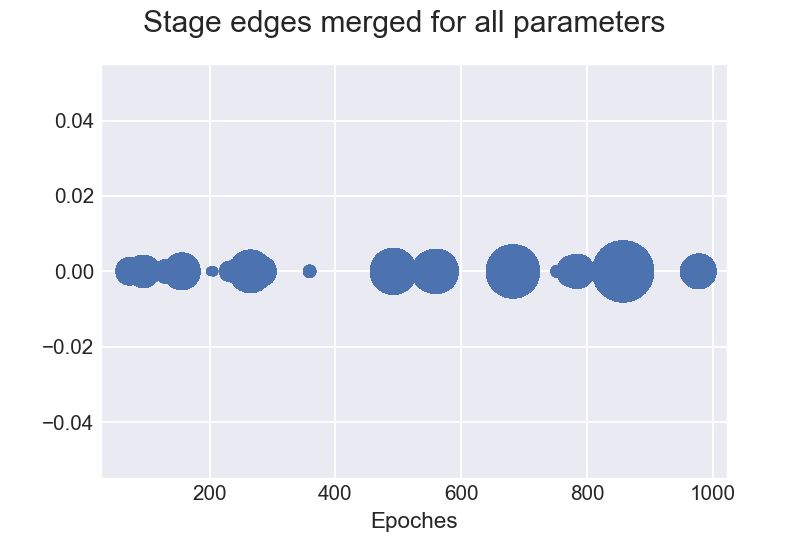

<IPython.core.display.Javascript object>


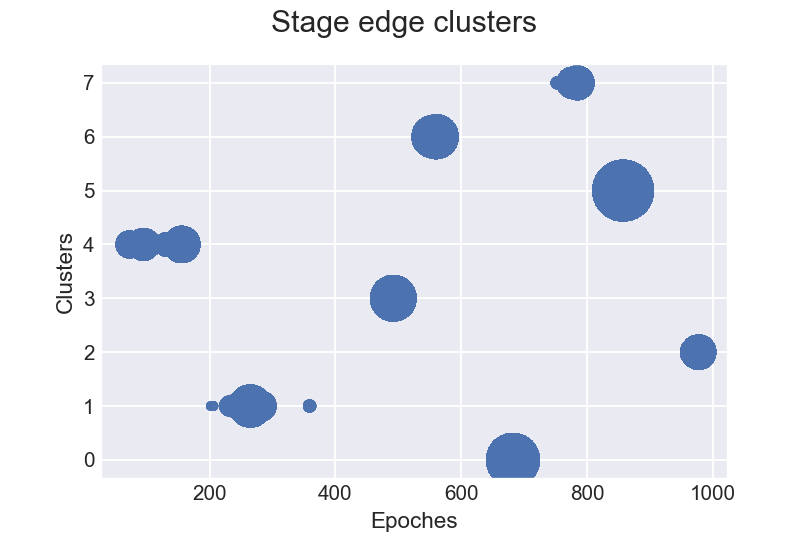

In [37]:
# Clustering parameters k_neighb_max=40, silh_metric_threshold = 0.05

st_len_min = 60
k_nb_max = 50
silh_min = 0

st_edges_all = []
st_edges_list = (df_st_edges[(df_st_edges['Len_min']==st_len_min) & (df_st_edges['K_neighb']<=k_nb_max) & 
                             (df_st_edges['Silh']>=silh_min)]['St_edges'].tolist()) 
for _st_edges in st_edges_list:
    st_edges_all += _st_edges[1:-1].tolist()
st_edges_all = sorted(st_edges_all)
df_st_edges_all = pd.DataFrame(st_edges_all)
#print(st_edges_all)
            
# Clustering stage edges
cl_name = 'kmeans_edges_'+str(n_st_edge_clusters)+'_'+str(st_len_min)+'_'+str(k_nb_max)+'_'+str(silh_min)
cluster_method, df_st_edge_metrics = cq.apply_cluster_method(data=df_st_edges_all, cl_method=KMeans, 
                                                            name=cl_name, df_metrics=df_st_edge_metrics, 
                                                            n_clusters=n_st_edge_clusters, random_state=0)

# Find mean, median, mode, std, confidence interval
df_st_edg_stats = pd.DataFrame(columns=['Cluster name', 'Median', 'Mean', 'Mode', 'Mode probability', 'Standard deviation', 
                                        'Median conf_interval_0.95', 'Cluster size'])
st_clusters = []
for _st in range(n_st_edge_clusters):
    st_clusters.append([st_edges_all[i] for i in np.where(cluster_method.labels_ == _st)[0]])
    mode, count = sp.stats.mode(st_clusters[_st])
    conf_int_median = spr.median_confidence_interval(pd.Series(st_clusters[_st]), cutoff=0.95)
    
    new_row = {'Cluster name': 'Edge cluster '+str(_st), 'Median': int(np.median(st_clusters[_st])), 'Mean': int(np.array(st_clusters[_st]).mean()), 'Mode': mode[0], 
               'Mode probability': count[0]/len(st_clusters[_st]), 'Standard deviation': int(np.array(st_clusters[_st]).std()), 
               'Median conf_interval_0.95': conf_int_median, 'Cluster size': len(st_clusters[_st])}
    df_st_edg_stats = df_st_edg_stats.append(new_row, ignore_index = True)

df_st_edg_stats = df_st_edg_stats.sort_values('Median', ignore_index=True)
display(df_st_edg_stats)
dfi.export(df_st_edg_stats, "Stage edges clustering stats.png")
    
# Plotting st_edges_all
x = st_edges_all
y = [0]*len(x)
s = [2*x.count(x[i]) for i in range(len(x))]
fig, ax = plt.subplots(figsize=(6,4))
ax.scatter(x,y, s=s)
ax.set(xlabel='Epoches')
ax.tick_params(axis='both', labelsize=11, direction='in')
fig.suptitle('Stage edges merged for all parameters', fontsize=16)
plt.savefig('Stage edges merged.png')

# Plotting clusters    
x = st_edges_all
y = cluster_method.labels_
s = [2*x.count(x[i]) for i in range(len(x))]
fig, ax = plt.subplots(figsize=(6,4))
ax.scatter(x,y, s=s)
ax.set(xlabel='Epoches', ylabel='Clusters')
ax.tick_params(axis='both', labelsize=11, direction='in')
fig.suptitle('Stage edge clusters', fontsize=16)
plt.savefig('Stage edge clusters.png')


,Cluster name,Median,Mean,Mode,Mode probability,Standard deviation,Median conf_interval_0.95,Cluster size
0,Edge cluster 5,132,121,132,0.34,25,"(104, 132)",184
1,Edge cluster 2,245,260,282,0.26,33,"(245, 265)",241
2,Edge cluster 7,490,490,490,0.52,0,"(490, 492)",117
3,Edge cluster 0,558,557,555,0.47,2,"(555, 558)",248
4,Edge cluster 4,682,680,682,0.74,3,"(682, 682)",234
5,Edge cluster 1,784,778,784,0.35,12,"(784, 784)",91
6,Edge cluster 6,857,857,857,1.00,0,"(857, 857)",203
7,Edge cluster 3,976,975,976,0.44,1,"(976, 977)",126


<IPython.core.display.Javascript object>


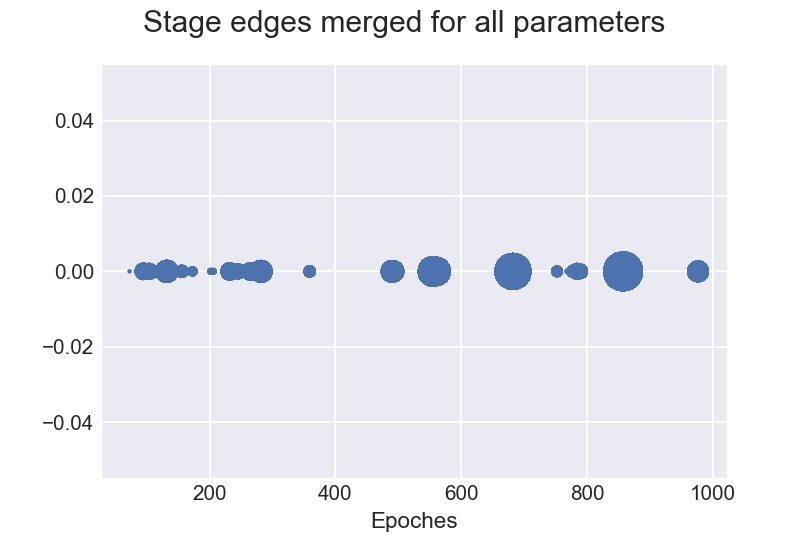

<IPython.core.display.Javascript object>


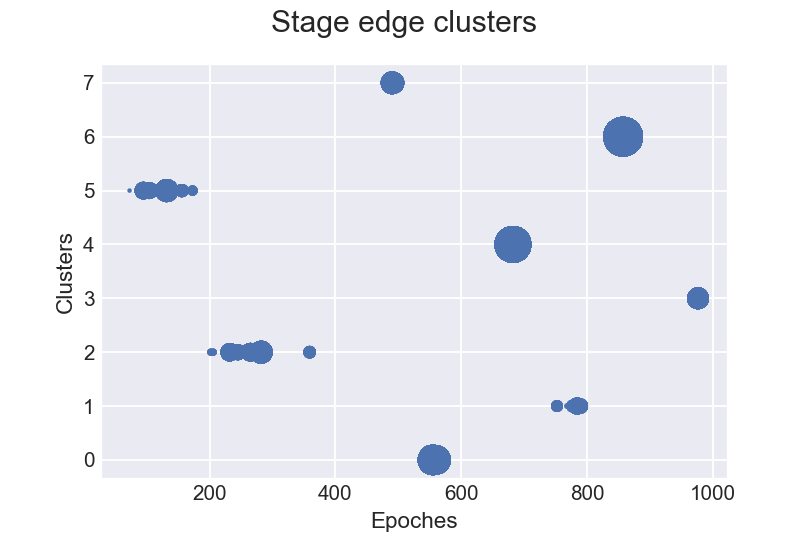

In [41]:
# Clustering parameters k_neighb_max=40, silh_metric_threshold = 0.05

st_len_min = 60
k_nb_max = 50
silh_min = 0

st_edges_all = []
st_edges_list = (df_st_edges[(df_st_edges['Len_min']==st_len_min) & (df_st_edges['K_neighb']<=k_nb_max) & 
                             (df_st_edges['Silh']>=silh_min) & (df_st_edges['N_clusters']<=10) & 
                             (df_st_edges['N_clusters']>=3)]['St_edges'].tolist()) 
for _st_edges in st_edges_list:
    st_edges_all += _st_edges[1:-1].tolist()
st_edges_all = sorted(st_edges_all)
df_st_edges_all = pd.DataFrame(st_edges_all)
#print(st_edges_all)
            
# Clustering stage edges
cl_name = 'kmeans_edges_'+str(n_st_edge_clusters)+'_'+str(st_len_min)+'_'+str(k_nb_max)+'_'+str(silh_min)
cluster_method, df_st_edge_metrics = cq.apply_cluster_method(data=df_st_edges_all, cl_method=KMeans, 
                                                            name=cl_name, df_metrics=df_st_edge_metrics, 
                                                            n_clusters=n_st_edge_clusters, random_state=0)

# Find mean, median, mode, std, confidence interval
df_st_edg_stats = pd.DataFrame(columns=['Cluster name', 'Median', 'Mean', 'Mode', 'Mode probability', 'Standard deviation', 
                                        'Median conf_interval_0.95', 'Cluster size'])
st_clusters = []
for _st in range(n_st_edge_clusters):
    st_clusters.append([st_edges_all[i] for i in np.where(cluster_method.labels_ == _st)[0]])
    mode, count = sp.stats.mode(st_clusters[_st])
    conf_int_median = spr.median_confidence_interval(pd.Series(st_clusters[_st]), cutoff=0.95)
    
    new_row = {'Cluster name': 'Edge cluster '+str(_st), 'Median': int(np.median(st_clusters[_st])), 'Mean': int(np.array(st_clusters[_st]).mean()), 'Mode': mode[0], 
               'Mode probability': count[0]/len(st_clusters[_st]), 'Standard deviation': int(np.array(st_clusters[_st]).std()), 
               'Median conf_interval_0.95': conf_int_median, 'Cluster size': len(st_clusters[_st])}
    df_st_edg_stats = df_st_edg_stats.append(new_row, ignore_index = True)

df_st_edg_stats = df_st_edg_stats.sort_values('Median', ignore_index=True)
display(df_st_edg_stats)
dfi.export(df_st_edg_stats, "Stage edges clustering stats.png")
    
# Plotting st_edges_all
x = st_edges_all
y = [0]*len(x)
s = [2*x.count(x[i]) for i in range(len(x))]
fig, ax = plt.subplots(figsize=(6,4))
ax.scatter(x,y, s=s)
ax.set(xlabel='Epoches')
ax.tick_params(axis='both', labelsize=11, direction='in')
fig.suptitle('Stage edges merged for all parameters', fontsize=16)
plt.savefig('Stage edges merged.png')

# Plotting clusters    
x = st_edges_all
y = cluster_method.labels_
s = [2*x.count(x[i]) for i in range(len(x))]
fig, ax = plt.subplots(figsize=(6,4))
ax.scatter(x,y, s=s)
ax.set(xlabel='Epoches', ylabel='Clusters')
ax.tick_params(axis='both', labelsize=11, direction='in')
fig.suptitle('Stage edge clusters', fontsize=16)
plt.savefig('Stage edge clusters.png')


[0, 104, 265, 492, 558, 682, 784, 857, 976, 1046]


<IPython.core.display.Javascript object>


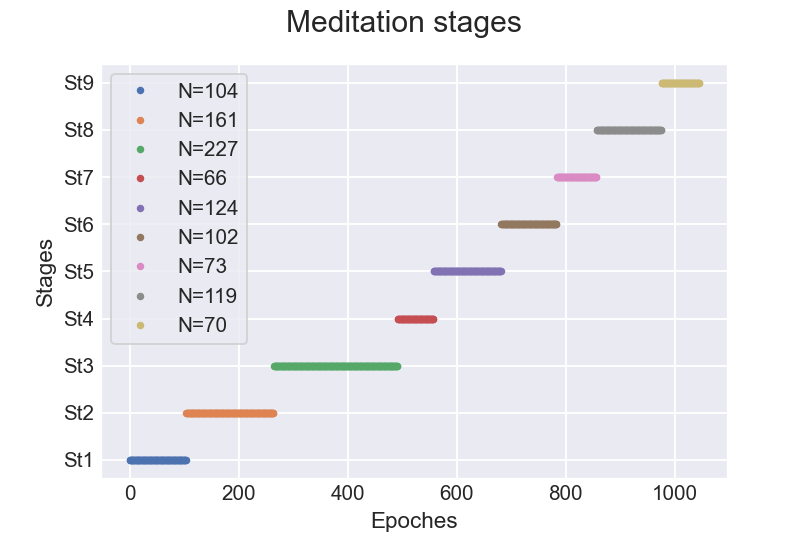

<IPython.core.display.Javascript object>


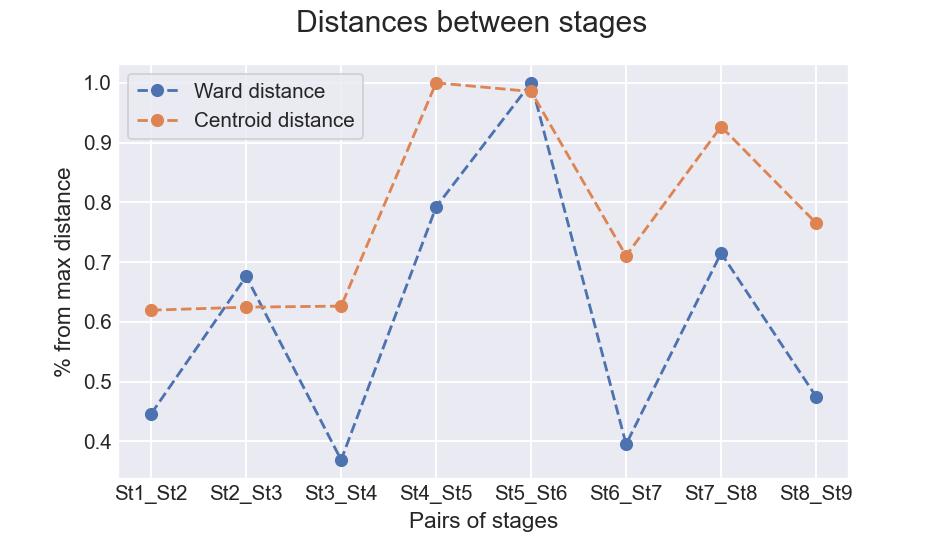

,Method,St1_St2,St2_St3,St3_St4,St4_St5,St5_St6,St6_St7,St7_St8,St8_St9
0,Ward distance,"17,235.04","26,112.88","14,255.04","30,599.19","38,613.67","15,263.66","27,614.43","18,347.13"
1,Centroid distance,16.52,16.65,16.70,26.65,26.27,18.94,24.70,20.40


In [38]:
# Form stages by medians of clusters k_neighb_max=40, silh_metric_threshold = 0

st_edges_median = (df_st_edges_result[(df_st_edges_result['St_len_min']==st_len_min) & 
                                      (df_st_edges_result['K_nb_max']==k_nb_max) & 
                                      (df_st_edges_result['Silh_min']==silh_min)].iloc[0]['St_edges_med'])
print(st_edges_median)

# Plotting stages
spr.plot_stages(st_edges_median, n_samples)

# Plotting stage distances
df_st_distances = spr.plot_stage_distances(df_features, st_edges_median)
#df_st_distances = spr.plot_stage_dist_full(df_features, st_edges_median)
display(df_st_distances)
dfi.export(df_st_distances, "Distance values.png")

[0, 128, 265, 490, 560, 682, 784, 857, 976, 1046]


<IPython.core.display.Javascript object>


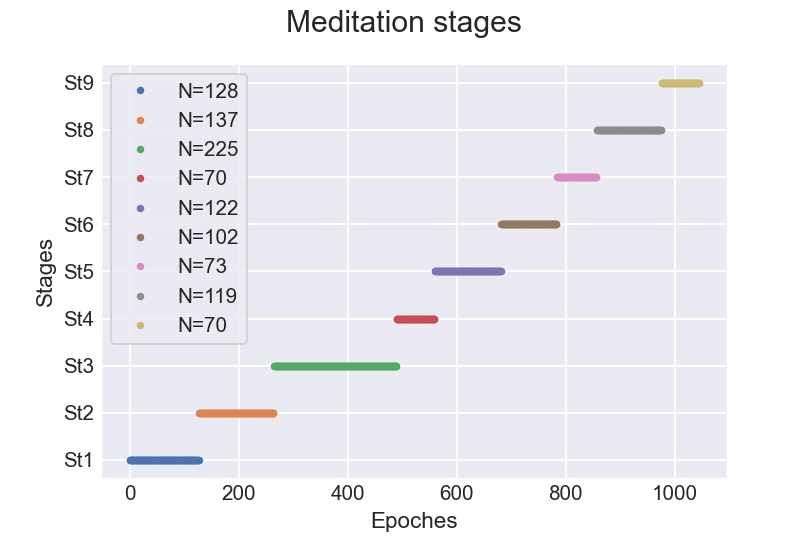

<IPython.core.display.Javascript object>


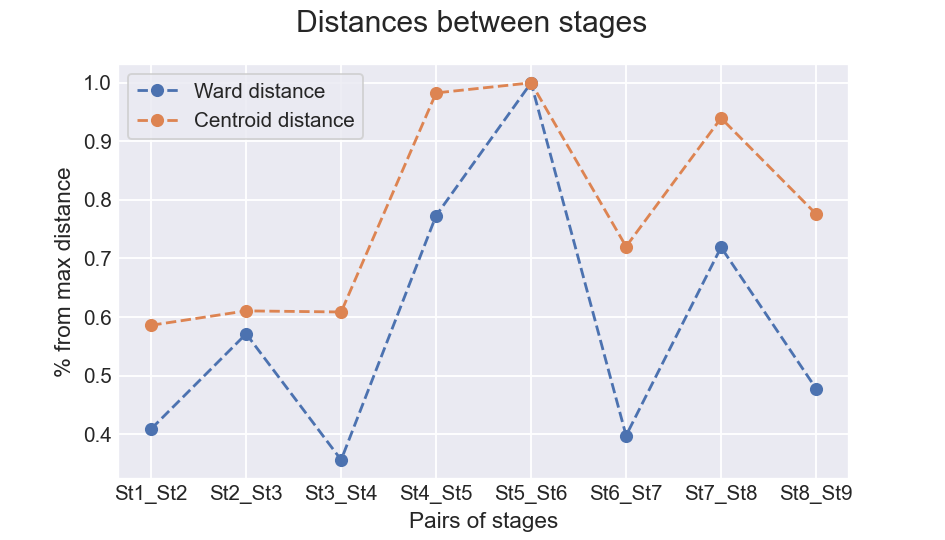

,Method,St1_St2,St2_St3,St3_St4,St4_St5,St5_St6,St6_St7,St7_St8,St8_St9
0,Ward distance,"15,703.79","21,936.09","13,669.11","29,693.15","38,395.55","15,263.66","27,614.43","18,347.13"
1,Centroid distance,15.40,16.05,16.00,25.84,26.29,18.94,24.70,20.40


In [19]:
# Form stages by medians of clusters k_neighb_max=40, silh_metric_threshold = 0

st_edges_median = (df_st_edges_result[(df_st_edges_result['St_len_min']==st_len_min) & 
                                      (df_st_edges_result['K_nb_max']==k_nb_max) & 
                                      (df_st_edges_result['Silh_min']==silh_min)].iloc[0]['St_edges_med'])
print(st_edges_median)

# Plotting stages
spr.plot_stages(st_edges_median, n_samples)

# Plotting stage distances
df_st_distances = spr.plot_stage_distances(df_features, st_edges_median)
#df_st_distances = spr.plot_stage_dist_full(df_features, st_edges_median)
display(df_st_distances)
dfi.export(df_st_distances, "Distance values.png")

In [20]:
# Save additional parameteres

# Stage distances
df_st_distances.to_feather(os.path.join(ft_root_path, 'df_st_distances.feather'))
#df_stage_metrics = pd.read_feather(os.path.join(ft_root_path, 'df_stage_metrics.feather'))

# Stage edges array for clustering
np.savetxt(os.path.join(ft_root_path, 'st_edges_all.txt'), st_edges_all)
#st_edges_all = np.loadtxt(os.path.join(ft_root_path, 'st_edges_all.txt'), dtype=int)

st_edges_times = epochs_filt_rr.events[st_edges_median[1:-1]][:,0]
np.savetxt(os.path.join(ft_root_path, 'st_edges_times.txt'), st_edges_times)
#st_edges_times = np.loadtxt(os.path.join(ft_root_path, 'st_edges_times.txt'), dtype=int)

# P-values and medians for 
n_stages = len(st_edges_median)-1
for _st in range(n_stages):
    df_st_med_ind[_st].to_feather(os.path.join(ft_root_path, 'df_st_med_ind_'+st_bands[_st][2]+'.feather'))
    df_st_pval_ind[_st].to_feather(os.path.join(ft_root_path, 'df_st_pval_ind_'+st_bands[_st][2]+'.feather'))

print(st_edges_median)

NameError: name 'df_st_med_ind' is not defined

In [27]:
print(epochs_filt_rr.events[st_edges_median[1:-1]][:,0])
st_edges_times = epochs_filt_rr.events[st_edges_median[1:-1]][:,0]
np.savetxt(os.path.join(ft_root_path, 'st_edges_times.txt'), st_edges_times)


[ 61350 124950 227350 256550 310550 354150 386150 438950]


In [24]:
# Getting time length of the stages

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)
n_stages = len(st_bands)

cluster_events = epochs_filt_rr.events.copy()
cluster_events[:,2] = new_labels

st_names =['Stage '+str(i+1) for i in range(n_stages)]
df_st_time_len = pd.DataFrame(columns=['Parameters']+st_names)

time_bands = []
for i in range(n_stages):
    cl_samples = np.where(cluster_events[:,2] == i)[0]
    time_bands.append((cluster_events[cl_samples[0]][0], cluster_events[cl_samples[-1]][0], 'St'+str(i+1)))

# Start-end time
st_param_dict = dict([(st_names[i], (round(time_bands[i][0]/sampling_rate), round(time_bands[i][1]/sampling_rate))) 
                      for i in range(n_stages)])
new_row = {'Parameters': 'Start-end time, sec'}
new_row.update(st_param_dict)
df_st_time_len = df_st_time_len.append(new_row, ignore_index = True)

# Time length, sec
st_param_dict = dict([(st_names[i], str((time_bands[i][1]-time_bands[i][0])/sampling_rate)) for i in range(n_stages)])
new_row = {'Parameters': 'Time length, sec'}
new_row.update(st_param_dict)
df_st_time_len = df_st_time_len.append(new_row, ignore_index = True)

# Number of epochs, sec
st_param_dict = dict([(st_names[i], st_bands[i][1]-st_bands[i][0]+1) for i in range(n_stages)])
print(st_param_dict)
new_row = {'Parameters': 'Number of epochs'}
new_row.update(st_param_dict)
df_st_time_len = df_st_time_len.append(new_row, ignore_index = True)

print(time_bands)
print([((band[1]-band[0])/sampling_rate, band[2]) for band in time_bands])

display(df_st_time_len)    
dfi.export(df_st_time_len, "Stages time length.png")


{'Stage 1': 128, 'Stage 2': 137, 'Stage 3': 225, 'Stage 4': 70, 'Stage 5': 122, 'Stage 6': 102, 'Stage 7': 73, 'Stage 8': 119, 'Stage 9': 70}
[(4950, 60950, 'St1'), (61350, 124550, 'St2'), (124950, 226550, 'St3'), (227350, 255750, 'St4'), (256550, 310150, 'St5'), (310550, 353750, 'St6'), (354150, 385750, 'St7'), (386150, 438550, 'St8'), (438950, 469350, 'St9')]
[(112.0, 'St1'), (126.4, 'St2'), (203.2, 'St3'), (56.8, 'St4'), (107.2, 'St5'), (86.4, 'St6'), (63.2, 'St7'), (104.8, 'St8'), (60.8, 'St9')]


,Parameters,Stage 1,Stage 2,Stage 3,Stage 4,Stage 5,Stage 6,Stage 7,Stage 8,Stage 9
0,"Start-end time, sec","(10, 122)","(123, 249)","(250, 453)","(455, 512)","(513, 620)","(621, 708)","(708, 772)","(772, 877)","(878, 939)"
1,"Time length, sec",112.0,126.4,203.2,56.8,107.2,86.4,63.2,104.8,60.8
2,Number of epochs,128,137,225,70,122,102,73,119,70


<IPython.core.display.Javascript object>


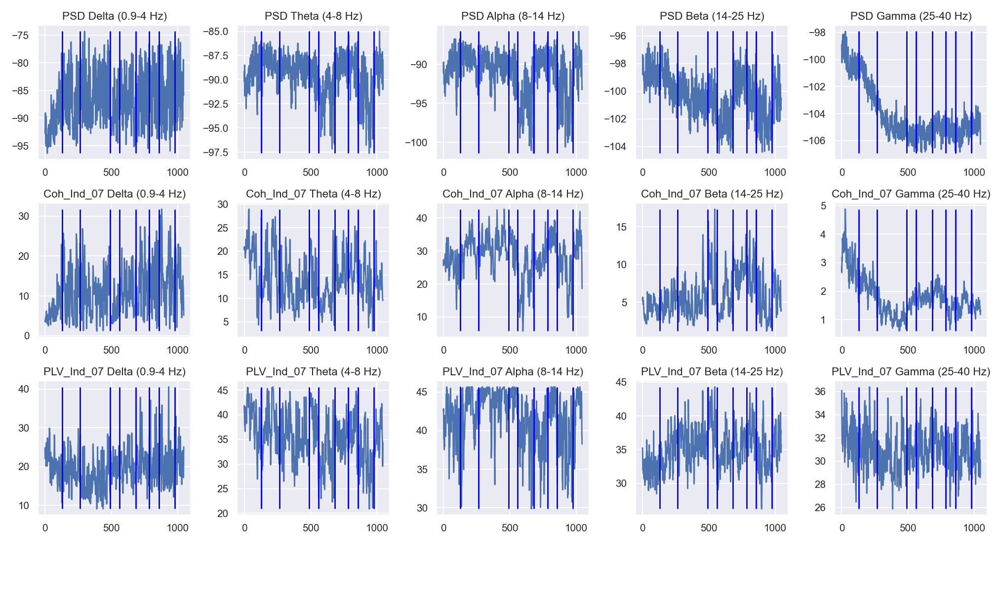

In [36]:
# Plotting overall PSD, Coherence and PLV with stage bounds

ind_rate = '07'

# Features DataFrames
df_ft_psd = df_ft_psd_all_db
df_cols = [col for col in df_ft_coh_ind_all.columns if (ind_rate in col)]
df_ft_coh = df_ft_coh_ind_all[df_cols]
df_cols = [col for col in df_ft_plv_ind_all.columns if (ind_rate in col)]
df_ft_plv = df_ft_plv_ind_all[df_cols]

# Initialize plots
n_cols = n_freq
n_rows = 3
fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(3*n_cols, 3*n_rows))
plt.subplots_adjust(left=0.02)

# PSD plots (1st row)
for i in range(n_freq):
    y = df_ft_psd.to_numpy()[:,i]
    axs[0,i].plot(y)
    axs[0,i].vlines(x=st_edges_median[1:-1], ymin=np.min(y), ymax=np.max(y), color='blue')
    axs[0,i].set_title("PSD "+ bands[i][2])

# Coherence plots (2nd row)
for i in range(n_freq):
    y = df_ft_coh.to_numpy()[:,i]
    axs[1,i].plot(y)
    axs[1,i].vlines(x=st_edges_median[1:-1], ymin=np.min(y), ymax=np.max(y), color='blue')
    axs[1,i].set_title('Coh_Ind_'+ind_rate+' '+bands[i][2]) 

# PLV plots (3rd row)
for i in range(n_freq):
    y = df_ft_plv.to_numpy()[:,i]
    axs[2,i].plot(y)
    axs[2,i].vlines(x=st_edges_median[1:-1], ymin=np.min(y), ymax=np.max(y), color='blue')
    axs[2,i].set_title('PLV_Ind_'+ind_rate+' '+bands[i][2])

plt.tight_layout(rect=[0,0.09,1,1])

#fig.suptitle('PSD in brain regions by spectrum')
plt.savefig('Stage edges plots.png')


<IPython.core.display.Javascript object>


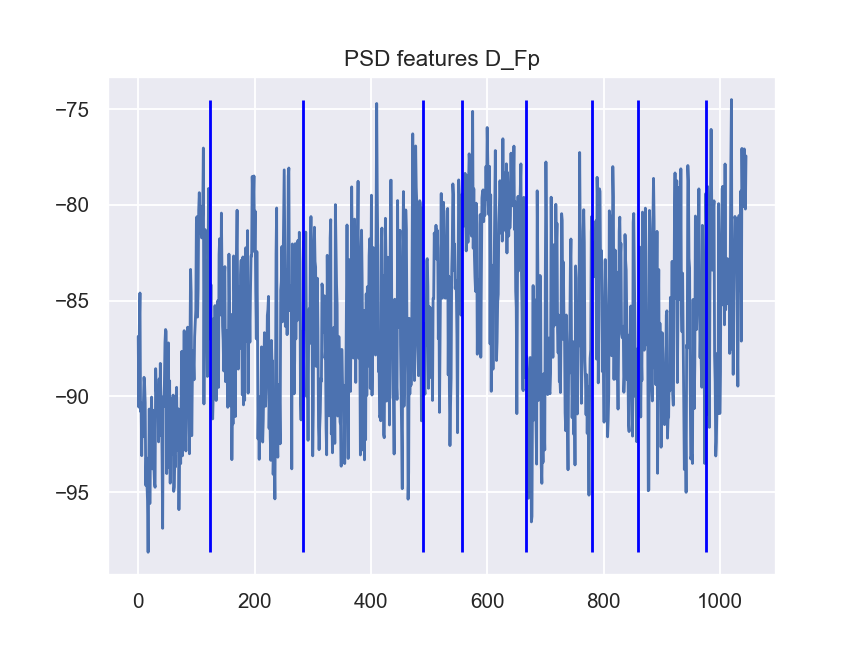

<IPython.core.display.Javascript object>


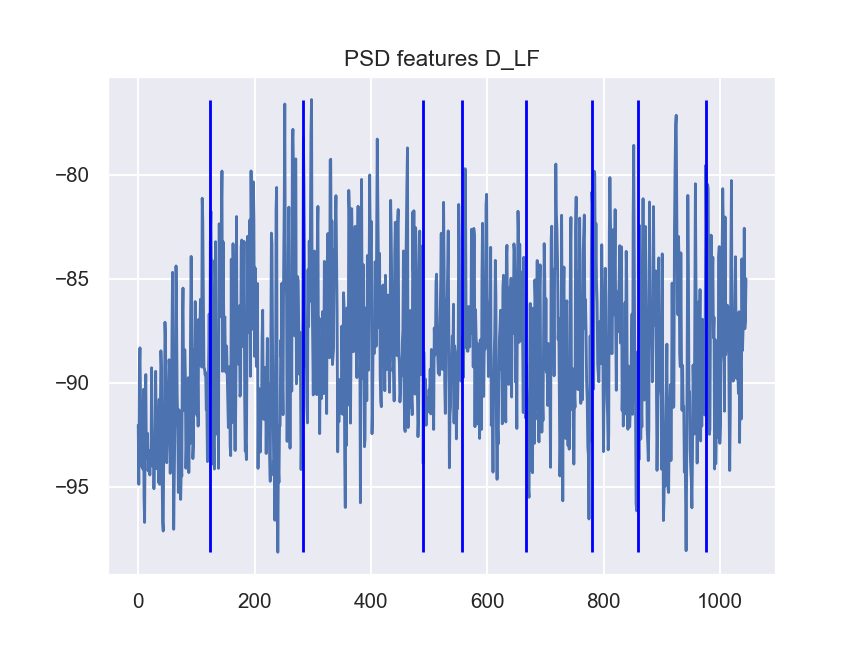

<IPython.core.display.Javascript object>


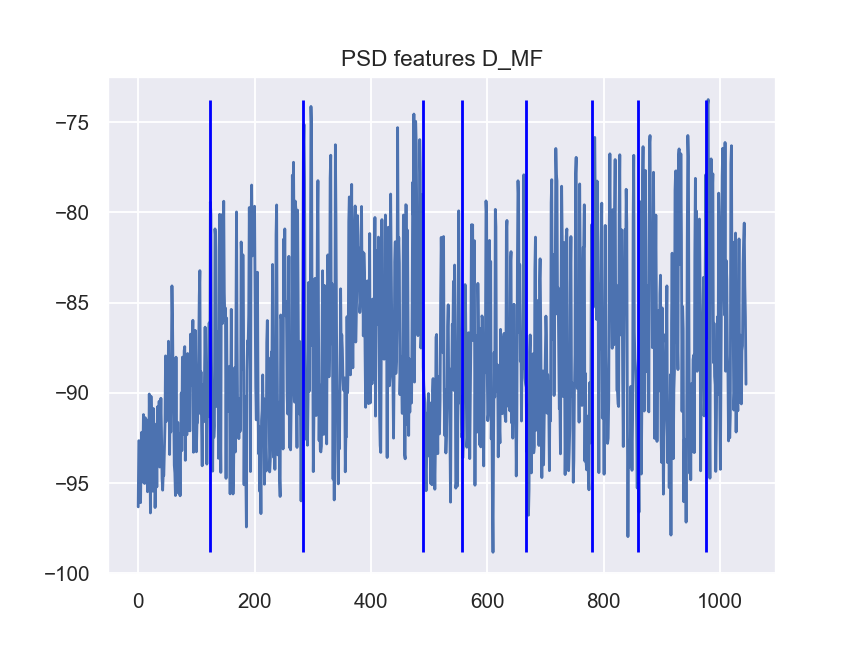

<IPython.core.display.Javascript object>


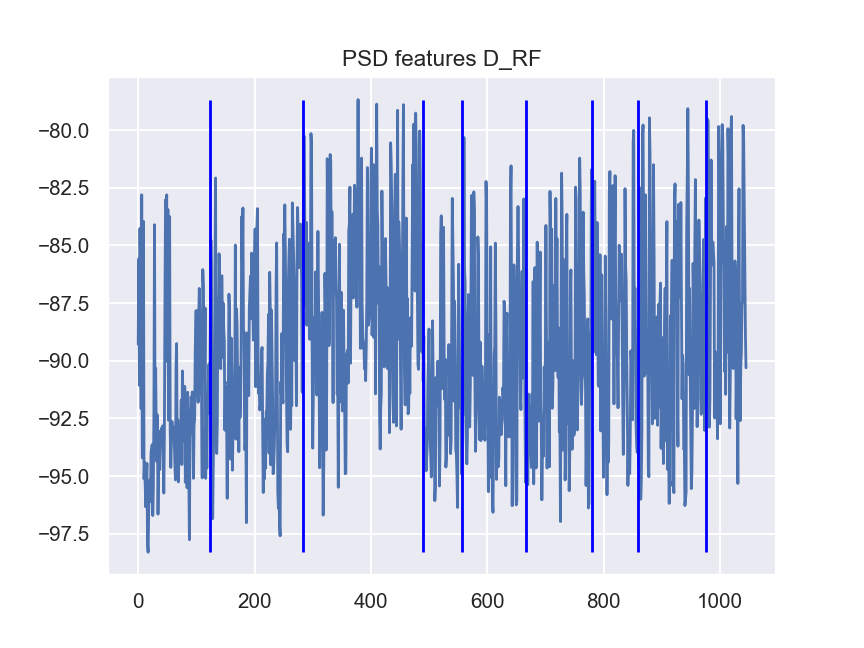

<IPython.core.display.Javascript object>


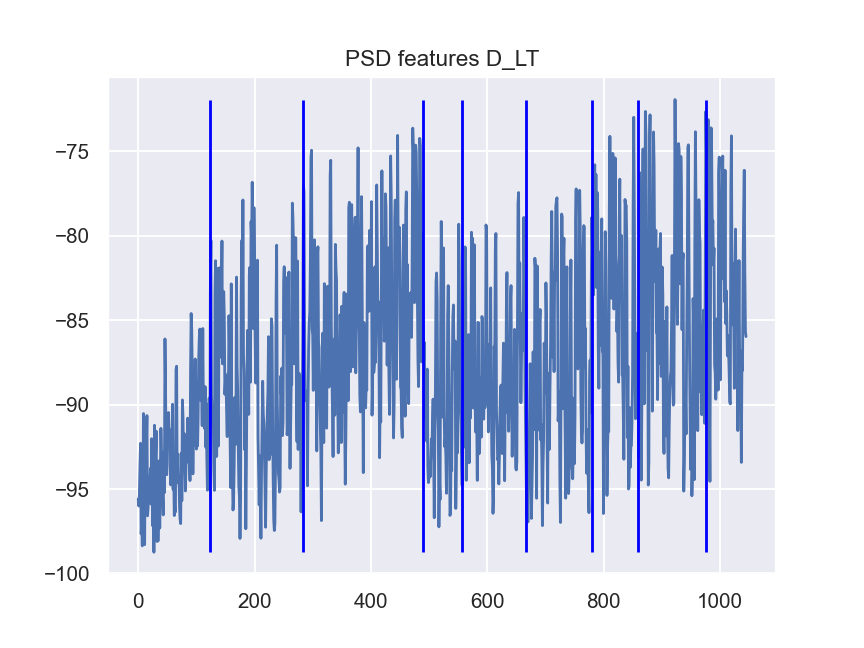

<IPython.core.display.Javascript object>


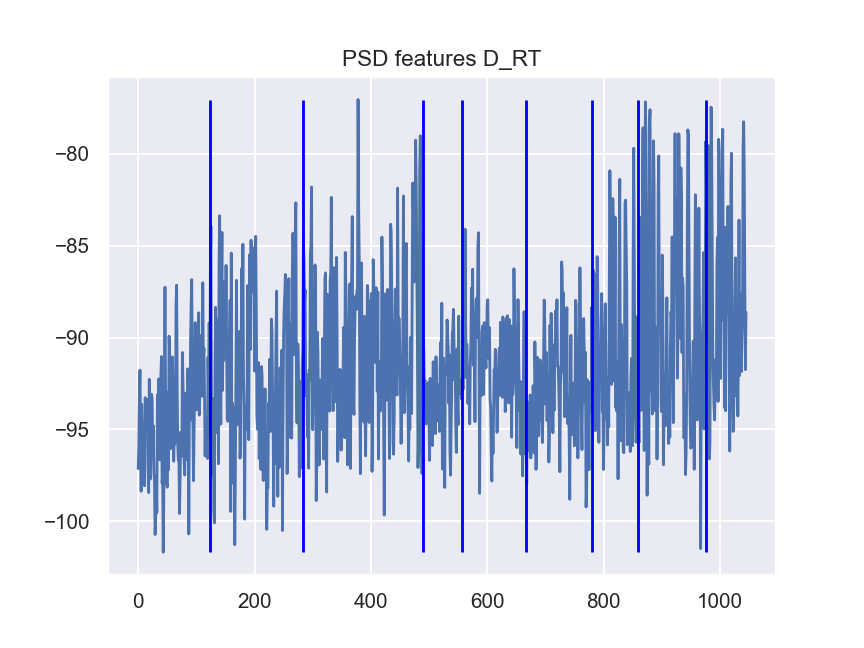

<IPython.core.display.Javascript object>


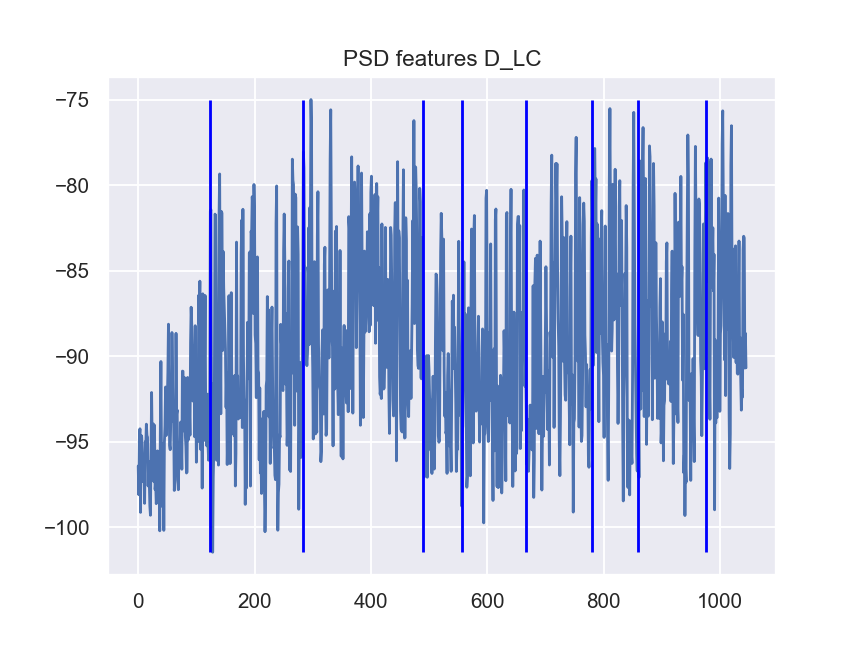

<IPython.core.display.Javascript object>


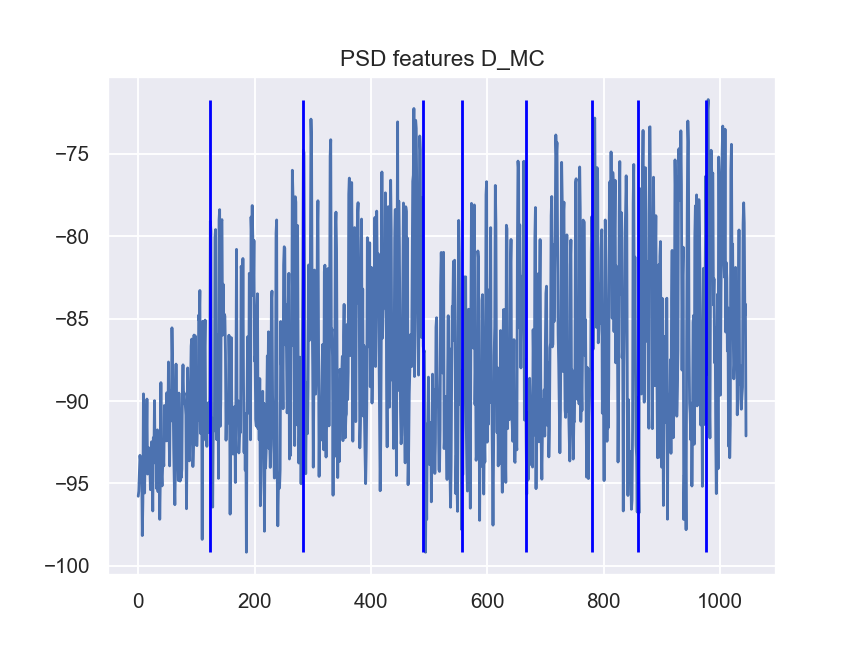

<IPython.core.display.Javascript object>


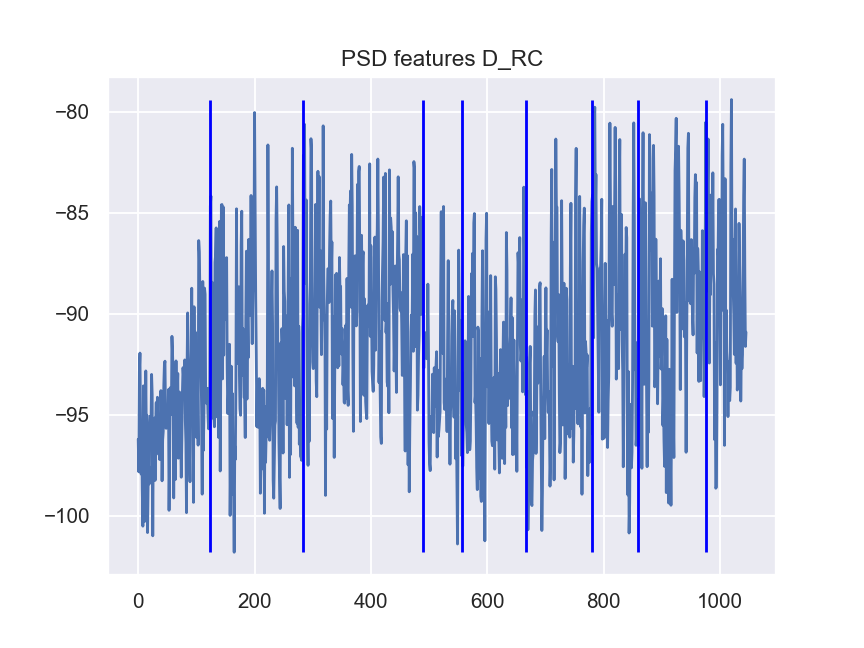

<IPython.core.display.Javascript object>


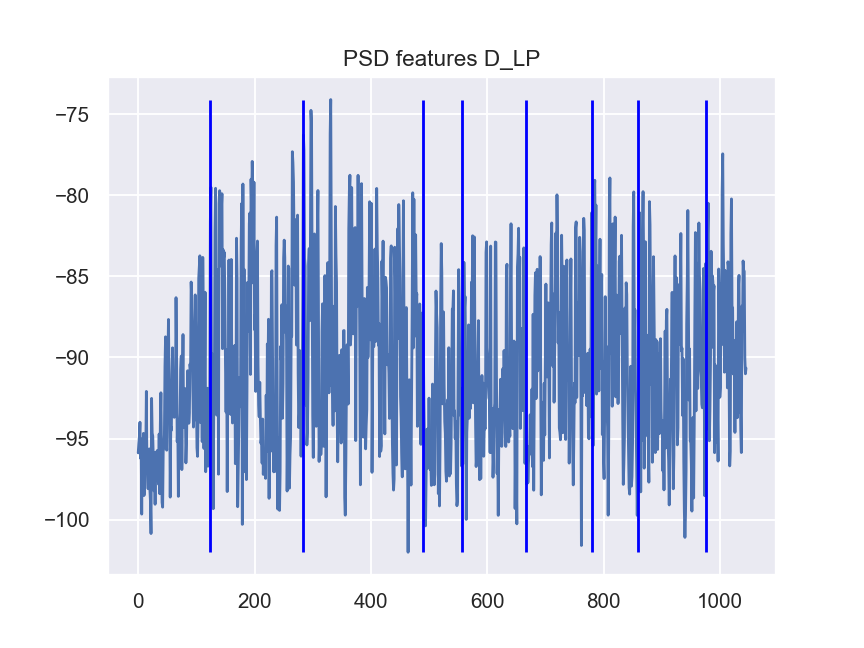

<IPython.core.display.Javascript object>


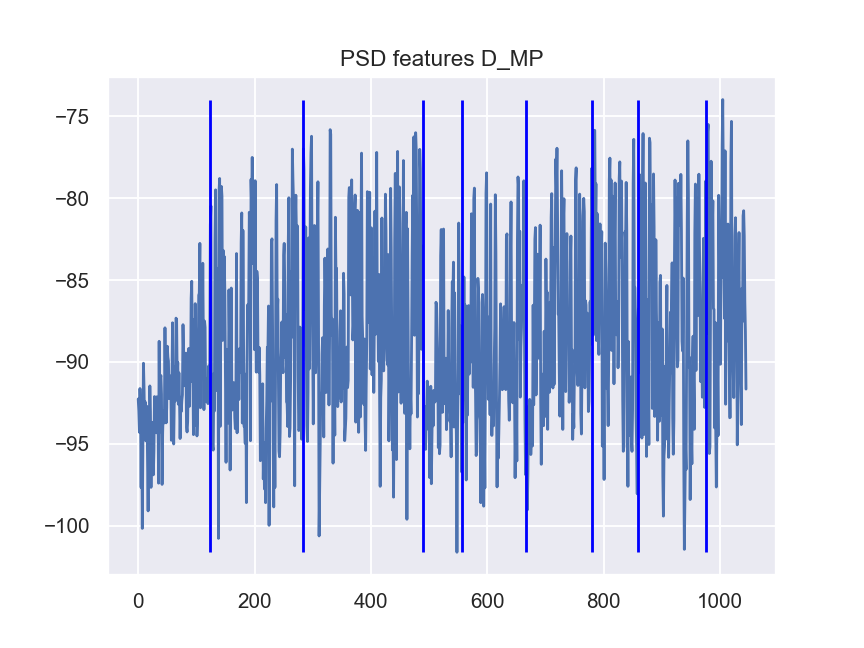

<IPython.core.display.Javascript object>


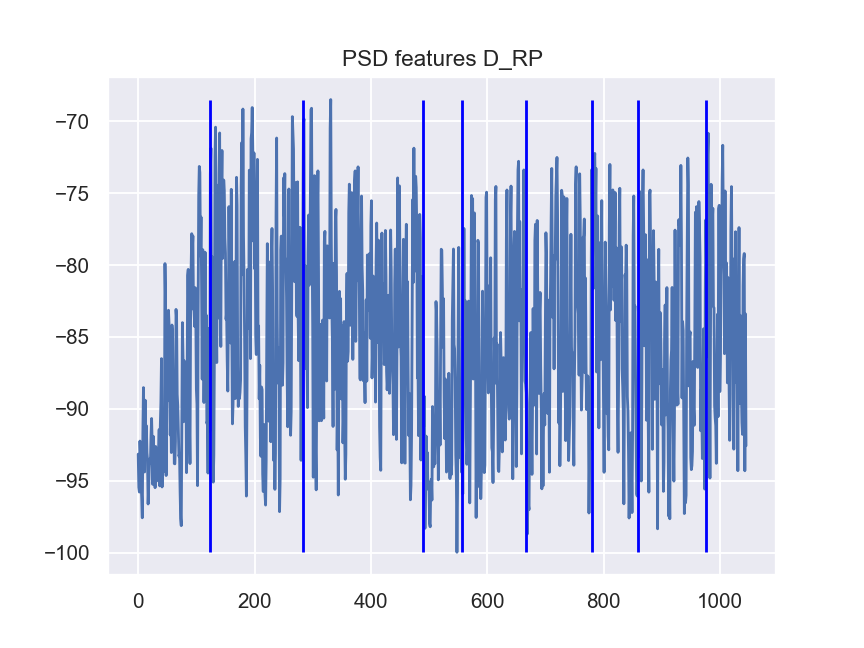

<IPython.core.display.Javascript object>


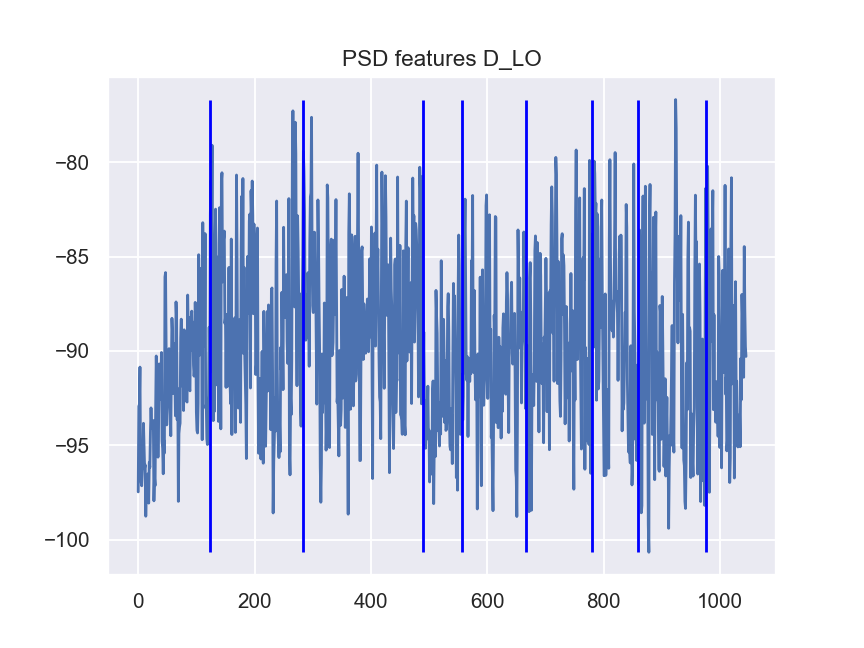

<IPython.core.display.Javascript object>


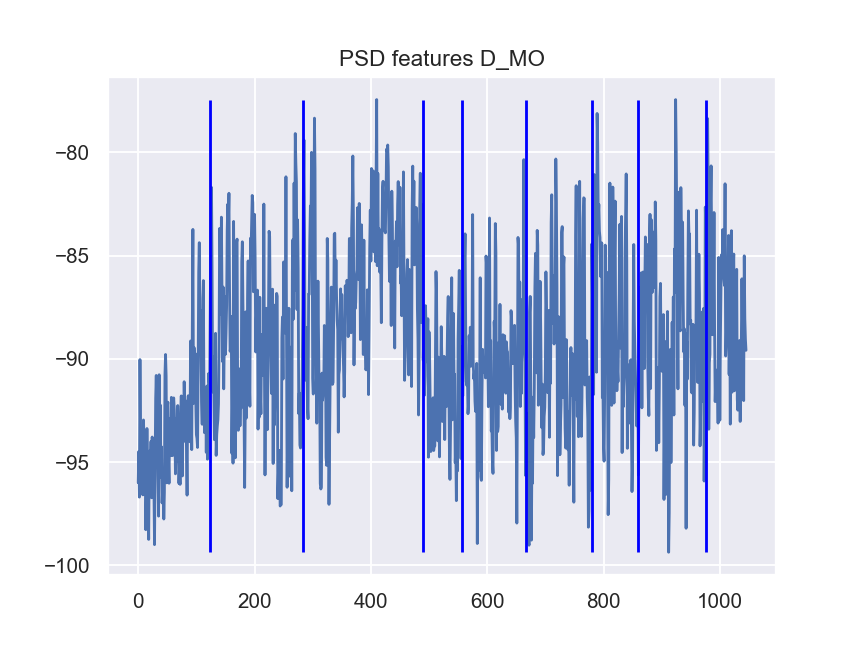

<IPython.core.display.Javascript object>


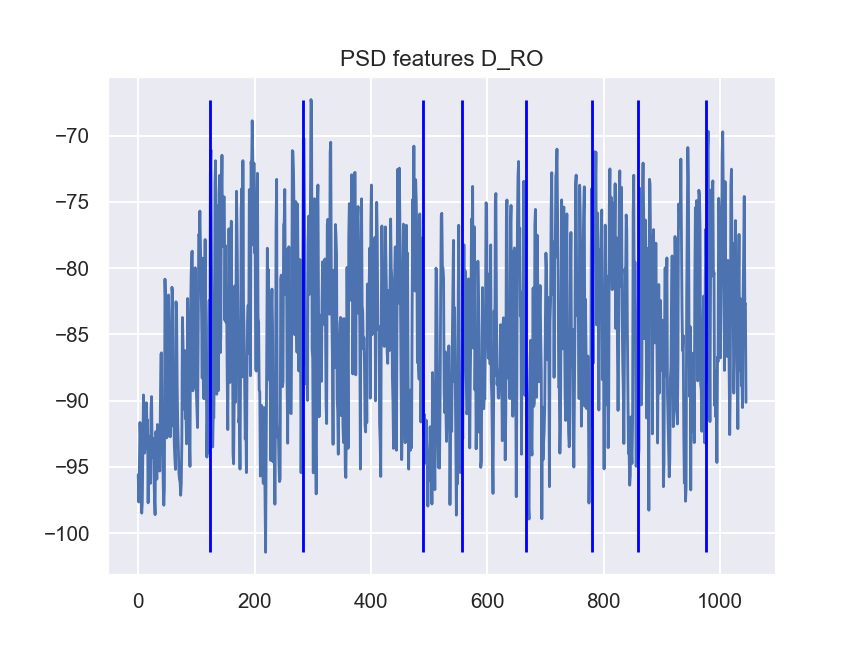

<IPython.core.display.Javascript object>


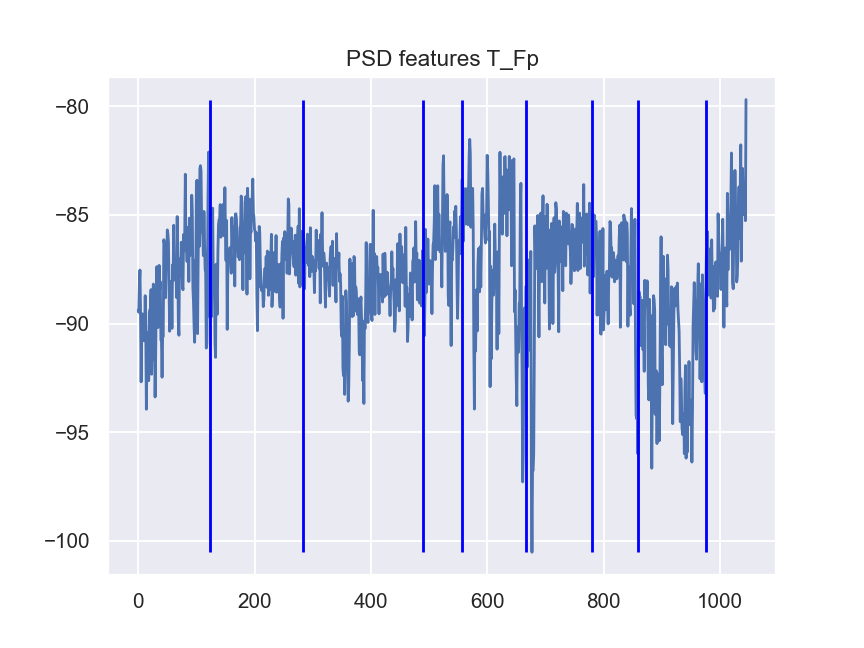

<IPython.core.display.Javascript object>


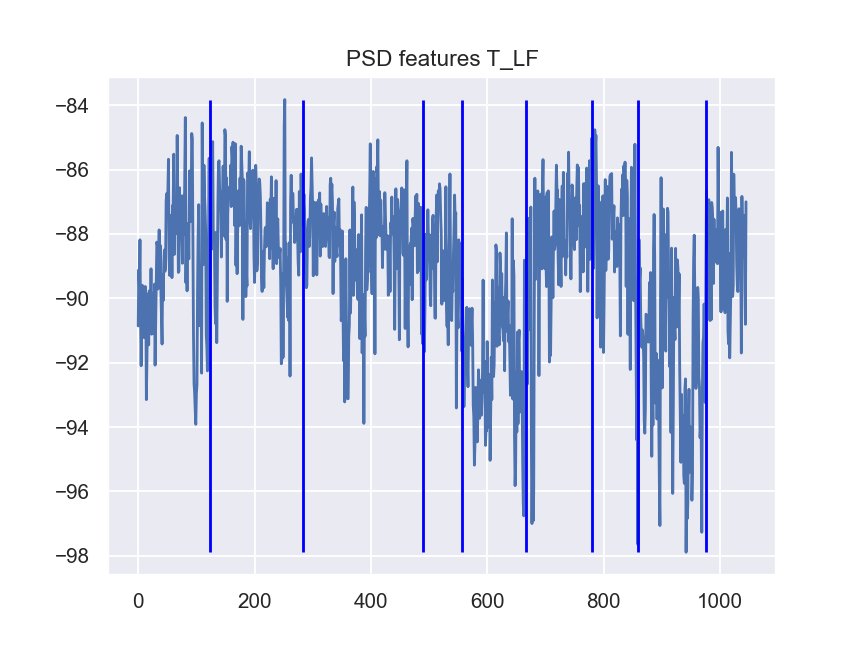

<IPython.core.display.Javascript object>


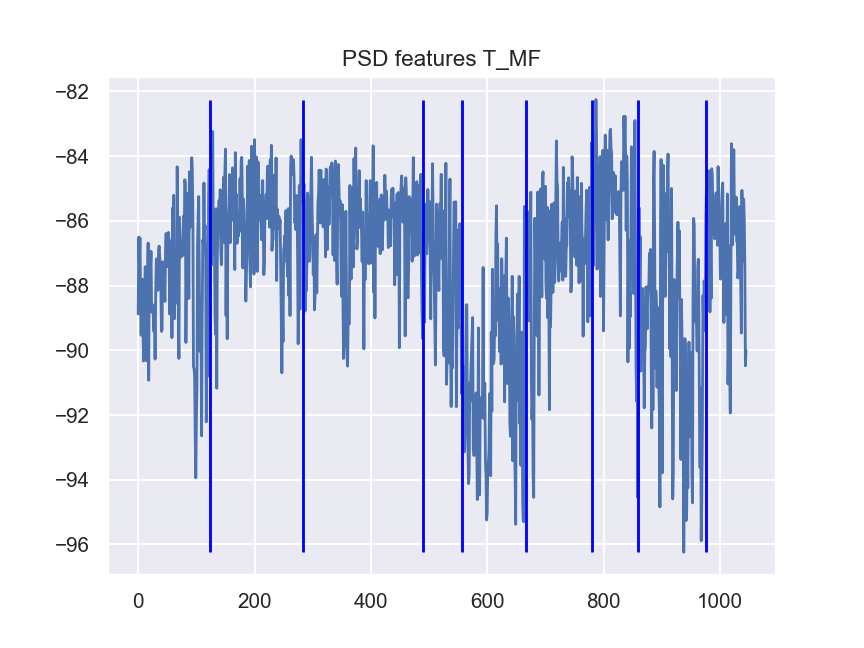

<IPython.core.display.Javascript object>


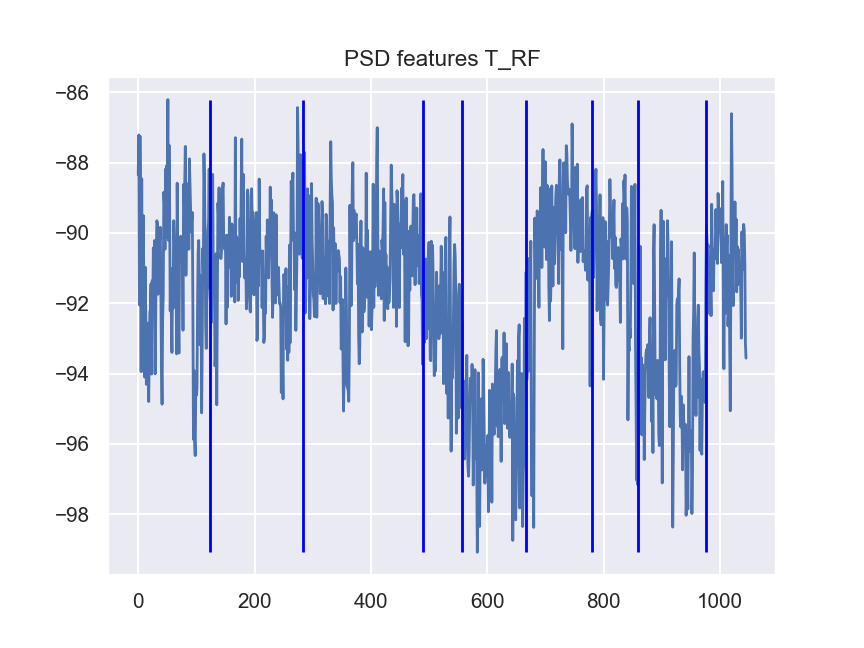

<IPython.core.display.Javascript object>


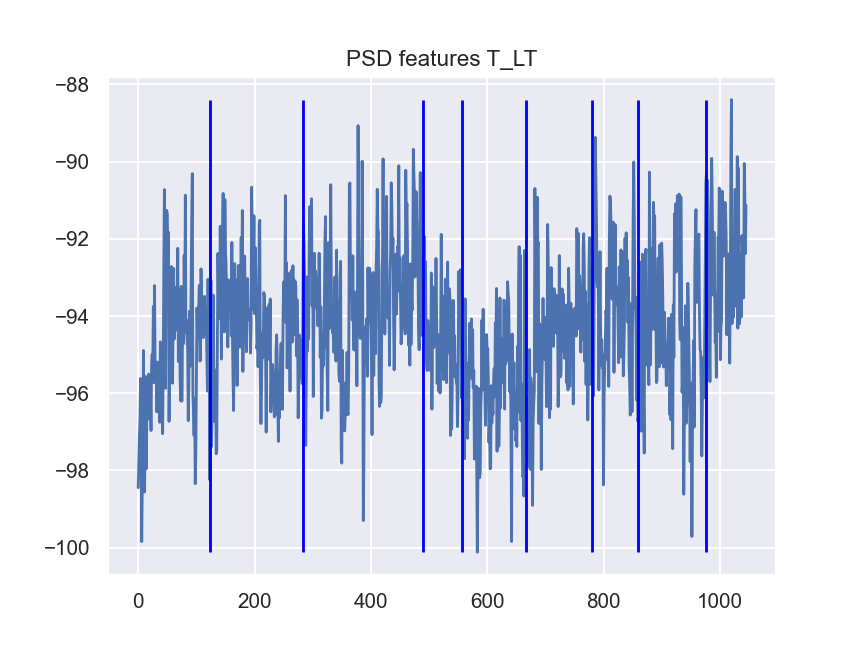

<IPython.core.display.Javascript object>


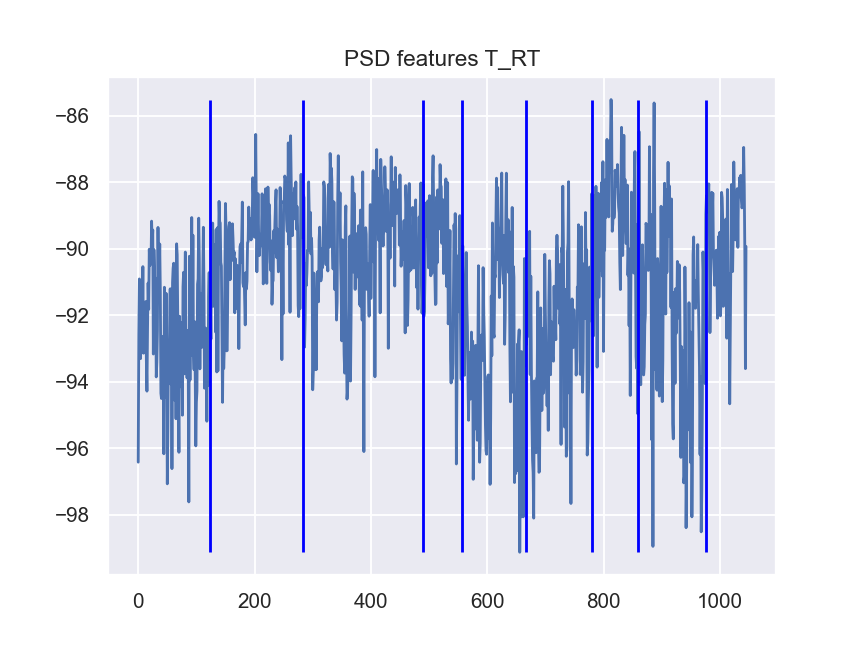

<IPython.core.display.Javascript object>


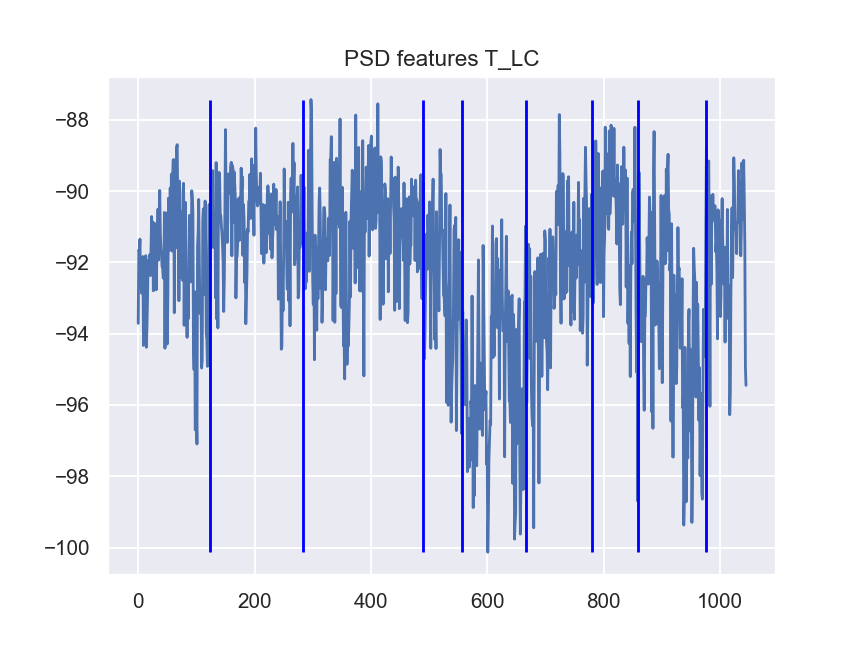

<IPython.core.display.Javascript object>


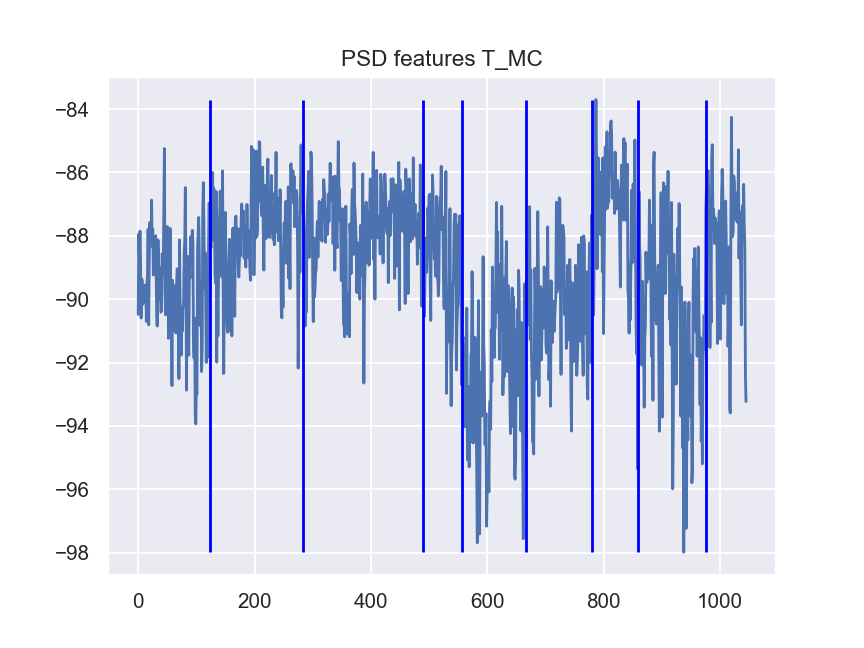

<IPython.core.display.Javascript object>


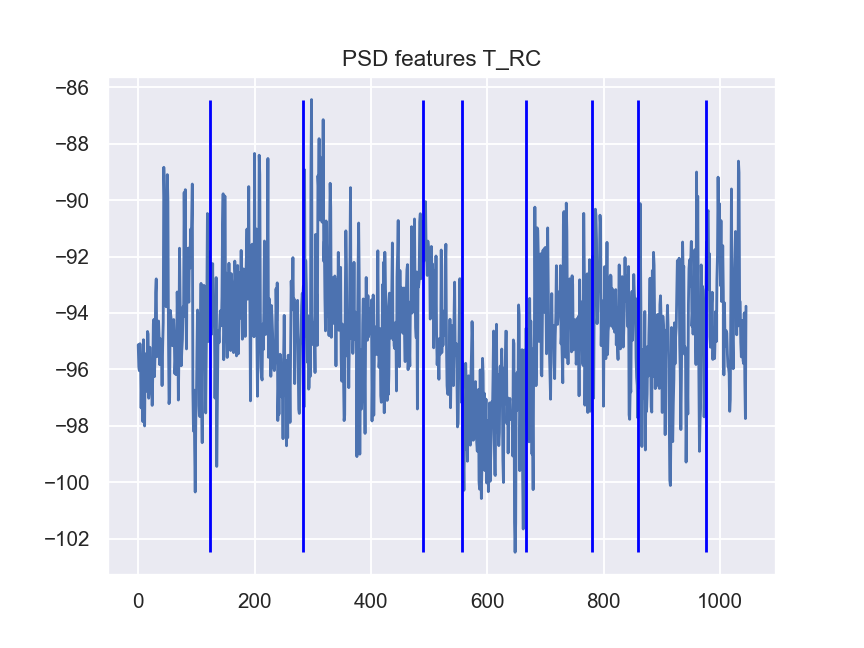

<IPython.core.display.Javascript object>


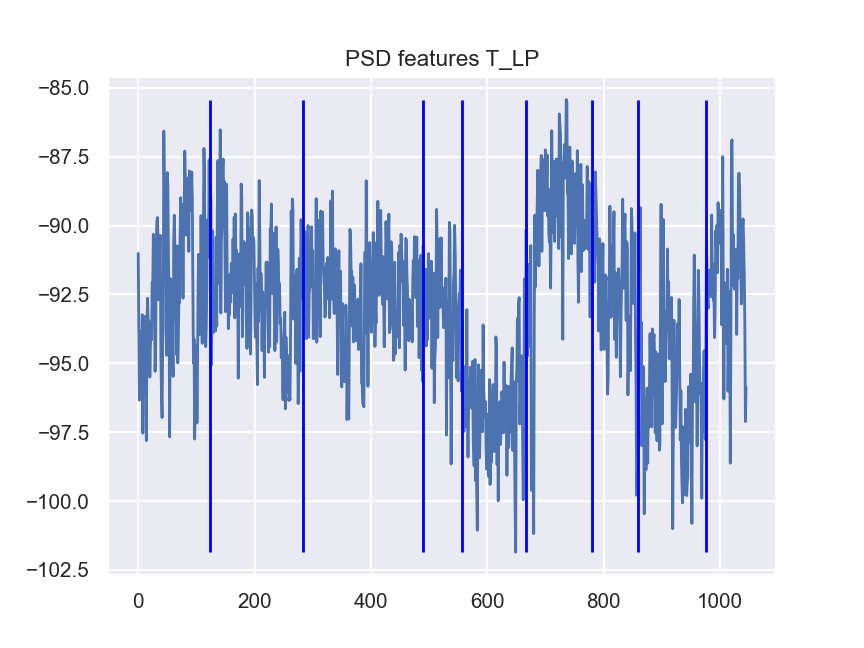

<IPython.core.display.Javascript object>


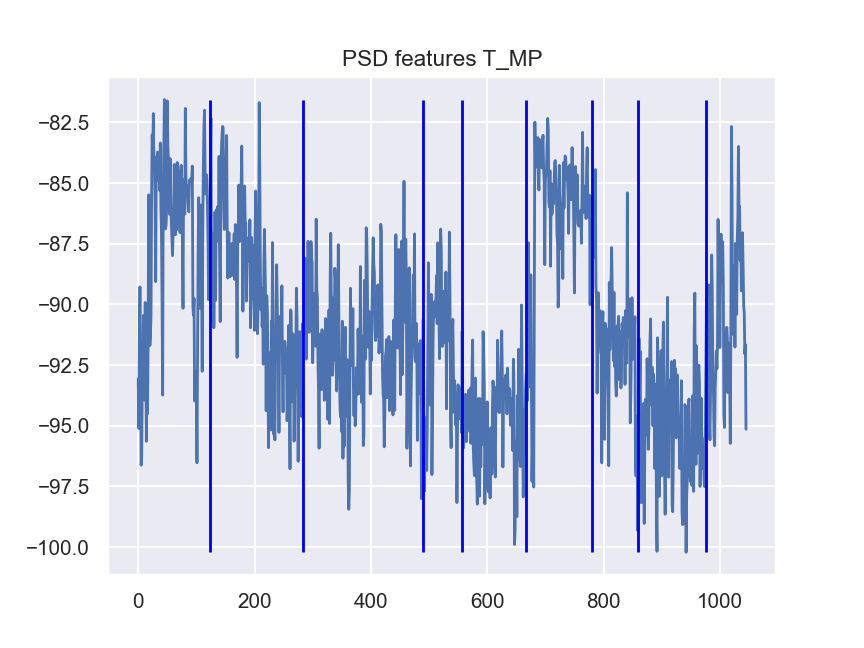

<IPython.core.display.Javascript object>


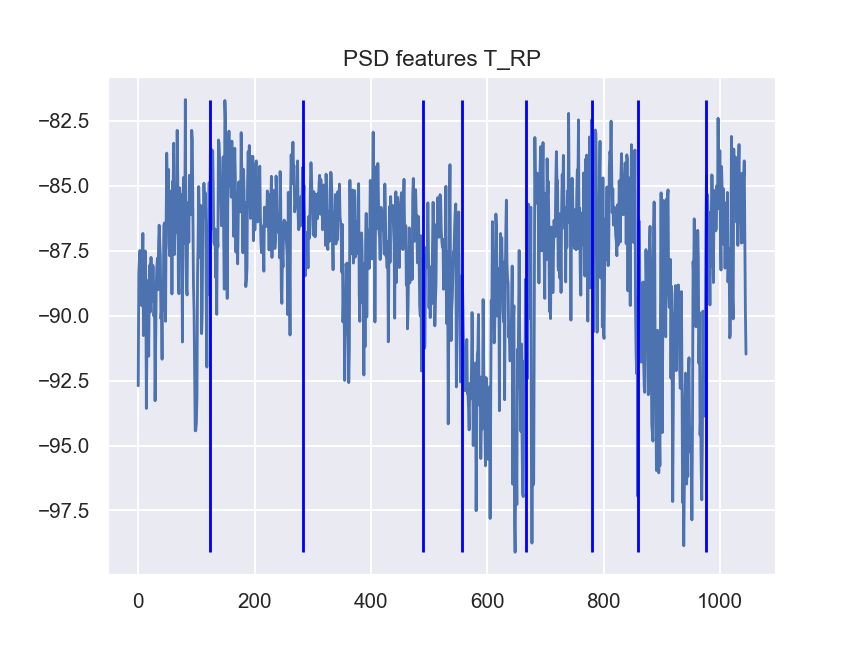

<IPython.core.display.Javascript object>


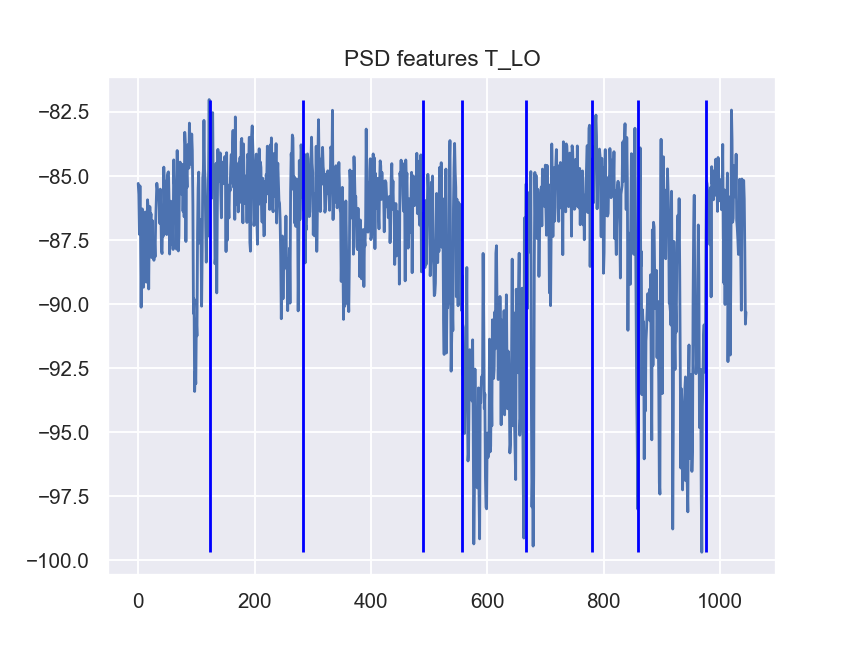

<IPython.core.display.Javascript object>


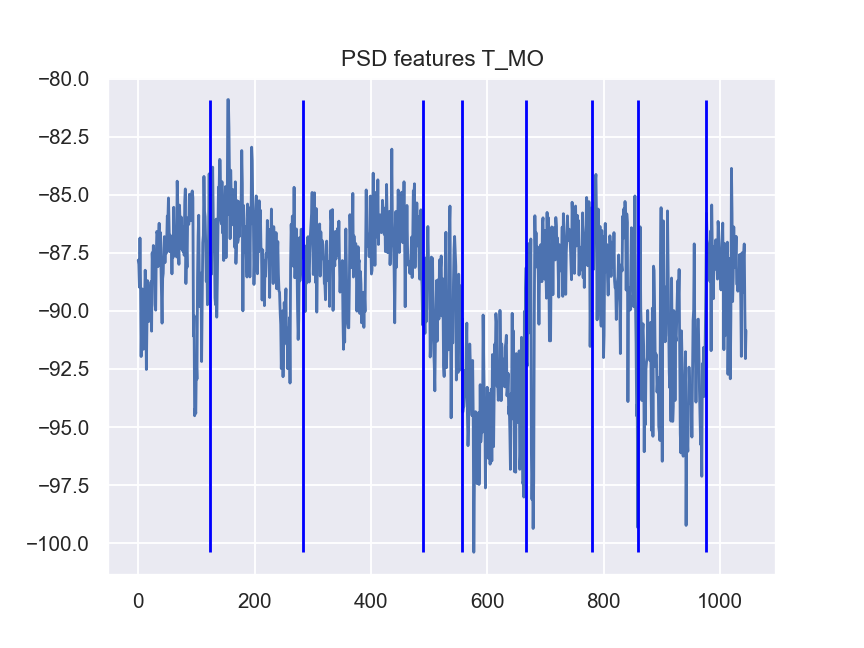

<IPython.core.display.Javascript object>


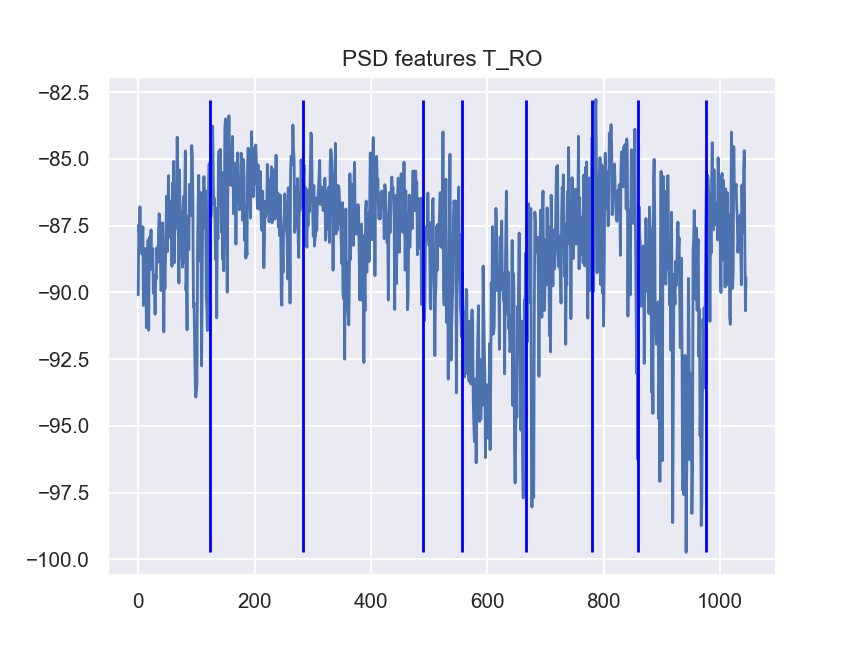

<IPython.core.display.Javascript object>


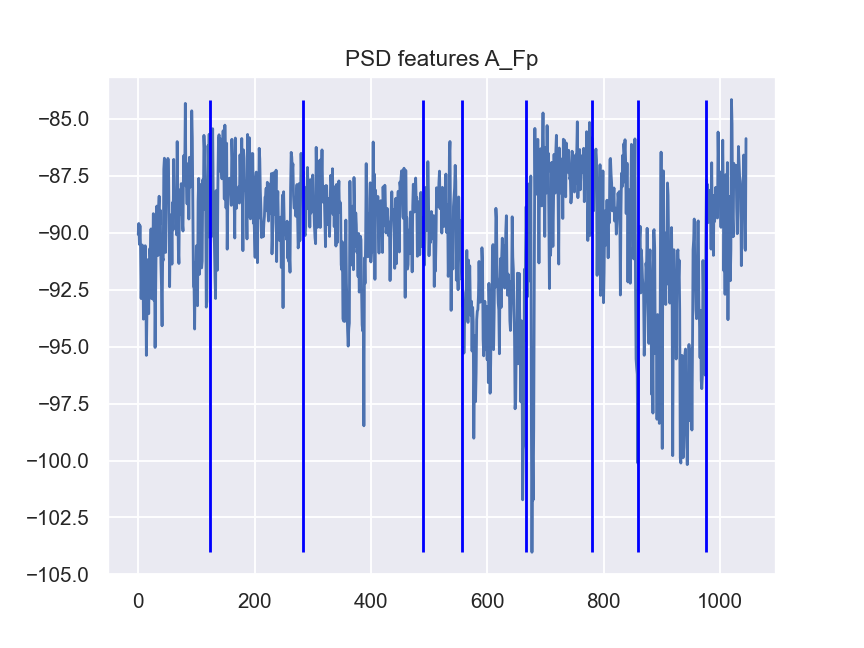

<IPython.core.display.Javascript object>


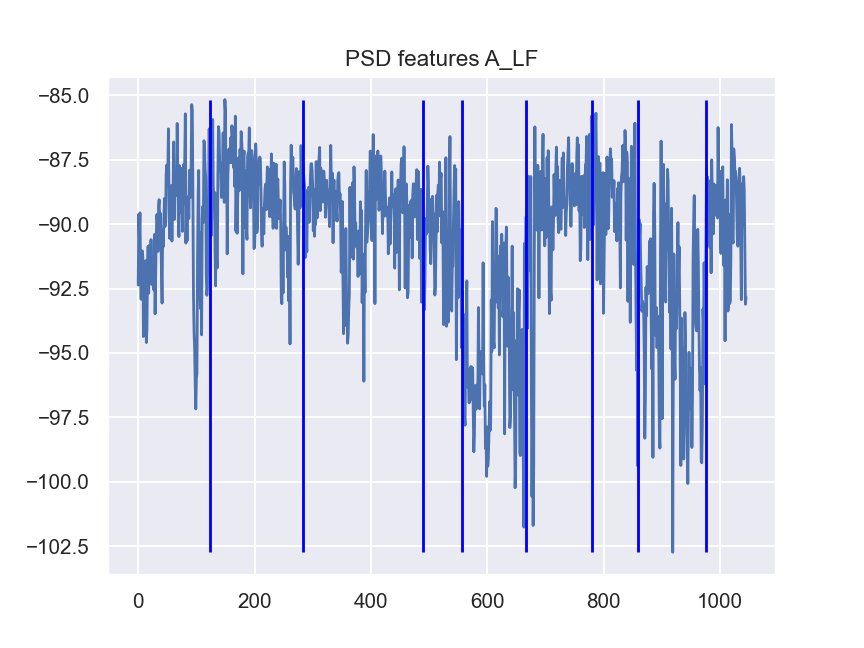

<IPython.core.display.Javascript object>


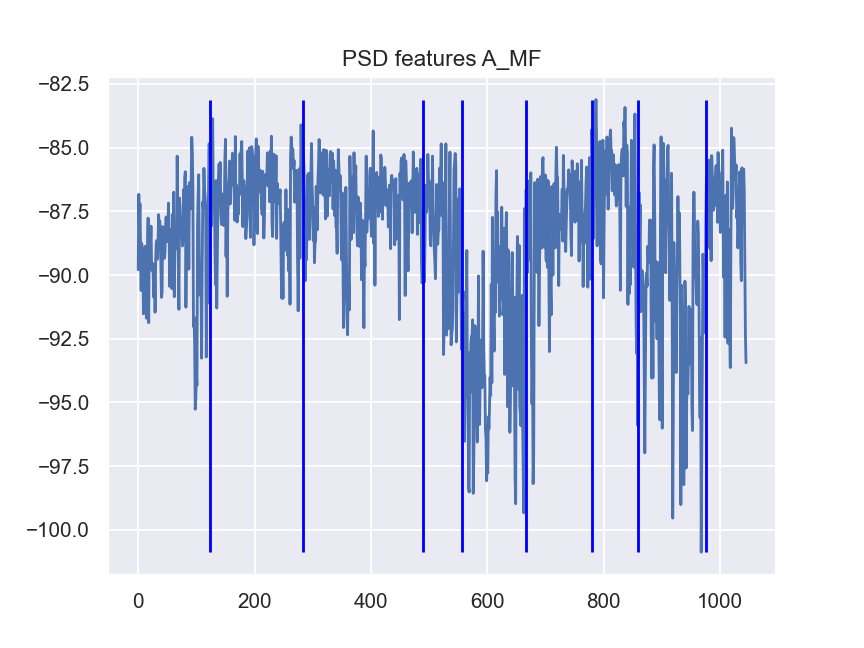

<IPython.core.display.Javascript object>


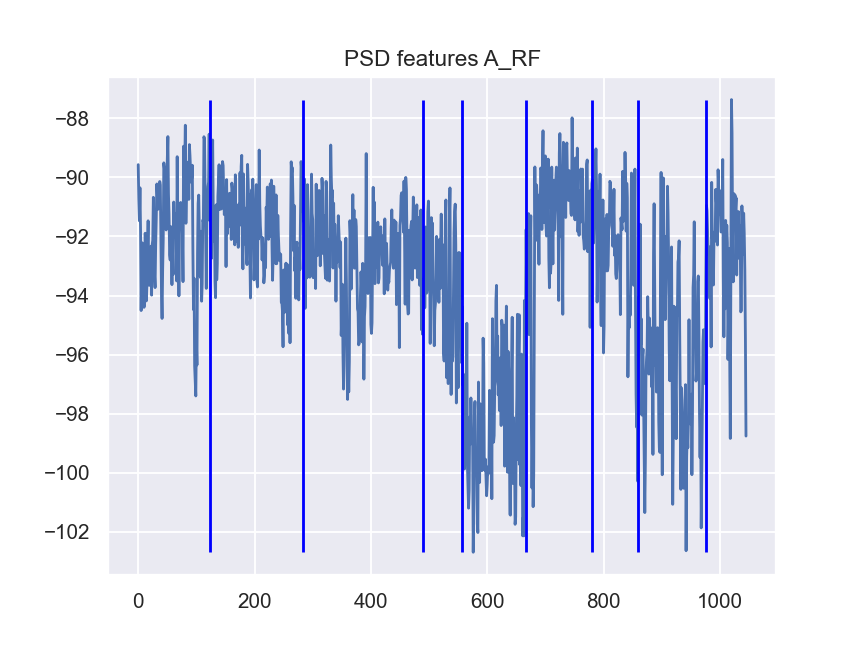

<IPython.core.display.Javascript object>


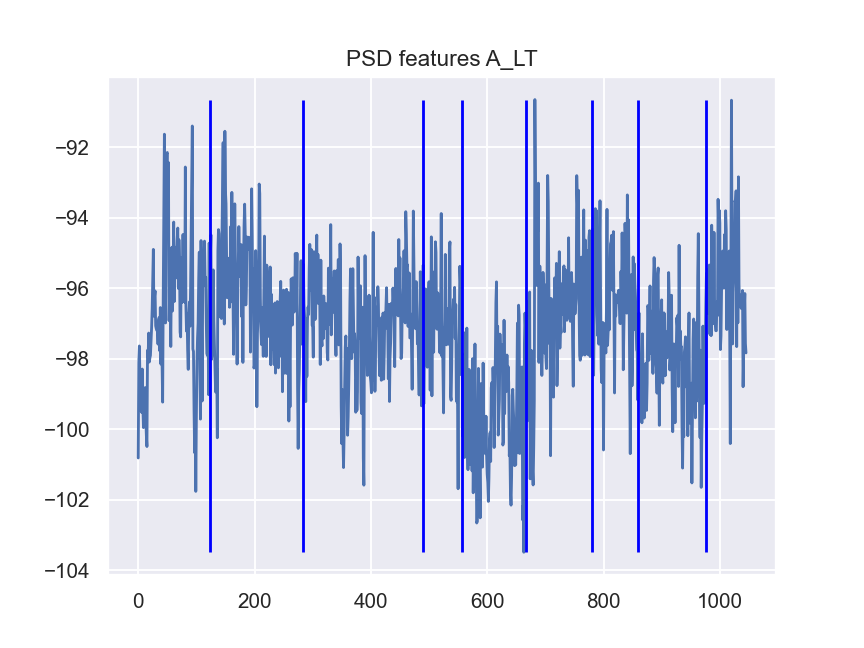

<IPython.core.display.Javascript object>


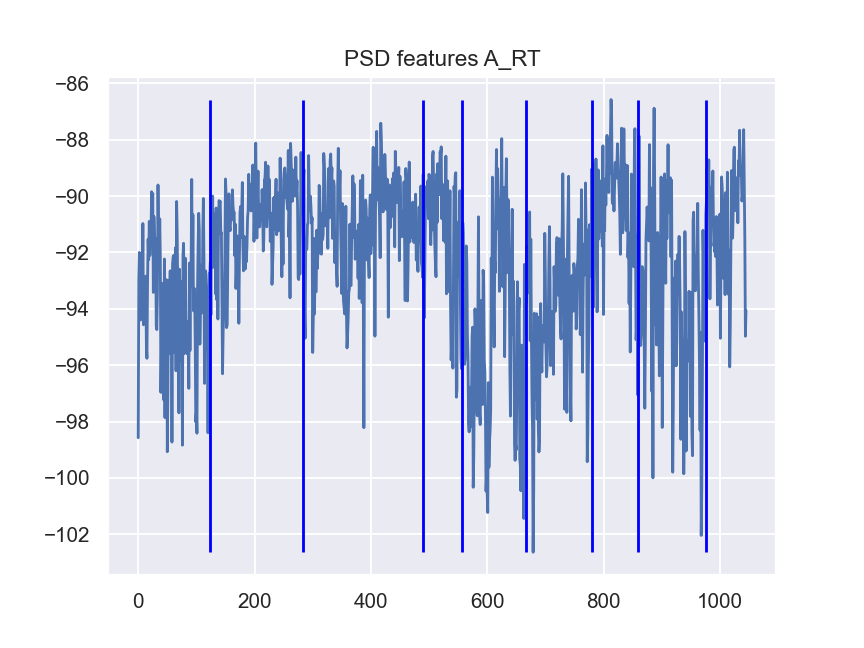

<IPython.core.display.Javascript object>


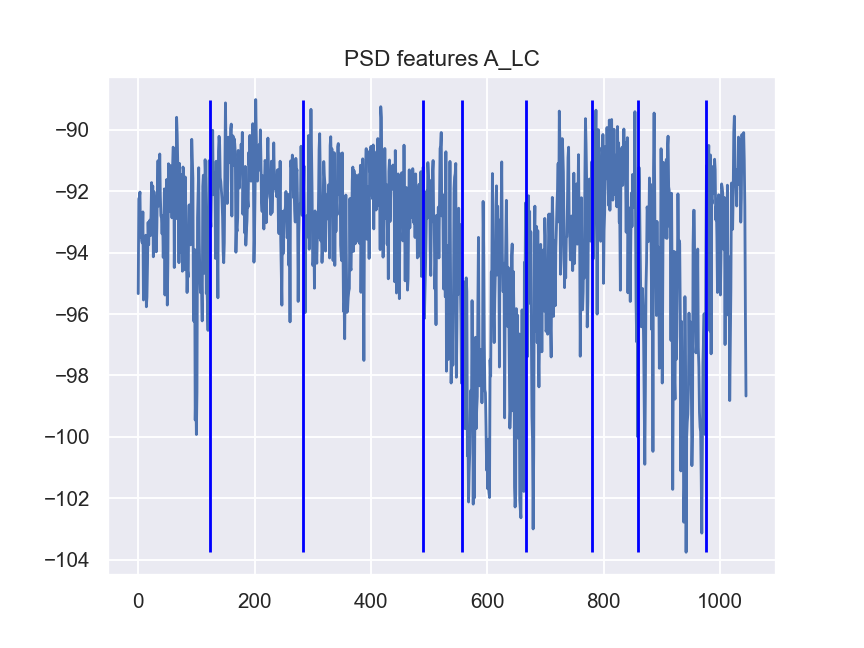

<IPython.core.display.Javascript object>


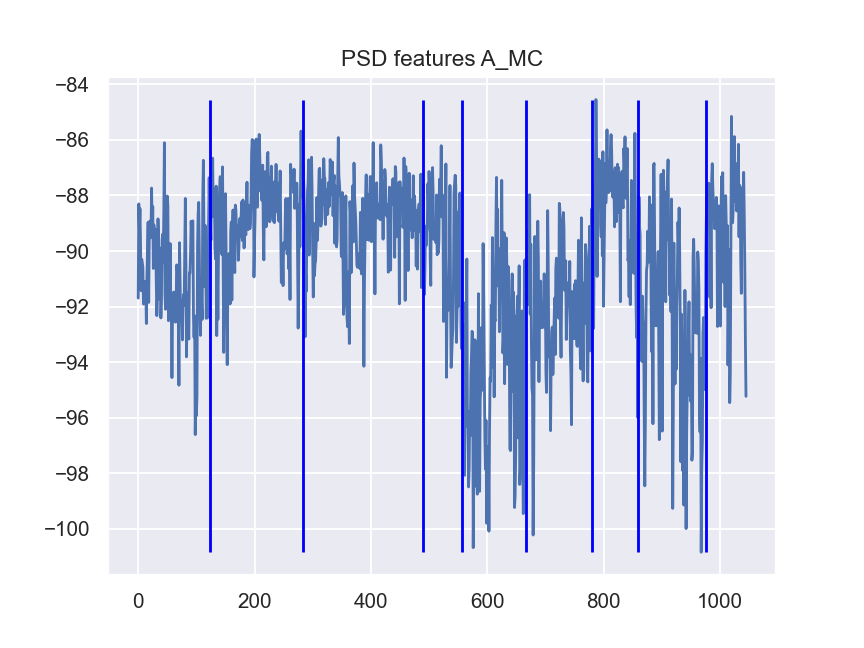

<IPython.core.display.Javascript object>


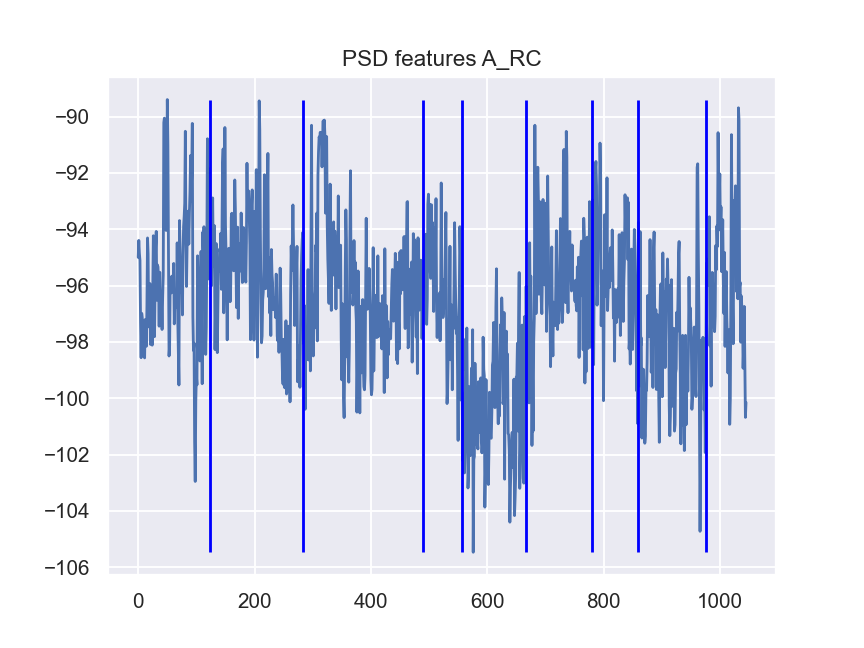

<IPython.core.display.Javascript object>


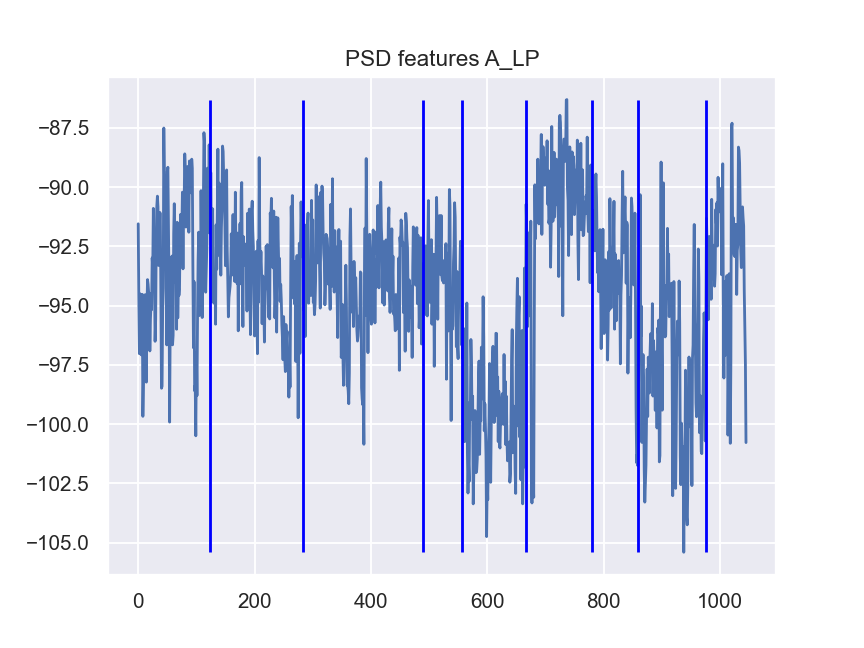

<IPython.core.display.Javascript object>


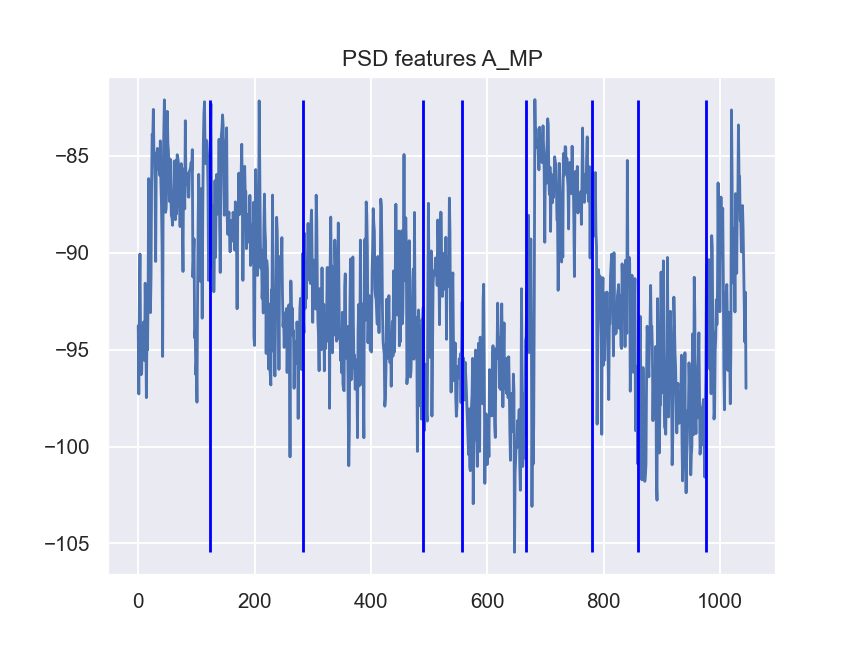

<IPython.core.display.Javascript object>


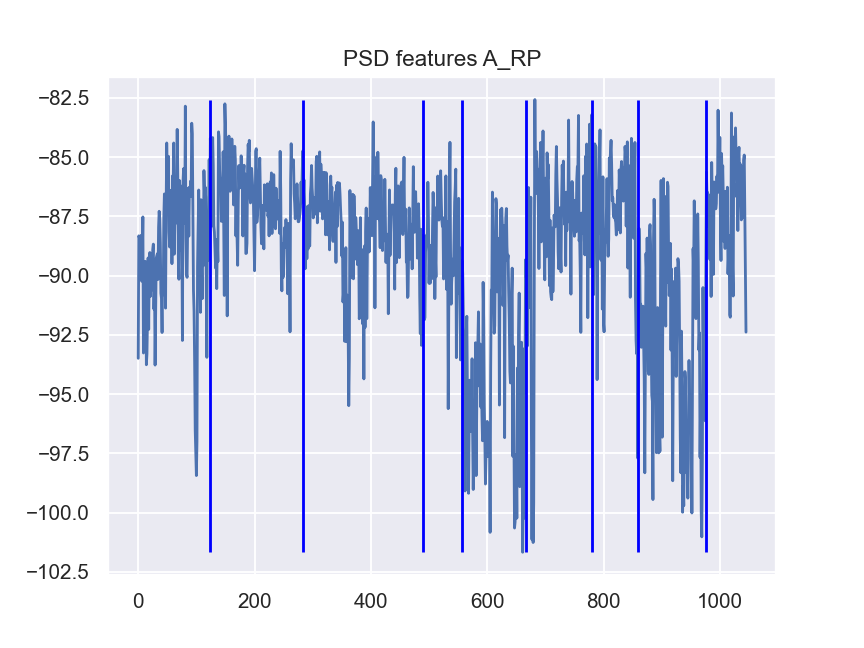

<IPython.core.display.Javascript object>


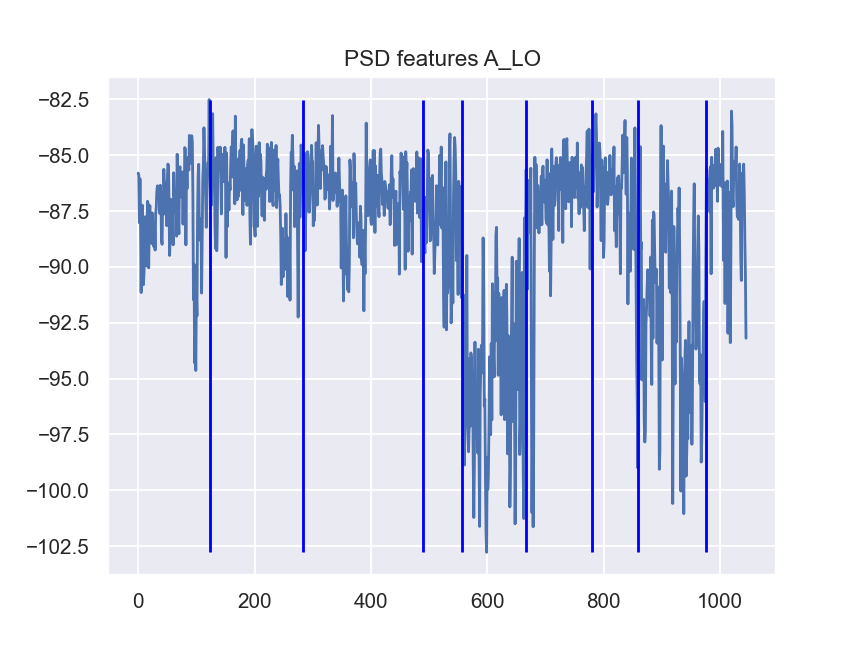

<IPython.core.display.Javascript object>


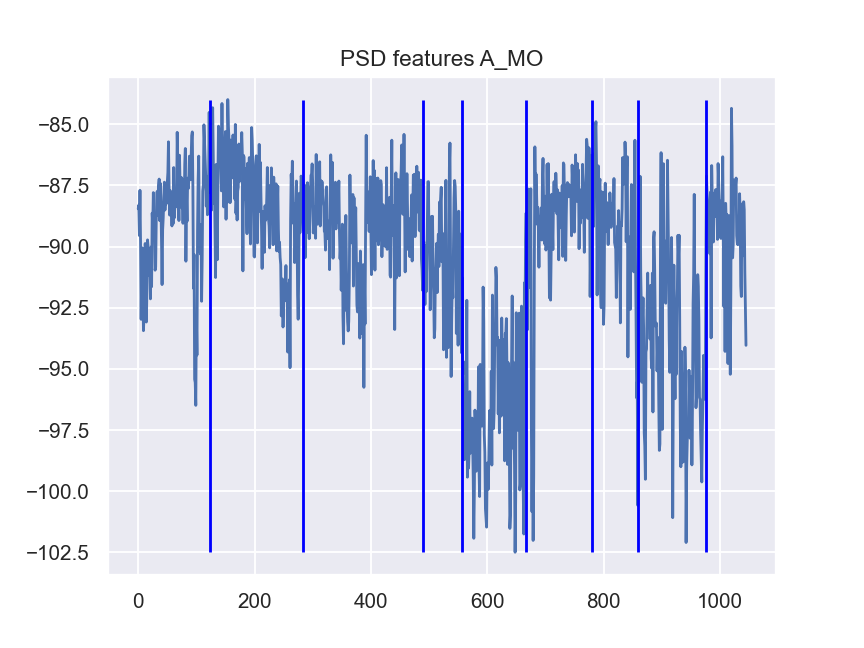

<IPython.core.display.Javascript object>


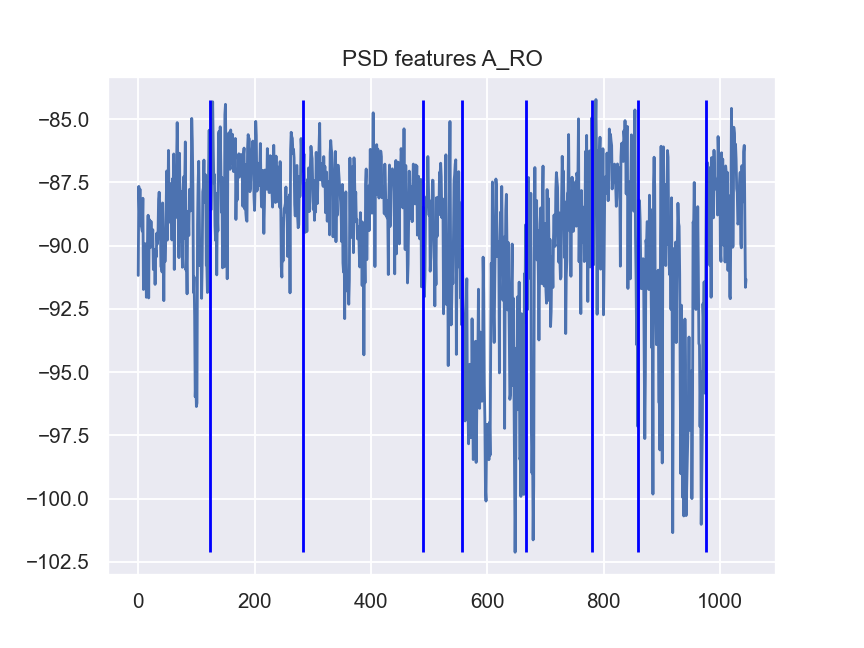

<IPython.core.display.Javascript object>


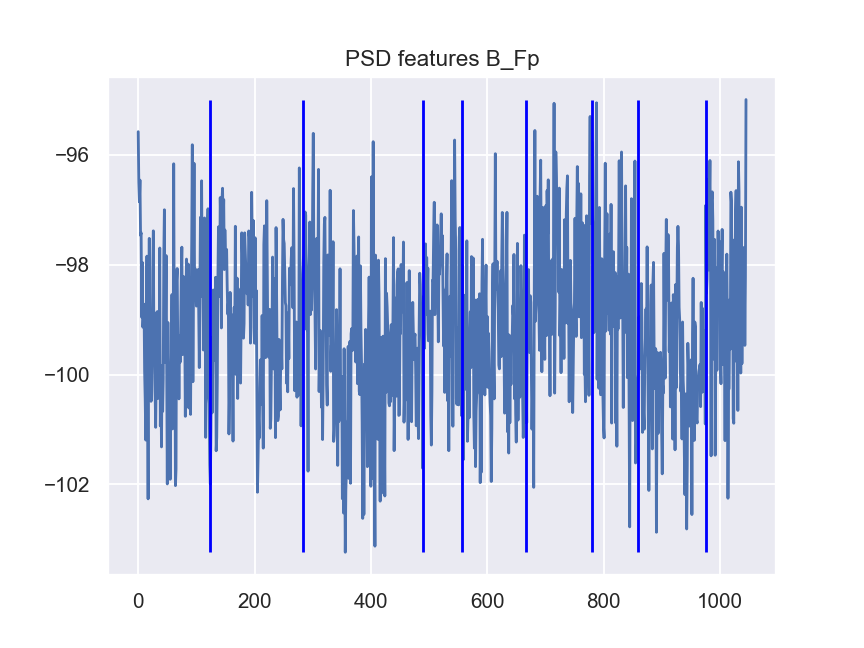

<IPython.core.display.Javascript object>


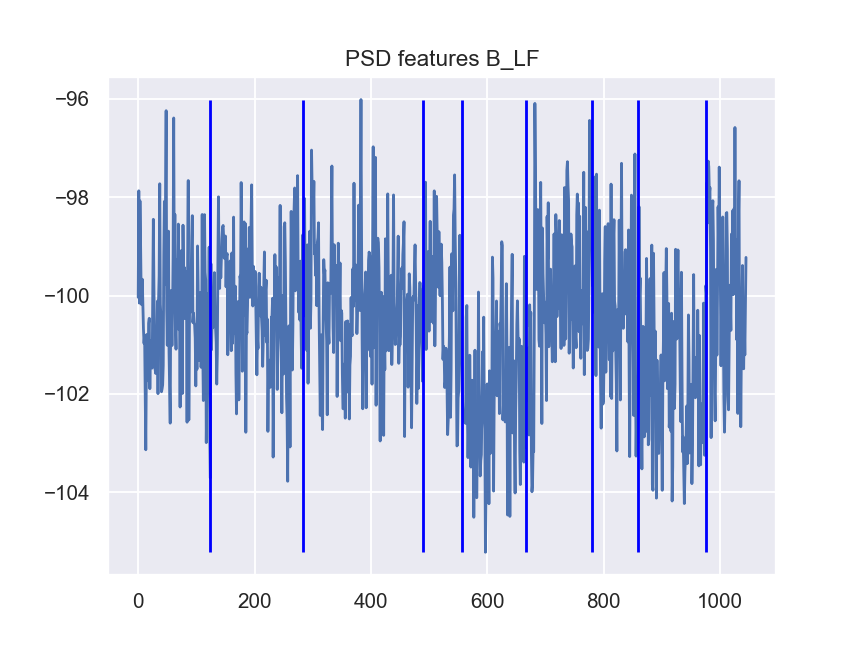

<IPython.core.display.Javascript object>


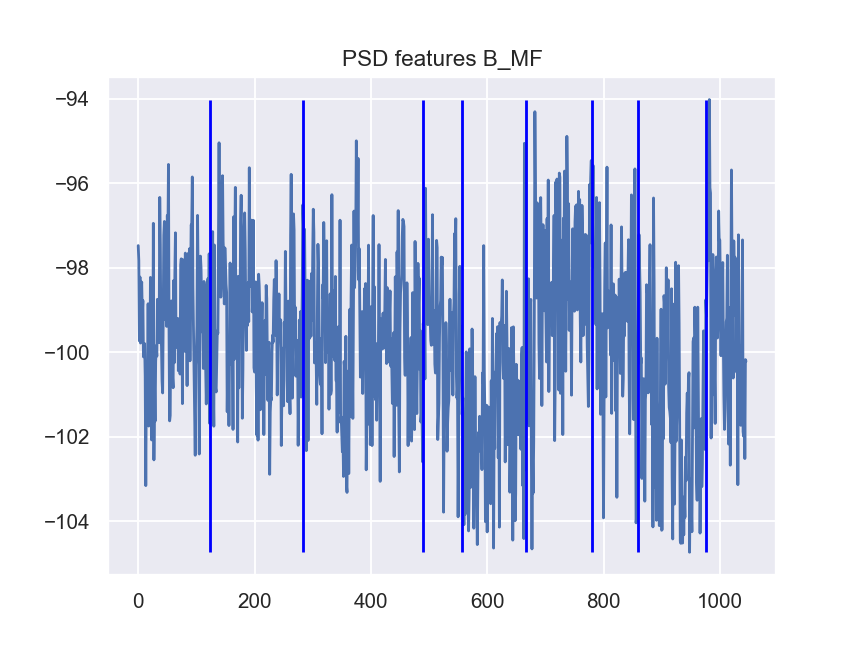

<IPython.core.display.Javascript object>


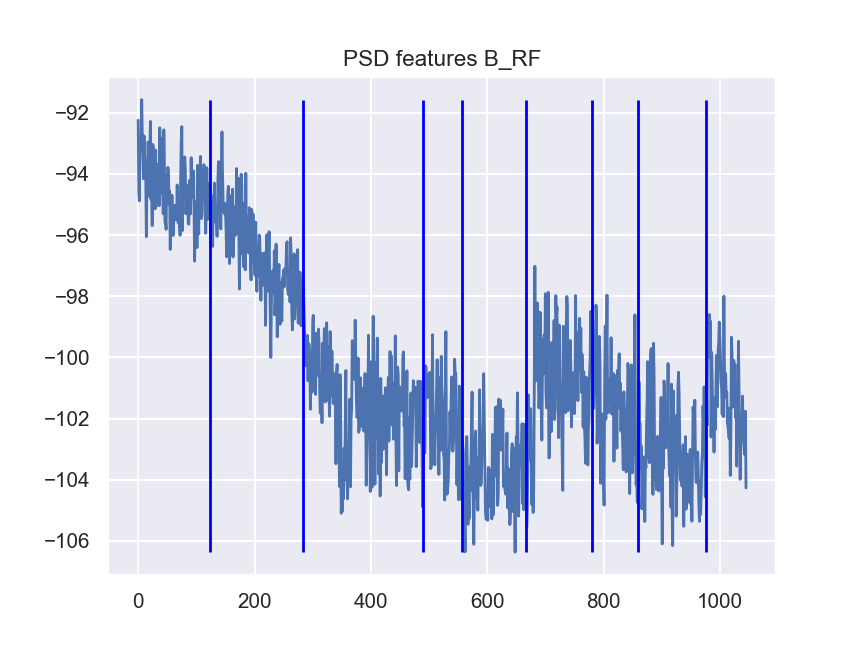

<IPython.core.display.Javascript object>


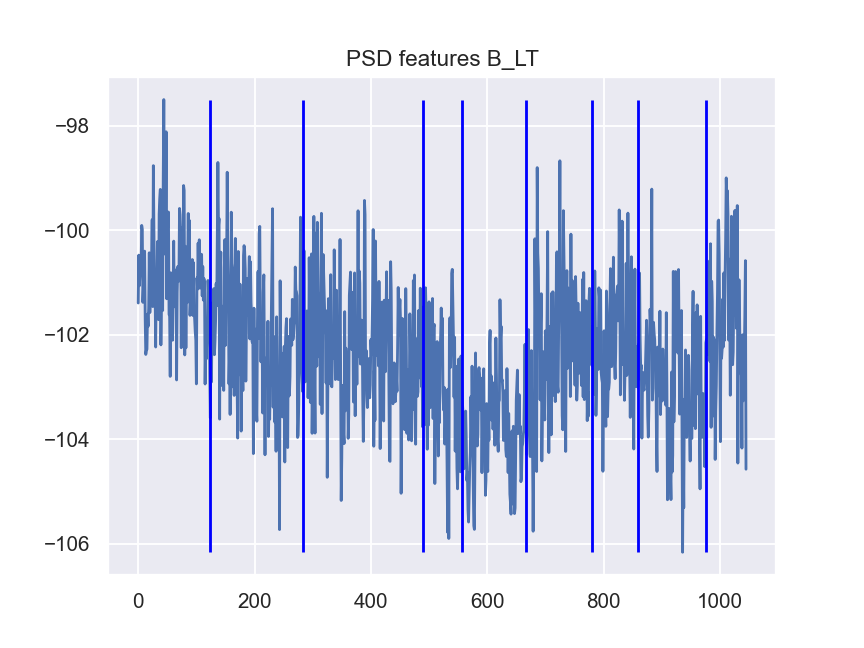

<IPython.core.display.Javascript object>


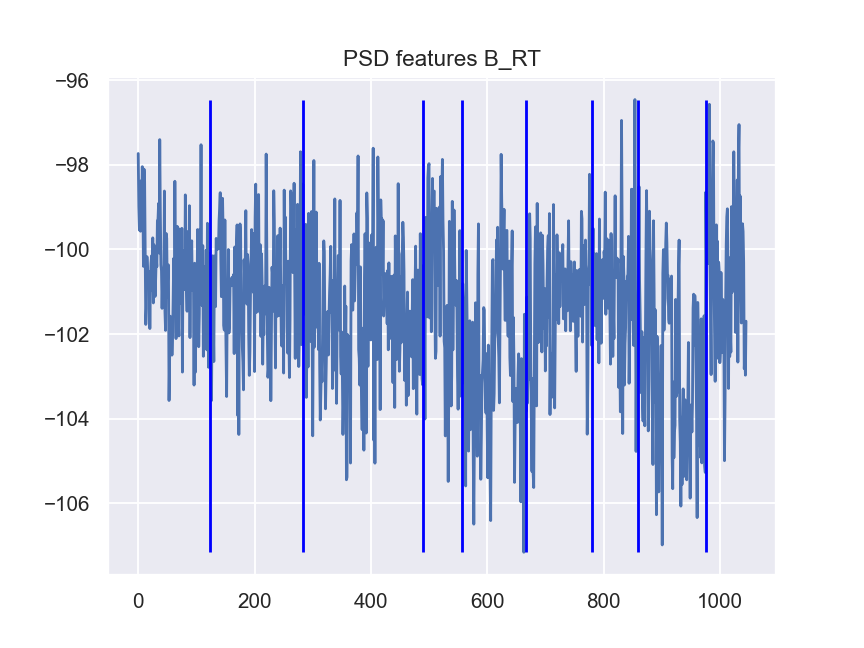

<IPython.core.display.Javascript object>


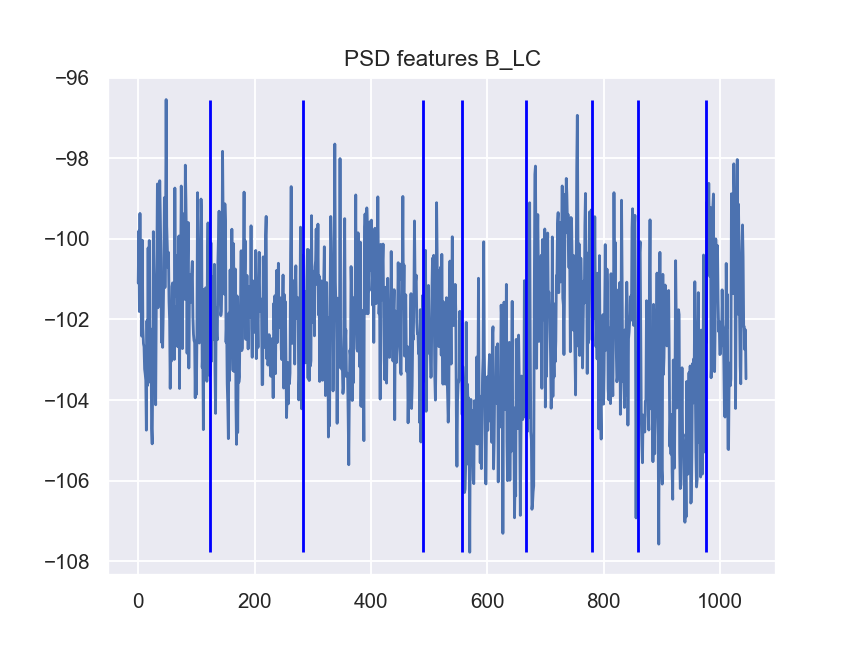

<IPython.core.display.Javascript object>


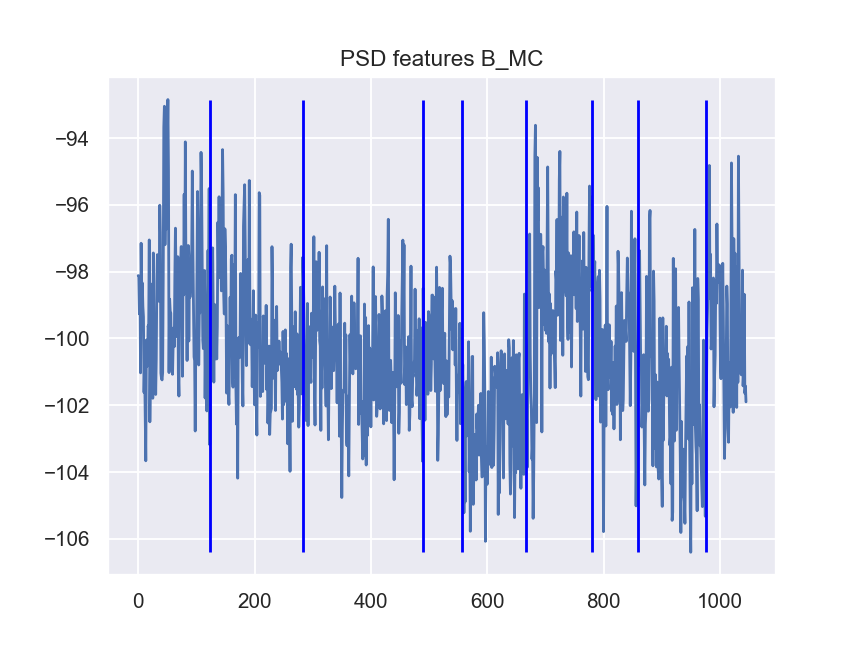

<IPython.core.display.Javascript object>


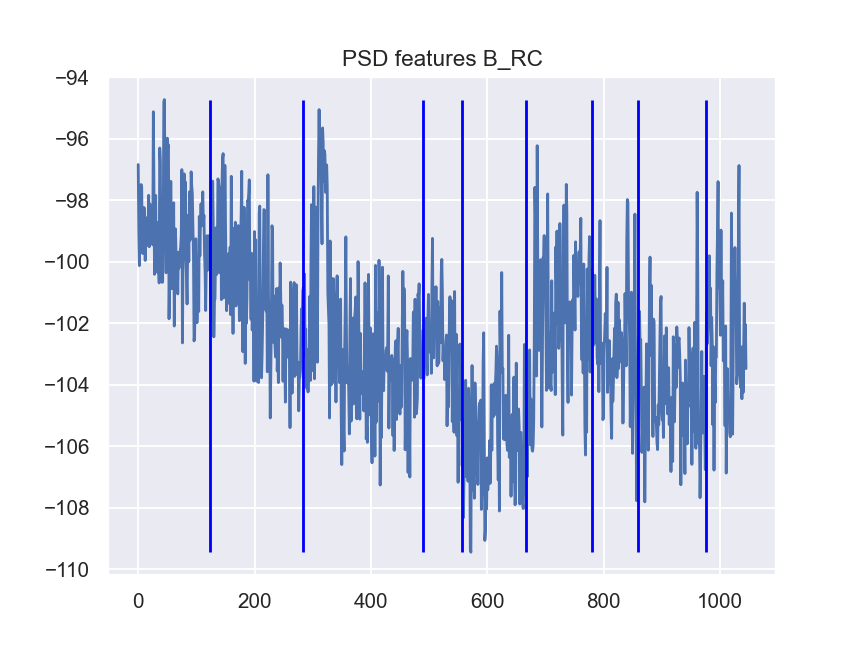

<IPython.core.display.Javascript object>


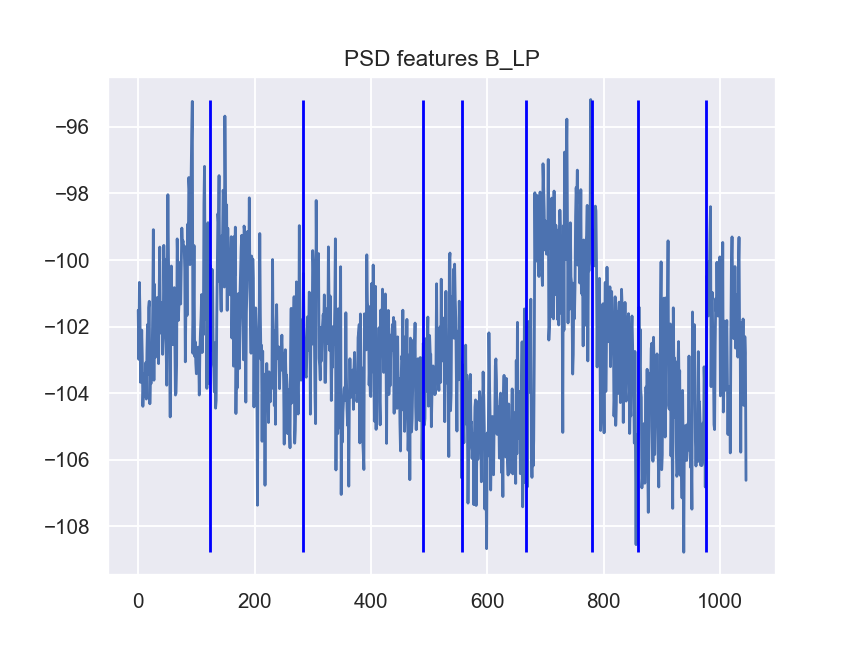

<IPython.core.display.Javascript object>


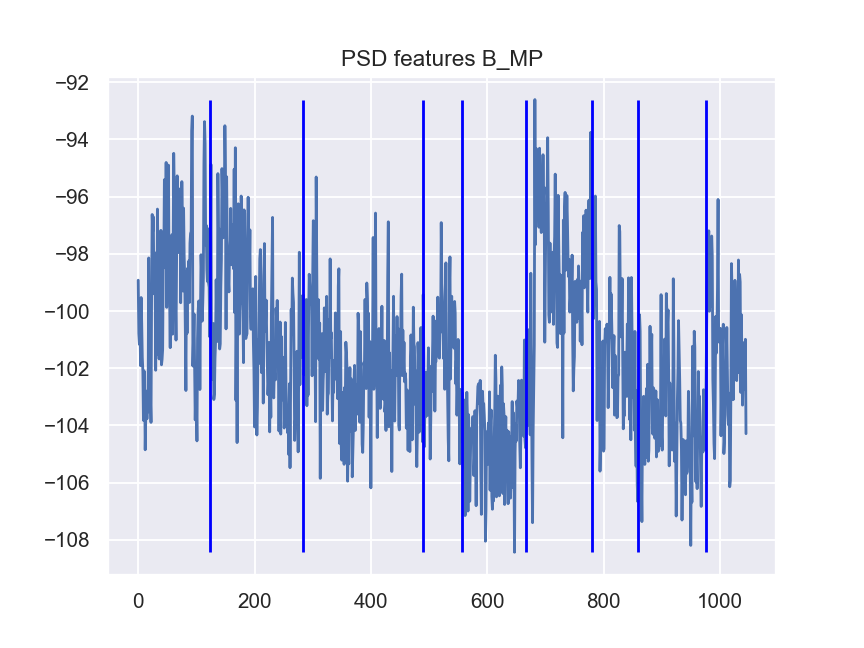

<IPython.core.display.Javascript object>


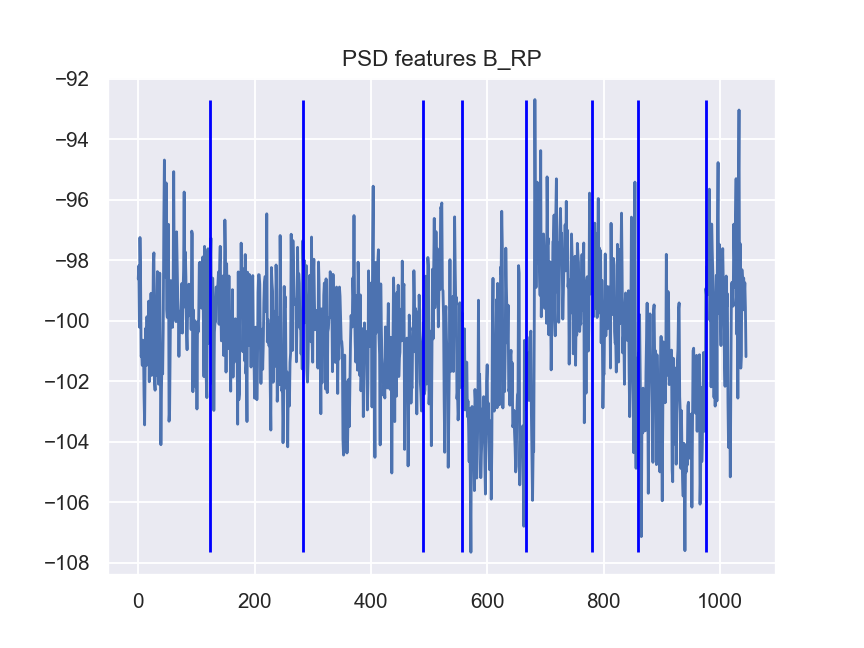

<IPython.core.display.Javascript object>


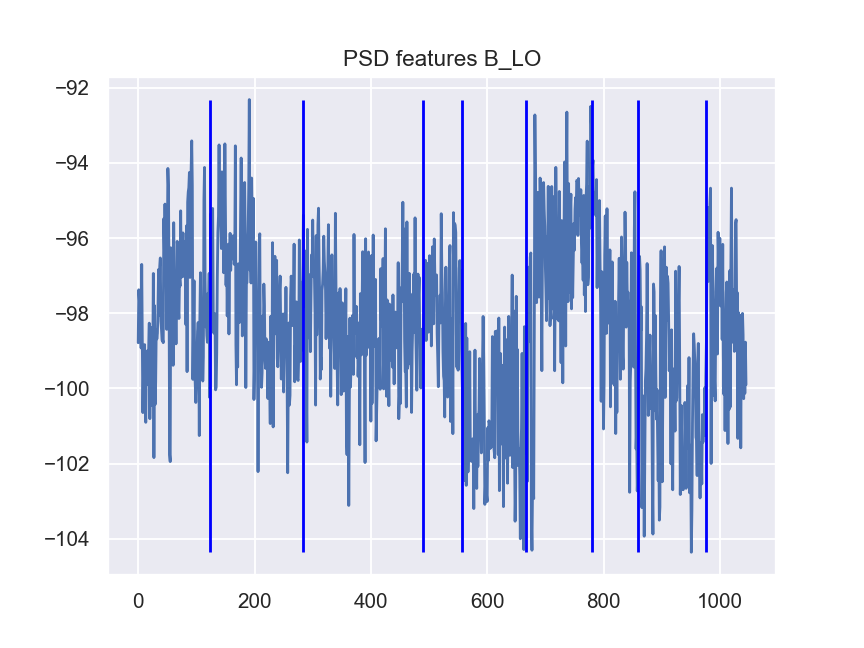

<IPython.core.display.Javascript object>


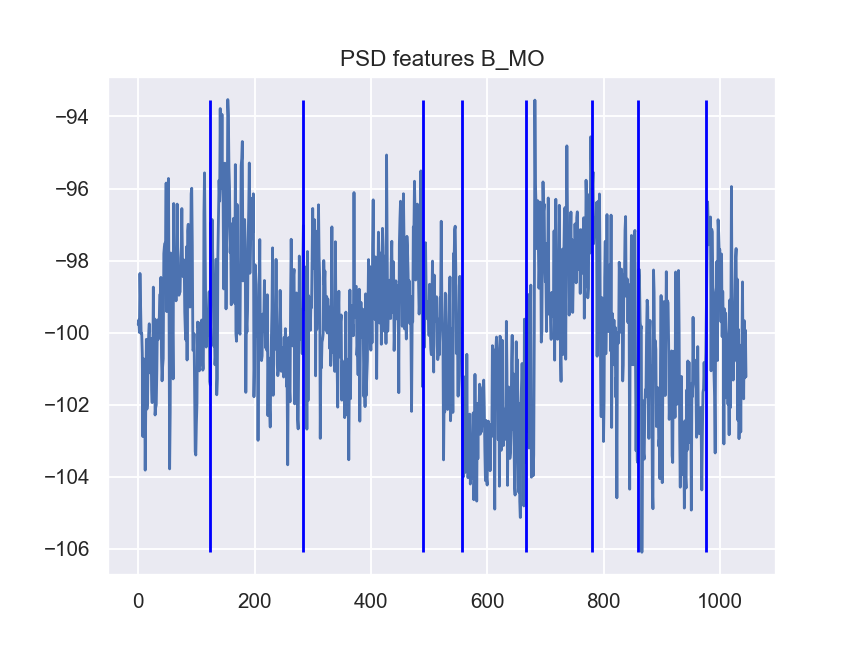

<IPython.core.display.Javascript object>


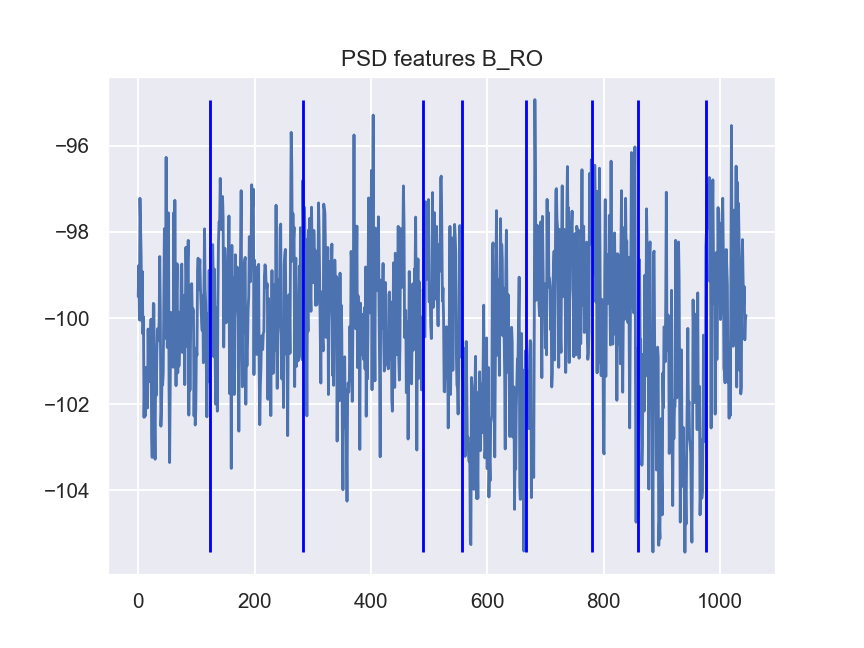

<IPython.core.display.Javascript object>


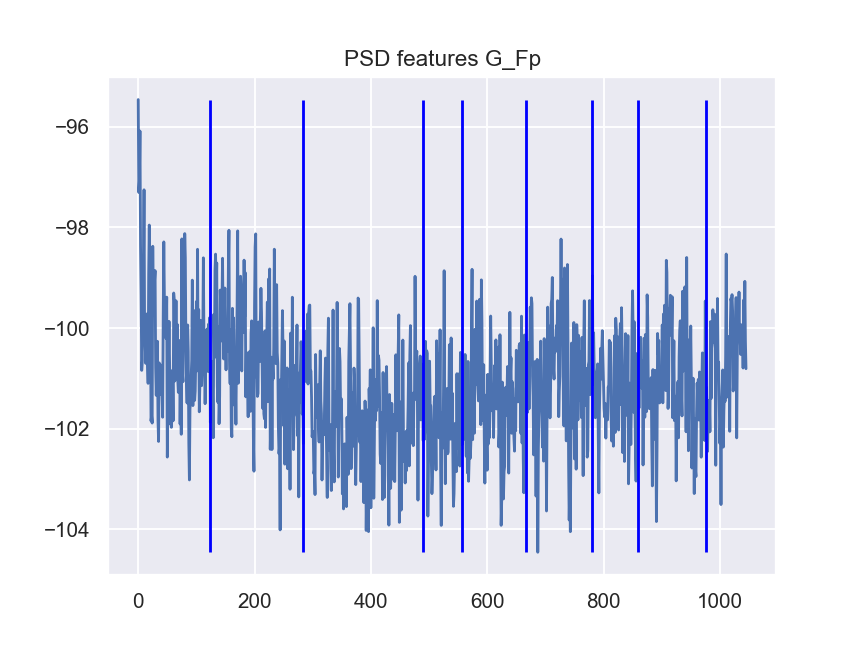

<IPython.core.display.Javascript object>


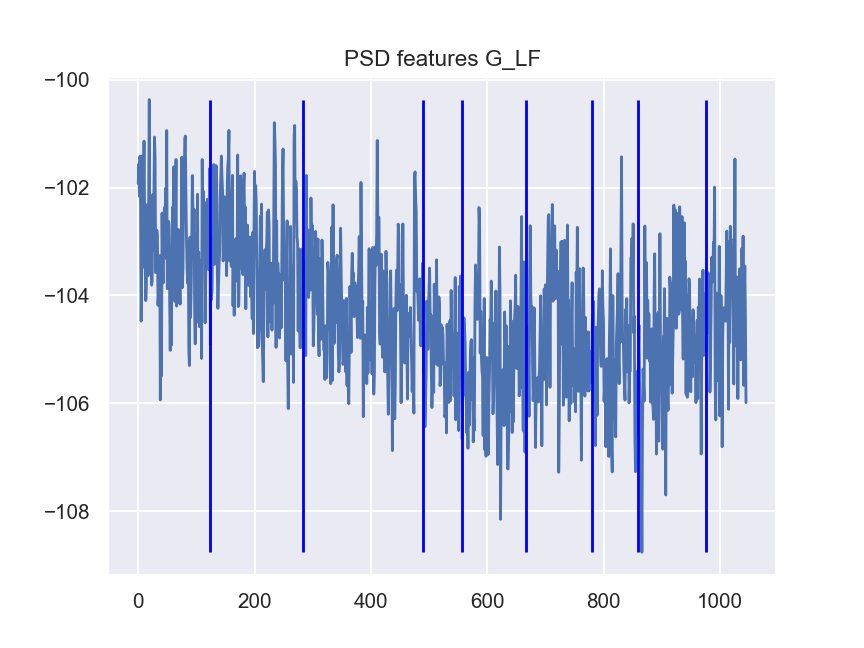

<IPython.core.display.Javascript object>


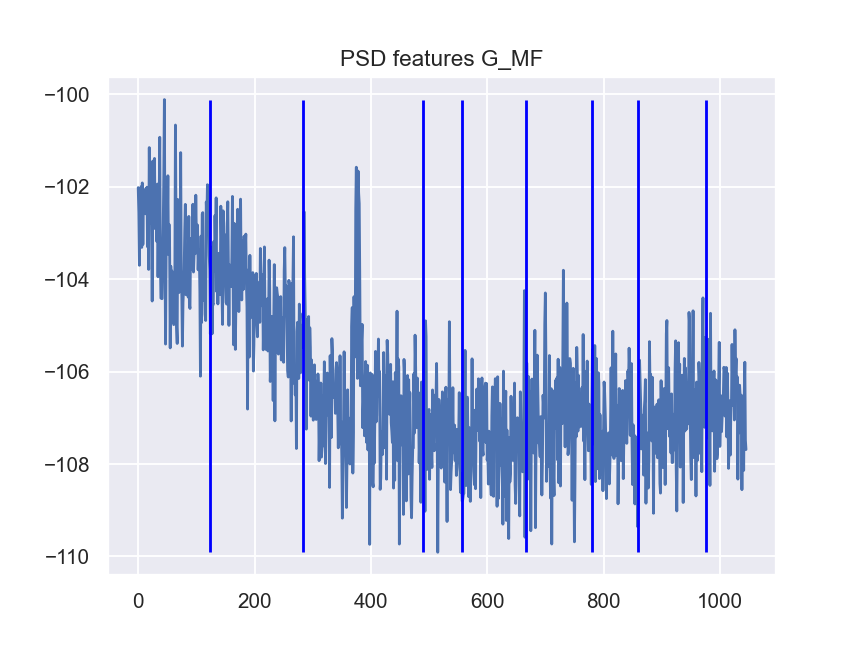

<IPython.core.display.Javascript object>


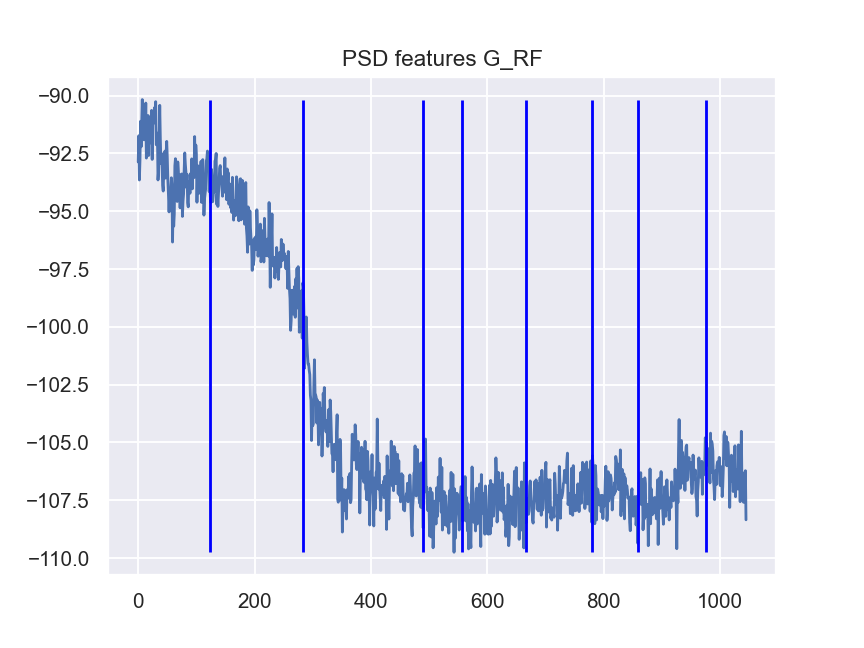

<IPython.core.display.Javascript object>


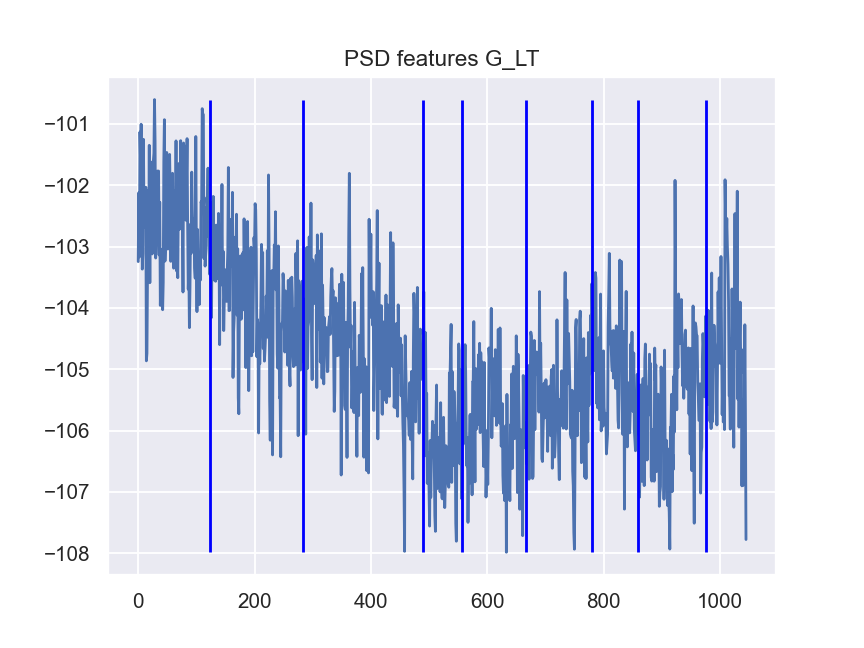

<IPython.core.display.Javascript object>


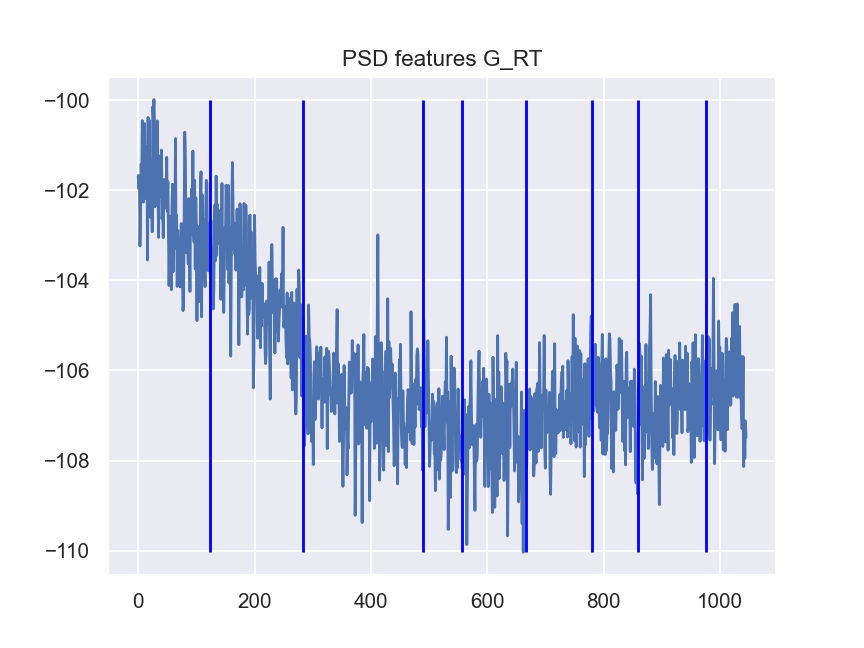

<IPython.core.display.Javascript object>


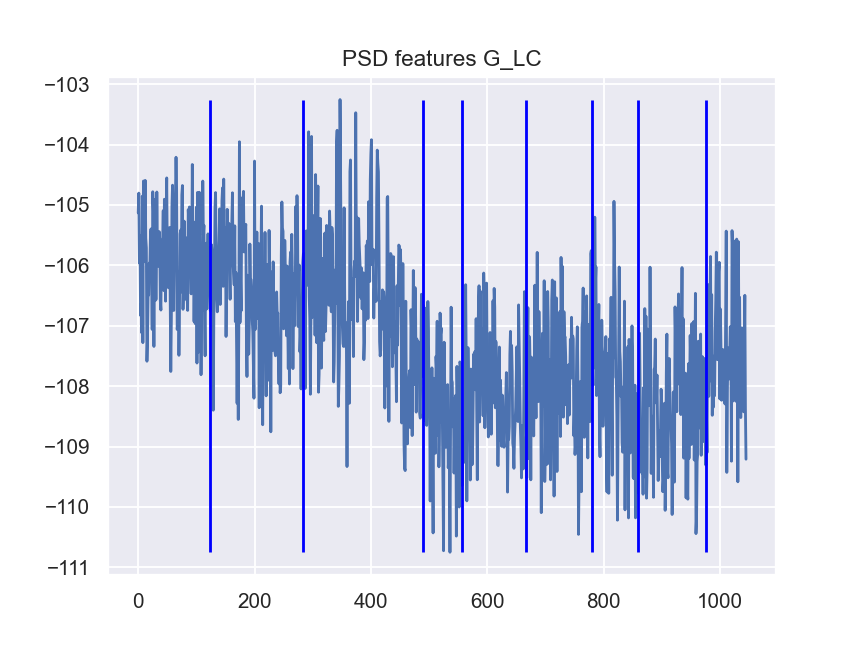

<IPython.core.display.Javascript object>


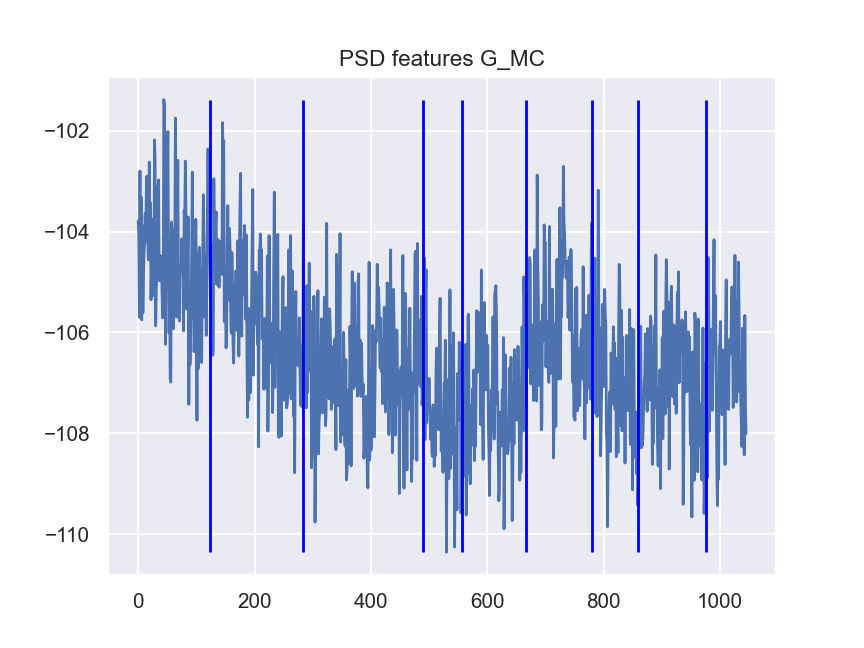

<IPython.core.display.Javascript object>


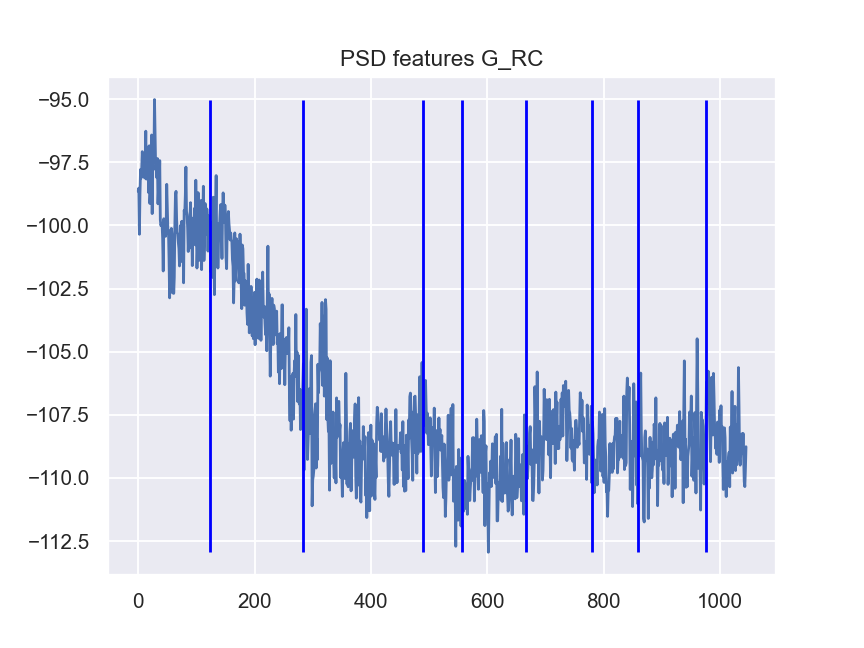

<IPython.core.display.Javascript object>


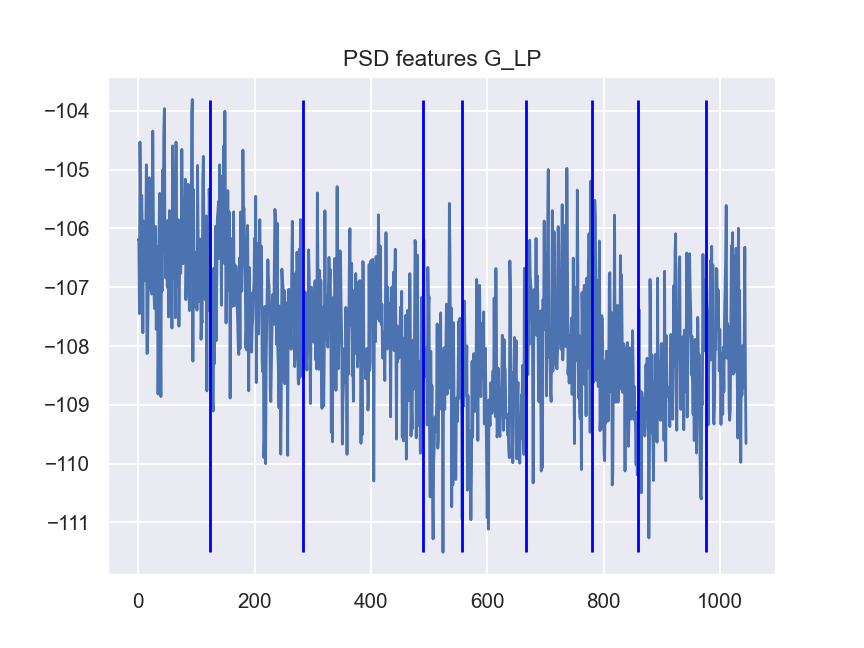

<IPython.core.display.Javascript object>


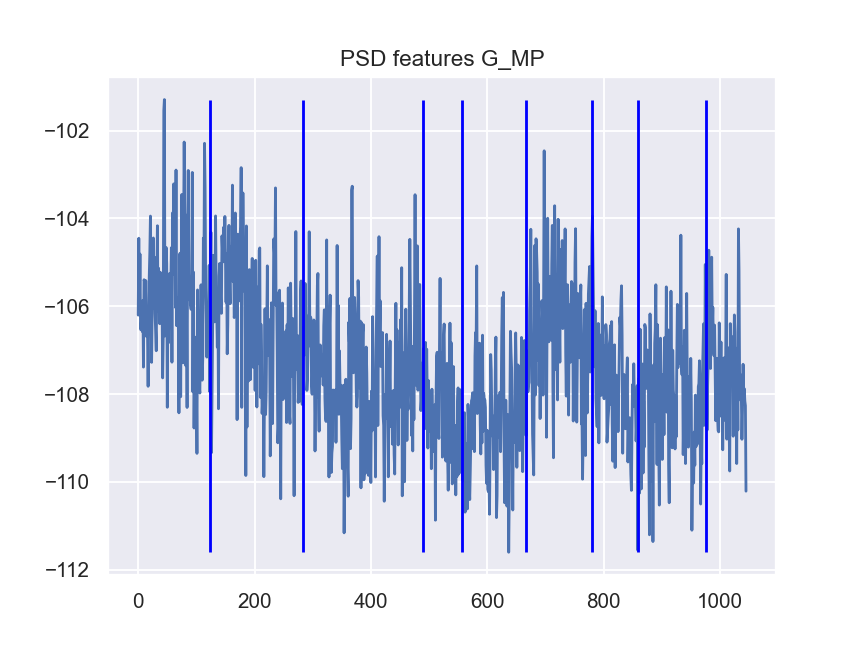

<IPython.core.display.Javascript object>


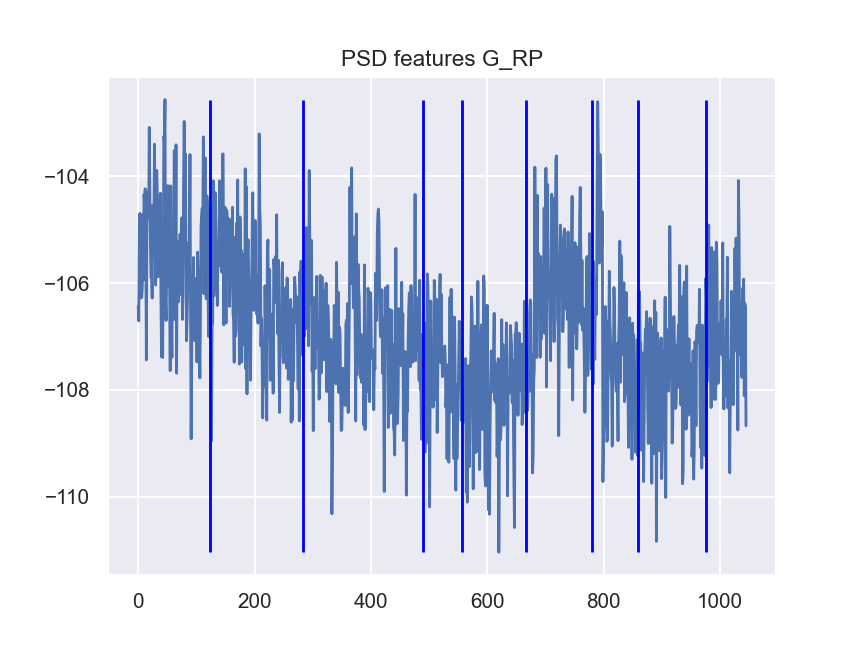

<IPython.core.display.Javascript object>


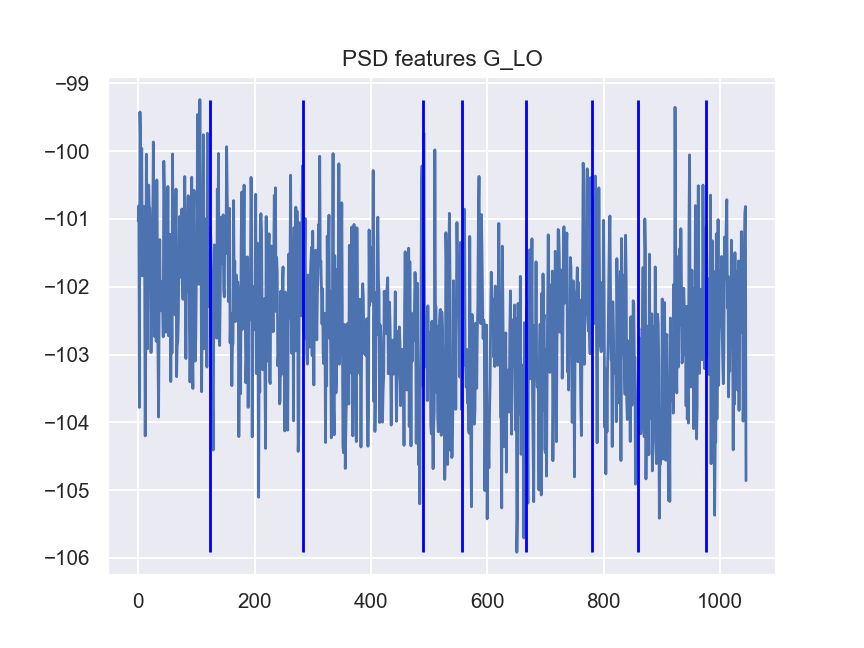

<IPython.core.display.Javascript object>


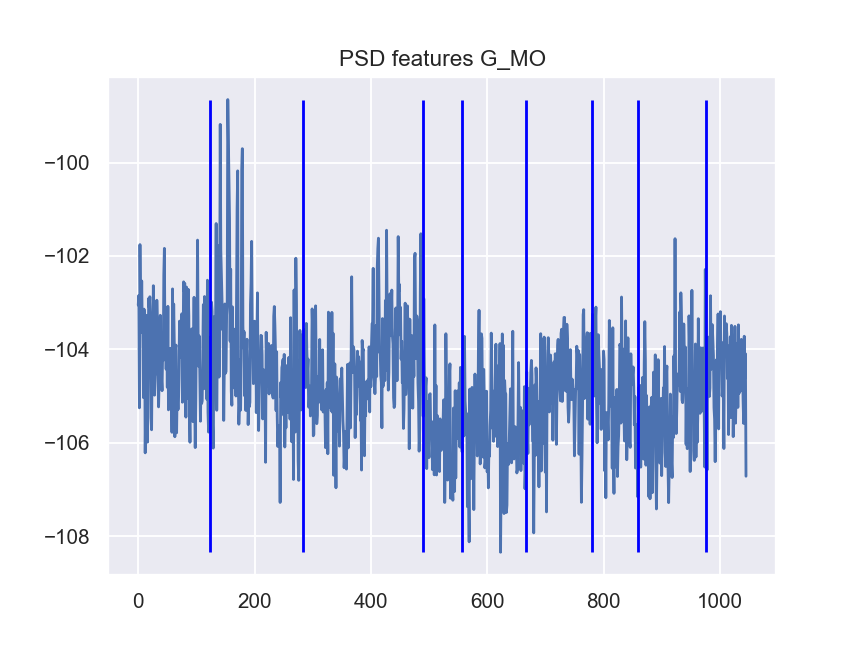

<IPython.core.display.Javascript object>


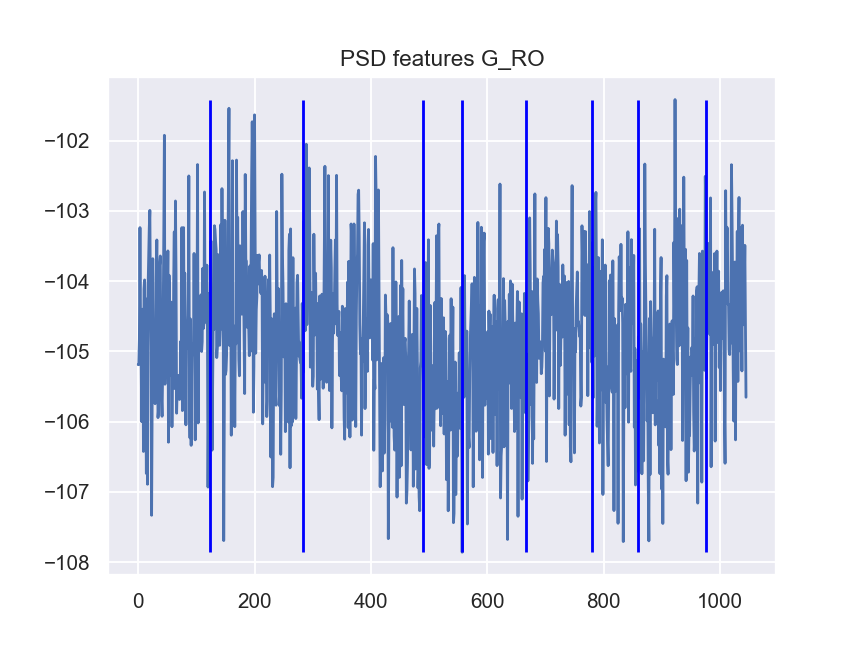

In [28]:
# Plotting features (averaged by regions) with stage bounds

df_ft_loc = df_ft_psd_loc_db
for i in range(len(df_ft_loc.columns)):
    fig, ax = plt.subplots() 
    y = df_ft_loc.to_numpy()[:,i]
    ax.plot(y)
    ax.vlines(x=st_edges_median[1:-1], ymin=np.min(y), ymax=np.max(y), color='blue')
    ax.set_title("PSD features "+ df_ft_loc.columns[i]) 


# Plotting features by stages

<IPython.core.display.Javascript object>


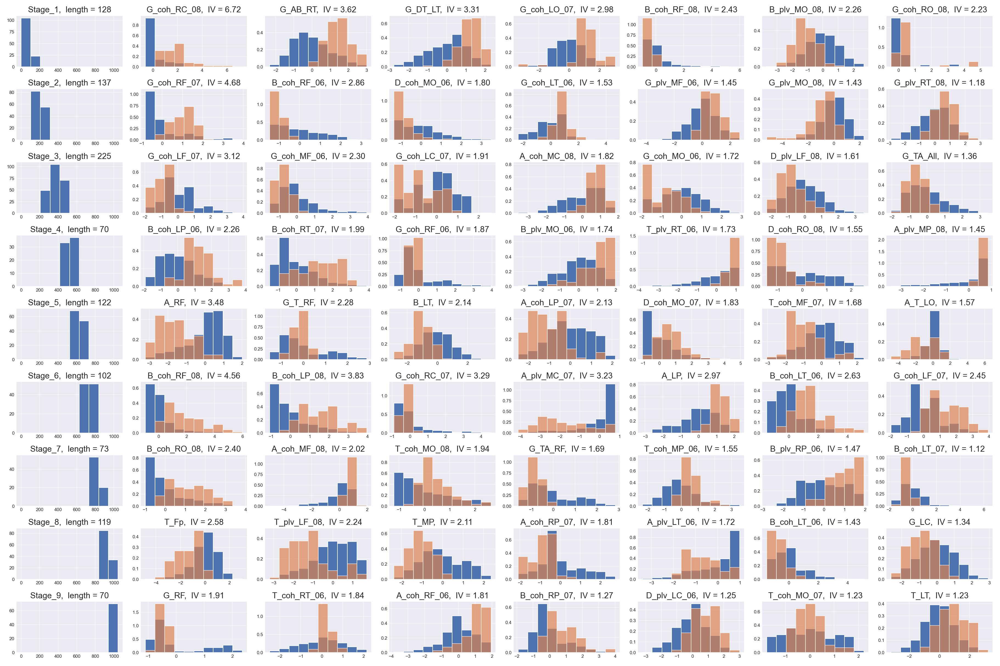

(<Figure size 2700x1800 with 72 Axes>,
 array([[<AxesSubplot:title={'center':'Stage_1,  length = 128'}>,
         <AxesSubplot:title={'center':'G_coh_RC_08,  IV = 6.72'}>,
         <AxesSubplot:title={'center':'G_AB_RT,  IV = 3.62'}>,
         <AxesSubplot:title={'center':'G_DT_LT,  IV = 3.31'}>,
         <AxesSubplot:title={'center':'G_coh_LO_07,  IV = 2.98'}>,
         <AxesSubplot:title={'center':'B_coh_RF_08,  IV = 2.43'}>,
         <AxesSubplot:title={'center':'B_plv_MO_08,  IV = 2.26'}>,
         <AxesSubplot:title={'center':'G_coh_RO_08,  IV = 2.23'}>],
        [<AxesSubplot:title={'center':'Stage_2,  length = 137'}>,
         <AxesSubplot:title={'center':'G_coh_RF_07,  IV = 4.68'}>,
         <AxesSubplot:title={'center':'B_coh_RF_06,  IV = 2.86'}>,
         <AxesSubplot:title={'center':'D_coh_MO_06,  IV = 1.80'}>,
         <AxesSubplot:title={'center':'G_coh_LT_06,  IV = 1.53'}>,
         <AxesSubplot:title={'center':'G_plv_MF_06,  IV = 1.45'}>,
         <AxesSubplot:title={'ce

In [21]:
# Plotting overall best IV features

N_BEST_FEATURES = 7
df_features = df_ft_tot_orig

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)
            
best_IV_list, best_WoE_list = ve.best_IV_WoE_vars_clust(df_features, new_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)
ve.plot_hist_best_vars(df_features, new_labels, best_IV_list, title_prefix='Overall', stages=True)    
        

## Plotting PSD

<IPython.core.display.Javascript object>


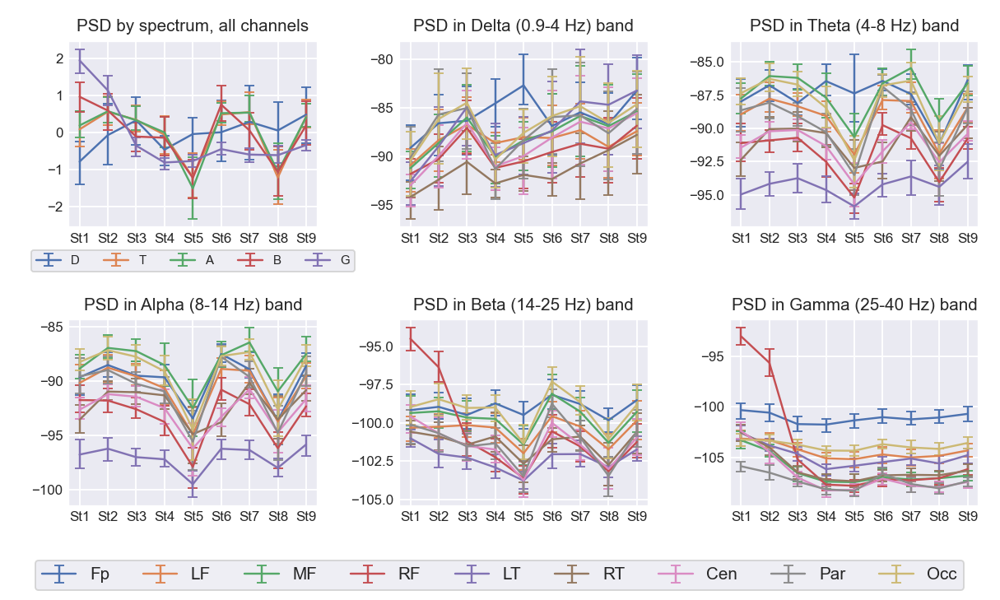

In [22]:
# PSD plot

df_ft_all = df_ft_psd_all_db_sc
df_ft_plt = df_ft_psd_plt_db

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)
n_stages = len(st_bands)

x = [cl for (_, _, cl) in st_bands]
n_cols = ceil((n_freq+1)/2.)
n_rows = 2
fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(3*n_cols, 2.7*n_rows))
plt.subplots_adjust(left=0.02)

# First plot
df_ft_clust = [df_ft_all.iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
df_ft_clust_stats = [df_ft_clust[_cl].describe() for _cl in range(n_stages)]
for _freq in range(n_freq):
    y = [df_ft_clust_stats[_cl].loc['mean'][_freq] for _cl in range(n_stages)]
    yerr = np.array([df_ft_clust_stats[_cl].loc[['25%','75%']].to_numpy() 
                     for _cl in range(n_stages)])[:,:,_freq].transpose(1,0)
    yerr[0,:] = y - yerr[0,:]
    yerr[1,:] = yerr[1,:] - y
    #print(yerr)
    axs[0,0].errorbar(x, y, yerr, label=str_freq[_freq], capsize=3, linewidth=1.3)
axs[0,0].set_title("PSD by spectrum, all channels", fontsize=11) 
axs[0,0].tick_params(axis='both', labelsize=9, direction='in')#, grid_alpha=0.5)
axs[0,0].legend(loc='lower center', ncol=n_freq, bbox_to_anchor=(0.5, -0.27), fontsize=8)

# All other plots
df_ft_clust = [df_ft_plt.iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
df_ft_clust_stats = [df_ft_clust[_cl].describe() for _cl in range(n_stages)]
for _freq in range(n_freq):
    band_columns = [col for col in df_ft_plt.columns if col.startswith(str_freq_rr[_freq])]
    df_ft_cl_stats_band = [df_ft_clust_stats[i][band_columns] for i in range(n_stages)]
    for _reg in range(n_regions_plt):
        y = [df_ft_cl_stats_band[i].loc['mean'][_reg] for i in range(n_stages)]
        yerr = np.array([df_ft_cl_stats_band[i].loc[['25%','75%']].to_numpy() 
                         for i in range(n_stages)])[:,:,_reg].transpose(1,0)
        yerr[0,:] = y - yerr[0,:]
        yerr[1,:] = yerr[1,:] - y
        #print(yerr)
        axs[(_freq+1)//n_cols, (_freq+1)%n_cols].errorbar(x, y, yerr, label=regions_plt[_reg][1], capsize=3, linewidth=1.3)
    axs[(_freq+1)//n_cols, (_freq+1)%n_cols].set_title('PSD in ' + bands[_freq][2] + ' band', fontsize=11) 
    axs[(_freq+1)//n_cols, (_freq+1)%n_cols].tick_params(axis='both', labelsize=9, direction='in')#, grid_alpha=0.5)

plt.tight_layout(rect=[0,0.09,1,1])

handles, labels = axs[-1,-1].get_legend_handles_labels()
#fig.suptitle('PSD in brain regions by spectrum')
fig.legend(handles, labels, loc='lower center', ncol=n_regions_plt)#, bbox_to_anchor=(0.5, -0.05))
plt.savefig('PSD plots.png')


<IPython.core.display.Javascript object>


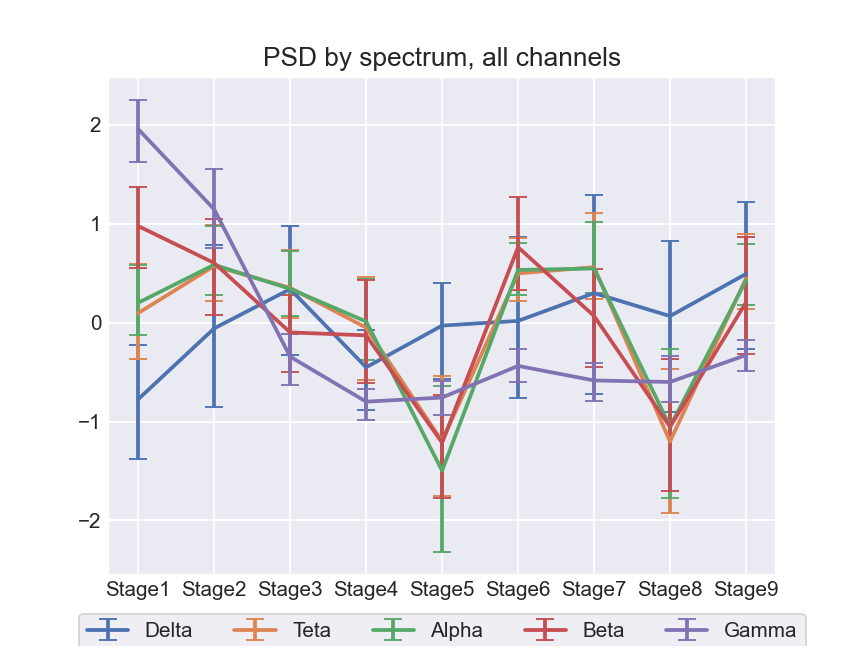

In [147]:
df_ft_all = df_ft_psd_all_db_sc

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)
n_stages = len(st_bands)

freq_names = ['Delta', 'Teta', 'Alpha', 'Beta', 'Gamma']
stage_names = ['Stage'+str(i+1) for i in range(n_stages)]

x = [_st for _st in stage_names]
n_cols = ceil((n_freq+1)/2.)
n_rows = 2
fig, ax = plt.subplots()

# First plot
df_ft_clust = [df_ft_all.iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
df_ft_clust_stats = [df_ft_clust[_cl].describe() for _cl in range(n_stages)]
for _freq in range(n_freq):
    y = [df_ft_clust_stats[_cl].loc['mean'][_freq] for _cl in range(n_stages)]
    yerr = np.array([df_ft_clust_stats[_cl].loc[['25%','75%']].to_numpy() 
                     for _cl in range(n_stages)])[:,:,_freq].transpose(1,0)
    yerr[0,:] = y - yerr[0,:]
    yerr[1,:] = yerr[1,:] - y
    #print(yerr)
    ax.errorbar(x, y, yerr, label=freq_names[_freq], capsize=5, linewidth=2)
ax.set_title("PSD by spectrum, all channels", fontsize=14) 
ax.tick_params(axis='both', direction='in')#, grid_alpha=0.5)
ax.legend(loc='lower center', ncol=n_freq, bbox_to_anchor=(0.5, -0.17))
plt.savefig('PSD overall plot.png')

In [138]:
# PSD best IV features

N_BEST_FEATURES = 7

df_features = df_ft_psd_loc_db

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)

best_IV_list, best_WoE_list = ve.best_IV_WoE_vars_clust(df_features, new_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.3)

ve.plot_hist_best_vars(df_features, new_labels, best_IV_list, title_prefix='PSD')

KeyboardInterrupt: 

## Plotting PSD Indices

<IPython.core.display.Javascript object>


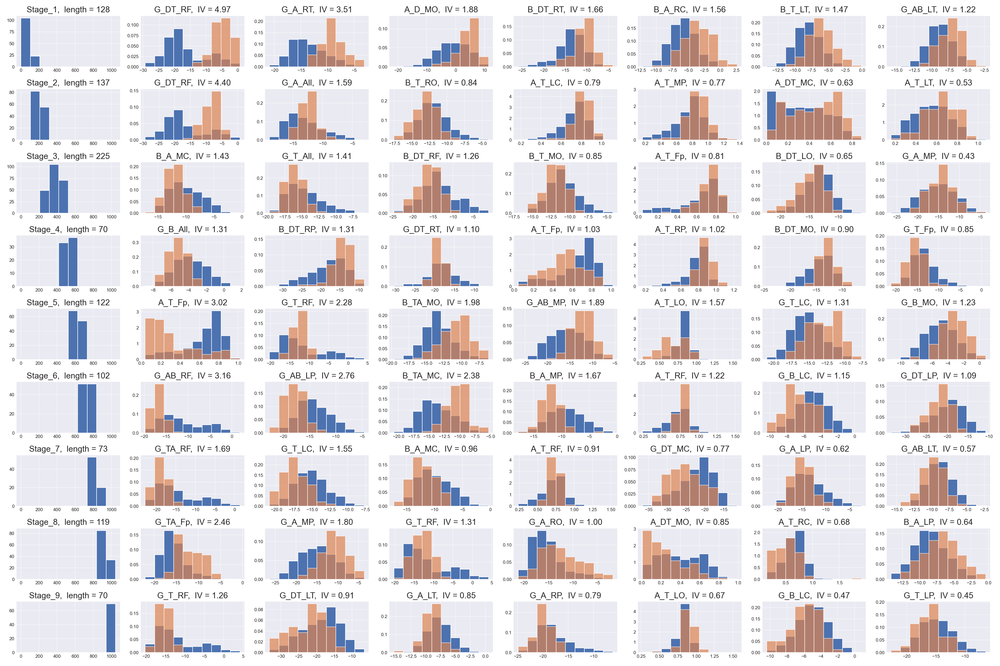

(<Figure size 2700x1800 with 72 Axes>,
 array([[<AxesSubplot:title={'center':'Stage_1,  length = 128'}>,
         <AxesSubplot:title={'center':'G_DT_RF,  IV = 4.97'}>,
         <AxesSubplot:title={'center':'G_A_RT,  IV = 3.51'}>,
         <AxesSubplot:title={'center':'A_D_MO,  IV = 1.88'}>,
         <AxesSubplot:title={'center':'B_DT_RT,  IV = 1.66'}>,
         <AxesSubplot:title={'center':'B_A_RC,  IV = 1.56'}>,
         <AxesSubplot:title={'center':'B_T_LT,  IV = 1.47'}>,
         <AxesSubplot:title={'center':'G_AB_LT,  IV = 1.22'}>],
        [<AxesSubplot:title={'center':'Stage_2,  length = 137'}>,
         <AxesSubplot:title={'center':'G_DT_RF,  IV = 4.40'}>,
         <AxesSubplot:title={'center':'G_A_All,  IV = 1.59'}>,
         <AxesSubplot:title={'center':'B_T_RO,  IV = 0.84'}>,
         <AxesSubplot:title={'center':'A_T_LC,  IV = 0.79'}>,
         <AxesSubplot:title={'center':'A_T_MP,  IV = 0.77'}>,
         <AxesSubplot:title={'center':'A_DT_MC,  IV = 0.63'}>,
         <AxesSu

In [38]:
# PSD Indices best IV features

N_BEST_FEATURES = 7

df_features = df_ft_psd_ind_log

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)

best_IV_list, best_WoE_list = ve.best_IV_WoE_vars_clust(df_features, new_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.3)

ve.plot_hist_best_vars(df_features, new_labels, best_IV_list, title_prefix='PSD Indices')

<IPython.core.display.Javascript object>


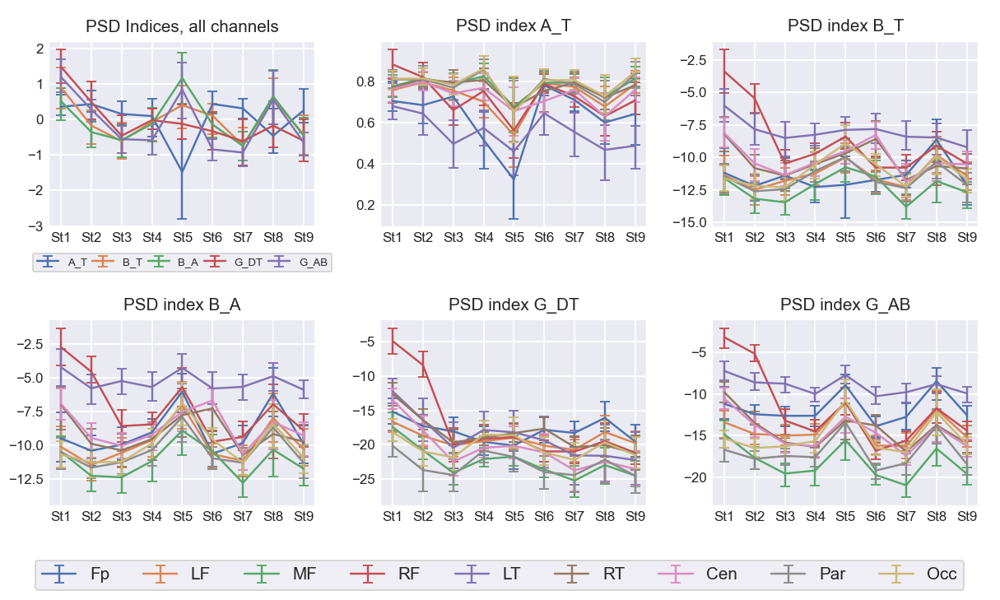

In [39]:
# EEG Indices plots

indices = ['A_T_', 'B_T_', 'B_A_', 'G_DT_', 'G_AB_']
n_indices = len(indices)

df_ft_all = df_ft_psd_ind_log_sc
df_ft_plt = df_ft_psd_ind_plt_log

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)
n_stages = len(st_bands)

x = [cl for (_, _, cl) in st_bands]
n_cols = ceil((n_indices+1)/2.)
n_rows = 2
fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(3*n_cols, 2.7*n_rows))
plt.subplots_adjust(left=0.02)

# First plot
ind_cols =[col for col in df_ft_all.columns if any(ind in col for ind in indices) and ('All' in col)]
df_ft_clust = [df_ft_all[ind_cols].iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
df_ft_clust_stats = [df_ft_clust[_cl].describe() for _cl in range(n_stages)]
for _ind in range(n_indices):
    y = [df_ft_clust_stats[_cl].loc['mean'][_ind] for _cl in range(n_stages)]
    yerr = np.array([df_ft_clust_stats[_cl].loc[['25%','75%']].to_numpy() for _cl in range(n_stages)])[:,:,_ind].transpose(1,0)
    yerr[0,:] = y - yerr[0,:]
    yerr[1,:] = yerr[1,:] - y
    #print(yerr)
    axs[0,0].errorbar(x, y, yerr, label=indices[_ind][:-1], capsize=3, linewidth=1.3)
axs[0,0].set_title("PSD Indices, all channels", fontsize=11) 
axs[0,0].tick_params(axis='both', labelsize=9, direction='in')#, grid_alpha=0.5)
axs[0,0].legend(loc='lower center', ncol=n_indices, bbox_to_anchor=(0.5, -0.27), fontsize=7, columnspacing=0.5)

# All other plots
df_ft_clust = [df_ft_plt.iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
df_ft_clust_stats = [df_ft_clust[_cl].describe() for _cl in range(n_stages)]
for _ind in range(n_indices):
    ind_cols = [col for col in df_ft_plt.columns if (indices[_ind] in col)]
    df_ft_cl_stats_ind = [df_ft_clust_stats[_cl][ind_cols] for _cl in range(n_stages)]
    for _reg in range(n_regions_plt):
        y = [df_ft_cl_stats_ind[_cl].loc['mean'][_reg] for _cl in range(n_stages)]
        yerr = np.array([df_ft_cl_stats_ind[_cl].loc[['25%','75%']].to_numpy() 
                         for _cl in range(n_stages)])[:,:,_reg].transpose(1,0)
        yerr[0,:] = y - yerr[0,:]
        yerr[1,:] = yerr[1,:] - y
        #print(yerr)
        axs[(_ind+1)//n_cols, (_ind+1)%n_cols].errorbar(x, y, yerr, label=regions_plt[_reg][1], capsize=3, linewidth=1.3)
    axs[(_ind+1)//n_cols, (_ind+1)%n_cols].set_title('PSD index ' + indices[_ind][:-1], fontsize=11) 
    axs[(_ind+1)//n_cols, (_ind+1)%n_cols].tick_params(axis='both', labelsize=9, direction='in')#, grid_alpha=0.5)

plt.tight_layout(rect=[0,0.09,1,1])

handles, labels = axs[-1,-1].get_legend_handles_labels()
#fig.suptitle('PSD in brain regions by spectrum')
fig.legend(handles, labels, loc='lower center', ncol=n_regions_plt)#, bbox_to_anchor=(0.5, -0.05))
plt.savefig('PSD indices plots.png')


## Plotting Coherence

<IPython.core.display.Javascript object>


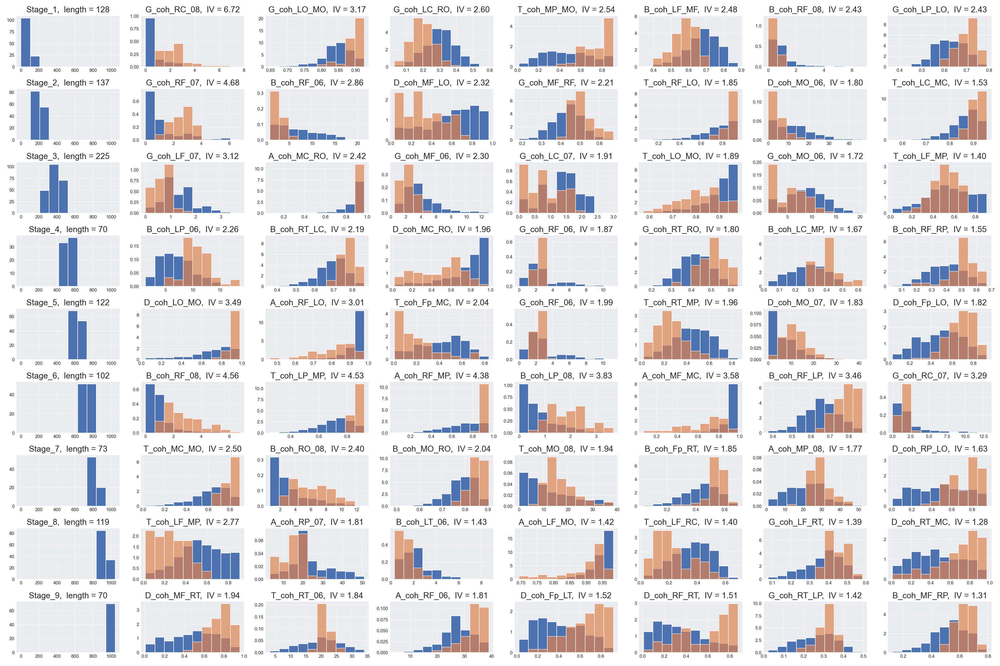

(<Figure size 2700x1800 with 72 Axes>,
 array([[<AxesSubplot:title={'center':'Stage_1,  length = 128'}>,
         <AxesSubplot:title={'center':'G_coh_RC_08,  IV = 6.72'}>,
         <AxesSubplot:title={'center':'G_coh_LO_MO,  IV = 3.17'}>,
         <AxesSubplot:title={'center':'G_coh_LC_RO,  IV = 2.60'}>,
         <AxesSubplot:title={'center':'T_coh_MP_MO,  IV = 2.54'}>,
         <AxesSubplot:title={'center':'B_coh_LF_MF,  IV = 2.48'}>,
         <AxesSubplot:title={'center':'B_coh_RF_08,  IV = 2.43'}>,
         <AxesSubplot:title={'center':'G_coh_LP_LO,  IV = 2.43'}>],
        [<AxesSubplot:title={'center':'Stage_2,  length = 137'}>,
         <AxesSubplot:title={'center':'G_coh_RF_07,  IV = 4.68'}>,
         <AxesSubplot:title={'center':'B_coh_RF_06,  IV = 2.86'}>,
         <AxesSubplot:title={'center':'D_coh_MF_LO,  IV = 2.32'}>,
         <AxesSubplot:title={'center':'G_coh_MF_RF,  IV = 2.21'}>,
         <AxesSubplot:title={'center':'T_coh_RF_LO,  IV = 1.85'}>,
         <AxesSubplot:ti

In [40]:
# Coherence best IV features

N_BEST_FEATURES = 7
df_features = pd.concat([df_ft_coh_loc, df_ft_coh_ind_loc], axis=1)

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)

best_IV_list, best_WoE_list = ve.best_IV_WoE_vars_clust(df_features, new_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)

ve.plot_hist_best_vars(df_features, new_labels, best_IV_list, title_prefix='Coherence', stages=True)

<IPython.core.display.Javascript object>


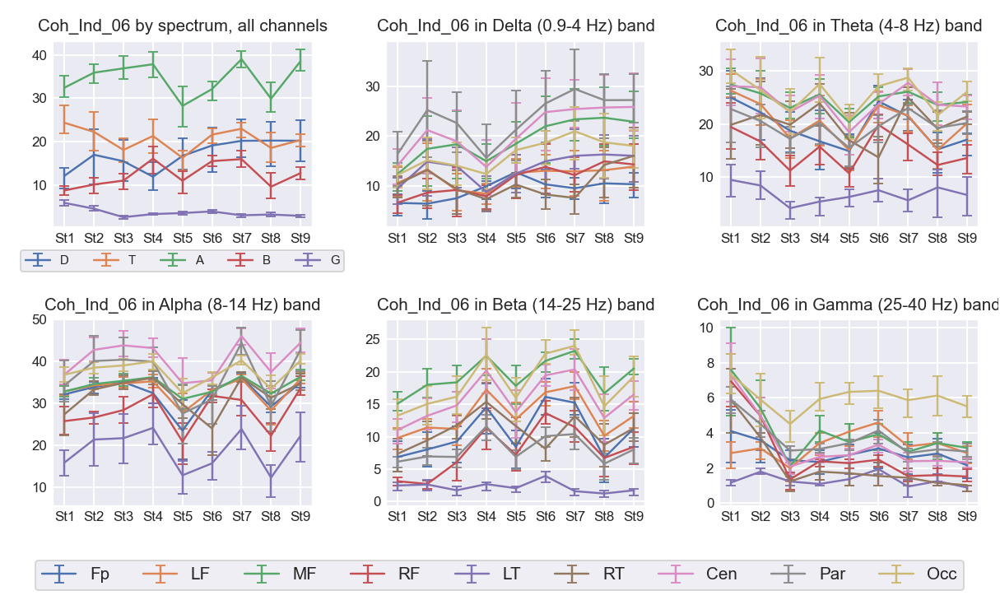

In [41]:
# Coherence indices plot

str_rate = '06'
df_ft_all = df_ft_coh_ind_all
df_ft_plt = df_ft_coh_ind_plt

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)
n_stages = len(st_bands)

x = [cl for (_, _, cl) in st_bands]
n_cols = ceil((n_freq+1)/2.)
n_rows = 2
fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(3*n_cols, 2.7*n_rows))
plt.subplots_adjust(left=0.02)

# First plot
rate_cols = [col for col in df_ft_all.columns if (str_rate in col)]
df_ft_clust = [df_ft_all[rate_cols].iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
df_ft_clust_stats = [df_ft_clust[_cl].describe() for _cl in range(n_stages)]
for _freq in range(n_freq):
    y = [df_ft_clust_stats[_cl].loc['mean'][_freq] for _cl in range(n_stages)]
    yerr = np.array([df_ft_clust_stats[_cl].loc[['25%','75%']].to_numpy() 
                     for _cl in range(n_stages)])[:,:,_freq].transpose(1,0)
    yerr[0,:] = y - yerr[0,:]
    yerr[1,:] = yerr[1,:] - y
    #print(yerr)
    axs[0,0].errorbar(x, y, yerr, label=str_freq[_freq], capsize=3, linewidth=1.3)
axs[0,0].set_title('Coh_Ind_'+str_rate+' by spectrum, all channels', fontsize=11) 
axs[0,0].tick_params(axis='both', labelsize=9, direction='in')#, grid_alpha=0.5)
axs[0,0].legend(loc='lower center', ncol=n_freq, bbox_to_anchor=(0.5, -0.27), fontsize=8)

# All other plots
rate_cols = [col for col in df_ft_plt.columns if (str_rate in col)]
df_ft_clust = [df_ft_plt[rate_cols].iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
df_ft_clust_stats = [df_ft_clust[_cl].describe() for _cl in range(n_stages)]
for _freq in range(n_freq):
    band_columns = [col for col in df_ft_plt[rate_cols].columns if col.startswith(str_freq_rr[_freq])]
    df_ft_cl_stats_band = [df_ft_clust_stats[i][band_columns] for i in range(n_stages)]
    for _reg in range(n_regions_plt):
        y = [df_ft_cl_stats_band[i].loc['mean'][_reg] for i in range(n_stages)]
        yerr = np.array([df_ft_cl_stats_band[i].loc[['25%','75%']].to_numpy() 
                         for i in range(n_stages)])[:,:,_reg].transpose(1,0)
        yerr[0,:] = y - yerr[0,:]
        yerr[1,:] = yerr[1,:] - y
        #print(yerr)
        axs[(_freq+1)//n_cols, (_freq+1)%n_cols].errorbar(x, y, yerr, label=regions_plt[_reg][1], capsize=3, linewidth=1.3)
    axs[(_freq+1)//n_cols, (_freq+1)%n_cols].set_title('Coh_Ind_'+str_rate+' in ' + bands[_freq][2] + ' band', fontsize=11) 
    axs[(_freq+1)//n_cols, (_freq+1)%n_cols].tick_params(axis='both', labelsize=9, direction='in')#, grid_alpha=0.5)

plt.tight_layout(rect=[0,0.09,1,1])

handles, labels = axs[-1,-1].get_legend_handles_labels()
#fig.suptitle('PSD in brain regions by spectrum')
fig.legend(handles, labels, loc='lower center', ncol=n_regions_plt)#, bbox_to_anchor=(0.5, -0.05))
plt.savefig('Coherence Index plots.png')


<IPython.core.display.Javascript object>


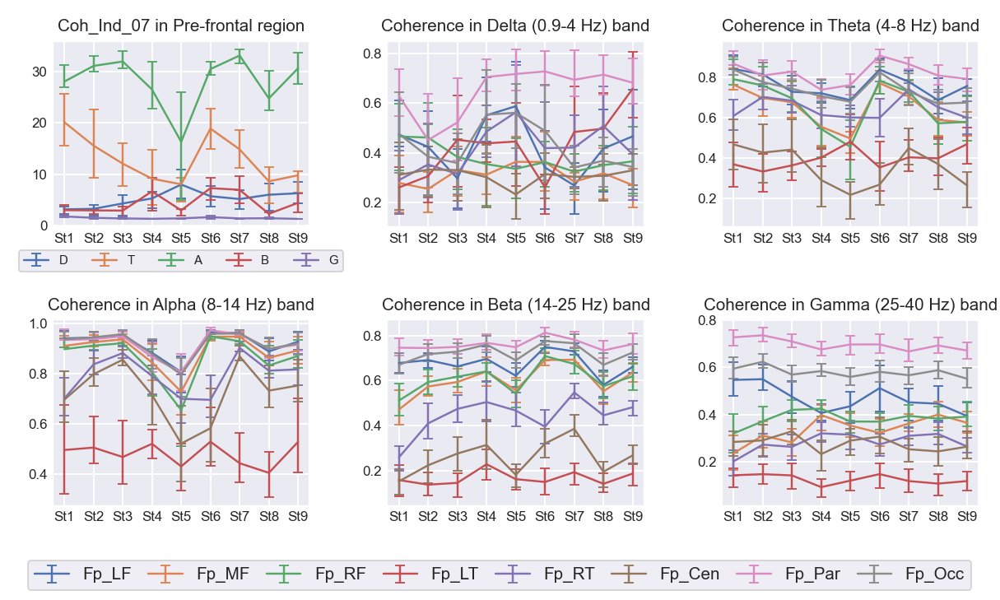

<IPython.core.display.Javascript object>


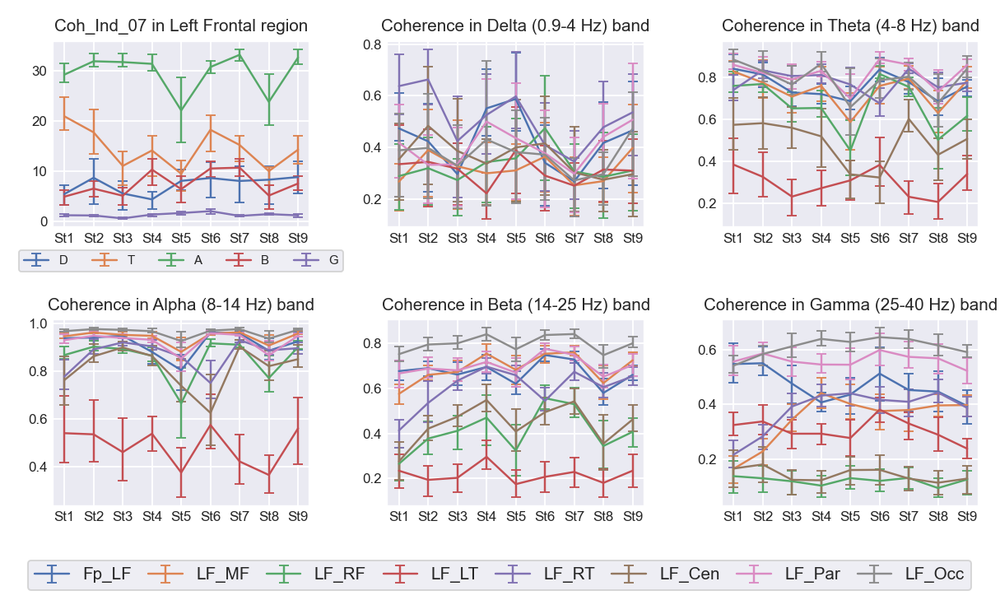

<IPython.core.display.Javascript object>


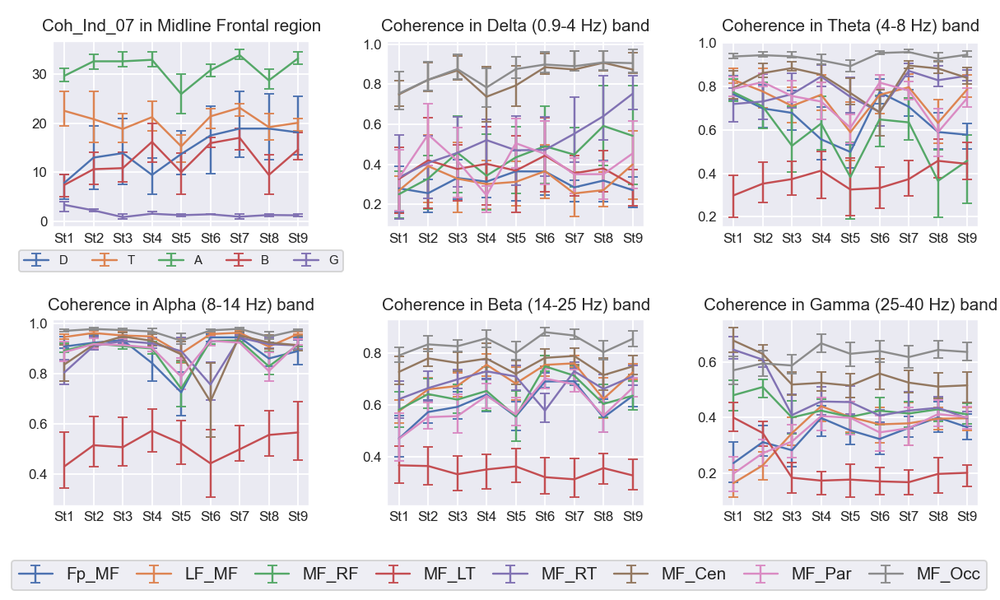

<IPython.core.display.Javascript object>


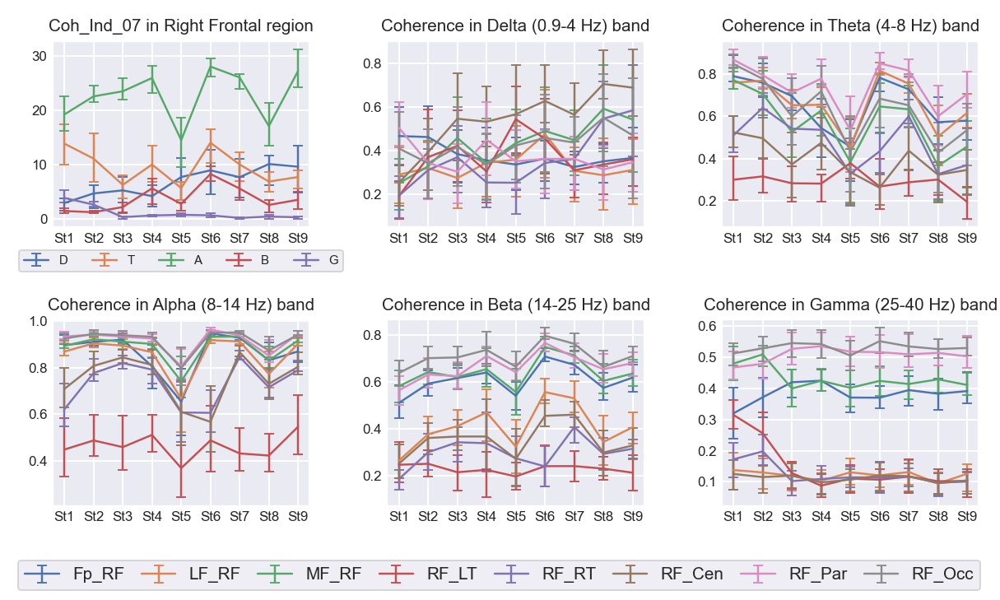

<IPython.core.display.Javascript object>


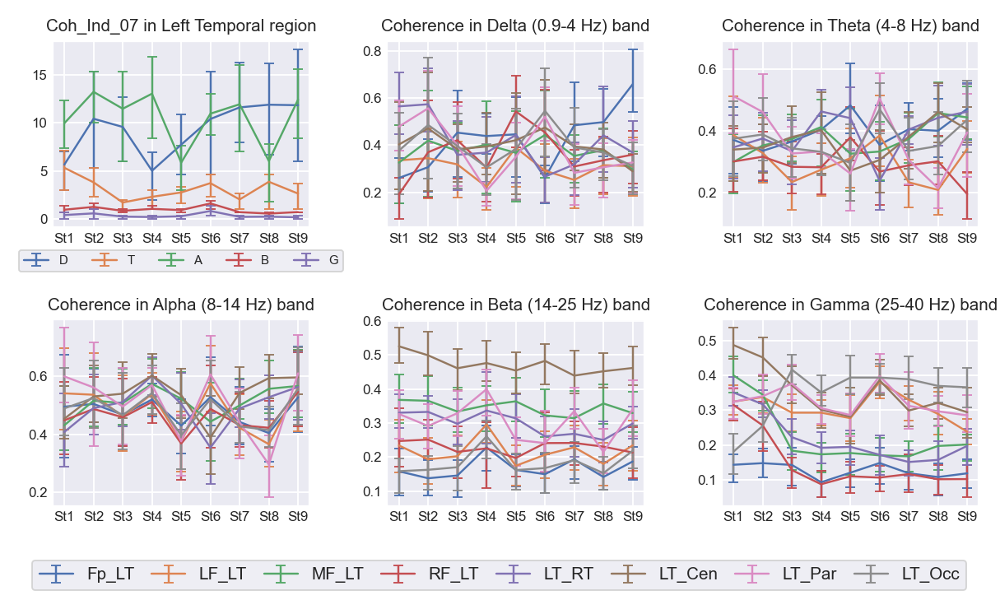

<IPython.core.display.Javascript object>


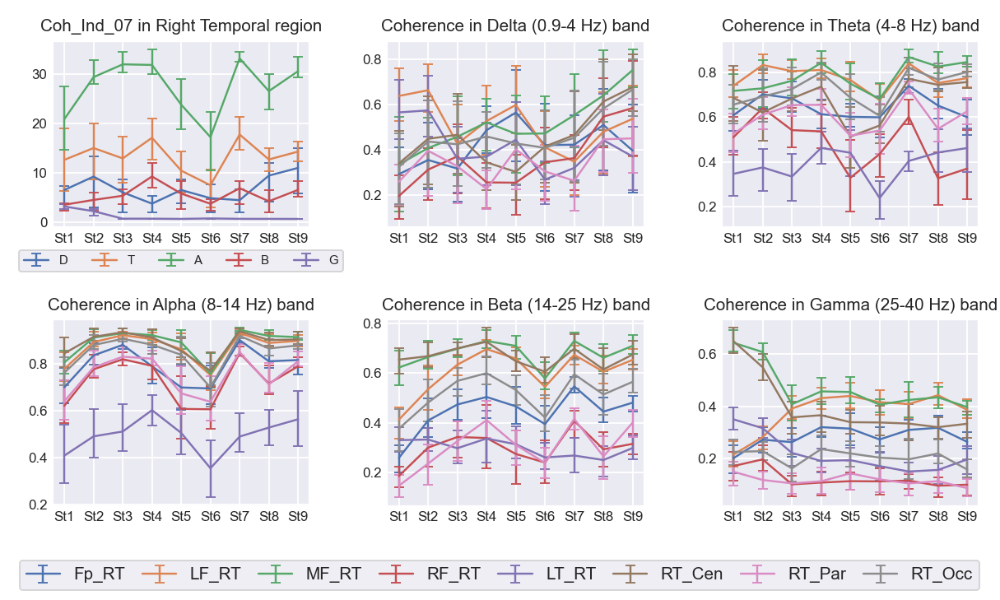

<IPython.core.display.Javascript object>


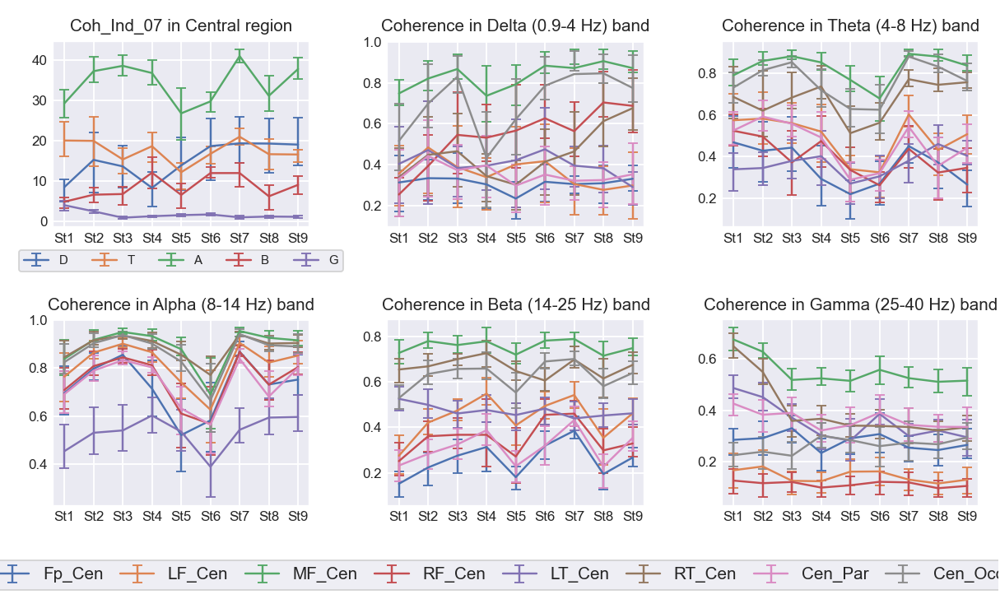

<IPython.core.display.Javascript object>


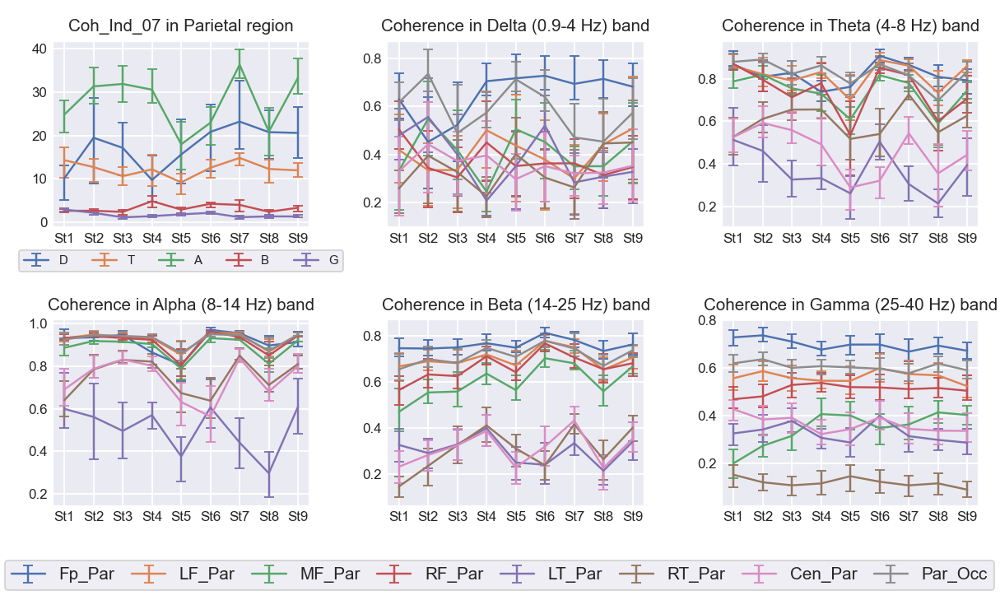

<IPython.core.display.Javascript object>


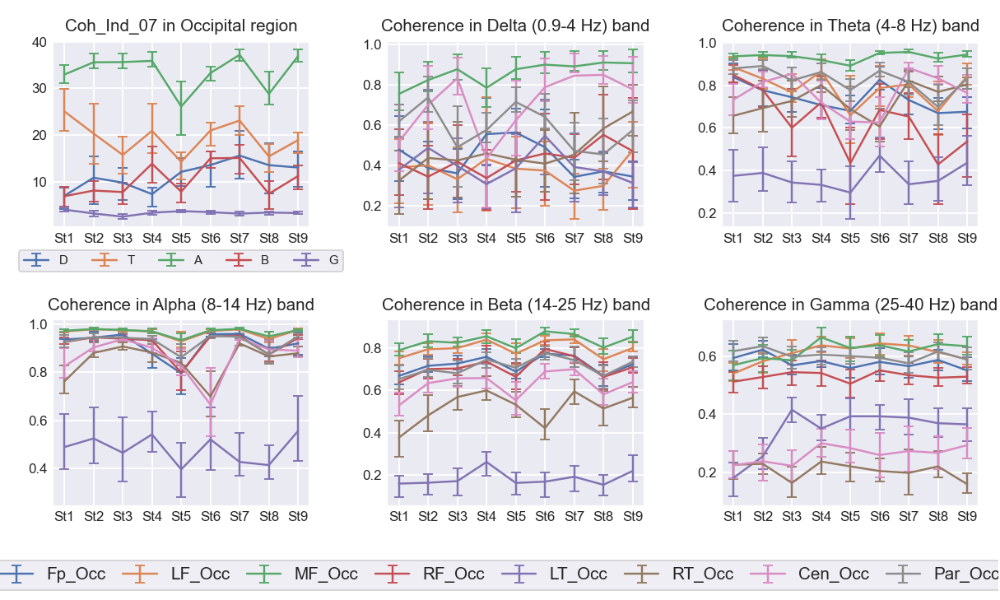

In [42]:
# Coherence plots

str_rate = '07'
df_ft_ind = df_ft_coh_ind_plt
df_ft_plt = df_ft_coh_plt

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)
n_stages = len(st_bands)

for _reg in range(n_regions_plt):
    x = [cl for (_, _, cl) in st_bands]
    n_cols = ceil((n_freq+1)/2.)
    n_rows = 2
    fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(3*n_cols, 2.7*n_rows))
    plt.subplots_adjust(left=0.02)

    # First plot
    reg_columns = [col for col in df_ft_ind.columns if (regions_plt[_reg][1] in col) and (str_rate in col)]
    
    df_ft_clust = [df_ft_ind.iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
    df_ft_clust_stats = [df_ft_clust[_cl].describe() for _cl in range(n_stages)]
    df_ft_cl_stats_reg = [df_ft_clust_stats[_cl][reg_columns] for _cl in range(n_stages)]
    for _freq in range(n_freq):
        y = [df_ft_cl_stats_reg[_cl].loc['mean'][_freq] for _cl in range(n_stages)]
        yerr = np.array([df_ft_cl_stats_reg[_cl].loc[['25%','75%']].to_numpy() 
                         for _cl in range(n_stages)])[:,:,_freq].transpose(1,0)
        yerr[0,:] = y - yerr[0,:]
        yerr[1,:] = yerr[1,:] - y
        #print(yerr)
        axs[0,0].errorbar(x, y, yerr, label=str_freq[_freq], capsize=3, linewidth=1.3)
    axs[0,0].set_title('Coh_Ind_' + str_rate + ' in ' + regions_plt[_reg][2] + ' region', fontsize=11) 
    axs[0,0].tick_params(axis='both', labelsize=9, direction='in')#, grid_alpha=0.5)
    #box = axs[0,0].get_position()
    #axs[0,0].set_position([box.x0, box.y0 + box.height * 0.1, box.width, box.height * 0.8])
    axs[0,0].legend(loc='lower center', ncol=n_freq, bbox_to_anchor=(0.5, -0.27), fontsize=8)

    # All other plots
    df_ft_clust = [df_ft_plt.iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
    df_ft_clust_stats = [df_ft_clust[_cl].describe() for _cl in range(n_stages)]
    for _freq in range(n_freq):
        band_cols = [col for col in df_ft_plt.columns if (regions_plt[_reg][1] in col) and col.startswith(str_freq_rr[_freq])]
        label_names = [col.replace(str_freq_rr[_freq]+'_coh_', '') for col in band_cols]
        #print(label_names)
        df_ft_cl_stats_band = [df_ft_clust_stats[i][band_cols] for i in range(n_stages)]
        for _r in range(len(band_cols)):
            y = [df_ft_cl_stats_band[i].loc['mean'][_r] for i in range(n_stages)]
            yerr = np.array([df_ft_cl_stats_band[i].loc[['25%','75%']].to_numpy() 
                             for i in range(n_stages)])[:,:,_r].transpose(1,0)
            yerr[0,:] = y - yerr[0,:]
            yerr[1,:] = yerr[1,:] - y
            #print(yerr)
            axs[(_freq+1)//n_cols, (_freq+1)%n_cols].errorbar(x, y, yerr, label=label_names[_r], capsize=3, linewidth=1.3)
        axs[(_freq+1)//n_cols, (_freq+1)%n_cols].set_title('Coherence in ' + bands[_freq][2] + ' band', fontsize=11) 
        axs[(_freq+1)//n_cols, (_freq+1)%n_cols].tick_params(axis='both', labelsize=9, direction='in')#, grid_alpha=0.5)

    plt.tight_layout(rect=[0,0.09,1,1])

    handles, labels = axs[-1,-1].get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', ncol=n_regions_plt-1, columnspacing=1., markerscale=0.9)
    plt.savefig('Coherence '+regions_plt[_reg][2]+' region plots.png')


## Plotting PLV features

<IPython.core.display.Javascript object>


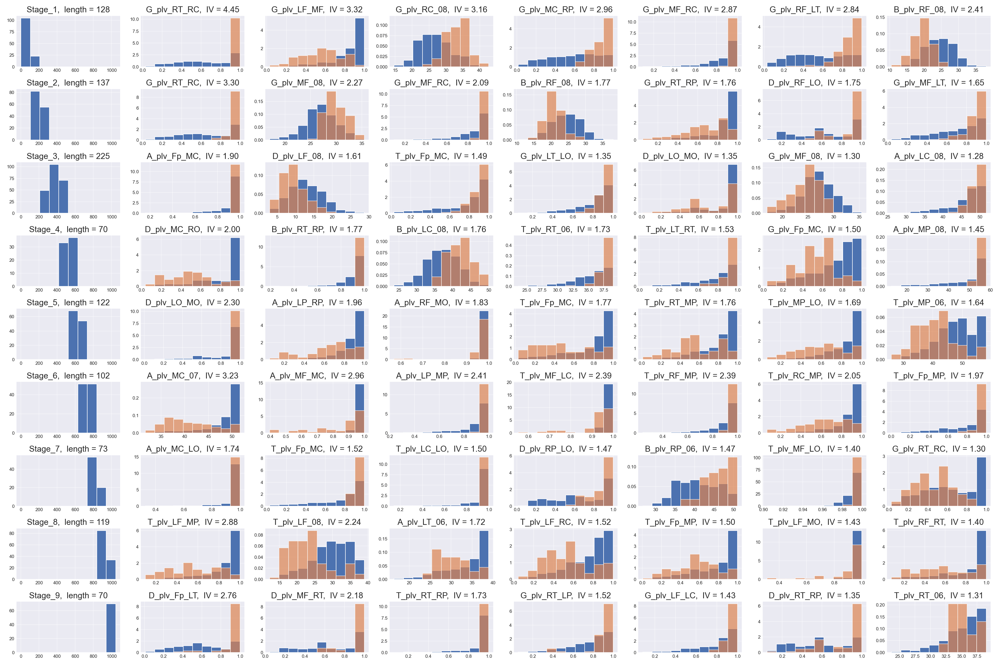

(<Figure size 2700x1800 with 72 Axes>,
 array([[<AxesSubplot:title={'center':'Stage_1,  length = 128'}>,
         <AxesSubplot:title={'center':'G_plv_RT_RC,  IV = 4.45'}>,
         <AxesSubplot:title={'center':'G_plv_LF_MF,  IV = 3.32'}>,
         <AxesSubplot:title={'center':'G_plv_RC_08,  IV = 3.16'}>,
         <AxesSubplot:title={'center':'G_plv_MC_RP,  IV = 2.96'}>,
         <AxesSubplot:title={'center':'G_plv_MF_RC,  IV = 2.87'}>,
         <AxesSubplot:title={'center':'G_plv_RF_LT,  IV = 2.84'}>,
         <AxesSubplot:title={'center':'B_plv_RF_08,  IV = 2.41'}>],
        [<AxesSubplot:title={'center':'Stage_2,  length = 137'}>,
         <AxesSubplot:title={'center':'G_plv_RT_RC,  IV = 3.30'}>,
         <AxesSubplot:title={'center':'G_plv_MF_08,  IV = 2.27'}>,
         <AxesSubplot:title={'center':'G_plv_MF_RC,  IV = 2.09'}>,
         <AxesSubplot:title={'center':'B_plv_RF_08,  IV = 1.77'}>,
         <AxesSubplot:title={'center':'G_plv_RT_RP,  IV = 1.76'}>,
         <AxesSubplot:ti

In [43]:
# PLV best IV features

N_BEST_FEATURES = 7
df_features = pd.concat([df_ft_plv_loc, df_ft_plv_ind_loc], axis=1)

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)

best_IV_list, best_WoE_list = ve.best_IV_WoE_vars_clust(df_features, new_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)

ve.plot_hist_best_vars(df_features, new_labels, title_prefix='PLV', best_IV_list)

<IPython.core.display.Javascript object>


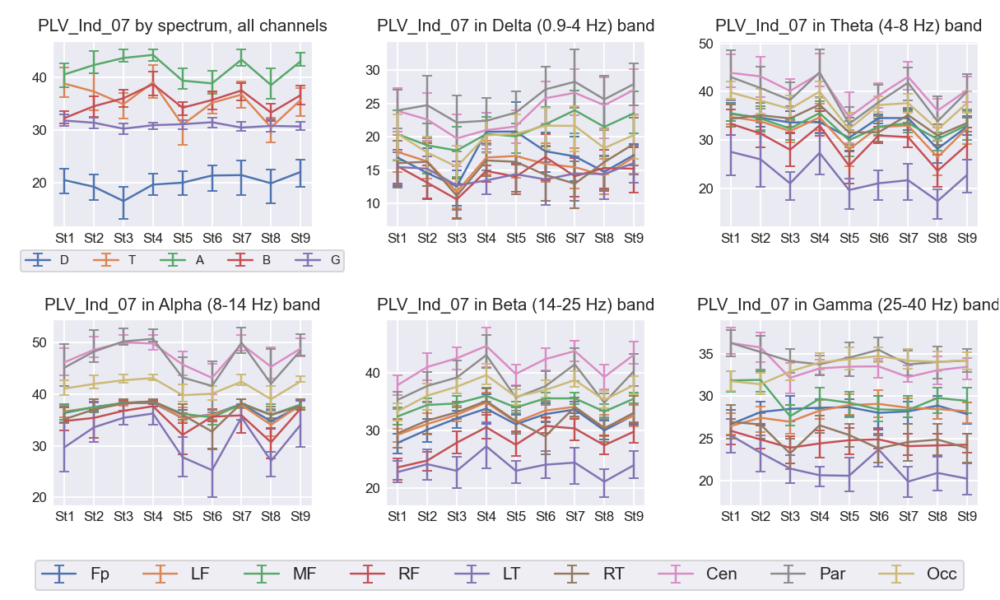

In [44]:
# PLV indices plot

str_rate = '07'
df_ft_all = df_ft_plv_ind_all
df_ft_plt = df_ft_plv_ind_plt

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)
n_stages = len(st_bands)

x = [cl for (_, _, cl) in st_bands]
n_cols = ceil((n_freq+1)/2.)
n_rows = 2
fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(3*n_cols, 2.7*n_rows))
plt.subplots_adjust(left=0.02)

# First plot
rate_cols = [col for col in df_ft_all.columns if (str_rate in col)]
df_ft_clust = [df_ft_all[rate_cols].iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
df_ft_clust_stats = [df_ft_clust[_cl].describe() for _cl in range(n_stages)]
for _freq in range(n_freq):
    y = [df_ft_clust_stats[_cl].loc['mean'][_freq] for _cl in range(n_stages)]
    yerr = np.array([df_ft_clust_stats[_cl].loc[['25%','75%']].to_numpy() 
                     for _cl in range(n_stages)])[:,:,_freq].transpose(1,0)
    yerr[0,:] = y - yerr[0,:]
    yerr[1,:] = yerr[1,:] - y
    #print(yerr)
    axs[0,0].errorbar(x, y, yerr, label=str_freq[_freq], capsize=3, linewidth=1.3)
axs[0,0].set_title('PLV_Ind_'+str_rate+' by spectrum, all channels', fontsize=11) 
axs[0,0].tick_params(axis='both', labelsize=9, direction='in')#, grid_alpha=0.5)
axs[0,0].legend(loc='lower center', ncol=n_freq, bbox_to_anchor=(0.5, -0.27), fontsize=8)

# All other plots
rate_cols = [col for col in df_ft_plt.columns if (str_rate in col)]
df_ft_clust = [df_ft_plt[rate_cols].iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
df_ft_clust_stats = [df_ft_clust[_cl].describe() for _cl in range(n_stages)]
for _freq in range(n_freq):
    band_columns = [col for col in df_ft_plt[rate_cols].columns if col.startswith(str_freq_rr[_freq])]
    df_ft_cl_stats_band = [df_ft_clust_stats[i][band_columns] for i in range(n_stages)]
    for _reg in range(n_regions_plt):
        y = [df_ft_cl_stats_band[i].loc['mean'][_reg] for i in range(n_stages)]
        yerr = np.array([df_ft_cl_stats_band[i].loc[['25%','75%']].to_numpy() 
                         for i in range(n_stages)])[:,:,_reg].transpose(1,0)
        yerr[0,:] = y - yerr[0,:]
        yerr[1,:] = yerr[1,:] - y
        #print(yerr)
        axs[(_freq+1)//n_cols, (_freq+1)%n_cols].errorbar(x, y, yerr, label=regions_plt[_reg][1], capsize=3, linewidth=1.3)
    axs[(_freq+1)//n_cols, (_freq+1)%n_cols].set_title('PLV_Ind_'+str_rate+' in ' + bands[_freq][2] + ' band', fontsize=11) 
    axs[(_freq+1)//n_cols, (_freq+1)%n_cols].tick_params(axis='both', labelsize=9, direction='in')#, grid_alpha=0.5)

plt.tight_layout(rect=[0,0.09,1,1])

handles, labels = axs[-1,-1].get_legend_handles_labels()
#fig.suptitle('PSD in brain regions by spectrum')
fig.legend(handles, labels, loc='lower center', ncol=n_regions_plt)#, bbox_to_anchor=(0.5, -0.05))
plt.savefig('PLV Index plots.png')


<IPython.core.display.Javascript object>


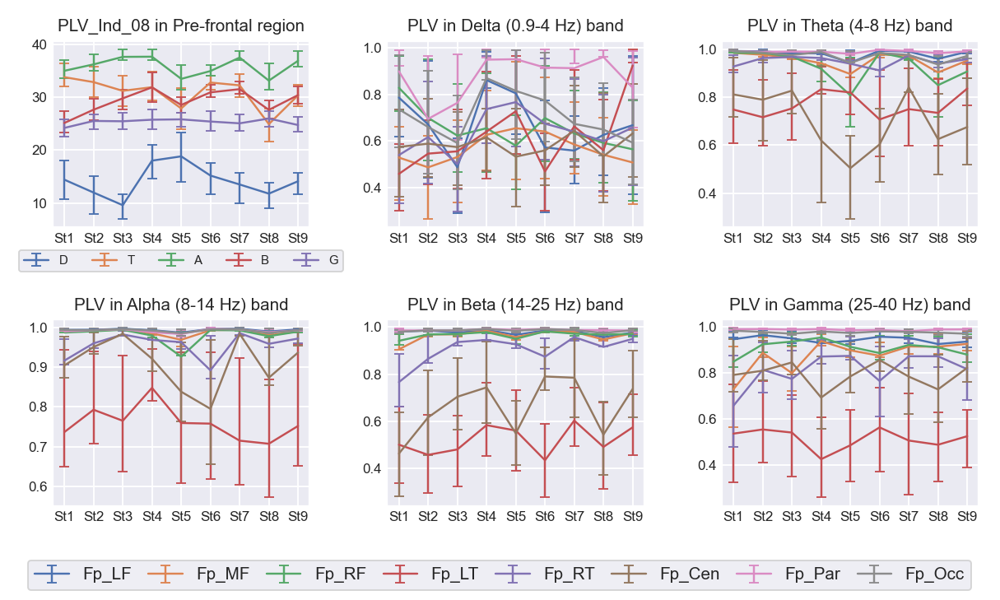

<IPython.core.display.Javascript object>


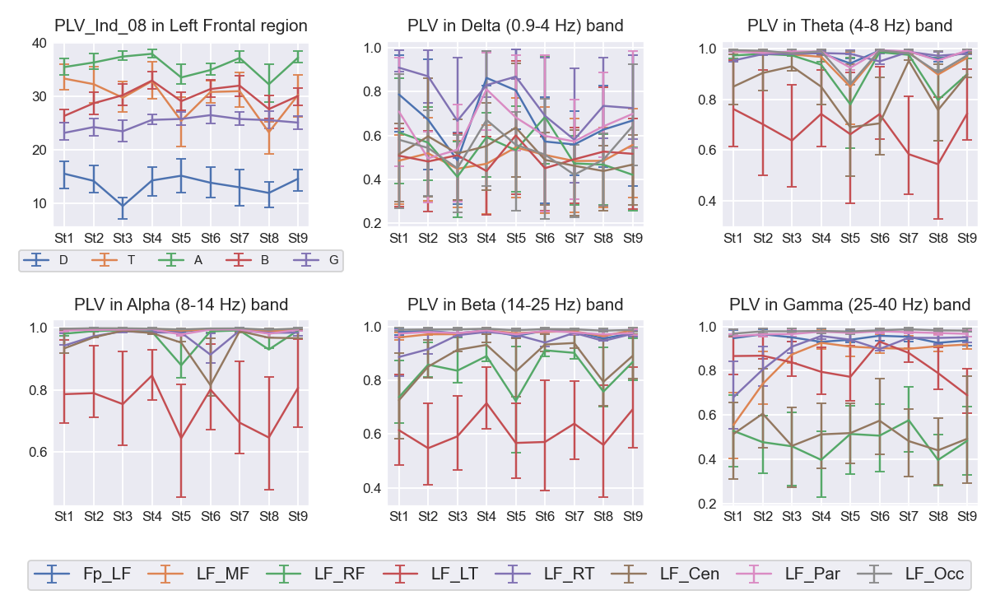

<IPython.core.display.Javascript object>


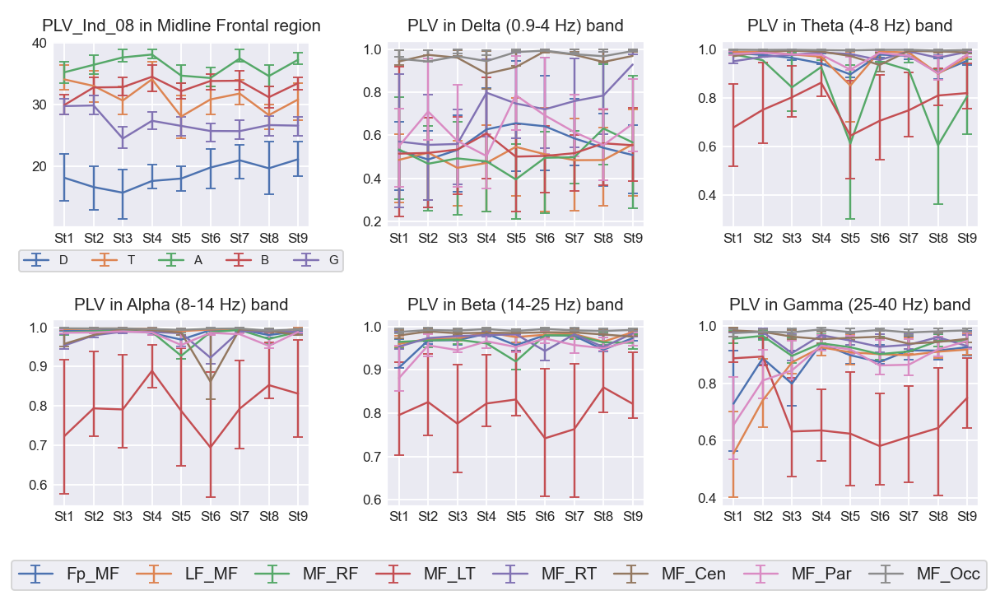

<IPython.core.display.Javascript object>


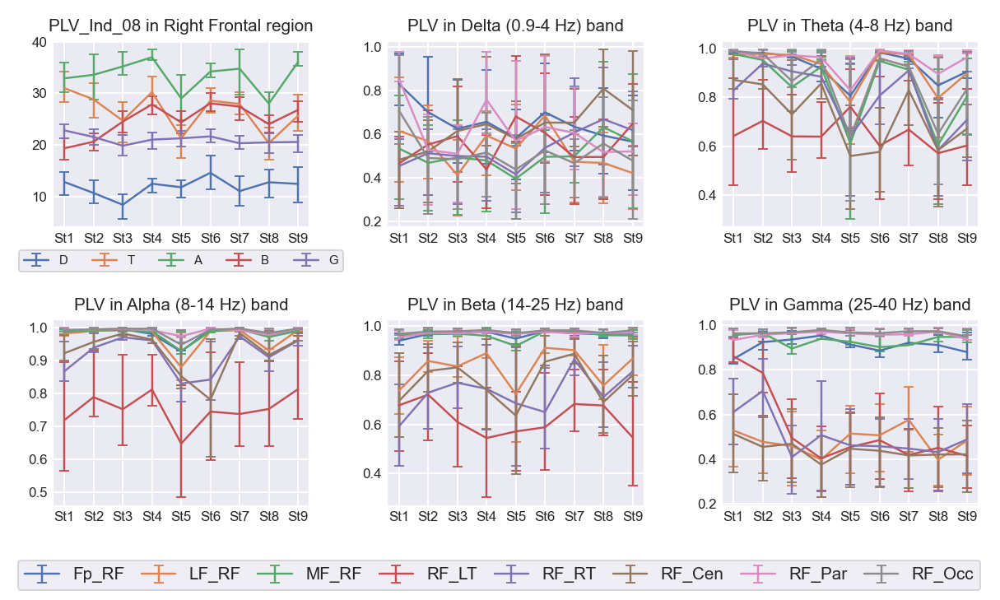

<IPython.core.display.Javascript object>


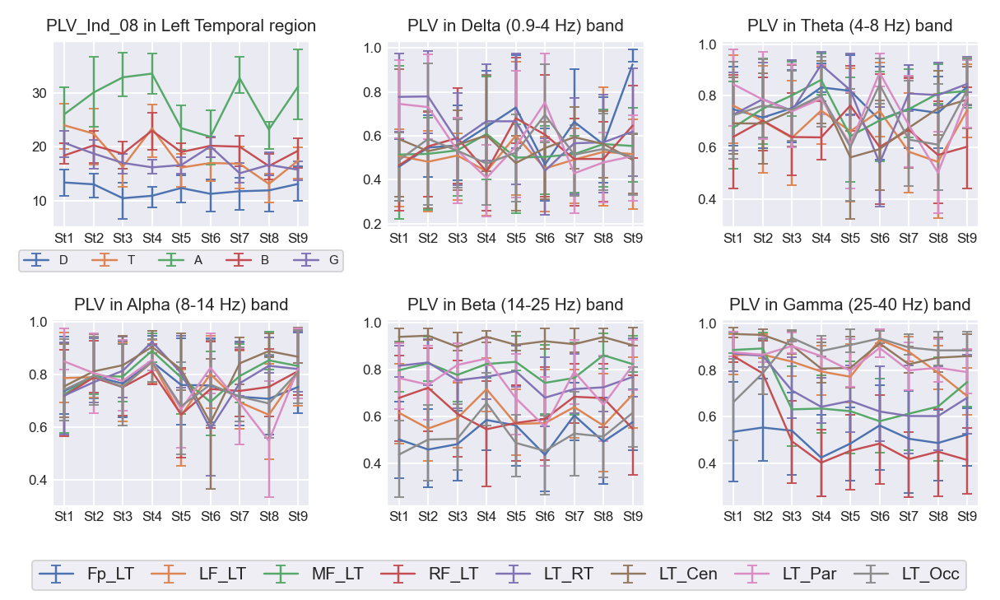

<IPython.core.display.Javascript object>


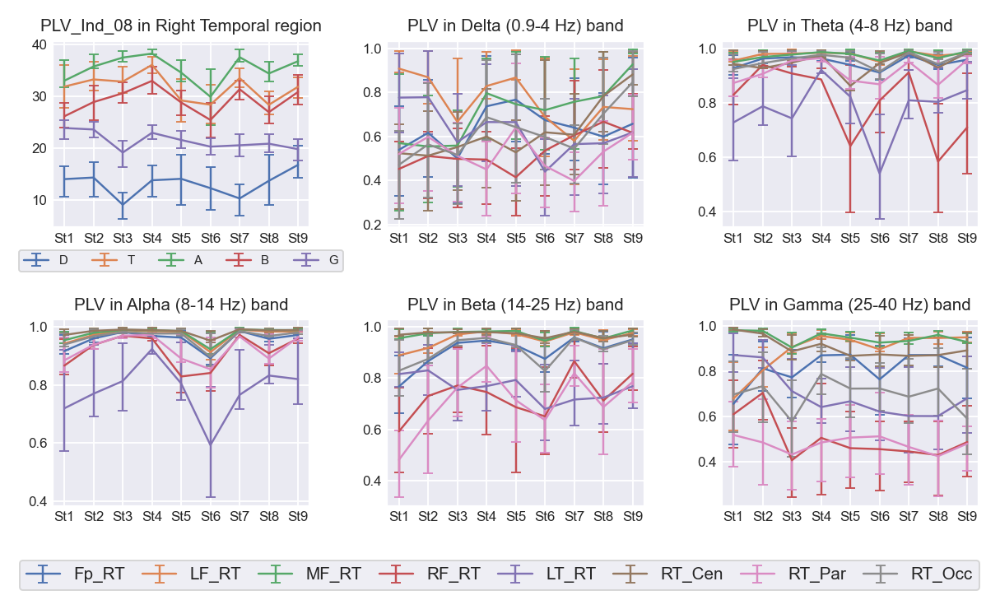

<IPython.core.display.Javascript object>


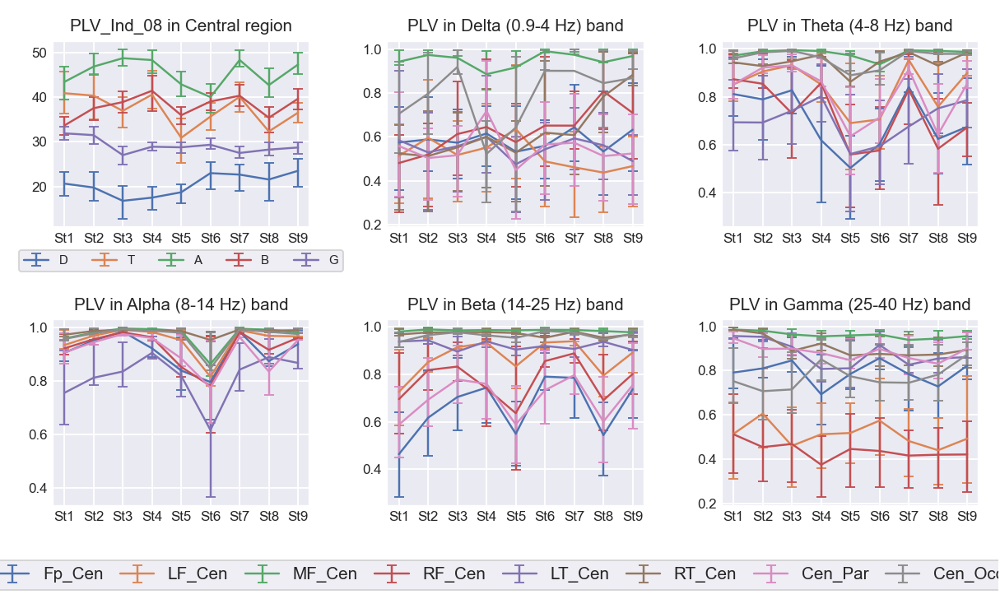

<IPython.core.display.Javascript object>


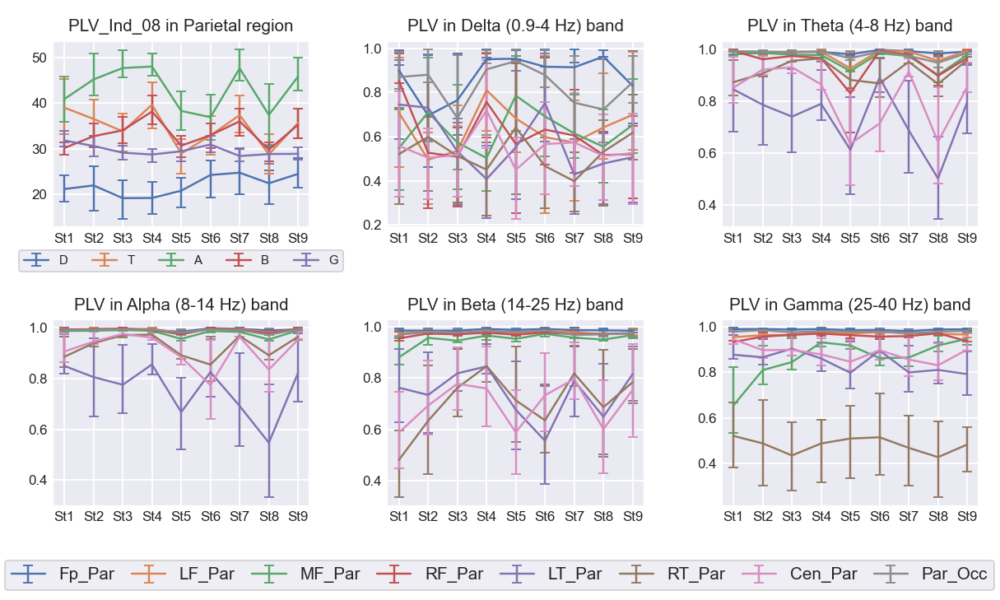

<IPython.core.display.Javascript object>


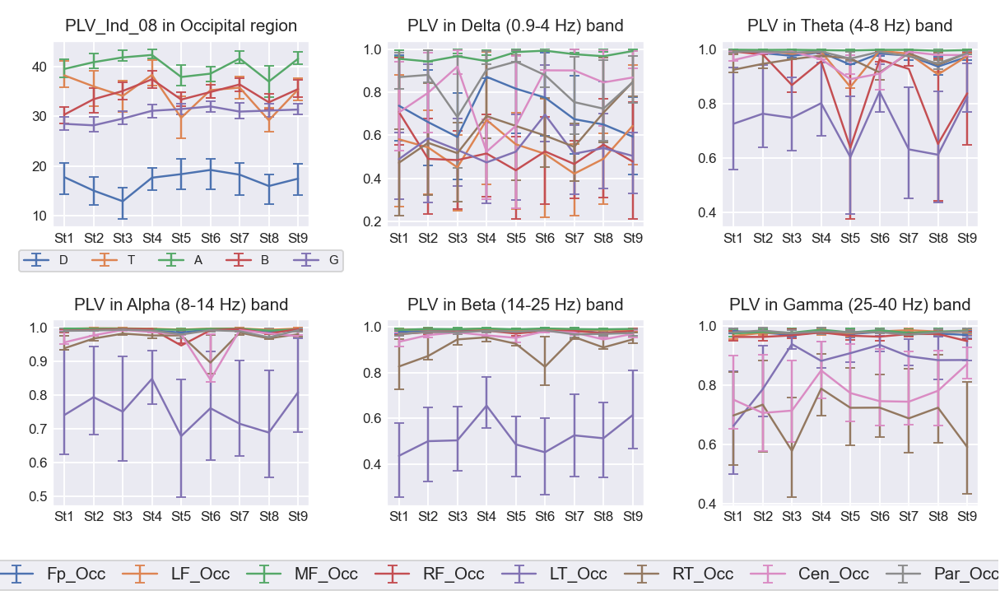

In [45]:
# PLV plots

str_rate = '08'
df_ft_ind = df_ft_plv_ind_plt
df_ft_plt = df_ft_plv_plt

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)
n_stages = len(st_bands)

for _reg in range(n_regions_plt):
    x = [cl for (_, _, cl) in st_bands]
    n_cols = ceil((n_freq+1)/2.)
    n_rows = 2
    fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(3*n_cols, 2.7*n_rows))
    plt.subplots_adjust(left=0.02)

    # First plot
    reg_columns = [col for col in df_ft_ind.columns if (regions_plt[_reg][1] in col) and (str_rate in col)]
    
    df_ft_clust = [df_ft_ind.iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
    df_ft_clust_stats = [df_ft_clust[_cl].describe() for _cl in range(n_stages)]
    df_ft_cl_stats_reg = [df_ft_clust_stats[_cl][reg_columns] for _cl in range(n_stages)]
    for _freq in range(n_freq):
        y = [df_ft_cl_stats_reg[_cl].loc['mean'][_freq] for _cl in range(n_stages)]
        yerr = np.array([df_ft_cl_stats_reg[_cl].loc[['25%','75%']].to_numpy() 
                         for _cl in range(n_stages)])[:,:,_freq].transpose(1,0)
        yerr[0,:] = y - yerr[0,:]
        yerr[1,:] = yerr[1,:] - y
        #print(yerr)
        axs[0,0].errorbar(x, y, yerr, label=str_freq[_freq], capsize=3, linewidth=1.3)
    axs[0,0].set_title('PLV_Ind_' + str_rate + ' in ' + regions_plt[_reg][2] + ' region', fontsize=11) 
    axs[0,0].tick_params(axis='both', labelsize=9, direction='in')#, grid_alpha=0.5)
    #box = axs[0,0].get_position()
    #axs[0,0].set_position([box.x0, box.y0 + box.height * 0.1, box.width, box.height * 0.8])
    axs[0,0].legend(loc='lower center', ncol=n_freq, bbox_to_anchor=(0.5, -0.27), fontsize=8)

    # All other plots
    df_ft_clust = [df_ft_plt.iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
    df_ft_clust_stats = [df_ft_clust[_cl].describe() for _cl in range(n_stages)]
    for _freq in range(n_freq):
        band_cols = [col for col in df_ft_plt.columns if (regions_plt[_reg][1] in col) and col.startswith(str_freq_rr[_freq])]
        label_names = [col.replace(str_freq_rr[_freq]+'_plv_', '') for col in band_cols]
        #print(label_names)
        df_ft_cl_stats_band = [df_ft_clust_stats[i][band_cols] for i in range(n_stages)]
        for _r in range(len(band_cols)):
            y = [df_ft_cl_stats_band[i].loc['mean'][_r] for i in range(n_stages)]
            yerr = np.array([df_ft_cl_stats_band[i].loc[['25%','75%']].to_numpy() 
                             for i in range(n_stages)])[:,:,_r].transpose(1,0)
            yerr[0,:] = y - yerr[0,:]
            yerr[1,:] = yerr[1,:] - y
            #print(yerr)
            axs[(_freq+1)//n_cols, (_freq+1)%n_cols].errorbar(x, y, yerr, label=label_names[_r], capsize=3, linewidth=1.3)
        axs[(_freq+1)//n_cols, (_freq+1)%n_cols].set_title('PLV in ' + bands[_freq][2] + ' band', fontsize=11) 
        axs[(_freq+1)//n_cols, (_freq+1)%n_cols].tick_params(axis='both', labelsize=9, direction='in')#, grid_alpha=0.5)

    plt.tight_layout(rect=[0,0.09,1,1])

    handles, labels = axs[-1,-1].get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', ncol=n_regions_plt-1, columnspacing=1., markerscale=0.9)
    plt.savefig('PLV '+regions_plt[_reg][2]+' region plots.png')


# Explore statistical significance

In [23]:
st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)
print(st_bands)

[(0, 127, 'St1'), (128, 264, 'St2'), (265, 489, 'St3'), (490, 559, 'St4'), (560, 681, 'St5'), (682, 783, 'St6'), (784, 856, 'St7'), (857, 975, 'St8'), (976, 1045, 'St9')]


In [24]:
# Highlight DataFrame with applied statistical test
def highlight_pvalue(df, df_m, df_p):
    color1 = 'background-color: red'
    color2 = 'background-color: salmon'
    color3 = 'background-color: lightgreen'
    color4 = 'background-color: limegreen'
    
    df_color = pd.DataFrame('', index=df.index, columns=df.columns)
    
    for _col in df_p.columns[1:]:
        for _ind in df_p.index:
            if (df_m.at[_ind,'Median'] < df_m.at[_ind,_col]) & (df_p.at[_ind,_col] < 0.01):
                df_color.at[_ind,_col] = color1
            elif (df_m.at[_ind,'Median'] < df_m.at[_ind,_col]) & (0.01 <= df_p.at[_ind,_col] < 0.05):
                df_color.at[_ind,_col] = color2
            elif (df_m.at[_ind,'Median'] > df_m.at[_ind,_col]) & (0.01 <= df_p.at[_ind,_col] < 0.05):
                df_color.at[_ind,_col] = color3
            elif (df_m.at[_ind,'Median'] > df_m.at[_ind,_col]) & (df_p.at[_ind,_col] < 0.01):
                df_color.at[_ind,_col] = color4
  
    return df_color

# Formatting DataFrame
def display_stat_test_df(df, df_m, df_p, stage=1, ft_name='PSD', e_format=False):
    color_neigb = 'blue'
    
    s = df.style.apply(highlight_pvalue, df_m=df_m, df_p=df_p, axis=None)
    
    cols = [col for col in df.columns if (str(stage-1) in col) or (str(stage+1) in col)]
    s = s.apply_index(lambda name: np.where(name.isin(cols), "color: "+color_neigb, ""), axis=1)
    
    border_dict = dict([(_col, [{"selector" :"td", "props": "border: 2px solid "+color_neigb}]) for _col in cols])
    s = s.set_table_styles(border_dict)
    
    if e_format:
        format_dict = dict([(_col, '{:.0e}') for _col in df.columns[1:]])
    else:
        format_dict = dict([(_col, '{:.2f}') for _col in df.columns[1:]])
    s = s.format(format_dict)
    display(s)
    dfi.export(s, 'Stage'+str(stage)+' '+ft_name+' stat signif.png')


In [25]:

def stage_stat_test_ind(df_features, st_edges):
    n_samples = len(df_features.index)
    n_features = len(df_features.columns)
    n_stages = len(st_edges)-1
    
    st_bands, new_labels = spr.form_stage_bands(st_edges, n_samples)

    df_ft_clust = [df_features.iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
    ft_med = df_features.median()
    df_medians = []
    df_pvalues = []

    for _st in range(n_stages):
        st_names_tmp = [st_bands[_st][2]+'_'+st_bands[i][2] for i in range(n_stages)]
        del st_names_tmp[_st]
        df_ft_clust_tmp = df_ft_clust.copy()
        del df_ft_clust_tmp[_st]    
    
        df_med_tmp = pd.DataFrame(columns=['Name', 'Median', st_bands[_st][2]+'_Total']+st_names_tmp)
        df_pv_tmp = pd.DataFrame(columns=['Name', st_bands[_st][2]+'_Total']+st_names_tmp)
        for _ft in range(len(ft_med)):
            # Name
            ft_name = df_features.columns[_ft]
            new_med_row = {df_med_tmp.columns[0]: ft_name}
            new_pv_row = {df_pv_tmp.columns[0]: ft_name}
            # Current stage median
            x = df_ft_clust[_st][ft_name].to_numpy()
            new_med_row.update({df_med_tmp.columns[1]: np.median(x)})
            # One-sample test (total median)
            u, p = sp.stats.wilcoxon(x - ft_med[_ft])
            new_med_row.update({df_med_tmp.columns[2]: ft_med[_ft]})
            new_pv_row.update({df_pv_tmp.columns[1]: p})
            # Two-sample test (stages)
            for i in range(len(st_names_tmp)):
                y = df_ft_clust_tmp[i][ft_name].to_numpy()
                u, p = sp.stats.mannwhitneyu(x, y)
                new_med_row.update({st_names_tmp[i]: np.median(y)})
                new_pv_row.update({st_names_tmp[i]: p})
            
            df_med_tmp = df_med_tmp.append(new_med_row, ignore_index = True)
            df_pv_tmp = df_pv_tmp.append(new_pv_row, ignore_index = True)
    
        df_medians.append(df_med_tmp)
        df_pvalues.append(df_pv_tmp)
        
    return df_medians, df_pvalues
 

In [26]:

def stage_stat_test_rel(df_features, st_edges):
    n_samples = len(df_features.index)
    n_features = len(df_features.columns)
    n_stages = len(st_edges)-1
    
    st_bands, new_labels = spr.form_stage_bands(st_edges, n_samples)

    df_ft_clust = [df_features.iloc[smin:(smax+1), :] for (smin, smax, _) in st_bands]
    ft_med = df_features.median()
    df_medians = []
    df_pvalues = []

    for _st in range(n_stages):
        st_names_tmp = [st_bands[_st][2]+'_'+st_bands[i][2] for i in range(n_stages)]
        del st_names_tmp[_st]
        df_ft_clust_tmp = df_ft_clust.copy()
        del df_ft_clust_tmp[_st]    
    
        df_med_tmp = pd.DataFrame(columns=['Name', 'Median', st_bands[_st][2]+'_Total']+st_names_tmp)
        df_pv_tmp = pd.DataFrame(columns=['Name', st_bands[_st][2]+'_Total']+st_names_tmp)
        for _ft in range(len(ft_med)):
            # Name
            ft_name = df_features.columns[_ft]
            new_med_row = {df_med_tmp.columns[0]: ft_name}
            new_pv_row = {df_pv_tmp.columns[0]: ft_name}
            # Current stage median
            x = df_ft_clust[_st][ft_name].to_numpy()
            new_med_row.update({df_med_tmp.columns[1]: np.median(x)})
            # One-sample test (total median)
            u, p = sp.stats.wilcoxon(x - ft_med[_ft])
            new_med_row.update({df_med_tmp.columns[2]: ft_med[_ft]})
            new_pv_row.update({df_pv_tmp.columns[1]: p})
            # Two-sample test (stages)
            for i in range(len(st_names_tmp)):
                y = df_ft_clust_tmp[i][ft_name].to_numpy()
                u, p = sp.stats.wilcoxon(np.random.choice(x, size=min(len(x), len(y))), 
                                         np.random.choice(y, size=min(len(x), len(y))))
                new_med_row.update({st_names_tmp[i]: np.median(y)})
                new_pv_row.update({st_names_tmp[i]: p})
            
            df_med_tmp = df_med_tmp.append(new_med_row, ignore_index = True)
            df_pv_tmp = df_pv_tmp.append(new_pv_row, ignore_index = True)
    
        df_medians.append(df_med_tmp)
        df_pvalues.append(df_pv_tmp)
        
    return df_medians, df_pvalues
 

In [188]:
# PSD statistical significance

df_ft_psd = df_ft_psd_all_db

n_stages = len(st_edges_median)-1
df_st_med_ind, df_st_pval_ind = stage_stat_test_ind(df_ft_psd, st_edges_median)
#df_st_med_rel, df_st_pv_rel = stage_stat_test_rel(df_ft_psd, st_edges_median)

# Bonferroni and FDR correction
alpha = 0.05
pval_list = []
pval_cols = []

for _st in range(n_stages):
    pval_cols.append(df_st_pval_ind[_st].columns[1:])
    pval_list += df_st_pval_ind[_st][pval_cols[_st]].to_numpy().flatten().tolist()

# FDR correction
reject_fdr, pval_fdr = mne.stats.fdr_correction(pval_list, alpha=alpha, method='indep')
# Bonferroni correction
reject_bonf, pval_bonf = mne.stats.bonferroni_correction(pval_list, alpha=alpha)

# Form DataFrames with corrected p-values
pval_fdr = np.reshape(pval_fdr, (n_stages, len(pval_fdr)//n_stages))
pval_bonf = np.reshape(pval_bonf, (n_stages, len(pval_bonf)//n_stages))
df_st_pval_ind_fdr = []
df_st_pval_ind_bonf = []

for _st in range(n_stages):
    df_fdr = df_st_pval_ind[_st].copy()
    df_fdr[pval_cols[_st]] = np.reshape(pval_fdr[_st,:], (n_freq, len(pval_fdr[_st,:])//n_freq))
    df_st_pval_ind_fdr.append(df_fdr)
    
    df_bonf = df_st_pval_ind[_st].copy()
    df_bonf[pval_cols[_st]] = np.reshape(pval_bonf[_st,:], (n_freq, len(pval_bonf[_st,:])//n_freq))
    df_st_pval_ind_bonf.append(df_bonf)

    print('Stage'+str(_st+1))
    #display_stat_test_df(df_st_med_ind[_st], df_st_med_ind[_st], df_st_pval_ind[_st], stage=_st+1, ft_name='PSD')
    #display_stat_test_df(df_st_med_ind[_st], df_st_med_ind[_st], df_st_pval_ind_fdr[_st], stage=_st+1, ft_name='PSD')
    display_stat_test_df(df_st_med_ind[_st], df_st_med_ind[_st], df_st_pval_ind_bonf[_st], stage=_st+1, ft_name='PSD')
    #display_stat_test_df(df_st_med_rel[_st], df_st_med_rel[_st], df_st_pval_rel[_st], stage=_st+1, ft_name='PSD')

Stage1


,Name,Median,St1_Total,St1_St2,St1_St3,St1_St4,St1_St5,St1_St6,St1_St7,St1_St8,St1_St9
0,D_All,-91.78,-87.58,-88.39,-85.83,-89.76,-87.23,-87.91,-85.77,-86.94,-84.83
1,T_All,-89.13,-88.94,-88.32,-88.49,-89.49,-91.82,-88.41,-88.13,-91.87,-88.27
2,A_All,-90.18,-90.17,-89.23,-89.74,-90.73,-95.55,-89.30,-89.33,-93.51,-89.28
3,B_All,-98.86,-100.17,-99.29,-100.38,-100.34,-102.36,-99.11,-100.22,-102.12,-99.95
4,G_All,-100.23,-104.80,-101.74,-104.85,-105.73,-105.61,-104.90,-105.19,-105.36,-104.71


Stage2


,Name,Median,St2_Total,St2_St1,St2_St3,St2_St4,St2_St5,St2_St6,St2_St7,St2_St8,St2_St9
0,D_All,-88.39,-87.58,-91.78,-85.83,-89.76,-87.23,-87.91,-85.77,-86.94,-84.83
1,T_All,-88.32,-88.94,-89.13,-88.49,-89.49,-91.82,-88.41,-88.13,-91.87,-88.27
2,A_All,-89.23,-90.17,-90.18,-89.74,-90.73,-95.55,-89.30,-89.33,-93.51,-89.28
3,B_All,-99.29,-100.17,-98.86,-100.38,-100.34,-102.36,-99.11,-100.22,-102.12,-99.95
4,G_All,-101.74,-104.80,-100.23,-104.85,-105.73,-105.61,-104.90,-105.19,-105.36,-104.71


Stage3


,Name,Median,St3_Total,St3_St1,St3_St2,St3_St4,St3_St5,St3_St6,St3_St7,St3_St8,St3_St9
0,D_All,-85.83,-87.58,-91.78,-88.39,-89.76,-87.23,-87.91,-85.77,-86.94,-84.83
1,T_All,-88.49,-88.94,-89.13,-88.32,-89.49,-91.82,-88.41,-88.13,-91.87,-88.27
2,A_All,-89.74,-90.17,-90.18,-89.23,-90.73,-95.55,-89.30,-89.33,-93.51,-89.28
3,B_All,-100.38,-100.17,-98.86,-99.29,-100.34,-102.36,-99.11,-100.22,-102.12,-99.95
4,G_All,-104.85,-104.80,-100.23,-101.74,-105.73,-105.61,-104.90,-105.19,-105.36,-104.71


Stage4


,Name,Median,St4_Total,St4_St1,St4_St2,St4_St3,St4_St5,St4_St6,St4_St7,St4_St8,St4_St9
0,D_All,-89.76,-87.58,-91.78,-88.39,-85.83,-87.23,-87.91,-85.77,-86.94,-84.83
1,T_All,-89.49,-88.94,-89.13,-88.32,-88.49,-91.82,-88.41,-88.13,-91.87,-88.27
2,A_All,-90.73,-90.17,-90.18,-89.23,-89.74,-95.55,-89.30,-89.33,-93.51,-89.28
3,B_All,-100.34,-100.17,-98.86,-99.29,-100.38,-102.36,-99.11,-100.22,-102.12,-99.95
4,G_All,-105.73,-104.80,-100.23,-101.74,-104.85,-105.61,-104.90,-105.19,-105.36,-104.71


Stage5


,Name,Median,St5_Total,St5_St1,St5_St2,St5_St3,St5_St4,St5_St6,St5_St7,St5_St8,St5_St9
0,D_All,-87.23,-87.58,-91.78,-88.39,-85.83,-89.76,-87.91,-85.77,-86.94,-84.83
1,T_All,-91.82,-88.94,-89.13,-88.32,-88.49,-89.49,-88.41,-88.13,-91.87,-88.27
2,A_All,-95.55,-90.17,-90.18,-89.23,-89.74,-90.73,-89.30,-89.33,-93.51,-89.28
3,B_All,-102.36,-100.17,-98.86,-99.29,-100.38,-100.34,-99.11,-100.22,-102.12,-99.95
4,G_All,-105.61,-104.80,-100.23,-101.74,-104.85,-105.73,-104.90,-105.19,-105.36,-104.71


Stage6


,Name,Median,St6_Total,St6_St1,St6_St2,St6_St3,St6_St4,St6_St5,St6_St7,St6_St8,St6_St9
0,D_All,-87.91,-87.58,-91.78,-88.39,-85.83,-89.76,-87.23,-85.77,-86.94,-84.83
1,T_All,-88.41,-88.94,-89.13,-88.32,-88.49,-89.49,-91.82,-88.13,-91.87,-88.27
2,A_All,-89.30,-90.17,-90.18,-89.23,-89.74,-90.73,-95.55,-89.33,-93.51,-89.28
3,B_All,-99.11,-100.17,-98.86,-99.29,-100.38,-100.34,-102.36,-100.22,-102.12,-99.95
4,G_All,-104.90,-104.80,-100.23,-101.74,-104.85,-105.73,-105.61,-105.19,-105.36,-104.71


Stage7


,Name,Median,St7_Total,St7_St1,St7_St2,St7_St3,St7_St4,St7_St5,St7_St6,St7_St8,St7_St9
0,D_All,-85.77,-87.58,-91.78,-88.39,-85.83,-89.76,-87.23,-87.91,-86.94,-84.83
1,T_All,-88.13,-88.94,-89.13,-88.32,-88.49,-89.49,-91.82,-88.41,-91.87,-88.27
2,A_All,-89.33,-90.17,-90.18,-89.23,-89.74,-90.73,-95.55,-89.30,-93.51,-89.28
3,B_All,-100.22,-100.17,-98.86,-99.29,-100.38,-100.34,-102.36,-99.11,-102.12,-99.95
4,G_All,-105.19,-104.80,-100.23,-101.74,-104.85,-105.73,-105.61,-104.90,-105.36,-104.71


Stage8


,Name,Median,St8_Total,St8_St1,St8_St2,St8_St3,St8_St4,St8_St5,St8_St6,St8_St7,St8_St9
0,D_All,-86.94,-87.58,-91.78,-88.39,-85.83,-89.76,-87.23,-87.91,-85.77,-84.83
1,T_All,-91.87,-88.94,-89.13,-88.32,-88.49,-89.49,-91.82,-88.41,-88.13,-88.27
2,A_All,-93.51,-90.17,-90.18,-89.23,-89.74,-90.73,-95.55,-89.30,-89.33,-89.28
3,B_All,-102.12,-100.17,-98.86,-99.29,-100.38,-100.34,-102.36,-99.11,-100.22,-99.95
4,G_All,-105.36,-104.80,-100.23,-101.74,-104.85,-105.73,-105.61,-104.90,-105.19,-104.71


Stage9


,Name,Median,St9_Total,St9_St1,St9_St2,St9_St3,St9_St4,St9_St5,St9_St6,St9_St7,St9_St8
0,D_All,-84.83,-87.58,-91.78,-88.39,-85.83,-89.76,-87.23,-87.91,-85.77,-86.94
1,T_All,-88.27,-88.94,-89.13,-88.32,-88.49,-89.49,-91.82,-88.41,-88.13,-91.87
2,A_All,-89.28,-90.17,-90.18,-89.23,-89.74,-90.73,-95.55,-89.30,-89.33,-93.51
3,B_All,-99.95,-100.17,-98.86,-99.29,-100.38,-100.34,-102.36,-99.11,-100.22,-102.12
4,G_All,-104.71,-104.80,-100.23,-101.74,-104.85,-105.73,-105.61,-104.90,-105.19,-105.36


In [28]:
# Coherence statistical significance

ind_rate = '07'
df_cols = [col for col in df_ft_coh_ind_all.columns if (ind_rate in col)]
df_ft_coh = df_ft_coh_ind_all[df_cols]

n_stages = len(st_edges_median)-1
df_st_med_ind, df_st_pval_ind = stage_stat_test_ind(df_ft_coh, st_edges_median)
#df_st_med_rel, df_st_pv_rel = stage_stat_test_rel(df_ft_coh, st_edges_median)

# Bonferroni and FDR correction
alpha = 0.05
pval_list = []
pval_cols = []

for _st in range(n_stages):
    pval_cols.append(df_st_pval_ind[_st].columns[1:])
    pval_list += df_st_pval_ind[_st][pval_cols[_st]].to_numpy().flatten().tolist()

# FDR correction
reject_fdr, pval_fdr = mne.stats.fdr_correction(pval_list, alpha=alpha, method='indep')
# Bonferroni correction
reject_bonf, pval_bonf = mne.stats.bonferroni_correction(pval_list, alpha=alpha)

# Form DataFrames with corrected p-values
pval_fdr = np.reshape(pval_fdr, (n_stages, len(pval_fdr)//n_stages))
pval_bonf = np.reshape(pval_bonf, (n_stages, len(pval_bonf)//n_stages))
df_st_pval_ind_fdr = []
df_st_pval_ind_bonf = []

for _st in range(n_stages):
    df_fdr = df_st_pval_ind[_st].copy()
    df_fdr[pval_cols[_st]] = np.reshape(pval_fdr[_st,:], (n_freq, len(pval_fdr[_st,:])//n_freq))
    df_st_pval_ind_fdr.append(df_fdr)
    
    df_bonf = df_st_pval_ind[_st].copy()
    df_bonf[pval_cols[_st]] = np.reshape(pval_bonf[_st,:], (n_freq, len(pval_bonf[_st,:])//n_freq))
    df_st_pval_ind_bonf.append(df_bonf)

    print('Stage'+str(_st+1))
    #display_stat_test_df(df_st_med_ind[_st], df_st_med_ind[_st], df_st_pval_ind[_st], stage=_st+1, ft_name='Coh')
    #display_stat_test_df(df_st_med_ind[_st], df_st_med_ind[_st], df_st_pval_ind_fdr[_st], stage=_st+1, ft_name='Coh')
    display_stat_test_df(df_st_med_ind[_st], df_st_med_ind[_st], df_st_pval_ind_bonf[_st], stage=_st+1, ft_name='Coh')
    #display_stat_test_df(df_st_med_rel[_st], df_st_med_rel[_st], df_st_pval_rel[_st], stage=_st+1, ft_name='Coh')

Stage1


,Name,Median,St1_Total,St1_St2,St1_St3,St1_St4,St1_St5,St1_St6,St1_St7,St1_St8,St1_St9
0,D_coh_all_07,6.16,11.00,11.82,10.50,6.36,10.50,15.07,15.68,14.30,14.66
1,T_coh_all_07,19.77,13.60,14.85,11.40,14.14,9.81,14.57,15.78,12.32,13.38
2,A_coh_all_07,26.80,29.23,31.15,30.93,32.11,21.94,26.51,33.60,25.20,32.61
3,B_coh_all_07,4.25,5.46,5.10,4.78,9.02,4.49,9.21,9.15,4.00,6.79
4,G_coh_all_07,3.05,1.68,2.20,1.18,1.57,1.79,1.95,1.40,1.50,1.48


Stage2


,Name,Median,St2_Total,St2_St1,St2_St3,St2_St4,St2_St5,St2_St6,St2_St7,St2_St8,St2_St9
0,D_coh_all_07,11.82,11.00,6.16,10.50,6.36,10.50,15.07,15.68,14.30,14.66
1,T_coh_all_07,14.85,13.60,19.77,11.40,14.14,9.81,14.57,15.78,12.32,13.38
2,A_coh_all_07,31.15,29.23,26.80,30.93,32.11,21.94,26.51,33.60,25.20,32.61
3,B_coh_all_07,5.10,5.46,4.25,4.78,9.02,4.49,9.21,9.15,4.00,6.79
4,G_coh_all_07,2.20,1.68,3.05,1.18,1.57,1.79,1.95,1.40,1.50,1.48


Stage3


,Name,Median,St3_Total,St3_St1,St3_St2,St3_St4,St3_St5,St3_St6,St3_St7,St3_St8,St3_St9
0,D_coh_all_07,10.50,11.00,6.16,11.82,6.36,10.50,15.07,15.68,14.30,14.66
1,T_coh_all_07,11.40,13.60,19.77,14.85,14.14,9.81,14.57,15.78,12.32,13.38
2,A_coh_all_07,30.93,29.23,26.80,31.15,32.11,21.94,26.51,33.60,25.20,32.61
3,B_coh_all_07,4.78,5.46,4.25,5.10,9.02,4.49,9.21,9.15,4.00,6.79
4,G_coh_all_07,1.18,1.68,3.05,2.20,1.57,1.79,1.95,1.40,1.50,1.48


Stage4


,Name,Median,St4_Total,St4_St1,St4_St2,St4_St3,St4_St5,St4_St6,St4_St7,St4_St8,St4_St9
0,D_coh_all_07,6.36,11.00,6.16,11.82,10.50,10.50,15.07,15.68,14.30,14.66
1,T_coh_all_07,14.14,13.60,19.77,14.85,11.40,9.81,14.57,15.78,12.32,13.38
2,A_coh_all_07,32.11,29.23,26.80,31.15,30.93,21.94,26.51,33.60,25.20,32.61
3,B_coh_all_07,9.02,5.46,4.25,5.10,4.78,4.49,9.21,9.15,4.00,6.79
4,G_coh_all_07,1.57,1.68,3.05,2.20,1.18,1.79,1.95,1.40,1.50,1.48


Stage5


,Name,Median,St5_Total,St5_St1,St5_St2,St5_St3,St5_St4,St5_St6,St5_St7,St5_St8,St5_St9
0,D_coh_all_07,10.50,11.00,6.16,11.82,10.50,6.36,15.07,15.68,14.30,14.66
1,T_coh_all_07,9.81,13.60,19.77,14.85,11.40,14.14,14.57,15.78,12.32,13.38
2,A_coh_all_07,21.94,29.23,26.80,31.15,30.93,32.11,26.51,33.60,25.20,32.61
3,B_coh_all_07,4.49,5.46,4.25,5.10,4.78,9.02,9.21,9.15,4.00,6.79
4,G_coh_all_07,1.79,1.68,3.05,2.20,1.18,1.57,1.95,1.40,1.50,1.48


Stage6


,Name,Median,St6_Total,St6_St1,St6_St2,St6_St3,St6_St4,St6_St5,St6_St7,St6_St8,St6_St9
0,D_coh_all_07,15.07,11.00,6.16,11.82,10.50,6.36,10.50,15.68,14.30,14.66
1,T_coh_all_07,14.57,13.60,19.77,14.85,11.40,14.14,9.81,15.78,12.32,13.38
2,A_coh_all_07,26.51,29.23,26.80,31.15,30.93,32.11,21.94,33.60,25.20,32.61
3,B_coh_all_07,9.21,5.46,4.25,5.10,4.78,9.02,4.49,9.15,4.00,6.79
4,G_coh_all_07,1.95,1.68,3.05,2.20,1.18,1.57,1.79,1.40,1.50,1.48


Stage7


,Name,Median,St7_Total,St7_St1,St7_St2,St7_St3,St7_St4,St7_St5,St7_St6,St7_St8,St7_St9
0,D_coh_all_07,15.68,11.00,6.16,11.82,10.50,6.36,10.50,15.07,14.30,14.66
1,T_coh_all_07,15.78,13.60,19.77,14.85,11.40,14.14,9.81,14.57,12.32,13.38
2,A_coh_all_07,33.60,29.23,26.80,31.15,30.93,32.11,21.94,26.51,25.20,32.61
3,B_coh_all_07,9.15,5.46,4.25,5.10,4.78,9.02,4.49,9.21,4.00,6.79
4,G_coh_all_07,1.40,1.68,3.05,2.20,1.18,1.57,1.79,1.95,1.50,1.48


Stage8


,Name,Median,St8_Total,St8_St1,St8_St2,St8_St3,St8_St4,St8_St5,St8_St6,St8_St7,St8_St9
0,D_coh_all_07,14.30,11.00,6.16,11.82,10.50,6.36,10.50,15.07,15.68,14.66
1,T_coh_all_07,12.32,13.60,19.77,14.85,11.40,14.14,9.81,14.57,15.78,13.38
2,A_coh_all_07,25.20,29.23,26.80,31.15,30.93,32.11,21.94,26.51,33.60,32.61
3,B_coh_all_07,4.00,5.46,4.25,5.10,4.78,9.02,4.49,9.21,9.15,6.79
4,G_coh_all_07,1.50,1.68,3.05,2.20,1.18,1.57,1.79,1.95,1.40,1.48


Stage9


,Name,Median,St9_Total,St9_St1,St9_St2,St9_St3,St9_St4,St9_St5,St9_St6,St9_St7,St9_St8
0,D_coh_all_07,14.66,11.00,6.16,11.82,10.50,6.36,10.50,15.07,15.68,14.30
1,T_coh_all_07,13.38,13.60,19.77,14.85,11.40,14.14,9.81,14.57,15.78,12.32
2,A_coh_all_07,32.61,29.23,26.80,31.15,30.93,32.11,21.94,26.51,33.60,25.20
3,B_coh_all_07,6.79,5.46,4.25,5.10,4.78,9.02,4.49,9.21,9.15,4.00
4,G_coh_all_07,1.48,1.68,3.05,2.20,1.18,1.57,1.79,1.95,1.40,1.50


In [29]:
# PLV statistical significance

ind_rate = '07'
df_cols = [col for col in df_ft_plv_ind_all.columns if (ind_rate in col)]
df_ft_plv = df_ft_plv_ind_all[df_cols]

n_stages = len(st_edges_median)-1
df_st_med_ind, df_st_pval_ind = stage_stat_test_ind(df_ft_plv, st_edges_median)
#df_st_med_rel, df_st_pv_rel = stage_stat_test_rel(df_ft_plv, st_edges_median)

# Bonferroni and FDR correction
alpha = 0.05
pval_list = []
pval_cols = []

for _st in range(n_stages):
    pval_cols.append(df_st_pval_ind[_st].columns[1:])
    pval_list += df_st_pval_ind[_st][pval_cols[_st]].to_numpy().flatten().tolist()

# FDR correction
reject_fdr, pval_fdr = mne.stats.fdr_correction(pval_list, alpha=alpha, method='indep')
# Bonferroni correction
reject_bonf, pval_bonf = mne.stats.bonferroni_correction(pval_list, alpha=alpha)

# Form DataFrames with corrected p-values
pval_fdr = np.reshape(pval_fdr, (n_stages, len(pval_fdr)//n_stages))
pval_bonf = np.reshape(pval_bonf, (n_stages, len(pval_bonf)//n_stages))
df_st_pval_ind_fdr = []
df_st_pval_ind_bonf = []

for _st in range(n_stages):
    df_fdr = df_st_pval_ind[_st].copy()
    df_fdr[pval_cols[_st]] = np.reshape(pval_fdr[_st,:], (n_freq, len(pval_fdr[_st,:])//n_freq))
    df_st_pval_ind_fdr.append(df_fdr)
    
    df_bonf = df_st_pval_ind[_st].copy()
    df_bonf[pval_cols[_st]] = np.reshape(pval_bonf[_st,:], (n_freq, len(pval_bonf[_st,:])//n_freq))
    df_st_pval_ind_bonf.append(df_bonf)

    print('Stage'+str(_st+1))
    #display_stat_test_df(df_st_med_ind[_st], df_st_med_ind[_st], df_st_pval_ind[_st], stage=_st+1, ft_name='PLV')
    #display_stat_test_df(df_st_med_ind[_st], df_st_med_ind[_st], df_st_pval_ind_fdr[_st], stage=_st+1, ft_name='PLV')
    display_stat_test_df(df_st_med_ind[_st], df_st_med_ind[_st], df_st_pval_ind_bonf[_st], stage=_st+1, ft_name='PLV')
    #display_stat_test_df(df_st_med_rel[_st], df_st_med_rel[_st], df_st_pval_rel[_st], stage=_st+1, ft_name='PLV')

Stage1


,Name,Median,St1_Total,St1_St2,St1_St3,St1_St4,St1_St5,St1_St6,St1_St7,St1_St8,St1_St9
0,D_plv_all_07,20.26,19.05,18.48,15.68,19.56,19.69,21.21,20.75,18.70,21.36
1,T_plv_all_07,39.94,35.12,36.77,34.50,40.01,30.01,34.83,36.50,30.30,35.51
2,A_plv_all_07,41.31,42.49,43.38,44.27,44.92,40.40,38.90,43.60,38.75,43.85
3,B_plv_all_07,32.16,35.06,34.70,35.92,39.11,34.21,35.97,37.40,32.73,36.33
4,G_plv_all_07,31.69,30.95,31.25,30.05,31.04,30.84,31.45,30.65,30.68,30.50


Stage2


,Name,Median,St2_Total,St2_St1,St2_St3,St2_St4,St2_St5,St2_St6,St2_St7,St2_St8,St2_St9
0,D_plv_all_07,18.48,19.05,20.26,15.68,19.56,19.69,21.21,20.75,18.70,21.36
1,T_plv_all_07,36.77,35.12,39.94,34.50,40.01,30.01,34.83,36.50,30.30,35.51
2,A_plv_all_07,43.38,42.49,41.31,44.27,44.92,40.40,38.90,43.60,38.75,43.85
3,B_plv_all_07,34.70,35.06,32.16,35.92,39.11,34.21,35.97,37.40,32.73,36.33
4,G_plv_all_07,31.25,30.95,31.69,30.05,31.04,30.84,31.45,30.65,30.68,30.50


Stage3


,Name,Median,St3_Total,St3_St1,St3_St2,St3_St4,St3_St5,St3_St6,St3_St7,St3_St8,St3_St9
0,D_plv_all_07,15.68,19.05,20.26,18.48,19.56,19.69,21.21,20.75,18.70,21.36
1,T_plv_all_07,34.50,35.12,39.94,36.77,40.01,30.01,34.83,36.50,30.30,35.51
2,A_plv_all_07,44.27,42.49,41.31,43.38,44.92,40.40,38.90,43.60,38.75,43.85
3,B_plv_all_07,35.92,35.06,32.16,34.70,39.11,34.21,35.97,37.40,32.73,36.33
4,G_plv_all_07,30.05,30.95,31.69,31.25,31.04,30.84,31.45,30.65,30.68,30.50


Stage4


,Name,Median,St4_Total,St4_St1,St4_St2,St4_St3,St4_St5,St4_St6,St4_St7,St4_St8,St4_St9
0,D_plv_all_07,19.56,19.05,20.26,18.48,15.68,19.69,21.21,20.75,18.70,21.36
1,T_plv_all_07,40.01,35.12,39.94,36.77,34.50,30.01,34.83,36.50,30.30,35.51
2,A_plv_all_07,44.92,42.49,41.31,43.38,44.27,40.40,38.90,43.60,38.75,43.85
3,B_plv_all_07,39.11,35.06,32.16,34.70,35.92,34.21,35.97,37.40,32.73,36.33
4,G_plv_all_07,31.04,30.95,31.69,31.25,30.05,30.84,31.45,30.65,30.68,30.50


Stage5


,Name,Median,St5_Total,St5_St1,St5_St2,St5_St3,St5_St4,St5_St6,St5_St7,St5_St8,St5_St9
0,D_plv_all_07,19.69,19.05,20.26,18.48,15.68,19.56,21.21,20.75,18.70,21.36
1,T_plv_all_07,30.01,35.12,39.94,36.77,34.50,40.01,34.83,36.50,30.30,35.51
2,A_plv_all_07,40.40,42.49,41.31,43.38,44.27,44.92,38.90,43.60,38.75,43.85
3,B_plv_all_07,34.21,35.06,32.16,34.70,35.92,39.11,35.97,37.40,32.73,36.33
4,G_plv_all_07,30.84,30.95,31.69,31.25,30.05,31.04,31.45,30.65,30.68,30.50


Stage6


,Name,Median,St6_Total,St6_St1,St6_St2,St6_St3,St6_St4,St6_St5,St6_St7,St6_St8,St6_St9
0,D_plv_all_07,21.21,19.05,20.26,18.48,15.68,19.56,19.69,20.75,18.70,21.36
1,T_plv_all_07,34.83,35.12,39.94,36.77,34.50,40.01,30.01,36.50,30.30,35.51
2,A_plv_all_07,38.90,42.49,41.31,43.38,44.27,44.92,40.40,43.60,38.75,43.85
3,B_plv_all_07,35.97,35.06,32.16,34.70,35.92,39.11,34.21,37.40,32.73,36.33
4,G_plv_all_07,31.45,30.95,31.69,31.25,30.05,31.04,30.84,30.65,30.68,30.50


Stage7


,Name,Median,St7_Total,St7_St1,St7_St2,St7_St3,St7_St4,St7_St5,St7_St6,St7_St8,St7_St9
0,D_plv_all_07,20.75,19.05,20.26,18.48,15.68,19.56,19.69,21.21,18.70,21.36
1,T_plv_all_07,36.50,35.12,39.94,36.77,34.50,40.01,30.01,34.83,30.30,35.51
2,A_plv_all_07,43.60,42.49,41.31,43.38,44.27,44.92,40.40,38.90,38.75,43.85
3,B_plv_all_07,37.40,35.06,32.16,34.70,35.92,39.11,34.21,35.97,32.73,36.33
4,G_plv_all_07,30.65,30.95,31.69,31.25,30.05,31.04,30.84,31.45,30.68,30.50


Stage8


,Name,Median,St8_Total,St8_St1,St8_St2,St8_St3,St8_St4,St8_St5,St8_St6,St8_St7,St8_St9
0,D_plv_all_07,18.70,19.05,20.26,18.48,15.68,19.56,19.69,21.21,20.75,21.36
1,T_plv_all_07,30.30,35.12,39.94,36.77,34.50,40.01,30.01,34.83,36.50,35.51
2,A_plv_all_07,38.75,42.49,41.31,43.38,44.27,44.92,40.40,38.90,43.60,43.85
3,B_plv_all_07,32.73,35.06,32.16,34.70,35.92,39.11,34.21,35.97,37.40,36.33
4,G_plv_all_07,30.68,30.95,31.69,31.25,30.05,31.04,30.84,31.45,30.65,30.50


Stage9


,Name,Median,St9_Total,St9_St1,St9_St2,St9_St3,St9_St4,St9_St5,St9_St6,St9_St7,St9_St8
0,D_plv_all_07,21.36,19.05,20.26,18.48,15.68,19.56,19.69,21.21,20.75,18.70
1,T_plv_all_07,35.51,35.12,39.94,36.77,34.50,40.01,30.01,34.83,36.50,30.30
2,A_plv_all_07,43.85,42.49,41.31,43.38,44.27,44.92,40.40,38.90,43.60,38.75
3,B_plv_all_07,36.33,35.06,32.16,34.70,35.92,39.11,34.21,35.97,37.40,32.73
4,G_plv_all_07,30.50,30.95,31.69,31.25,30.05,31.04,30.84,31.45,30.65,30.68


# TDA features

In [30]:
# Global variables

#tda_root_path = os.getcwd()+'\TDA_data\m10\\'  # R3
#excel_root_path = os.getcwd()+'\excel_data\m10\\'  # R3
tda_root_path = os.getcwd()+'\TDA_data\m10_40\R2\\'  # R2
excel_root_path = os.getcwd()+'\excel_data\m10_40\R2\\'  # R2
#print(tda_root_path)

#tda_bands = [(0.9, 4, 'D', 'Delta (0.9-4 Hz)', 15), (4, 8, 'T', 'Theta (4-8 Hz)', 12), (8, 14, 'A', 'Alpha (8-14 Hz)', 10), 
#             (14, 20, 'B1', 'Beta1 (14-20 Hz)', 8), (20, 25, 'B2', 'Beta2 (20-25 Hz)', 6), (25, 30, 'G1', 'Gamma1 (25-30 Hz)', 4), 
#             (30, 35, 'G2', 'Gamma2 (30-35 Hz)', 3), (35, 40, 'G3', 'Gamma3 (35-40 Hz)', 3)]

tda_bands = [(0.9, 4, 'D', 'Delta (0.9-4 Hz)', 15), (4, 8, 'T', 'Theta (4-8 Hz)', 12), (8, 14, 'A', 'Alpha (8-14 Hz)', 10), 
             (14, 25, 'B', 'Beta (14-25 Hz)', 7), (25, 40, 'G', 'Gamma (25-40 Hz)', 4)]

tda_metrics = [('landscape', 'land'), ('bottleneck','botl'), ('betti', 'bet')]#, ('wasserstein', 'wass')] 
#           ('silhouette', 'silh'), ('heat', 'heat'), ('persistence_image', 'img')]

#hom_dims = [1, 2] # Considered homology dimensions R3
hom_dims = [1] # Considered homology dimensions R2

#l_norms = [1, 2] # Norm orders for produsing features

persistence = VietorisRipsPersistence(
    homology_dimensions=hom_dims, 
    n_jobs=-1,
)

In [31]:
# Load persistent diagrams (re-referenced data)

# Full range
dir_name = 'pd_ft_rr_tda_loc'
target_dir = tda_root_path + dir_name

pd_ft_tda_loc_raw = []
print('Full range')
for i in range(n_regions):
    pd_ft_tda_loc_raw.append(np.load(os.path.join(target_dir, dir_name+'_'+str(i)+'.npy')))
    print(i, pd_ft_tda_loc_raw[i].shape)
    
# By spectrum
pd_ft_tda_loc_sp_raw = []
for _freq in range(len(tda_bands)):
    dir_name = 'pd_ft_rr_tda_loc_'+tda_bands[_freq][2]
    target_dir = tda_root_path + dir_name

    pd_ft_tda_loc_band = []
    print(tda_bands[_freq][3])
    for i in range(n_regions):
        pd_ft_tda_loc_band.append(np.load(os.path.join(target_dir, dir_name+'_'+str(i)+'.npy')))
        print(i, pd_ft_tda_loc_band[i].shape)
    pd_ft_tda_loc_sp_raw.append(pd_ft_tda_loc_band)

Full range
0 (1046, 74, 3)
1 (1046, 71, 3)
2 (1046, 74, 3)
3 (1046, 70, 3)
4 (1046, 71, 3)
5 (1046, 71, 3)
6 (1046, 72, 3)
7 (1046, 73, 3)
8 (1046, 70, 3)
9 (1046, 70, 3)
10 (1046, 71, 3)
11 (1046, 78, 3)
12 (1046, 71, 3)
13 (1046, 74, 3)
14 (1046, 71, 3)
Delta (0.9-4 Hz)
0 (1046, 76, 3)
1 (1046, 68, 3)
2 (1046, 81, 3)
3 (1046, 77, 3)
4 (1046, 73, 3)
5 (1046, 73, 3)
6 (1046, 69, 3)
7 (1046, 78, 3)
8 (1046, 81, 3)
9 (1046, 75, 3)
10 (1046, 73, 3)
11 (1046, 70, 3)
12 (1046, 73, 3)
13 (1046, 84, 3)
14 (1046, 66, 3)
Theta (4-8 Hz)
0 (1046, 112, 3)
1 (1046, 117, 3)
2 (1046, 108, 3)
3 (1046, 111, 3)
4 (1046, 106, 3)
5 (1046, 123, 3)
6 (1046, 109, 3)
7 (1046, 114, 3)
8 (1046, 104, 3)
9 (1046, 110, 3)
10 (1046, 126, 3)
11 (1046, 124, 3)
12 (1046, 118, 3)
13 (1046, 125, 3)
14 (1046, 122, 3)
Alpha (8-14 Hz)
0 (1046, 116, 3)
1 (1046, 115, 3)
2 (1046, 111, 3)
3 (1046, 110, 3)
4 (1046, 111, 3)
5 (1046, 107, 3)
6 (1046, 106, 3)
7 (1046, 108, 3)
8 (1046, 102, 3)
9 (1046, 104, 3)
10 (1046, 111, 3)
11 

In [32]:
# Fitering persistent diagrams

# Full range
pd_ft_tda_loc = []
print('Full range')
for _reg in range(n_regions):
    pd_ft_tda_loc.append(Filtering(epsilon=1e-07).fit_transform(pd_ft_tda_loc_raw[_reg]))
    print(pd_ft_tda_loc[_reg].shape)
    
# By spectrum
pd_ft_tda_loc_sp = []
for _freq in range(len(tda_bands)):
    pd_ft_tda_loc_band = []
    print(tda_bands[_freq][3])
    for _reg in range(n_regions):
        pd_ft_tda_loc_band.append(Filtering(epsilon=1e-07).fit_transform(pd_ft_tda_loc_sp_raw[_freq][_reg]))
        print(_reg, pd_ft_tda_loc_band[_reg].shape)
    pd_ft_tda_loc_sp.append(pd_ft_tda_loc_band)

Full range
(1046, 56, 3)
(1046, 57, 3)
(1046, 62, 3)
(1046, 50, 3)
(1046, 45, 3)
(1046, 54, 3)
(1046, 51, 3)
(1046, 58, 3)
(1046, 49, 3)
(1046, 51, 3)
(1046, 64, 3)
(1046, 60, 3)
(1046, 57, 3)
(1046, 60, 3)
(1046, 60, 3)
Delta (0.9-4 Hz)
0 (1046, 39, 3)
1 (1046, 11, 3)
2 (1046, 18, 3)
3 (1046, 9, 3)
4 (1046, 10, 3)
5 (1046, 9, 3)
6 (1046, 10, 3)
7 (1046, 10, 3)
8 (1046, 11, 3)
9 (1046, 10, 3)
10 (1046, 12, 3)
11 (1046, 11, 3)
12 (1046, 13, 3)
13 (1046, 26, 3)
14 (1046, 11, 3)
Theta (4-8 Hz)
0 (1046, 74, 3)
1 (1046, 64, 3)
2 (1046, 70, 3)
3 (1046, 66, 3)
4 (1046, 37, 3)
5 (1046, 67, 3)
6 (1046, 48, 3)
7 (1046, 69, 3)
8 (1046, 45, 3)
9 (1046, 64, 3)
10 (1046, 72, 3)
11 (1046, 77, 3)
12 (1046, 75, 3)
13 (1046, 68, 3)
14 (1046, 71, 3)
Alpha (8-14 Hz)
0 (1046, 78, 3)
1 (1046, 78, 3)
2 (1046, 86, 3)
3 (1046, 69, 3)
4 (1046, 52, 3)
5 (1046, 80, 3)
6 (1046, 68, 3)
7 (1046, 78, 3)
8 (1046, 56, 3)
9 (1046, 71, 3)
10 (1046, 83, 3)
11 (1046, 83, 3)
12 (1046, 85, 3)
13 (1046, 76, 3)
14 (1046, 81, 3

In [34]:
# Analyzing amplitudes (Averaged by region, full frequency range)

#pd_tda_features = pd_ft_tda_loc

df_ft_tda_loc = pd.DataFrame()
for _reg in range(n_regions):
    ft_num_dots = NumberOfPoints().fit_transform(pd_ft_tda_loc[_reg])
    ft_pers_entr = PersistenceEntropy(normalize=True, nan_fill_value=0).fit_transform(pd_ft_tda_loc[_reg])
    
    pd_ft = pd_ft_tda_loc[_reg]
    pd_ft_life = pd_ft[:,:,1] - pd_ft[:,:,0]
    pd_ft_life[pd_ft_life == 0] = np.nan # removing diagonal points
    pd_ft_bd2 = (pd_ft[:,:,0] + pd_ft[:,:,1]) / 2.0
    pd_ft_bd2[pd_ft_bd2 == 0] = np.nan # removing diagonal points
        
    life_max = np.nan_to_num(np.nanmax(pd_ft_life, axis=1))
    life_mean = np.nan_to_num(np.nanmean(pd_ft_life, axis=1))
    life_std = np.nan_to_num(np.nanstd(pd_ft_life, axis=1))
    #life_p25 = np.nan_to_num(np.nanpercentile(pd_ft_life, 25, axis=1))
    #life_med = np.nan_to_num(np.nanmedian(pd_ft_life, axis=1))
    life_p75 = np.nan_to_num(np.nanpercentile(pd_ft_life, 75, axis=1))
    life_kurt = np.nan_to_num(sp.stats.kurtosis(pd_ft_life, axis=1, nan_policy='omit'))
    life_skew = np.nan_to_num(sp.stats.skew(pd_ft_life, axis=1, nan_policy='omit'))
    life_sum = np.nan_to_num(np.nansum(pd_ft_life, axis=1))
    life_norm = np.linalg.norm(np.nan_to_num(pd_ft_life), ord=2, axis=1) # Identical with wasserstein distance

    bd2_max = np.nan_to_num(np.nanmax(pd_ft_bd2, axis=1))
    bd2_mean = np.nan_to_num(np.nanmean(pd_ft_bd2, axis=1))
    bd2_std = np.nan_to_num(np.nanstd(pd_ft_bd2, axis=1))
    #bd2_p25 = np.nan_to_num(np.nanpercentile(pd_ft_bd2, 25, axis=1))
    #bd2_med = np.nan_to_num(np.nanmedian(pd_ft_bd2, axis=1))
    bd2_p75 = np.nan_to_num(np.nanpercentile(pd_ft_bd2, 75, axis=1))
    bd2_kurt = np.nan_to_num(sp.stats.kurtosis(pd_ft_bd2, axis=1, nan_policy='omit'))
    bd2_skew = np.nan_to_num(sp.stats.skew(pd_ft_bd2, axis=1, nan_policy='omit'))
    bd2_sum = np.nan_to_num(np.nansum(pd_ft_bd2, axis=1))
    bd2_norm = np.linalg.norm(np.nan_to_num(pd_ft_bd2), ord=2, axis=1)
        
    df_ft_tda_loc['F_'+regions[_reg][1]+'_num_dots'] = ft_num_dots[:,0]
    df_ft_tda_loc['F_'+regions[_reg][1]+'_pers_entr'] = ft_pers_entr[:,0]
        
    df_ft_tda_loc['F_'+regions[_reg][1]+'_life_max'] = life_max
    df_ft_tda_loc['F_'+regions[_reg][1]+'_life_mean'] = life_mean
    df_ft_tda_loc['F_'+regions[_reg][1]+'_life_std'] = life_std
    #df_ft_tda_loc['F_'+regions[_reg][1]+'_life_p25'] = life_p25
    #df_ft_tda_loc['F_'+regions[_reg][1]+'_life_med'] = life_med
    df_ft_tda_loc['F_'+regions[_reg][1]+'_life_p75'] = life_p75
    df_ft_tda_loc['F_'+regions[_reg][1]+'_life_kurt'] = life_kurt
    df_ft_tda_loc['F_'+regions[_reg][1]+'_life_skew'] = life_skew
    df_ft_tda_loc['F_'+regions[_reg][1]+'_life_sum'] = life_sum
    df_ft_tda_loc['F_'+regions[_reg][1]+'_life_norm'] = life_norm

    df_ft_tda_loc['F_'+regions[_reg][1]+'_bd2_max'] = bd2_max
    df_ft_tda_loc['F_'+regions[_reg][1]+'_bd2_mean'] = bd2_mean
    df_ft_tda_loc['F_'+regions[_reg][1]+'_bd2_std'] = bd2_std
    #df_ft_tda_loc['F_'+regions[_reg][1]+'_bd2_p25'] = bd2_p25
    #df_ft_tda_loc['F_'+regions[_reg][1]+'_bd2_med'] = bd2_med
    df_ft_tda_loc['F_'+regions[_reg][1]+'_bd2_p75'] = bd2_p75
    df_ft_tda_loc['F_'+regions[_reg][1]+'_bd2_kurt'] = bd2_kurt
    df_ft_tda_loc['F_'+regions[_reg][1]+'_bd2_skew'] = bd2_skew
    df_ft_tda_loc['F_'+regions[_reg][1]+'_bd2_sum'] = bd2_sum
    df_ft_tda_loc['F_'+regions[_reg][1]+'_bd2_norm'] = bd2_norm
       
    for _ampl in range(len(tda_metrics)):
        ft_ampl = Amplitude(metric=tda_metrics[_ampl][0], n_jobs=-1).fit_transform(pd_ft_tda_loc[_reg])
        df_ft_tda_loc['F_'+regions[_reg][1]+'_'+tda_metrics[_ampl][1]] = ft_ampl[:,0]

# NaN values to zeros
df_ft_tda_loc = pd.DataFrame(np.nan_to_num(df_ft_tda_loc.to_numpy()), columns=df_ft_tda_loc.columns)

print(df_ft_tda_loc.to_numpy().shape) 

(1046, 315)


In [35]:
# Check data in DataFrame

df_cols = [col for col in df_ft_tda_loc.columns if ('life' in col)]
s = df_ft_tda_loc[df_cols].describe().style.format('{:.2e}')
print(len(s.columns))
display(s)

df_cols = [col for col in df_ft_tda_loc.columns if ('bd2' in col)]
s = df_ft_tda_loc[df_cols].describe().style.format('{:.2e}')
print(len(s.columns))
display(s)

df_cols = [col for col in df_ft_tda_loc.columns if any(metr in col for (_, metr) in tda_metrics)]
s = df_ft_tda_loc[df_cols].describe().style.format('{:.2e}')
print(len(s.columns))
display(s)

df_cols = [col for col in df_ft_tda_loc.columns if any(s in col for s in ['num_dots', 'pers_entr'])]
s = df_ft_tda_loc[df_cols].describe().style.format('{:.2f}')
print(len(s.columns))
display(s)


120


,F_Fp_life_max,F_Fp_life_mean,F_Fp_life_std,F_Fp_life_p75,F_Fp_life_kurt,F_Fp_life_skew,F_Fp_life_sum,F_Fp_life_norm,F_LF_life_max,F_LF_life_mean,F_LF_life_std,F_LF_life_p75,F_LF_life_kurt,F_LF_life_skew,F_LF_life_sum,F_LF_life_norm,F_MF_life_max,F_MF_life_mean,F_MF_life_std,F_MF_life_p75,F_MF_life_kurt,F_MF_life_skew,F_MF_life_sum,F_MF_life_norm,F_RF_life_max,F_RF_life_mean,F_RF_life_std,F_RF_life_p75,F_RF_life_kurt,F_RF_life_skew,F_RF_life_sum,F_RF_life_norm,F_LT_life_max,F_LT_life_mean,F_LT_life_std,F_LT_life_p75,F_LT_life_kurt,F_LT_life_skew,F_LT_life_sum,F_LT_life_norm,F_RT_life_max,F_RT_life_mean,F_RT_life_std,F_RT_life_p75,F_RT_life_kurt,F_RT_life_skew,F_RT_life_sum,F_RT_life_norm,F_LC_life_max,F_LC_life_mean,F_LC_life_std,F_LC_life_p75,F_LC_life_kurt,F_LC_life_skew,F_LC_life_sum,F_LC_life_norm,F_MC_life_max,F_MC_life_mean,F_MC_life_std,F_MC_life_p75,F_MC_life_kurt,F_MC_life_skew,F_MC_life_sum,F_MC_life_norm,F_RC_life_max,F_RC_life_mean,F_RC_life_std,F_RC_life_p75,F_RC_life_kurt,F_RC_life_skew,F_RC_life_sum,F_RC_life_norm,F_LP_life_max,F_LP_life_mean,F_LP_life_std,F_LP_life_p75,F_LP_life_kurt,F_LP_life_skew,F_LP_life_sum,F_LP_life_norm,F_MP_life_max,F_MP_life_mean,F_MP_life_std,F_MP_life_p75,F_MP_life_kurt,F_MP_life_skew,F_MP_life_sum,F_MP_life_norm,F_RP_life_max,F_RP_life_mean,F_RP_life_std,F_RP_life_p75,F_RP_life_kurt,F_RP_life_skew,F_RP_life_sum,F_RP_life_norm,F_LO_life_max,F_LO_life_mean,F_LO_life_std,F_LO_life_p75,F_LO_life_kurt,F_LO_life_skew,F_LO_life_sum,F_LO_life_norm,F_MO_life_max,F_MO_life_mean,F_MO_life_std,F_MO_life_p75,F_MO_life_kurt,F_MO_life_skew,F_MO_life_sum,F_MO_life_norm,F_RO_life_max,F_RO_life_mean,F_RO_life_std,F_RO_life_p75,F_RO_life_kurt,F_RO_life_skew,F_RO_life_sum,F_RO_life_norm
count,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03
mean,3.52e-06,6.76e-07,7.15e-07,8.25e-07,5.52e+00,2.15e+00,2.71e-05,6.25e-06,2.64e-06,5.42e-07,5.28e-07,6.62e-07,5.82e+00,2.18e+00,2.13e-05,4.76e-06,4.13e-06,7.46e-07,8.28e-07,9.04e-07,6.85e+00,2.37e+00,3.11e-05,7.21e-06,1.76e-06,4.25e-07,3.70e-07,5.24e-07,3.99e+00,1.87e+00,1.45e-05,3.30e-06,1.26e-06,3.40e-07,2.65e-07,4.13e-07,3.78e+00,1.82e+00,1.02e-05,2.37e-06,2.29e-06,4.99e-07,4.68e-07,6.14e-07,5.13e+00,2.07e+00,1.87e-05,4.20e-06,2.19e-06,4.96e-07,4.69e-07,6.11e-07,4.41e+00,1.97e+00,1.65e-05,3.95e-06,3.54e-06,6.96e-07,7.49e-07,8.54e-07,5.43e+00,2.16e+00,2.60e-05,6.25e-06,1.48e-06,3.76e-07,3.15e-07,4.59e-07,3.83e+00,1.84e+00,1.15e-05,2.73e-06,2.07e-06,4.69e-07,4.38e-07,5.69e-07,4.51e+00,1.99e+00,1.57e-05,3.72e-06,3.13e-06,6.10e-07,6.41e-07,7.41e-07,5.78e+00,2.20e+00,2.27e-05,5.42e-06,4.39e-06,8.21e-07,9.30e-07,1.01e-06,6.01e+00,2.25e+00,3.09e-05,7.60e-06,3.50e-06,6.43e-07,6.71e-07,7.95e-07,7.26e+00,2.36e+00,2.72e-05,6.07e-06,2.90e-06,5.80e-07,5.83e-07,7.13e-07,5.92e+00,2.20e+00,2.30e-05,5.20e-06,4.07e-06,7.81e-07,8.56e-07,9.60e-07,5.95e+00,2.23e+00,2.91e-05,7.08e-06
std,2.04e-06,1.95e-07,3.61e-07,2.46e-07,5.39e+00,8.82e-01,7.74e-06,2.35e-06,1.28e-06,1.3

120


,F_Fp_bd2_max,F_Fp_bd2_mean,F_Fp_bd2_std,F_Fp_bd2_p75,F_Fp_bd2_kurt,F_Fp_bd2_skew,F_Fp_bd2_sum,F_Fp_bd2_norm,F_LF_bd2_max,F_LF_bd2_mean,F_LF_bd2_std,F_LF_bd2_p75,F_LF_bd2_kurt,F_LF_bd2_skew,F_LF_bd2_sum,F_LF_bd2_norm,F_MF_bd2_max,F_MF_bd2_mean,F_MF_bd2_std,F_MF_bd2_p75,F_MF_bd2_kurt,F_MF_bd2_skew,F_MF_bd2_sum,F_MF_bd2_norm,F_RF_bd2_max,F_RF_bd2_mean,F_RF_bd2_std,F_RF_bd2_p75,F_RF_bd2_kurt,F_RF_bd2_skew,F_RF_bd2_sum,F_RF_bd2_norm,F_LT_bd2_max,F_LT_bd2_mean,F_LT_bd2_std,F_LT_bd2_p75,F_LT_bd2_kurt,F_LT_bd2_skew,F_LT_bd2_sum,F_LT_bd2_norm,F_RT_bd2_max,F_RT_bd2_mean,F_RT_bd2_std,F_RT_bd2_p75,F_RT_bd2_kurt,F_RT_bd2_skew,F_RT_bd2_sum,F_RT_bd2_norm,F_LC_bd2_max,F_LC_bd2_mean,F_LC_bd2_std,F_LC_bd2_p75,F_LC_bd2_kurt,F_LC_bd2_skew,F_LC_bd2_sum,F_LC_bd2_norm,F_MC_bd2_max,F_MC_bd2_mean,F_MC_bd2_std,F_MC_bd2_p75,F_MC_bd2_kurt,F_MC_bd2_skew,F_MC_bd2_sum,F_MC_bd2_norm,F_RC_bd2_max,F_RC_bd2_mean,F_RC_bd2_std,F_RC_bd2_p75,F_RC_bd2_kurt,F_RC_bd2_skew,F_RC_bd2_sum,F_RC_bd2_norm,F_LP_bd2_max,F_LP_bd2_mean,F_LP_bd2_std,F_LP_bd2_p75,F_LP_bd2_kurt,F_LP_bd2_skew,F_LP_bd2_sum,F_LP_bd2_norm,F_MP_bd2_max,F_MP_bd2_mean,F_MP_bd2_std,F_MP_bd2_p75,F_MP_bd2_kurt,F_MP_bd2_skew,F_MP_bd2_sum,F_MP_bd2_norm,F_RP_bd2_max,F_RP_bd2_mean,F_RP_bd2_std,F_RP_bd2_p75,F_RP_bd2_kurt,F_RP_bd2_skew,F_RP_bd2_sum,F_RP_bd2_norm,F_LO_bd2_max,F_LO_bd2_mean,F_LO_bd2_std,F_LO_bd2_p75,F_LO_bd2_kurt,F_LO_bd2_skew,F_LO_bd2_sum,F_LO_bd2_norm,F_MO_bd2_max,F_MO_bd2_mean,F_MO_bd2_std,F_MO_bd2_p75,F_MO_bd2_kurt,F_MO_bd2_skew,F_MO_bd2_sum,F_MO_bd2_norm,F_RO_bd2_max,F_RO_bd2_mean,F_RO_bd2_std,F_RO_bd2_p75,F_RO_bd2_kurt,F_RO_bd2_skew,F_RO_bd2_sum,F_RO_bd2_norm
count,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03
mean,5.75e-06,1.98e-06,1.32e-06,2.73e-06,6.63e-01,6.35e-01,1.11e-04,1.79e-05,4.09e-06,1.48e-06,9.77e-07,2.08e-06,1.38e-01,5.32e-01,8.43e-05,1.34e-05,5.61e-06,1.90e-06,1.35e-06,2.74e-06,2.44e-01,5.61e-01,1.18e-04,1.84e-05,3.10e-06,1.10e-06,7.33e-07,1.54e-06,4.16e-01,6.39e-01,5.50e-05,9.38e-06,2.59e-06,8.88e-07,5.97e-07,1.23e-06,6.66e-01,8.03e-01,4.00e-05,7.20e-06,3.84e-06,1.34e-06,9.07e-07,1.87e-06,3.85e-01,6.17e-01,7.22e-05,1.19e-05,3.53e-06,1.19e-06,8.41e-07,1.70e-06,4.35e-01,6.78e-01,6.05e-05,1.04e-05,5.14e-06,1.64e-06,1.20e-06,2.36e-06,6.96e-01,7.41e-01,9.49e-05,1.55e-05,2.95e-06,9.13e-07,6.81e-07,1.29e-06,1.02e+00,9.47e-01,4.48e-05,8.01e-06,3.38e-06,1.14e-06,8.00e-07,1.61e-06,6.30e-01,7.61e-01,5.83e-05,1.00e-05,4.62e-06,1.34e-06,1.14e-06,2.06e-06,5.89e-01,8.47e-01,8.58e-05,1.41e-05,5.75e-06,1.81e-06,1.38e-06,2.64e-06,5.81e-01,7.15e-01,1.08e-04,1.77e-05,5.31e-06,1.97e-06,1.28e-06,2.76e-06,9.03e-03,3.90e-01,1.12e-04,1.78e-05,4.60e-06,1.54e-06,1.11e-06,2.23e-06,2.18e-01,6.35e-01,9.24e-05,1.47e-05,5.81e-06,1.78e-06,1.40e-06,2.66e-06,4.03e-01,6.87e-01,1.07e-04,1.77e-05
std,1.97e-06,4.70e-07,3.95e-07,6.59e-07,2.70e+00,6.92e-01,2.63e-05,4.24e-06,1.20e-06,4.06e-07,2.50e-07,5.52e-07,1.84e+00,6.03e-01,2.31e-05,3.43e-06,1.92e-06,5.36e-07,3.87e-07,7.60e-07,2.37e+00,6.27e-01,3.33e-

45


,F_Fp_land,F_Fp_botl,F_Fp_bet,F_LF_land,F_LF_botl,F_LF_bet,F_MF_land,F_MF_botl,F_MF_bet,F_RF_land,F_RF_botl,F_RF_bet,F_LT_land,F_LT_botl,F_LT_bet,F_RT_land,F_RT_botl,F_RT_bet,F_LC_land,F_LC_botl,F_LC_bet,F_MC_land,F_MC_botl,F_MC_bet,F_RC_land,F_RC_botl,F_RC_bet,F_LP_land,F_LP_botl,F_LP_bet,F_MP_land,F_MP_botl,F_MP_bet,F_RP_land,F_RP_botl,F_RP_bet,F_LO_land,F_LO_botl,F_LO_bet,F_MO_land,F_MO_botl,F_MO_bet,F_RO_land,F_RO_botl,F_RO_bet
count,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03,1.05e+03
mean,2.41e-09,1.76e-06,1.42e-02,1.52e-09,1.32e-06,1.31e-02,2.90e-09,2.06e-06,1.61e-02,8.61e-10,8.78e-07,1.03e-02,5.32e-10,6.32e-07,8.14e-03,1.24e-09,1.14e-06,1.20e-02,1.17e-09,1.10e-06,1.09e-02,2.36e-09,1.77e-06,1.42e-02,6.80e-10,7.41e-07,8.61e-03,1.09e-09,1.03e-06,1.04e-02,2.01e-09,1.57e-06,1.27e-02,3.23e-09,2.20e-06,1.55e-02,2.32e-09,1.75e-06,1.46e-02,1.77e-09,1.45e-06,1.33e-02,2.90e-09,2.04e-06,1.47e-02
std,2.06e-09,1.02e-06,2.80e-03,1.03e-09,6.39e-07,3.05e-03,1.94e-09,9.75e-07,3.68e-03,6.48e-10,4.65e-07,2.51e-03,3.78e-10,3.18e-07,1.61e-03,8.26e-10,5.42e-07,2.65e-03,8.71e-10,5.76e-07,2.52e-03,1.73e-09,9.22e-07,3.58e-03,5.57e-10,4.16e-07,1.98e-03,8.66e-10,5.73e-07,3.00e-03,1.77e-09,9.53e-07,4.12e-03,2.51e-09,1.20e-06,4.46e-03,1.73e-09,9.44e-07,3.29e-03,1.25e-09,7.34e-07,3.12e-03,2.19e-09,1.08e-06,3.81e-03
min,2.53e-10,3.11e-07,5.37e-03,1.20e-10,2.06e-07,4.85e-03,2.33e-10,3.32e-07,5.25e-03,1.03e-10,2.00e-07,3.01e-03,9.24e-11,1.75e-07,4.18e-03,1.58e-10,2.67e-07,4.61e-03,1.21e-10,1.96e-07,4.42e-03,1.35e-10,2.26e-07,5.44e-03,1.00e-10,2.17e-07,3.46e-03,1.14e-10,1.96e-07,3.57e-03,2.03e-10,3.22e-07,4.83e-03,1.71e-10,2.62e-07,3.19e-03,1.92e-10,2.49e-07,5.48e-03,1.56e-10,2.28e-07,5.30e-03,2.23e-10,3.06e-07,5.08e-03
25%,1.17e-09,1.08e-06,1.22e-02,8.43e-10,8.84e-07,1.11e-02,1.52e-09,1.34e-06,1.38e-02,4.44e-10,5.54e-07,8.66e-03,3.06e-10,4.21e-07,6.96e-03,6.92e-10,7.60e-07,1.01e-02,6.01e-10,6.84e-07,9.19e-03,1.13e-09,1.09e-06,1.15e-02,3.57e-10,4.64e-07,7.24e-03,5.06e-10,6.19e-07,8.24e-03,8.40e-10,8.87e-07,9.41e-03,1.45e-09,1.29e-06,1.24e-02,1.17e-09,1.07e-06,1.24e-02,9.41e-10,9.38e-07,1.12e-02,1.31e-09,1.21e-06,1.20e-02
50%,1.82e-09,1.48e-06,1.41e-02,1.27e-09,1.20e-06,1.31e-02,2.41e-09,1.90e-06,1.61e-02,6.85e-10,7.75e-07,1.03e-02,4.23e-10,5.51e-07,7.99e-03,1.02e-09,1.03e-06,1.19e-02,9.19e-10,9.47e-07,1.08e-02,1.82e-09,1.57e-06,1.40e-02,5.09e-10,6.23e-07,8.42e-03,8.25e-10,8.96e-07,1.03e-02,1.43e-09,1.31e-06,1.21e-02,2.58e-09,1.99e-06,1.54e-02,1.89e-09,1.58e-06,1.47e-02,1.47e-09,1.32e-06,1.33e-02,2.30e-09,1.85e-06,1.45e-02
75%,2.89e-09,2.14e-06,1.59e-02,1.90e-09,1.62e-06,1.52e-02,3.76e-09,2.63e-06,1.85e-02,1.03e-09,1.07e-06,1.20e-02,6.17e-10,7.40e-07,9.24e-03,1.53e-09,1.41e-06,1.36e-02,1.48e-09,1.36e-06,1.25e-02,3.07e-09,2.27e-06,1.65e-02,8.08e-10,9.02e-07,9.77e-03,1.38e-09,1.31e-06,1.22e-02,2.58e-09,2.00e-06,1.56e-02,4.27e-09,2.83e-06,1.84e-02,2.92e-09,2.20e-06,1.68e-02,2.24e-09,1.83e-06,1.55e-02,3.87e-09,2.66e-06,1.72e-02
max,1.88e-08,7.92e-06,2.29e-02,7.81e-09,4.50e-06,2.31e-02,1.27e-08,6.09e-06,2.80e-02,5.76e-09,3.67e-06,1.96e-02,4.12e-09,2.93e-06,1.65e-02,6.44e-09,3.96e-06,2.56e-02,6.27e-09,3.88e-06,2.18e-02,1.21e-08,5.85e-06,2.64e-02,7.33e-09,4.26e-06,1.67e-02,7.46e-09,4.22e-06,2.31e-02,1.40e-08,6.40e-06,2.97e-02,1.70e-08,7.49e-06,3.20e-02,1.47e-08,6.81e-06,2.53e-02,9.69e-09,5.20e-06,2.30e-02,1.78e-08,7.76e-06,2.89e-02


30


,F_Fp_num_dots,F_Fp_pers_entr,F_LF_num_dots,F_LF_pers_entr,F_MF_num_dots,F_MF_pers_entr,F_RF_num_dots,F_RF_pers_entr,F_LT_num_dots,F_LT_pers_entr,F_RT_num_dots,F_RT_pers_entr,F_LC_num_dots,F_LC_pers_entr,F_MC_num_dots,F_MC_pers_entr,F_RC_num_dots,F_RC_pers_entr,F_LP_num_dots,F_LP_pers_entr,F_MP_num_dots,F_MP_pers_entr,F_RP_num_dots,F_RP_pers_entr,F_LO_num_dots,F_LO_pers_entr,F_MO_num_dots,F_MO_pers_entr,F_RO_num_dots,F_RO_pers_entr
count,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00,1046.00
mean,40.38,-0.31,38.90,-0.31,41.78,-0.32,33.66,-0.29,29.87,-0.27,37.37,-0.30,33.55,-0.29,37.71,-0.30,30.56,-0.28,32.96,-0.28,36.43,-0.30,38.27,-0.30,41.76,-0.32,39.26,-0.31,37.97,-0.30
std,5.26,0.02,5.91,0.02,6.60,0.02,5.90,0.02,4.60,0.02,5.55,0.02,5.47,0.02,6.49,0.02,5.73,0.02,6.43,0.03,7.73,0.03,7.89,0.03,5.57,0.02,6.03,0.02,6.54,0.02
min,22.00,-0.36,21.00,-0.36,22.00,-0.38,14.00,-0.34,16.00,-0.33,22.00,-0.35,18.00,-0.35,15.00,-0.36,16.00,-0.34,14.00,-0.36,17.00,-0.39,10.00,-0.37,25.00,-0.37,19.00,-0.37,17.00,-0.36
25%,37.00,-0.33,35.00,-0.32,37.00,-0.33,30.00,-0.30,27.00,-0.29,33.00,-0.31,30.00,-0.30,34.00,-0.32,26.00,-0.29,28.00,-0.30,31.00,-0.32,33.00,-0.32,38.00,-0.33,35.00,-0.32,33.25,-0.32
50%,41.00,-0.31,39.00,-0.31,42.00,-0.32,34.00,-0.29,30.00,-0.27,37.00,-0.30,34.00,-0.29,38.00,-0.31,31.00,-0.28,33.00,-0.29,36.00,-0.30,39.00,-0.31,42.00,-0.32,39.00,-0.31,38.00,-0.31
75%,44.00,-0.30,43.00,-0.29,46.00,-0.30,38.00,-0.28,33.00,-0.26,41.00,-0.29,37.00,-0.27,42.00,-0.29,34.00,-0.26,37.00,-0.27,42.00,-0.28,44.00,-0.29,46.00,-0.30,43.00,-0.29,42.00,-0.29
max,56.00,-0.22,57.00,-0.23,62.00,-0.21,50.00,-0.20,45.00,-0.21,54.00,-0.22,51.00,-0.21,58.00,-0.20,49.00,-0.20,51.00,-0.19,64.00,-0.20,60.00,-0.17,57.00,-0.24,60.00,-0.22,60.00,-0.20


In [238]:
# Log-scaling TDA features

log_suff = ['life_max', 'life_mean', 'life_std', 'life_p75', 'bd2_max', 'bd2_std', '_land', '_botl']
log_cols = [col for col in df_ft_tda_loc.columns if any(suf in col for suf in log_suff)]

df_ft_tda_loc_log = df_ft_tda_loc.copy()
df_ft_tda_loc_log[log_cols] = 10 * np.log10(df_ft_tda_loc[log_cols].copy())

# No need to log-scale some columns
#suffix = ['num_dots', 'pers_entr', 'life_kurt', 'life_skew', 'life_sum', 'life_norm', 'bd2_mean', 'bd2_p75', 
#          'bd2_kurt', 'bd2_skew', 'bd2_sum', 'bd2_norm', '_bet']

<IPython.core.display.Javascript object>


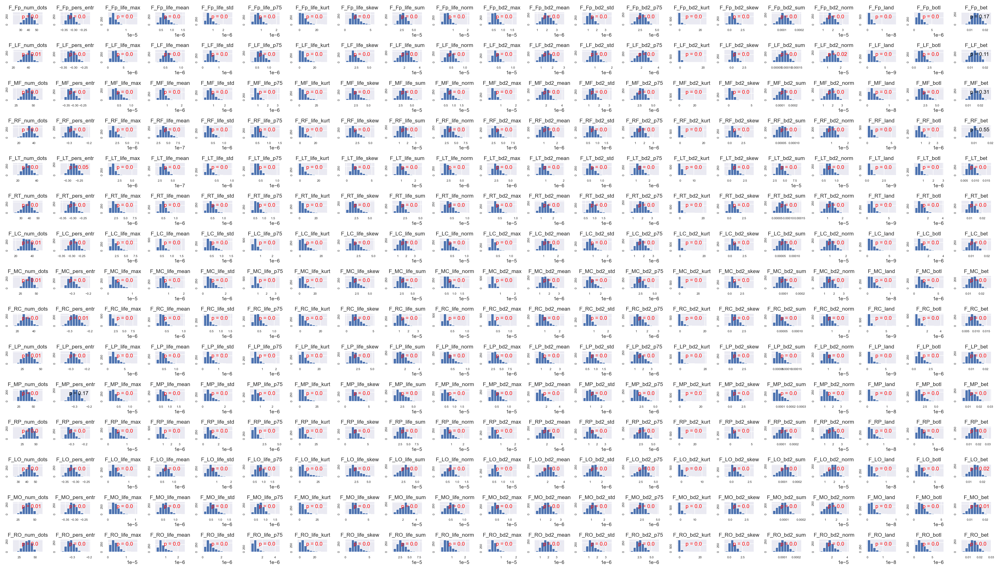

In [218]:
# Plot distribution of TDA features

hist = ve.plot_ft_distr_hist(df_ft_tda_loc, row_length=21)


<IPython.core.display.Javascript object>


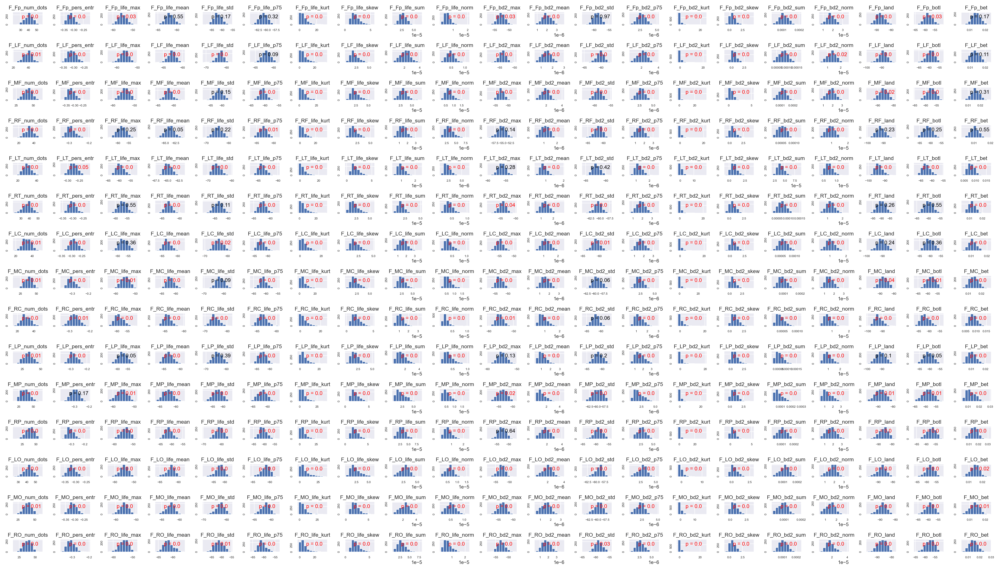

In [158]:
# Plot distribution of TDA features

hist = ve.plot_ft_distr_hist(df_ft_tda_loc_log, row_length=21)


In [80]:
# Analyzing amplitudes (Averaged by region, by spectrum)

df_ft_tda_loc_sp = []

for _freq in range(len(tda_bands)):
    df_ft_tda_loc_band = pd.DataFrame()
    for _reg in range(n_regions):
    
        ft_num_dots = NumberOfPoints().fit_transform(pd_ft_tda_loc_sp[_freq][_reg])
        ft_pers_entr = PersistenceEntropy(normalize=True, nan_fill_value=0).fit_transform(pd_ft_tda_loc_sp[_freq][_reg])
    
        pd_ft = pd_ft_tda_loc_sp[_freq][_reg]
        pd_ft_life = pd_ft[:,:,1] - pd_ft[:,:,0]
        pd_ft_life[pd_ft_life == 0] = np.nan # removing diagonal points
        pd_ft_bd2 = (pd_ft[:,:,0] + pd_ft[:,:,1]) / 2.0
        pd_ft_bd2[pd_ft_bd2 == 0] = np.nan # removing diagonal points
        
        life_max = np.nan_to_num(np.nanmax(pd_ft_life, axis=1))
        life_mean = np.nan_to_num(np.nanmean(pd_ft_life, axis=1))
        life_std = np.nan_to_num(np.nanstd(pd_ft_life, axis=1))
        #life_p25 = np.nan_to_num(np.nanpercentile(pd_ft_life, 25, axis=1))
        #life_med = np.nan_to_num(np.nanmedian(pd_ft_life, axis=1))
        life_p75 = np.nan_to_num(np.nanpercentile(pd_ft_life, 75, axis=1))
        life_kurt = np.nan_to_num(sp.stats.kurtosis(pd_ft_life, axis=1, nan_policy='omit'))
        life_skew = np.nan_to_num(sp.stats.skew(pd_ft_life, axis=1, nan_policy='omit'))
        life_sum = np.nan_to_num(np.nansum(pd_ft_life, axis=1))
        life_norm = np.linalg.norm(np.nan_to_num(pd_ft_life), ord=2, axis=1)
        
        bd2_max = np.nan_to_num(np.nanmax(pd_ft_bd2, axis=1))
        bd2_mean = np.nan_to_num(np.nanmean(pd_ft_bd2, axis=1))
        bd2_std = np.nan_to_num(np.nanstd(pd_ft_bd2, axis=1))
        #bd2_p25 = np.nan_to_num(np.nanpercentile(pd_ft_bd2, 25, axis=1))
        #bd2_med = np.nan_to_num(np.nanmedian(pd_ft_bd2, axis=1))
        bd2_p75 = np.nan_to_num(np.nanpercentile(pd_ft_bd2, 75, axis=1))
        bd2_kurt = np.nan_to_num(sp.stats.kurtosis(pd_ft_bd2, axis=1, nan_policy='omit'))
        bd2_skew = np.nan_to_num(sp.stats.skew(pd_ft_bd2, axis=1, nan_policy='omit'))
        bd2_sum = np.nan_to_num(np.nansum(pd_ft_bd2, axis=1))
        bd2_norm = np.linalg.norm(np.nan_to_num(pd_ft_bd2), ord=2, axis=1)

        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_num_dots'] = ft_num_dots[:,0]
        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_pers_entr'] = ft_pers_entr[:,0]
        
        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_life_max'] = life_max
        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_life_mean'] = life_mean
        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_life_std'] = life_std
        #df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_life_p25'] = life_p25
        #df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_life_med'] = life_med
        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_life_p75'] = life_p75
        #df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_life_kurt'] = life_kurt
        #df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_life_skew'] = life_skew
        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_life_sum'] = life_sum
        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_life_norm'] = life_norm

        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_bd2_max'] = bd2_max
        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_bd2_mean'] = bd2_mean
        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_bd2_std'] = bd2_std
        #df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_bd2_p25'] = bd2_p25
        #df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_bd2_med'] = bd2_med
        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_bd2_p75'] = bd2_p75
        #df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_bd2_kurt'] = bd2_kurt
        #df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_bd2_skew'] = bd2_skew
        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_bd2_sum'] = bd2_sum
        df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_bd2_norm'] = bd2_norm
       
        for _ampl in range(len(tda_metrics)):
            ft_ampl = Amplitude(metric=tda_metrics[_ampl][0], n_jobs=-1).fit_transform(pd_ft_tda_loc_sp[_freq][_reg])
            df_ft_tda_loc_band[tda_bands[_freq][2]+'_'+regions[_reg][1]+'_'+tda_metrics[_ampl][1]] = ft_ampl[:,0]

    # Check NaN values
    nan_cols = df_ft_tda_loc_band.loc[:, df_ft_tda_loc_band.isnull().any()].columns
    print(nan_cols)
    display(df_ft_tda_loc_band[nan_cols][df_ft_tda_loc_band.isnull().T.any()])
    
    display(df_ft_tda_loc_band.describe())
    
    # NaN values to zeros
    df_ft_tda_loc_band = pd.DataFrame(np.nan_to_num(df_ft_tda_loc_band.to_numpy()), columns=df_ft_tda_loc_band.columns)
    
    df_ft_tda_loc_sp.append(df_ft_tda_loc_band)
    print(len(df_ft_tda_loc_band.columns))


Index([], dtype='object')


""


,D_Fp_num_dots,D_Fp_pers_entr,D_Fp_life_max,D_Fp_life_mean,D_Fp_life_std,D_Fp_life_p75,D_Fp_life_sum,D_Fp_life_norm,D_Fp_bd2_max,D_Fp_bd2_mean,...,D_RO_life_norm,D_RO_bd2_max,D_RO_bd2_mean,D_RO_bd2_std,D_RO_bd2_p75,D_RO_bd2_sum,D_RO_bd2_norm,D_RO_land,D_RO_botl,D_RO_bet
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,6.10,-0.11,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
std,4.58,0.04,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
min,0.00,-0.25,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,4.00,-0.13,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
50%,5.00,-0.11,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
75%,7.00,-0.08,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
max,39.00,-0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01


255
Index([], dtype='object')


""


,T_Fp_num_dots,T_Fp_pers_entr,T_Fp_life_max,T_Fp_life_mean,T_Fp_life_std,T_Fp_life_p75,T_Fp_life_sum,T_Fp_life_norm,T_Fp_bd2_max,T_Fp_bd2_mean,...,T_RO_life_norm,T_RO_bd2_max,T_RO_bd2_mean,T_RO_bd2_std,T_RO_bd2_p75,T_RO_bd2_sum,T_RO_bd2_norm,T_RO_land,T_RO_botl,T_RO_bet
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,33.92,-0.26,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01
std,11.13,0.04,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
min,7.00,-0.36,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,26.00,-0.29,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01
50%,33.00,-0.27,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01
75%,42.00,-0.24,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01
max,74.00,-0.13,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.02


255
Index([], dtype='object')


""


,A_Fp_num_dots,A_Fp_pers_entr,A_Fp_life_max,A_Fp_life_mean,A_Fp_life_std,A_Fp_life_p75,A_Fp_life_sum,A_Fp_life_norm,A_Fp_bd2_max,A_Fp_bd2_mean,...,A_RO_life_norm,A_RO_bd2_max,A_RO_bd2_mean,A_RO_bd2_std,A_RO_bd2_p75,A_RO_bd2_sum,A_RO_bd2_norm,A_RO_land,A_RO_botl,A_RO_bet
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,42.56,-0.29,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01
std,10.84,0.04,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
min,5.00,-0.39,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,36.00,-0.31,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01
50%,42.50,-0.29,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01
75%,49.00,-0.27,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.02
max,78.00,-0.03,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.03


255
Index([], dtype='object')


""


,B_Fp_num_dots,B_Fp_pers_entr,B_Fp_life_max,B_Fp_life_mean,B_Fp_life_std,B_Fp_life_p75,B_Fp_life_sum,B_Fp_life_norm,B_Fp_bd2_max,B_Fp_bd2_mean,...,B_RO_life_norm,B_RO_bd2_max,B_RO_bd2_mean,B_RO_bd2_std,B_RO_bd2_p75,B_RO_bd2_sum,B_RO_bd2_norm,B_RO_land,B_RO_botl,B_RO_bet
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,25.45,-0.26,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01
std,5.09,0.02,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
min,9.00,-0.31,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,22.00,-0.27,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01
50%,25.00,-0.26,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01
75%,29.00,-0.24,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01
max,41.00,-0.16,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01


255
Index([], dtype='object')


""


,G_Fp_num_dots,G_Fp_pers_entr,G_Fp_life_max,G_Fp_life_mean,G_Fp_life_std,G_Fp_life_p75,G_Fp_life_sum,G_Fp_life_norm,G_Fp_bd2_max,G_Fp_bd2_mean,...,G_RO_life_norm,G_RO_bd2_max,G_RO_bd2_mean,G_RO_bd2_std,G_RO_bd2_p75,G_RO_bd2_sum,G_RO_bd2_norm,G_RO_land,G_RO_botl,G_RO_bet
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,23.26,-0.25,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
std,4.38,0.02,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
min,6.00,-0.31,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,20.00,-0.26,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
50%,23.00,-0.25,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
75%,26.00,-0.24,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
max,39.00,-0.13,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01


255


In [81]:
# Scaling features

# Full range
ft_tda_loc_sc = StandardScaler().fit_transform(df_ft_tda_loc.to_numpy())
df_ft_tda_loc_sc = pd.DataFrame(ft_tda_loc_sc, columns=df_ft_tda_loc.columns)

# By spectrum
df_ft_tda_loc_sp_sc = []
for _freq in range(len(tda_bands)):
    ft_tda_loc_sc = StandardScaler().fit_transform(df_ft_tda_loc_sp[_freq].to_numpy())
    df_ft_tda_loc_sp_sc.append(pd.DataFrame(ft_tda_loc_sc, columns=df_ft_tda_loc_sp[_freq].columns))

In [229]:
# Log-scaling TDA features

log_suff = ['life_max', 'life_mean', 'life_std', 'life_p75', 'bd2_max', 'bd2_std', '_land', '_botl']
df_ft_tda_loc_log_sp = df_ft_tda_loc_sp.copy()

for _fr in range(len(tda_bands)):
    log_cols = [col for col in df_ft_tda_loc_sp[_fr].columns if any(suf in col for suf in log_suff)]
    df_ft_tda_loc_log_sp[_fr][log_cols] = 10 * np.log10(df_ft_tda_loc_sp[_fr][log_cols].copy())

    #display(df_ft_tda_loc_sp[_fr][log_cols].describe())

,D_Fp_life_max,D_Fp_life_mean,D_Fp_life_std,D_Fp_life_p75,D_Fp_bd2_max,D_Fp_bd2_std,D_Fp_land,D_Fp_botl,D_LF_life_max,D_LF_life_mean,...,D_MO_land,D_MO_botl,D_RO_life_max,D_RO_life_mean,D_RO_life_std,D_RO_life_p75,D_RO_bd2_max,D_RO_bd2_std,D_RO_land,D_RO_botl
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
std,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
50%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
75%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
max,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


,T_Fp_life_max,T_Fp_life_mean,T_Fp_life_std,T_Fp_life_p75,T_Fp_bd2_max,T_Fp_bd2_std,T_Fp_land,T_Fp_botl,T_LF_life_max,T_LF_life_mean,...,T_MO_land,T_MO_botl,T_RO_life_max,T_RO_life_mean,T_RO_life_std,T_RO_life_p75,T_RO_bd2_max,T_RO_bd2_std,T_RO_land,T_RO_botl
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
std,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
50%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
75%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
max,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


,A_Fp_life_max,A_Fp_life_mean,A_Fp_life_std,A_Fp_life_p75,A_Fp_bd2_max,A_Fp_bd2_std,A_Fp_land,A_Fp_botl,A_LF_life_max,A_LF_life_mean,...,A_MO_land,A_MO_botl,A_RO_life_max,A_RO_life_mean,A_RO_life_std,A_RO_life_p75,A_RO_bd2_max,A_RO_bd2_std,A_RO_land,A_RO_botl
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
std,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
50%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
75%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
max,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


,B_Fp_life_max,B_Fp_life_mean,B_Fp_life_std,B_Fp_life_p75,B_Fp_bd2_max,B_Fp_bd2_std,B_Fp_land,B_Fp_botl,B_LF_life_max,B_LF_life_mean,...,B_MO_land,B_MO_botl,B_RO_life_max,B_RO_life_mean,B_RO_life_std,B_RO_life_p75,B_RO_bd2_max,B_RO_bd2_std,B_RO_land,B_RO_botl
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
std,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
50%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
75%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
max,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


,G_Fp_life_max,G_Fp_life_mean,G_Fp_life_std,G_Fp_life_p75,G_Fp_bd2_max,G_Fp_bd2_std,G_Fp_land,G_Fp_botl,G_LF_life_max,G_LF_life_mean,...,G_MO_land,G_MO_botl,G_RO_life_max,G_RO_life_mean,G_RO_life_std,G_RO_life_p75,G_RO_bd2_max,G_RO_bd2_std,G_RO_land,G_RO_botl
count,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00",...,"1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00","1,046.00"
mean,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
std,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
50%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
75%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
max,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


In [ ]:
for _freq in range(len(tda_bands)):
    hist = ve.plot_ft_distr_hist(df_ft_tda_loc_sp[_freq], row_length=21)

<IPython.core.display.Javascript object>

In [38]:
gc.collect()

30

In [66]:
# Calculate IV for the features (Averaged by region, re-referenced)

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)
n_stages = len(st_bands)

# Full range
IV_tda_list, WoE_tda_list = ve.IV_WoE_vars_clust(df_ft_tda_loc_sc, new_labels, n_bins=10)
print('Full range')
for i in range(n_stages):
    print('Cluster_' + str(i))
    df_IV_sorted = IV_tda_list[i].sort_values('IV', ascending = False)
    display(df_IV_sorted[df_IV_sorted['IV']>=0.5])
    
# By spectrum
IV_tda_list_sp = []
for _freq in range(len(tda_bands)):
    IV_list_band, WoE_list_band = ve.IV_WoE_vars_clust(df_ft_tda_loc_sp_sc[_freq], new_labels, n_bins=10)
    IV_tda_list_sp.append(IV_list_band)
    print(tda_bands[_freq][3])
    for i in range(n_stages):
        print('Cluster_' + str(i))
        df_IV_sorted = IV_tda_list_sp[_freq][i].sort_values('IV', ascending = False)
        display(df_IV_sorted[df_IV_sorted['IV']>=0.5])

Full range
Cluster_0


,Variable,IV
193,F_RC_pers_entr_H1,1.69
204,F_RC_bd2_mean_H1,1.43
192,F_RC_num_dots_H1,1.43
124,F_RT_life_std_H1,1.41
141,F_RT_wass_H1,1.37
130,F_RT_life_norm_H1,1.37
211,F_RC_bd2_norm_H1,1.37
178,F_MC_life_norm_H1,1.33
189,F_MC_wass_H1,1.33
171,F_MC_life_mean_H1,1.30


Cluster_1


,Variable,IV
40,F_LF_bd2_p75_H1,0.99
45,F_LF_wass_H1,0.98
34,F_LF_life_norm_H1,0.98
43,F_LF_bd2_norm_H1,0.92
274,F_RP_life_norm_H1,0.88
285,F_RP_wass_H1,0.88
183,F_MC_bd2_med_H1,0.88
36,F_LF_bd2_mean_H1,0.87
348,F_RO_bd2_mean_H1,0.84
283,F_RP_bd2_norm_H1,0.83


Cluster_2


,Variable,IV
190,F_MC_bet_H1,1.14
252,F_MP_bd2_mean_H1,1.04
180,F_MC_bd2_mean_H1,0.98
178,F_MC_life_norm_H1,0.97
189,F_MC_wass_H1,0.97
184,F_MC_bd2_p75_H1,0.86
187,F_MC_bd2_norm_H1,0.86
256,F_MP_bd2_p75_H1,0.78
259,F_MP_bd2_norm_H1,0.78
328,F_MO_bd2_p75_H1,0.77


Cluster_3


,Variable,IV
11,F_Fp_bd2_max_H1,0.72
259,F_MP_bd2_norm_H1,0.71
280,F_RP_bd2_p75_H1,0.67
276,F_RP_bd2_mean_H1,0.67
13,F_Fp_bd2_std_H1,0.67
283,F_RP_bd2_norm_H1,0.65
252,F_MP_bd2_mean_H1,0.65
256,F_MP_bd2_p75_H1,0.63
84,F_RF_bd2_mean_H1,0.63
328,F_MO_bd2_p75_H1,0.63


Cluster_4


,Variable,IV
307,F_LO_bd2_norm_H1,3.55
328,F_MO_bd2_p75_H1,3.54
300,F_LO_bd2_mean_H1,3.43
304,F_LO_bd2_p75_H1,3.39
303,F_LO_bd2_med_H1,3.35
324,F_MO_bd2_mean_H1,3.29
331,F_MO_bd2_norm_H1,3.29
84,F_RF_bd2_mean_H1,3.24
88,F_RF_bd2_p75_H1,3.16
327,F_MO_bd2_med_H1,3.04


Cluster_5


,Variable,IV
252,F_MP_bd2_mean_H1,1.90
228,F_LP_bd2_mean_H1,1.86
256,F_MP_bd2_p75_H1,1.86
235,F_LP_bd2_norm_H1,1.83
259,F_MP_bd2_norm_H1,1.78
262,F_MP_bet_H1,1.73
255,F_MP_bd2_med_H1,1.62
240,F_MP_num_dots_H1,1.61
232,F_LP_bd2_p75_H1,1.60
241,F_MP_pers_entr_H1,1.56


Cluster_6


,Variable,IV
184,F_MC_bd2_p75_H1,0.96
191,F_MC_land_H1,0.96
187,F_MC_bd2_norm_H1,0.90
178,F_MC_life_norm_H1,0.89
189,F_MC_wass_H1,0.89
64,F_MF_bd2_p75_H1,0.85
70,F_MF_bet_H1,0.84
60,F_MF_bd2_mean_H1,0.83
180,F_MC_bd2_mean_H1,0.82
67,F_MF_bd2_norm_H1,0.80


Cluster_7


,Variable,IV
252,F_MP_bd2_mean_H1,1.93
19,F_Fp_bd2_norm_H1,1.91
259,F_MP_bd2_norm_H1,1.81
12,F_Fp_bd2_mean_H1,1.80
36,F_LF_bd2_mean_H1,1.67
34,F_LF_life_norm_H1,1.66
45,F_LF_wass_H1,1.66
43,F_LF_bd2_norm_H1,1.64
40,F_LF_bd2_p75_H1,1.63
16,F_Fp_bd2_p75_H1,1.62


Cluster_8


,Variable,IV
130,F_RT_life_norm_H1,0.92
141,F_RT_wass_H1,0.92
15,F_Fp_bd2_med_H1,0.91
123,F_RT_life_mean_H1,0.88
140,F_RT_botl_H1,0.83
124,F_RT_life_std_H1,0.83
131,F_RT_bd2_max_H1,0.79
139,F_RT_bd2_norm_H1,0.77
136,F_RT_bd2_p75_H1,0.77
143,F_RT_land_H1,0.76


Delta (0.9-4 Hz)
Cluster_0


,Variable,IV
168,D_MC_num_dots,0.86
190,D_MC_bet,0.83
169,D_MC_pers_entr,0.83
325,D_MO_bd2_std,0.79
331,D_MO_bd2_norm,0.77
323,D_MO_bd2_max,0.77
262,D_MP_bet,0.76
241,D_MP_pers_entr,0.76
286,D_RP_bet,0.75
240,D_MP_num_dots,0.74


Cluster_1


,Variable,IV


Cluster_2


,Variable,IV
322,D_MO_life_norm,0.80
333,D_MO_wass,0.80
12,D_Fp_bd2_mean,0.71
335,D_MO_land,0.70
332,D_MO_botl,0.69
19,D_Fp_bd2_norm,0.66
13,D_Fp_bd2_std,0.64
21,D_Fp_wass,0.62
10,D_Fp_life_norm,0.62
316,D_MO_life_std,0.60


Cluster_3


,Variable,IV
10,D_Fp_life_norm,1.02
21,D_Fp_wass,1.02
23,D_Fp_land,0.97
4,D_Fp_life_std,0.97
20,D_Fp_botl,0.97
12,D_Fp_bd2_mean,0.93
13,D_Fp_bd2_std,0.93
19,D_Fp_bd2_norm,0.91
11,D_Fp_bd2_max,0.81
22,D_Fp_bet,0.73


Cluster_4


,Variable,IV
13,D_Fp_bd2_std,2.37
23,D_Fp_land,2.29
19,D_Fp_bd2_norm,2.27
20,D_Fp_botl,2.26
4,D_Fp_life_std,2.20
10,D_Fp_life_norm,2.14
21,D_Fp_wass,2.14
11,D_Fp_bd2_max,2.12
12,D_Fp_bd2_mean,2.02
22,D_Fp_bet,1.40


Cluster_5


,Variable,IV
12,D_Fp_bd2_mean,0.58
21,D_Fp_wass,0.52
10,D_Fp_life_norm,0.52


Cluster_6


,Variable,IV
169,D_MC_pers_entr,0.60
21,D_Fp_wass,0.59
10,D_Fp_life_norm,0.59
19,D_Fp_bd2_norm,0.57
168,D_MC_num_dots,0.57
322,D_MO_life_norm,0.56
333,D_MO_wass,0.56
11,D_Fp_bd2_max,0.55
316,D_MO_life_std,0.53
12,D_Fp_bd2_mean,0.52


Cluster_7


,Variable,IV
309,D_LO_wass,0.85
298,D_LO_life_norm,0.85
308,D_LO_botl,0.70
311,D_LO_land,0.69
276,D_RP_bd2_mean,0.62
310,D_LO_bet,0.61
286,D_RP_bet,0.60
11,D_Fp_bd2_max,0.55
23,D_Fp_land,0.54
292,D_LO_life_std,0.51


Cluster_8


,Variable,IV
123,D_RT_life_mean,0.64
119,D_LT_land,0.55
262,D_MP_bet,0.54


Theta (4-8 Hz)
Cluster_0


,Variable,IV
259,T_MP_bd2_norm,1.34
251,T_MP_bd2_max,1.31
252,T_MP_bd2_mean,1.30
253,T_MP_bd2_std,1.28
262,T_MP_bet,1.27
261,T_MP_wass,1.25
250,T_MP_life_norm,1.25
240,T_MP_num_dots,1.19
263,T_MP_land,1.15
260,T_MP_botl,1.14


Cluster_1


,Variable,IV
348,T_RO_bd2_mean,0.79
274,T_RP_life_norm,0.73
285,T_RP_wass,0.73
358,T_RO_bet,0.71
283,T_RP_bd2_norm,0.70
355,T_RO_bd2_norm,0.69
276,T_RP_bd2_mean,0.68
337,T_RO_pers_entr,0.67
287,T_RP_land,0.66
277,T_RP_bd2_std,0.66


Cluster_2


,Variable,IV
307,T_LO_bd2_norm,0.80
259,T_MP_bd2_norm,0.78
331,T_MO_bd2_norm,0.75
301,T_LO_bd2_std,0.75
325,T_MO_bd2_std,0.75
298,T_LO_life_norm,0.73
309,T_LO_wass,0.73
300,T_LO_bd2_mean,0.72
324,T_MO_bd2_mean,0.72
252,T_MP_bd2_mean,0.72


Cluster_3


,Variable,IV
298,T_LO_life_norm,1.01
309,T_LO_wass,1.01
331,T_MO_bd2_norm,0.86
334,T_MO_bet,0.82
323,T_MO_bd2_max,0.82
283,T_RP_bd2_norm,0.82
332,T_MO_botl,0.79
322,T_MO_life_norm,0.79
333,T_MO_wass,0.79
3,T_Fp_life_mean,0.78


Cluster_4


,Variable,IV
331,T_MO_bd2_norm,3.68
307,T_LO_bd2_norm,3.64
300,T_LO_bd2_mean,3.57
324,T_MO_bd2_mean,3.55
301,T_LO_bd2_std,3.55
325,T_MO_bd2_std,3.54
304,T_LO_bd2_p75,3.50
328,T_MO_bd2_p75,3.36
298,T_LO_life_norm,3.27
309,T_LO_wass,3.27


Cluster_5


,Variable,IV
253,T_MP_bd2_std,2.22
259,T_MP_bd2_norm,2.15
252,T_MP_bd2_mean,2.00
250,T_MP_life_norm,1.98
261,T_MP_wass,1.98
256,T_MP_bd2_p75,1.91
262,T_MP_bet,1.90
235,T_LP_bd2_norm,1.81
240,T_MP_num_dots,1.68
229,T_LP_bd2_std,1.67


Cluster_6


,Variable,IV
359,T_RO_land,1.32
156,T_LC_bd2_mean,1.29
189,T_MC_wass,1.27
178,T_MC_life_norm,1.27
132,T_RT_bd2_mean,1.20
347,T_RO_bd2_max,1.15
136,T_RT_bd2_p75,1.14
67,T_MF_bd2_norm,1.13
69,T_MF_wass,1.12
58,T_MF_life_norm,1.12


Cluster_7


,Variable,IV
19,T_Fp_bd2_norm,1.92
12,T_Fp_bd2_mean,1.84
16,T_Fp_bd2_p75,1.80
259,T_MP_bd2_norm,1.74
13,T_Fp_bd2_std,1.70
252,T_MP_bd2_mean,1.69
253,T_MP_bd2_std,1.66
262,T_MP_bet,1.58
250,T_MP_life_norm,1.47
261,T_MP_wass,1.47


Cluster_8


,Variable,IV
331,T_MO_bd2_norm,0.94
300,T_LO_bd2_mean,0.91
324,T_MO_bd2_mean,0.84
307,T_LO_bd2_norm,0.75
138,T_RT_bd2_skew,0.75
298,T_LO_life_norm,0.74
309,T_LO_wass,0.74
142,T_RT_bet,0.72
252,T_MP_bd2_mean,0.66
259,T_MP_bd2_norm,0.63


Alpha (8-14 Hz)
Cluster_0


,Variable,IV
261,A_MP_wass,1.16
250,A_MP_life_norm,1.16
243,A_MP_life_mean,1.15
253,A_MP_bd2_std,1.10
247,A_MP_life_p75,1.07
246,A_MP_life_med,1.07
259,A_MP_bd2_norm,1.07
263,A_MP_land,1.03
251,A_MP_bd2_max,1.02
260,A_MP_botl,1.01


Cluster_1


,Variable,IV
163,A_LC_bd2_norm,0.92
37,A_LF_bd2_std,0.89
277,A_RP_bd2_std,0.88
283,A_RP_bd2_norm,0.88
349,A_RO_bd2_std,0.88
346,A_RO_life_norm,0.86
357,A_RO_wass,0.86
285,A_RP_wass,0.84
274,A_RP_life_norm,0.84
156,A_LC_bd2_mean,0.84


Cluster_2


,Variable,IV
189,A_MC_wass,1.20
178,A_MC_life_norm,1.20
191,A_MC_land,1.07
188,A_MC_botl,1.02
172,A_MC_life_std,1.01
179,A_MC_bd2_max,0.95
171,A_MC_life_mean,0.89
261,A_MP_wass,0.88
250,A_MP_life_norm,0.88
181,A_MC_bd2_std,0.84


Cluster_3


,Variable,IV
322,A_MO_life_norm,1.14
333,A_MO_wass,1.14
95,A_RF_land,0.69
82,A_RF_life_norm,0.68
93,A_RF_wass,0.68
332,A_MO_botl,0.66
92,A_RF_botl,0.65
316,A_MO_life_std,0.65
335,A_MO_land,0.64
315,A_MO_life_mean,0.60


Cluster_4


,Variable,IV
333,A_MO_wass,3.66
322,A_MO_life_norm,3.66
93,A_RF_wass,3.65
82,A_RF_life_norm,3.65
298,A_LO_life_norm,3.62
309,A_LO_wass,3.62
291,A_LO_life_mean,3.60
299,A_LO_bd2_max,3.57
91,A_RF_bd2_norm,3.47
85,A_RF_bd2_std,3.42


Cluster_5


,Variable,IV
235,A_LP_bd2_norm,2.12
228,A_LP_bd2_mean,2.08
232,A_LP_bd2_p75,1.92
261,A_MP_wass,1.88
250,A_MP_life_norm,1.88
251,A_MP_bd2_max,1.86
243,A_MP_life_mean,1.85
263,A_MP_land,1.84
229,A_LP_bd2_std,1.81
260,A_MP_botl,1.75


Cluster_6


,Variable,IV
172,A_MC_life_std,1.06
178,A_MC_life_norm,1.04
189,A_MC_wass,1.04
179,A_MC_bd2_max,0.98
191,A_MC_land,0.98
181,A_MC_bd2_std,0.93
171,A_MC_life_mean,0.92
167,A_LC_land,0.81
188,A_MC_botl,0.81
130,A_RT_life_norm,0.80


Cluster_7


,Variable,IV
250,A_MP_life_norm,2.09
261,A_MP_wass,2.09
251,A_MP_bd2_max,1.97
256,A_MP_bd2_p75,1.90
259,A_MP_bd2_norm,1.89
243,A_MP_life_mean,1.88
253,A_MP_bd2_std,1.85
263,A_MP_land,1.82
252,A_MP_bd2_mean,1.80
244,A_MP_life_std,1.80


Cluster_8


,Variable,IV
97,A_LT_pers_entr,0.67
3,A_Fp_life_mean,0.62
96,A_LT_num_dots,0.60
12,A_Fp_bd2_mean,0.59
108,A_LT_bd2_mean,0.57
332,A_MO_botl,0.56
141,A_RT_wass,0.56
130,A_RT_life_norm,0.56
115,A_LT_bd2_norm,0.56
143,A_RT_land,0.55


Beta (14-25 Hz)
Cluster_0


,Variable,IV
208,B_RC_bd2_p75,3.14
204,B_RC_bd2_mean,2.83
202,B_RC_life_norm,2.73
213,B_RC_wass,2.73
211,B_RC_bd2_norm,2.61
192,B_RC_num_dots,2.50
193,B_RC_pers_entr,2.41
215,B_RC_land,2.35
205,B_RC_bd2_std,2.23
195,B_RC_life_mean,2.20


Cluster_1


,Variable,IV
208,B_RC_bd2_p75,1.02
202,B_RC_life_norm,1.01
213,B_RC_wass,1.01
192,B_RC_num_dots,0.86
214,B_RC_bet,0.82
211,B_RC_bd2_norm,0.81
193,B_RC_pers_entr,0.80
204,B_RC_bd2_mean,0.75
215,B_RC_land,0.75
205,B_RC_bd2_std,0.72


Cluster_2


,Variable,IV
237,B_LP_wass,0.53
226,B_LP_life_norm,0.53


Cluster_3


,Variable,IV
165,B_LC_wass,0.70
154,B_LC_life_norm,0.70
196,B_RC_life_std,0.64
171,B_MC_life_mean,0.63
195,B_RC_life_mean,0.62
211,B_RC_bd2_norm,0.60
215,B_RC_land,0.59
88,B_RF_bd2_p75,0.57
212,B_RC_botl,0.56
316,B_MO_life_std,0.56


Cluster_4


,Variable,IV
256,B_MP_bd2_p75,1.97
309,B_LO_wass,1.95
298,B_LO_life_norm,1.95
208,B_RC_bd2_p75,1.88
213,B_RC_wass,1.88
202,B_RC_life_norm,1.88
250,B_MP_life_norm,1.85
261,B_MP_wass,1.85
322,B_MO_life_norm,1.84
333,B_MO_wass,1.84


Cluster_5


,Variable,IV
237,B_LP_wass,1.66
226,B_LP_life_norm,1.66
239,B_LP_land,1.50
228,B_LP_bd2_mean,1.42
235,B_LP_bd2_norm,1.37
236,B_LP_botl,1.29
232,B_LP_bd2_p75,1.28
261,B_MP_wass,1.26
250,B_MP_life_norm,1.26
216,B_LP_num_dots,1.23


Cluster_6


,Variable,IV
334,B_MO_bet,0.75
202,B_RC_life_norm,0.52
213,B_RC_wass,0.52


Cluster_7


,Variable,IV
250,B_MP_life_norm,1.52
261,B_MP_wass,1.52
252,B_MP_bd2_mean,1.51
280,B_RP_bd2_p75,1.49
256,B_MP_bd2_p75,1.47
285,B_RP_wass,1.47
274,B_RP_life_norm,1.47
241,B_MP_pers_entr,1.41
240,B_MP_num_dots,1.38
279,B_RP_bd2_med,1.37


Cluster_8


,Variable,IV


Gamma (25-40 Hz)
Cluster_0


,Variable,IV
208,G_RC_bd2_p75,6.54
88,G_RF_bd2_p75,5.73
204,G_RC_bd2_mean,5.26
211,G_RC_bd2_norm,5.21
205,G_RC_bd2_std,5.17
213,G_RC_wass,5.13
202,G_RC_life_norm,5.13
192,G_RC_num_dots,4.98
215,G_RC_land,4.94
193,G_RC_pers_entr,4.92


Cluster_1


,Variable,IV
88,G_RF_bd2_p75,4.17
84,G_RF_bd2_mean,3.67
91,G_RF_bd2_norm,3.53
93,G_RF_wass,3.50
82,G_RF_life_norm,3.50
211,G_RC_bd2_norm,3.33
204,G_RC_bd2_mean,3.32
202,G_RC_life_norm,3.25
213,G_RC_wass,3.25
205,G_RC_bd2_std,3.18


Cluster_2


,Variable,IV
193,G_RC_pers_entr,1.07
192,G_RC_num_dots,1.07
204,G_RC_bd2_mean,1.06
208,G_RC_bd2_p75,1.05
213,G_RC_wass,1.02
202,G_RC_life_norm,1.02
88,G_RF_bd2_p75,0.97
84,G_RF_bd2_mean,0.89
93,G_RF_wass,0.88
82,G_RF_life_norm,0.88


Cluster_3


,Variable,IV
84,G_RF_bd2_mean,1.09
82,G_RF_life_norm,1.07
93,G_RF_wass,1.07
88,G_RF_bd2_p75,1.03
73,G_RF_pers_entr,1.03
112,G_LT_bd2_p75,1.03
91,G_RF_bd2_norm,0.99
85,G_RF_bd2_std,0.95
108,G_LT_bd2_mean,0.93
95,G_RF_land,0.92


Cluster_4


,Variable,IV
204,G_RC_bd2_mean,1.62
193,G_RC_pers_entr,1.57
192,G_RC_num_dots,1.55
202,G_RC_life_norm,1.54
213,G_RC_wass,1.54
214,G_RC_bet,1.49
211,G_RC_bd2_norm,1.37
208,G_RC_bd2_p75,1.32
84,G_RF_bd2_mean,1.29
205,G_RC_bd2_std,1.28


Cluster_5


,Variable,IV
215,G_RC_land,1.13
213,G_RC_wass,1.11
202,G_RC_life_norm,1.11
204,G_RC_bd2_mean,1.03
211,G_RC_bd2_norm,0.99
193,G_RC_pers_entr,0.97
205,G_RC_bd2_std,0.92
196,G_RC_life_std,0.91
208,G_RC_bd2_p75,0.91
91,G_RF_bd2_norm,0.91


Cluster_6


,Variable,IV
73,G_RF_pers_entr,1.11
72,G_RF_num_dots,1.05
95,G_RF_land,1.05
91,G_RF_bd2_norm,1.03
84,G_RF_bd2_mean,1.03
93,G_RF_wass,0.98
82,G_RF_life_norm,0.98
94,G_RF_bet,0.97
205,G_RC_bd2_std,0.94
211,G_RC_bd2_norm,0.93


Cluster_7


,Variable,IV
91,G_RF_bd2_norm,1.07
193,G_RC_pers_entr,1.04
192,G_RC_num_dots,1.03
213,G_RC_wass,1.03
202,G_RC_life_norm,1.03
204,G_RC_bd2_mean,1.01
208,G_RC_bd2_p75,1.01
93,G_RF_wass,0.99
82,G_RF_life_norm,0.99
214,G_RC_bet,0.97


Cluster_8


,Variable,IV
93,G_RF_wass,1.14
82,G_RF_life_norm,1.14
95,G_RF_land,1.14
73,G_RF_pers_entr,1.08
84,G_RF_bd2_mean,1.01
91,G_RF_bd2_norm,1.00
72,G_RF_num_dots,0.98
94,G_RF_bet,0.90
204,G_RC_bd2_mean,0.86
196,G_RC_life_std,0.83


In [33]:
# Export IV sheets to Excel

# Full range
dir_name = 'pd_ft_rr_tda_loc'
with pd.ExcelWriter(os.path.join(excel_root_path, dir_name+'_IV.xlsx')) as writer:
    for i in range(n_stages):
        df_IV_sorted = tda_IV_list[i].sort_values('IV', ascending = False)
        df_IV_sorted.to_excel(writer, sheet_name='Cluster_'+str(i))
        
# By spectrum
for _freq in range(len(tda_bands)):
    dir_name = 'pd_ft_rr_tda_loc_'+tda_bands[_freq][2]
    with pd.ExcelWriter(os.path.join(excel_root_path, dir_name+'_IV.xlsx')) as writer:
        for i in range(n_stages):
            df_IV_sorted = tda_IV_list_sp[_freq][i].sort_values('IV', ascending = False)
            df_IV_sorted.to_excel(writer, sheet_name='Cluster_'+str(i))

In [61]:
N_BEST_FEATURES = 10

df_ft_tda_loc_total = pd.concat([df_ft_tda_loc_sp_sc[i] for i in range(len(tda_bands))], axis=1)
df_ft_tda_loc_total = pd.concat([df_ft_tda_loc_total, df_ft_tda_loc_sc], axis=1)

df_features = df_ft_tda_loc_total
best_IV_list, best_WoE_list = ve.best_IV_WoE_vars_clust(df_features, new_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)


<IPython.core.display.Javascript object>


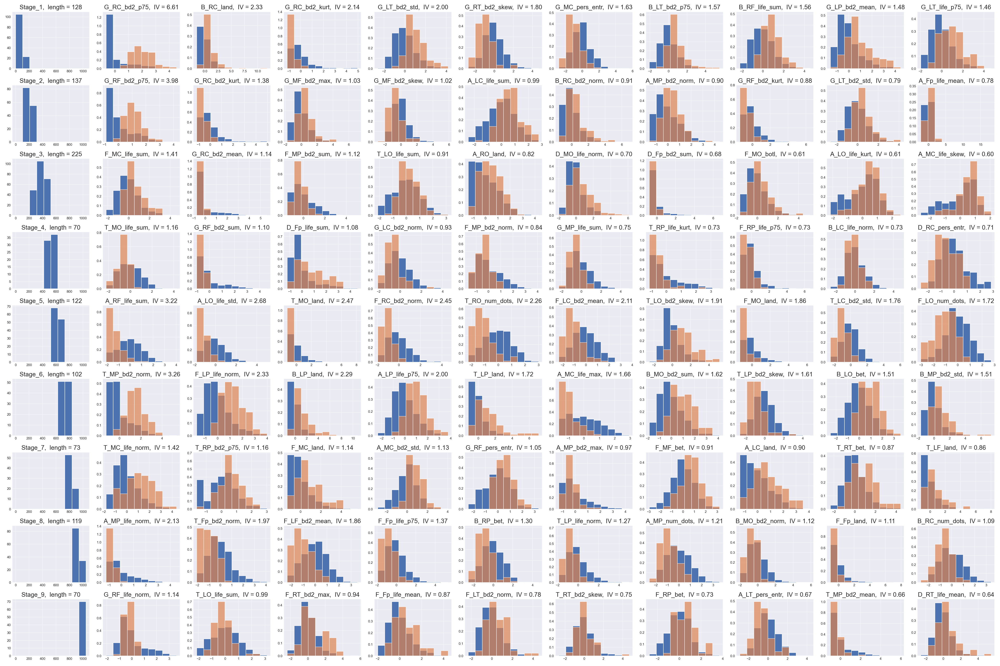

(<Figure size 3600x2400 with 99 Axes>,
 array([[<AxesSubplot:title={'center':'Stage_1,  length = 128'}>,
         <AxesSubplot:title={'center':'G_RC_bd2_p75,  IV = 6.61'}>,
         <AxesSubplot:title={'center':'B_RC_land,  IV = 2.33'}>,
         <AxesSubplot:title={'center':'G_RC_bd2_kurt,  IV = 2.14'}>,
         <AxesSubplot:title={'center':'G_LT_bd2_std,  IV = 2.00'}>,
         <AxesSubplot:title={'center':'G_RT_bd2_skew,  IV = 1.80'}>,
         <AxesSubplot:title={'center':'G_MC_pers_entr,  IV = 1.63'}>,
         <AxesSubplot:title={'center':'B_LT_bd2_p75,  IV = 1.57'}>,
         <AxesSubplot:title={'center':'B_RF_life_sum,  IV = 1.56'}>,
         <AxesSubplot:title={'center':'G_LP_bd2_mean,  IV = 1.48'}>,
         <AxesSubplot:title={'center':'G_LT_life_p75,  IV = 1.46'}>],
        [<AxesSubplot:title={'center':'Stage_2,  length = 137'}>,
         <AxesSubplot:title={'center':'G_RF_bd2_p75,  IV = 3.98'}>,
         <AxesSubplot:title={'center':'G_RC_bd2_kurt,  IV = 1.38'}>,
       

In [62]:
# R2 TDA features (averaged by region)

ve.plot_hist_best_vars(df_features, new_labels, best_IV_list)

# Predictive modelling

## Preprocessing data

In [56]:
gc.collect()

109

In [57]:
# IV threshold for features

st_bands, new_labels = spr.form_stage_bands(st_edges_median, n_samples)
n_stages = len(st_bands)

df_ft_sync_ind_orig = pd.concat([df_ft_coh_ind_loc_sc, df_ft_plv_ind_loc_sc], axis=1)
df_ft_psd_orig = pd.concat([df_ft_psd_loc_db_sc, df_ft_psd_ind_log_sc], axis=1)


IV_sync_ind_list, WoE_sync_ind_list = ve.IV_WoE_vars_clust(df_ft_sync_ind_orig, new_labels, n_bins=10)
IV_psd_list, WoE_psd_list = ve.IV_WoE_vars_clust(df_ft_psd_orig, new_labels, n_bins=10)
IV_sync_ind_best = []
IV_psd_best = []
for _st in range(n_stages):
    print('Stage_' + str(_st+1))
    # Synchrony Indices (Coherence & PLV)
    df_IV_sync_ind_sort = IV_sync_ind_list[_st].sort_values('IV', ascending = False)
    IV_sync_ind_best.append(df_IV_sync_ind_sort[df_IV_sync_ind_sort['IV']>=0.4])
    # PSD
    df_IV_psd_sort = IV_psd_list[_st].sort_values('IV', ascending = False)
    IV_psd_best.append(df_IV_psd_sort[df_IV_psd_sort['IV']>=0.4])
   
    print('Sync_Ind', len(df_IV_sync_ind_sort.index), len(IV_sync_ind_best[_st].index))
    print('PSD', len(df_IV_psd_sort.index), len(IV_psd_best[_st].index))


Stage_1
Sync_Ind 450 344
PSD 331 234
Stage_2
Sync_Ind 450 177
PSD 331 174
Stage_3
Sync_Ind 450 222
PSD 331 165
Stage_4
Sync_Ind 450 361
PSD 331 222
Stage_5
Sync_Ind 450 288
PSD 331 227
Stage_6
Sync_Ind 450 303
PSD 331 207
Stage_7
Sync_Ind 450 333
PSD 331 172
Stage_8
Sync_Ind 450 249
PSD 331 190
Stage_9
Sync_Ind 450 303
PSD 331 152


In [82]:
# IV threshold for TDA features

IV_threshold = 0.5

# Full range
IV_tda_list, WoE_tda_list = ve.IV_WoE_vars_clust(df_ft_tda_loc_sc, new_labels, n_bins=10)

IV_tda_best_full = []
for _st in range(n_stages):
    print('Stage_' + str(_st+1))
    df_IV_tda_sort = IV_tda_list[_st].sort_values('IV', ascending = False)
    IV_tda_best_full.append(df_IV_tda_sort[df_IV_tda_sort['IV']>=IV_threshold])
    print(len(df_IV_tda_sort), len(IV_tda_best_full[_st]))

# By spectrum
IV_tda_list_sp = []
for _freq in range(len(tda_bands)):
    IV_list_band, WoE_list_band = ve.IV_WoE_vars_clust(df_ft_tda_loc_sp_sc[_freq], new_labels, n_bins=10)
    IV_tda_list_sp.append(IV_list_band)

IV_tda_best_sp = []
for _fr in range(n_freq):
    IV_tda_best = []
    print(bands[_fr][2])
    for _st in range(n_stages):
        print('Stage_' + str(_st+1))
        df_IV_tda_sort = IV_tda_list_sp[_fr][_st].sort_values('IV', ascending = False)
        IV_tda_best.append(df_IV_tda_sort[df_IV_tda_sort['IV']>=IV_threshold])
        print(len(df_IV_tda_sort.index), len(IV_tda_best[_st].index))
    IV_tda_best_sp.append(IV_tda_best)

Stage_1
315 79
Stage_2
315 89
Stage_3
315 75
Stage_4
315 45
Stage_5
315 230
Stage_6
315 133
Stage_7
315 96
Stage_8
315 158
Stage_9
315 62
Delta (0.9-4 Hz)
Stage_1
255 42
Stage_2
255 0
Stage_3
255 15
Stage_4
255 31
Stage_5
255 17
Stage_6
255 19
Stage_7
255 11
Stage_8
255 17
Stage_9
255 3
Theta (4-8 Hz)
Stage_1
255 31
Stage_2
255 44
Stage_3
255 40
Stage_4
255 94
Stage_5
255 208
Stage_6
255 109
Stage_7
255 158
Stage_8
255 118
Stage_9
255 35
Alpha (8-14 Hz)
Stage_1
255 33
Stage_2
255 132
Stage_3
255 94
Stage_4
255 22
Stage_5
255 237
Stage_6
255 154
Stage_7
255 123
Stage_8
255 189
Stage_9
255 30
Beta (14-25 Hz)
Stage_1
255 97
Stage_2
255 31
Stage_3
255 1
Stage_4
255 17
Stage_5
255 220
Stage_6
255 174
Stage_7
255 4
Stage_8
255 194
Stage_9
255 0
Gamma (25-40 Hz)
Stage_1
255 180
Stage_2
255 100
Stage_3
255 34
Stage_4
255 123
Stage_5
255 121
Stage_6
255 57
Stage_7
255 50
Stage_8
255 83
Stage_9
255 40


In [ ]:
# Best IV TDA features (non-correlating)

N_BEST_FEATURES = 1000

df_ft_tda_orig = pd.concat([df_ft_rr_tda_loc_sp_sc[i] for i in range(len(tda_bands))], axis=1)
#df_ft_rr_tda_loc_total = pd.concat([df_ft_tda_orig, df_ft_rr_tda_loc_sc], axis=1)

df_features = df_ft_tda_orig
best_IV_list, best_WoE_list = ve.best_IV_WoE_vars_clust(df_features, new_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.6, IV_threshold=0.5)
for _st in range(n_stages):
    print('Stage_' + str(_st+1))
    print(len(best_IV_list[_st].index))

In [27]:
# IV threshold for Coherence & PLV features

# Scaling features
ft_coh_loc_sc = StandardScaler().fit_transform(df_ft_coh_loc.to_numpy())
df_ft_coh_loc_sc = pd.DataFrame(ft_coh_loc_sc, columns=df_ft_coh_loc.columns)
ft_plv_loc_sc = StandardScaler().fit_transform(df_ft_plv_loc.to_numpy())
df_ft_plv_loc_sc = pd.DataFrame(ft_plv_loc_sc, columns=df_ft_plv_loc.columns)

df_ft_sync_orig = pd.concat([df_ft_coh_loc_sc, df_ft_plv_loc_sc], axis=1)

IV_sync_list, WoE_sync_list = ve.IV_WoE_vars_clust(df_ft_sync_orig, new_labels)
IV_sync_best = []
for _st in range(n_stages):
    print('Stage_' + str(_st+1))
    df_IV_sync_sort = IV_sync_list[_st].sort_values('IV', ascending = False)
    IV_sync_best.append(df_IV_sync_sort[df_IV_sync_sort['IV']>=0.5])
    print(len(df_IV_sync_sort.index), len(IV_sync_best[_st].index))

Stage_1
1050 804
Stage_2
1050 541
Stage_3
1050 580
Stage_4
1050 904
Stage_5
1050 783
Stage_6
1050 751
Stage_7
1050 891
Stage_8
1050 720
Stage_9
1050 826


In [59]:
# PCA decomposition (PSD features)

pca = decomposition.PCA(n_components=0.9)

# Binary classification
df_ft_psd_pca_bin = []
mult_cols = [] # multi-class columns

for _st in range(n_stages):
    print('Stage_' + str(_st+1))
    bin_cols = IV_psd_best[_st]['Variable'].to_numpy()
    mult_cols += list(bin_cols)
    print(len(bin_cols))

    ft_psd_pca = pca.fit_transform(df_ft_psd_orig[bin_cols])
    print(ft_psd_pca.shape)

    n_pca_comps = len(ft_psd_pca[0,:])
    pca_comp_names = ['PCA_'+str(i) for i in range(n_pca_comps)]
    df_ft_psd_pca_bin.append(pd.DataFrame(ft_psd_pca, columns=pca_comp_names))

# Multi-class classification
mult_cols = list(set(mult_cols))
print('Overall', len(mult_cols))
ft_psd_pca_mult = pca.fit_transform(df_ft_psd_orig[mult_cols])
print(ft_psd_pca_mult.shape)

n_pca_comps = len(ft_psd_pca_mult[0,:])
pca_comp_names = ['PCA_'+str(i) for i in range(n_pca_comps)]
df_ft_psd_pca_mult = pd.DataFrame(ft_psd_pca_mult, columns=pca_comp_names)


Stage_1
234
(1046, 20)
Stage_2
174
(1046, 17)
Stage_3
165
(1046, 12)
Stage_4
222
(1046, 21)
Stage_5
227
(1046, 21)
Stage_6
207
(1046, 19)
Stage_7
172
(1046, 15)
Stage_8
190
(1046, 19)
Stage_9
152
(1046, 15)
Overall 331
(1046, 24)


In [60]:
# PCA decomposition (Coherence & PLV Index features)

pca = decomposition.PCA(n_components=0.9)

# Binary classification
df_ft_sync_ind_pca_bin = []
mult_cols = [] # multi-class columns

for _st in range(n_stages):
    print('Stage_' + str(_st+1))
    bin_cols = IV_sync_ind_best[_st]['Variable'].to_numpy()
    mult_cols += list(bin_cols)
    print(len(bin_cols))

    ft_sync_ind_pca = pca.fit_transform(df_ft_sync_ind_orig[bin_cols])
    print(ft_sync_ind_pca.shape)

    n_pca_comps = len(ft_sync_ind_pca[0,:])
    pca_comp_names = ['PCA_'+str(i) for i in range(n_pca_comps)]
    df_ft_sync_ind_pca_bin.append(pd.DataFrame(ft_sync_ind_pca, columns=pca_comp_names))

# Multi-class classification
mult_cols = list(set(mult_cols))
print('Overall', len(mult_cols))
ft_sync_ind_pca_mult = pca.fit_transform(df_ft_sync_ind_orig[mult_cols])
print(ft_sync_ind_pca_mult.shape)

n_pca_comps = len(ft_sync_ind_pca_mult[0,:])
pca_comp_names = ['PCA_'+str(i) for i in range(n_pca_comps)]
df_ft_sync_ind_pca_mult = pd.DataFrame(ft_sync_ind_pca_mult, columns=pca_comp_names)


Stage_1
344
(1046, 55)
Stage_2
177
(1046, 38)
Stage_3
222
(1046, 41)
Stage_4
361
(1046, 51)
Stage_5
288
(1046, 41)
Stage_6
303
(1046, 45)
Stage_7
333
(1046, 43)
Stage_8
249
(1046, 40)
Stage_9
303
(1046, 47)
Overall 445
(1046, 60)


In [83]:
# PCA decomposition (TDA features)

pca = decomposition.PCA(n_components=0.9)

#drop_cols = [col for ]
df_ft_tda_orig = pd.concat([df_ft_tda_loc_sp_sc[_st] for _st in range(len(tda_bands))], axis=1)
#df_ft_tda_orig = pd.concat([df_ft_tda_orig, df_ft_tda_loc_sc], axis=1)

# Binary classification
df_ft_tda_pca_bin = []
mult_cols = [] # multi-class columns

for _st in range(n_stages):
    print('Stage_' + str(_st+1))
    #bin_cols = list(IV_tda_best_full[_st]['Variable'].to_numpy())
    bin_cols = []
    for _fr in range(n_freq):
        bin_cols += list(IV_tda_best_sp[_fr][_st]['Variable'].to_numpy())
    mult_cols += bin_cols
    print(len(bin_cols))

    ft_tda_pca = pca.fit_transform(df_ft_tda_orig[bin_cols])
    print(ft_tda_pca.shape)

    n_pca_comps = len(ft_tda_pca[0,:])
    pca_comp_names = ['PCA_'+str(i) for i in range(n_pca_comps)]
    df_ft_tda_pca_bin.append(pd.DataFrame(ft_tda_pca, columns=pca_comp_names))

# Multi-class classification
mult_cols = list(set(mult_cols))
print('Overall', len(mult_cols))
ft_tda_pca_mult = pca.fit_transform(df_ft_tda_orig[mult_cols])
print(ft_tda_pca_mult.shape)

n_pca_comps = len(ft_tda_pca_mult[0,:])
pca_comp_names = ['PCA_'+str(i) for i in range(n_pca_comps)]
df_ft_tda_pca_mult = pd.DataFrame(ft_tda_pca_mult, columns=pca_comp_names)


Stage_1
383
(1046, 56)
Stage_2
307
(1046, 36)
Stage_3
184
(1046, 20)
Stage_4
287
(1046, 45)
Stage_5
803
(1046, 94)
Stage_6
513
(1046, 63)
Stage_7
346
(1046, 41)
Stage_8
601
(1046, 73)
Stage_9
108
(1046, 18)
Overall 981
(1046, 121)


In [84]:
# PCA decomposition (PSD + TDA)

pca = decomposition.PCA(n_components=0.9)
df_ft_psd_tda_orig = pd.concat([df_ft_psd_orig, df_ft_tda_orig], axis=1)

# Binary classification
df_ft_psd_tda_pca_bin = []
mult_cols = [] # multi-class columns

for _st in range(n_stages):
    print('Stage_' + str(_st+1))
    bin_tda_cols = []
    #bin_tda_cols = list(IV_tda_best_full[_st]['Variable'].to_numpy())
    for _fr in range(n_freq):
        bin_tda_cols += list(IV_tda_best_sp[_fr][_st]['Variable'].to_numpy())
    
    bin_cols = list(IV_psd_best[_st]['Variable'].to_numpy()) + bin_tda_cols
    mult_cols += bin_cols
    print(len(bin_cols))

    ft_psd_tda_pca = pca.fit_transform(df_ft_psd_tda_orig[bin_cols])
    print(ft_psd_tda_pca.shape)

    n_pca_comps = len(ft_psd_tda_pca[0,:])
    pca_comp_names = ['PCA_'+str(i) for i in range(n_pca_comps)]
    df_ft_psd_tda_pca_bin.append(pd.DataFrame(ft_psd_tda_pca, columns=pca_comp_names))

# Multi-class classification
mult_cols = list(set(mult_cols))
print('Overall', len(mult_cols))
ft_psd_tda_pca_mult = pca.fit_transform(df_ft_psd_tda_orig[mult_cols])
print(ft_psd_tda_pca_mult.shape)

n_pca_comps = len(ft_psd_tda_pca_mult[0,:])
pca_comp_names = ['PCA_'+str(i) for i in range(n_pca_comps)]
df_ft_psd_tda_pca_mult = pd.DataFrame(ft_psd_tda_pca_mult, columns=pca_comp_names)


Stage_1
617
(1046, 65)
Stage_2
481
(1046, 45)
Stage_3
349
(1046, 27)
Stage_4
509
(1046, 56)
Stage_5
1030
(1046, 99)
Stage_6
720
(1046, 71)
Stage_7
518
(1046, 48)
Stage_8
791
(1046, 78)
Stage_9
260
(1046, 28)
Overall 1312
(1046, 124)


## Modelling

In [ ]:
# Random Forest tuning

rf = RandomForestClassifier()
rf_params = { "n_estimators": {50, 100, 200},
             "max_depth": {3, 5, 7, 'None'},
             "max_features": {2, 4, 6, 8, 'log2', 'sqrt'},
             "min_samples_split": {2, 4, 6}
            }



In [189]:
# Multiclass classification

X = df_ft_psd_pca_mult.to_numpy()
#X = df_ft_sync_ind_pca_mult.to_numpy()
#X = df_ft_tda_pca_mult.to_numpy()
#X = df_ft_psd_tda_pca_mult.to_numpy()
print(X.shape)
y = new_labels
#print(y.shape, y)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, stratify=y)
    
clf_svc = svm.LinearSVC(C=1, multi_class='ovr').fit(X_train, y_train)
clf_lrCV = LogisticRegressionCV(Cs=10, cv=5, solver='lbfgs', multi_class='multinomial').fit(X_train, y_train)
clf_rf = RandomForestClassifier().fit(X_train, y_train)
clf_xgb = XGBClassifier(max_depth=5, objective='multi:softmax', num_class=n_stages, n_estimators=100).fit(X_train, y_train)

y_pred_svc = clf_svc.predict(X_test)
y_pred_lrCV = clf_lrCV.predict(X_test)
y_pred_rf = clf_rf.predict(X_test)
y_pred_xgb = clf_xgb.predict(X_test)

acc = accuracy_score(y_test, y_pred_svc)
f1 = f1_score(y_test, y_pred_svc, average='macro')
print('Linear SVC: ', 'accuracy = ', acc, 'f1 = ', f1)
print(confusion_matrix(y_test, y_pred_svc))
print(classification_report(y_test, y_pred_svc))

acc = accuracy_score(y_test, y_pred_lrCV)
f1 = f1_score(y_test, y_pred_lrCV, average='macro')
print('LogRegrCV:', 'accuracy = ', acc, 'f1 = ', f1)
print(confusion_matrix(y_test, y_pred_lrCV))
print(classification_report(y_test, y_pred_lrCV))

acc = accuracy_score(y_test, y_pred_rf)
f1 = f1_score(y_test, y_pred_rf, average='macro')
print('Random Forest:', 'accuracy = ', acc, 'f1 = ', f1)
print(confusion_matrix(y_test, y_pred_rf))
print(classification_report(y_test, y_pred_rf))

acc = accuracy_score(y_test, y_pred_xgb)
f1 = f1_score(y_test, y_pred_xgb, average='macro')
print('XGBoost:', 'accuracy = ', acc, 'f1 = ', f1)
print(confusion_matrix(y_test, y_pred_xgb))
print(classification_report(y_test, y_pred_xgb))


(1046, 24)
[01:02:28] WARNING: C:\Windows\Temp\abs_557yfx631l\croots\recipe\xgboost-split_1659548953302\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Linear SVC:  accuracy =  0.7088305489260143 f1 =  0.6426686811091491
[[42  8  0  0  0  0  0  0  1]
 [ 3 52  0  0  0  0  0  0  0]
 [ 0  6 72  1  4  0  3  1  3]
 [ 0  0  3 14  3  2  2  3  1]
 [ 0  0  1  7 33  2  0  6  0]
 [ 0  0  0  1  0 40  0  0  0]
 [ 0  2  9  3  3  4  5  2  1]
 [ 0  1  7  0  3  1  3 30  3]
 [ 0  1  8  3  2  2  2  1  9]]
              precision    recall  f1-score   support

         0.0       0.93      0.82      0.87        51
         1.0       0.74      0.95      0.83        55
         2.0       0.72      0.80      0.76        90
         3.0       0.48      0.50      0.49        28
         4.0       0.69      0.67      0.68       

In [190]:
# Compute binary prediction scores (classes and probability) 

def predict_bin_compute(X_train, y_train, X_test, mdl_name):
    if mdl_name == 'Linear SVM':
        clf = svm.SVC(kernel='linear', C=1, probability=True).fit(X_train, y_train)

    if mdl_name == 'RBF SVM':
        clf = svm.SVC(kernel='rbf', C=1, probability=True).fit(X_train, y_train)

    if mdl_name == 'LogRegrCV':
        clf = LogisticRegressionCV(Cs=10, cv=5, solver='liblinear').fit(X_train, y_train)

    if mdl_name == 'RForest':
        clf = RandomForestClassifier(max_depth=6, n_estimators=1000).fit(X_train, y_train)
        
    if mdl_name == 'XGBoost':
        clf = XGBClassifier(eval_metric='logloss', max_depth=6, n_estimators=1000).fit(X_train, y_train)

    y_pred = clf.predict(X_test)
    y_prob = clf.predict_proba(X_test)[:,1]
    
    return y_pred, y_prob

In [191]:
# Binary classification

# Global variables
test_coef = 0.4 # Test sample percentage
mdl_names_bin = ['Linear SVM', 'RBF SVM', 'LogRegrCV']#, 'XGBoost']
datasets = ['PSD', 'TDA', 'Sync_Ind']#, 'PSD+TDA']
mdl_metrics_bin = ['Gini', 'Balanced Accuracy', 'F1 Score', 'Precision', 'Recall']
st_names = ['Stage_'+str(i+1) for i in range(n_stages)]

df_mdl_metrics = pd.DataFrame(index=pd.MultiIndex.from_product([st_names, mdl_names_bin], names=['Stage:', 'Model:']), 
                              columns=pd.MultiIndex.from_product([mdl_metrics_bin, datasets], names=['Metrics:', 'Datasets:']))
n_metrics = len(mdl_metrics_bin)
n_datasets = len(datasets)
n_models = len(mdl_names_bin)

# Predictions vector 
test_size = int(test_coef*n_samples)+1
y_test_st_ds = np.zeros((test_size, n_stages, n_datasets))
y_prob_st_ds_mdl = np.zeros((test_size, n_stages, n_datasets, n_models))

# Compute predictions
for _st in range(n_stages):
    metrics_ds_mdl = np.zeros((n_metrics, n_datasets, n_models))

    y = (new_labels==_st).astype(int) # binary target
    for _ds in range(n_datasets):
        if _ds == 0: # PSD
            X = df_ft_psd_pca_bin[_st].to_numpy()
        if _ds == 1: # TDA
            X = df_ft_tda_pca_bin[_st].to_numpy()
        if _ds == 2: # PSD+TDA
            X = df_ft_psd_tda_pca_bin[_st].to_numpy()
        if _ds == 3: # Sync_Ind
            X = df_ft_sync_ind_pca_bin[_st].to_numpy()
                
        # Splitting sample for current dataset
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_coef, stratify=y)
        y_test_st_ds[:,_st,_ds] = y_test
        
        # Modelling
        for _mdl in range(n_models):
            # Make predictions
            y_pred, y_prob = predict_bin_compute(X_train, y_train, X_test, mdl_names_bin[_mdl])
            y_prob_st_ds_mdl[:,_st,_ds,_mdl] = y_prob
                        
            # Compute prediction metrics
            metrics_row = np.zeros(n_metrics)
            metrics_row[0] = 2*roc_auc_score(y_test, y_prob) - 1 # 'Gini'
            metrics_row[1] = balanced_accuracy_score(y_test, y_pred) # 'Balanced Accuracy'
            metrics_row[2] = f1_score(y_test, y_pred) # 'F1 Score'
            metrics_row[3] = precision_score(y_test, y_pred) # 'Precision'
            metrics_row[4] = recall_score(y_test, y_pred) # 'Recall'
            #print([round(x,2) for x in metrics_row])       
            
            metrics_ds_mdl[:,_ds,_mdl] = metrics_row
            
    # Create DataFrame with metrics
    for _mdl in range(n_models):
        new_row = {(mdl_metrics_bin[_metr], datasets[_ds]): metrics_ds_mdl[_metr,_ds,_mdl] 
                   for _metr in range(n_metrics) for _ds in range(n_datasets)}
        print([round(x,2) for x in new_row.values()])
        #print(new_row)
        df_mdl_metrics.loc[(st_names[_st], mdl_names_bin[_mdl]),:] = new_row
                

[0.99, 0.95, 0.98, 0.95, 0.85, 0.93, 0.9, 0.76, 0.85, 0.87, 0.8, 0.82, 0.92, 0.73, 0.88]
[0.99, 0.98, 0.99, 0.92, 0.95, 0.91, 0.88, 0.86, 0.88, 0.91, 0.8, 0.95, 0.84, 0.94, 0.82]
[0.99, 0.96, 0.99, 0.95, 0.91, 0.93, 0.9, 0.81, 0.88, 0.87, 0.78, 0.88, 0.92, 0.84, 0.88]
[0.85, 0.77, 0.83, 0.75, 0.67, 0.78, 0.61, 0.45, 0.63, 0.7, 0.54, 0.64, 0.55, 0.38, 0.62]
[0.96, 0.95, 0.96, 0.9, 0.78, 0.89, 0.81, 0.7, 0.82, 0.79, 0.86, 0.85, 0.84, 0.58, 0.8]
[0.87, 0.79, 0.87, 0.73, 0.68, 0.79, 0.57, 0.48, 0.61, 0.69, 0.66, 0.57, 0.49, 0.38, 0.65]
[0.79, 0.75, 0.81, 0.69, 0.75, 0.79, 0.55, 0.62, 0.69, 0.78, 0.67, 0.72, 0.42, 0.58, 0.66]
[0.89, 0.87, 0.91, 0.77, 0.78, 0.82, 0.68, 0.69, 0.73, 0.88, 0.83, 0.78, 0.56, 0.59, 0.69]
[0.8, 0.76, 0.82, 0.7, 0.73, 0.8, 0.55, 0.59, 0.69, 0.73, 0.63, 0.7, 0.44, 0.56, 0.68]
[0.88, 0.74, 0.7, 0.68, 0.7, 0.7, 0.5, 0.44, 0.46, 0.83, 0.46, 0.5, 0.36, 0.43, 0.43]
[0.93, 0.92, 0.86, 0.52, 0.53, 0.68, 0.07, 0.13, 0.51, 1.0, 0.67, 0.91, 0.04, 0.07, 0.36]
[0.88, 0.76, 0.8,

In [192]:
# Binary classification

# Global variables
test_coef = 0.4 # Test sample percentage
mdl_names_bin = ['Linear SVM', 'RBF SVM', 'LogRegrCV']#, 'XGBoost']
datasets = ['PSD', 'TDA', 'Sync_Ind']#, 'PSD+TDA']
mdl_metrics_bin = ['Gini', 'Balanced Accuracy', 'F1 Score', 'Precision', 'Recall']
st_names = ['Stage_'+str(i+1) for i in range(n_stages)]

df_mdl_metrics = pd.DataFrame(columns=pd.MultiIndex.from_product([st_names, mdl_names_bin], names=['Stage:', 'Model:']), 
                              index=pd.MultiIndex.from_product([mdl_metrics_bin, datasets], names=['Metric:', 'Dataset:']))
n_metrics = len(mdl_metrics_bin)
n_datasets = len(datasets)
n_models = len(mdl_names_bin)

# Predictions vector 
test_size = int(test_coef*n_samples)+1
y_test_st_ds = np.zeros((test_size, n_stages, n_datasets))
y_prob_st_ds_mdl = np.zeros((test_size, n_stages, n_datasets, n_models))

# Compute predictions
for _st in range(n_stages):
    metrics_ds_mdl = np.zeros((n_metrics, n_datasets, n_models))

    y = (new_labels==_st).astype(int) # binary target
    for _ds in range(n_datasets):
        if _ds == 0: # PSD
            X = df_ft_psd_pca_bin[_st].to_numpy()
        if _ds == 1: # TDA
            X = df_ft_tda_pca_bin[_st].to_numpy()
        if _ds == 2: # PSD+TDA
            X = df_ft_psd_tda_pca_bin[_st].to_numpy()
        if _ds == 3: # Sync_Ind
            X = df_ft_sync_ind_pca_bin[_st].to_numpy()
        #print(datasets[_ds], X.shape)
        
        # Splitting sample for current dataset
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_coef, stratify=y)
        y_test_st_ds[:,_st,_ds] = y_test
                
        # Modelling
        for _mdl in range(n_models):
            # Make predictions
            y_pred, y_prob = predict_bin_compute(X_train, y_train, X_test, mdl_names_bin[_mdl])
            y_prob_st_ds_mdl[:,_st,_ds,_mdl] = y_prob
                        
            # Compute prediction metrics
            metrics_row = np.zeros(n_metrics)
            metrics_row[0] = 2*roc_auc_score(y_test, y_prob) - 1 # 'Gini'
            metrics_row[1] = balanced_accuracy_score(y_test, y_pred) # 'Balanced Accuracy'
            metrics_row[2] = f1_score(y_test, y_pred) # 'F1 Score'
            metrics_row[3] = precision_score(y_test, y_pred) # 'Precision'
            metrics_row[4] = recall_score(y_test, y_pred) # 'Recall'
            #print([round(x,2) for x in metrics_row])       
            
            metrics_ds_mdl[:,_ds,_mdl] = metrics_row
            #if (_ds==0):
                #print(st_names[_st], mdl_names_bin[_mdl])
                #print(confusion_matrix(y_test, y_pred))
            
    # Create DataFrame with metrics
    for _mdl in range(n_models):
        new_col = [metrics_ds_mdl[_metr,_ds,_mdl] for _metr in range(n_metrics) for _ds in range(n_datasets)]
        print([round(x,2) for x in new_col])
        df_mdl_metrics[(st_names[_st], mdl_names_bin[_mdl])] = new_col
                

[0.99, 0.98, 0.98, 0.95, 0.91, 0.96, 0.92, 0.86, 0.91, 0.94, 0.88, 0.89, 0.9, 0.84, 0.94]
[0.99, 0.99, 0.99, 0.95, 0.92, 0.95, 0.91, 0.89, 0.88, 0.92, 0.93, 0.84, 0.9, 0.84, 0.92]
[0.99, 0.98, 0.99, 0.95, 0.94, 0.96, 0.89, 0.9, 0.87, 0.85, 0.92, 0.81, 0.92, 0.88, 0.94]
[0.89, 0.79, 0.85, 0.84, 0.7, 0.75, 0.7, 0.52, 0.61, 0.68, 0.6, 0.68, 0.73, 0.45, 0.55]
[0.97, 0.94, 0.97, 0.91, 0.81, 0.88, 0.84, 0.71, 0.81, 0.85, 0.81, 0.84, 0.84, 0.64, 0.78]
[0.9, 0.83, 0.86, 0.83, 0.73, 0.76, 0.68, 0.57, 0.62, 0.66, 0.64, 0.73, 0.71, 0.51, 0.55]
[0.76, 0.74, 0.82, 0.7, 0.72, 0.79, 0.56, 0.59, 0.69, 0.69, 0.75, 0.77, 0.47, 0.49, 0.62]
[0.88, 0.84, 0.92, 0.74, 0.75, 0.81, 0.63, 0.64, 0.73, 0.78, 0.81, 0.85, 0.52, 0.53, 0.64]
[0.79, 0.74, 0.83, 0.71, 0.71, 0.79, 0.57, 0.56, 0.69, 0.68, 0.64, 0.74, 0.49, 0.5, 0.64]
[0.84, 0.76, 0.85, 0.71, 0.63, 0.73, 0.53, 0.37, 0.48, 0.71, 0.53, 0.47, 0.43, 0.29, 0.5]
[0.94, 0.93, 0.86, 0.57, 0.55, 0.66, 0.25, 0.19, 0.44, 1.0, 1.0, 0.69, 0.14, 0.11, 0.32]
[0.85, 0.81

In [172]:
display(df_mdl_metrics)

Metrics:           Gini               Balanced Accuracy                \
Datasets:           PSD  TDA Sync_Ind               PSD  TDA Sync_Ind   
Stage:  Model:                                                          
Stage_1 Linear SVM 0.99 0.92     0.98              0.94 0.86     0.93   
        RBF SVM    0.98 0.98     0.98              0.95 0.91     0.93   
        LogRegrCV  0.99 0.96     0.99              0.97 0.89     0.94   
Stage_2 Linear SVM 0.90 0.75     0.87              0.78 0.71     0.78   
        RBF SVM    0.94 0.92     0.95              0.93 0.81     0.87   
        LogRegrCV  0.91 0.79     0.88              0.80 0.70     0.77   
Stage_3 Linear SVM 0.79 0.73     0.83              0.73 0.70     0.79   
        RBF SVM    0.87 0.83     0.91              0.76 0.76     0.80   
        LogRegrCV  0.80 0.73     0.84              0.75 0.68     0.80   
Stage_4 Linear SVM 0.71 0.80     0.85              0.62 0.74     0.81   
        RBF SVM    0.84 0.87     0.96              0.53 0.61     0.77   
        LogRegrCV  0.72 0.80     0.91              0.61 0.63     0.79   
Stage_5 Linear SVM 0.91 0.79     0.88              0.78 0.76     0.87   
        RBF SVM    0.91 0.89     0.95              0.75 0.78     0.88   
        LogRegrCV  0.92 0.86     0.93              0.83 0.81     0.89   
Stage_6 Linear SVM 0.99 0.98     0.98              0.97 0.96     0.96   
        RBF SVM    1.00 0.98     0.98              0.95 0.96     0.99   
        LogRegrCV  1.00 0.98     0.98              0.96 0.94     0.96   
Stage_7 Linear SVM 0.61 0.75     0.80              0.50 0.61     0.69   
        RBF SVM    0.64 0.71     0.75              0.52 0.53     0.62   
        LogRegrCV  0.61 0.81     0.80              0.60 0.62     0.70   
Stage_8 Linear SVM 0.86 0.72     0.82              0.71 0.68     0.75   
        RBF SVM    0.88 0.86     0.90              0.66 0.67     0.71   
        LogRegrCV  0.85 0.78     0.88              0.70 0.70     0.79   
Stage_9 Linear SVM 0.62 0.76     0.74              0.50 0.55     0.58   
        RBF SVM    0.69 0.77     0.78              0.50 0.50     0.54   
        LogRegrCV  0.69 0.75     0.77              0.52 0.57     0.60   

Metrics:           F1 Score               Precision               Recall       \
Datasets:               PSD  TDA Sync_Ind       PSD  TDA Sync_Ind    PSD  TDA   
Stage:  Model:                                                                  
Stage_1 Linear SVM     0.88 0.74     0.87      0.87 0.72     0.87   0.90 0.76   
        RBF SVM        0.91 0.83     0.88      0.90 0.83     0.88   0.92 0.84   
        LogRegrCV      0.92 0.79     0.88      0.89 0.75     0.87   0.96 0.82   
Stage_2 Linear SVM     0.62 0.51     0.62      0.63 0.53     0.62   0.62 0.49   
        RBF SVM        0.79 0.68     0.77      0.70 0.71     0.75   0.91 0.65   
        LogRegrCV      0.64 0.49     0.62      0.63 0.52     0.65   0.65 0.45   
Stage_3 Linear SVM     0.60 0.55     0.70      0.71 0.68     0.76   0.52 0.47   
        RBF SVM        0.66 0.65     0.71      0.76 0.73     0.81   0.58 0.58   
        LogRegrCV      0.64 0.51     0.71      0.75 0.57     0.77   0.56 0.47   
Stage_4 Linear SVM     0.36 0.48     0.58      0.64 0.43     0.50   0.25 0.54   
        RBF SVM        0.13 0.34     0.67      0.67 0.86     0.88   0.07 0.21   
        LogRegrCV      0.32 0.37     0.64      0.44 0.53     0.68   0.25 0.29   
Stage_5 Linear SVM     0.70 0.56     0.70      0.90 0.54     0.63   0.57 0.59   
        RBF SVM        0.66 0.68     0.84      0.93 0.85     0.90   0.51 0.57   
        LogRegrCV      0.76 0.67     0.76      0.87 0.68     0.69   0.67 0.65   
Stage_6 Linear SVM     0.89 0.89     0.92      0.83 0.86     0.90   0.95 0.93   
        RBF SVM        0.92 0.95     0.99      0.95 0.97     1.00   0.90 0.93   
        LogRegrCV      0.90 0.87     0.93      0.88 0.84     0.93   0.93 0.90   
Stage_7 Linear SVM     0.00 0.30     0.44      0.00 0.39     0.48   0.00 0.24   
        RBF SVM        0.07

In [163]:
display(df_mdl_metrics)

Stage:                        Stage_1                      Stage_2          \
Model:                     Linear SVM RBF SVM LogRegrCV Linear SVM RBF SVM   
Metric:           Dataset:                                                   
Gini              PSD            0.99    0.99      0.98       0.88    0.91   
                  TDA            0.93    0.91      0.93       0.78    0.89   
                  Sync_Ind       0.89    0.88      0.87       0.62    0.77   
Balanced Accuracy PSD            0.90    0.95      0.85       0.62    0.71   
                  TDA            0.88    0.82      0.88       0.62    0.84   
                  Sync_Ind       0.95    0.97      0.97       0.76    0.96   
F1 Score          PSD            0.88    0.89      0.91       0.62    0.88   
                  TDA            0.77    0.79      0.81       0.36    0.80   
                  Sync_Ind       0.73    0.76      0.77       0.44    0.81   
Precision         PSD            0.80    0.82      0.86       0.31    0.78   
                  TDA            0.99    0.99      0.99       0.81    0.94   
                  Sync_Ind       0.93    0.99      0.97       0.72    0.86   
Recall            PSD            0.89    0.93      0.91       0.53    0.78   
                  TDA            0.92    0.86      0.86       0.57    0.82   
                  Sync_Ind       0.86    1.00      0.96       0.49    0.75   

Stage:                                  Stage_3                      Stage_4  \
Model:                     LogRegrCV Linear SVM RBF SVM LogRegrCV Linear SVM   
Metric:           Dataset:                                                     
Gini              PSD           0.89       0.75    0.86      0.78       0.84   
                  TDA           0.75       0.74    0.73      0.73       0.72   
                  Sync_Ind      0.58       0.61    0.61      0.59       0.55   
Balanced Accuracy PSD           0.60       0.68    0.74      0.69       0.68   
                  TDA           0.56       0.56    0.51      0.52       0.46   
                  Sync_Ind      0.78       0.77    0.87      0.77       0.79   
F1 Score          PSD           0.68       0.72    0.78      0.76       0.72   
                  TDA           0.44       0.58    0.71      0.63       0.54   
                  Sync_Ind      0.45       0.69    0.88      0.68       0.65   
Precision         PSD           0.44       0.50    0.59      0.59       0.46   
                  TDA           0.83       0.85    0.93      0.85       0.81   
                  Sync_Ind      0.73       0.76    0.85      0.78       0.78   
Recall            PSD           0.54       0.65    0.80      0.66       0.52   
                  TDA           0.57       0.73    0.88      0.67       0.45   
                  Sync_Ind      0.51       0.59    0.73      0.64       0.61   

Stage:                      ...   Stage_6    Stage_7                    \
Model:                      ... LogRegrCV Linear SVM RBF SVM LogRegrCV   
Metric:           Dataset:  ...                                          
Gini              PSD       ...      0.99       0.50    0.62      0.72   
                  TDA       ...      0.97       0.50    0.50      0.50   
                  Sync_Ind  ...      0.96       0.00    0.00      0.00   
Balanced Accuracy PSD       ...      0.97       0.00    0.00      0.00   
                  TDA       ...      0.95       0.00    0.00      0.00   
                  Sync_Ind  ...      0.98       0.72    0.63      0.72   
F1 Score          PSD       ...      0.96       0.66    0.57      0.63   
                  TDA       ...      0.90       0.40    0.24      0.39   
                  Sync_Ind  ...      0.88       0.48    0.80      0.67   
Precision         PSD       ...      0.93       0.34    0.14      0.28   
                  TDA       ...      0.99       0.81    0.86      0.84   
                  Sync_Ind  ...      0.97       0.71    0.50      0.73   
Recall            PSD       ...      0.94   

In [193]:
s = df_mdl_metrics.style.format('{:.2f}')
vert_border_dict = dict([((_col, mdl_names_bin[0]), [{"selector" :"td", "props": "border-left: 1px solid black"}, 
                                     {'selector': 'th', 'props': 'border-left: 1px solid black'}]) 
                    for _col in st_names])

hor_border_dict = dict([((_ind, datasets[-1]), [{"selector" :"td", "props": "border-bottom: 1px solid black"}, 
                                     {'selector': 'th', 'props': 'border-bottom: 1px solid black'}]) 
                    for _ind in mdl_metrics_bin])

s.set_table_styles([dict(selector="th", props=[('max-width', '80px')]), 
                    dict(selector="th.col_heading.level1", props=[("writing-mode", "vertical-rl"), 
                                                                  ('transform', 'rotateZ(180deg)'),])]
)

s.set_table_styles([
    {'selector': 'th.col_heading', 'props': 'text-align: center;'},
    {'selector': 'th.col_heading.level0', 'props': 'font-size: 1.2em;'},
    {'selector': 'td', 'props': 'text-align: center;'}], overwrite=False)

s.set_table_styles(hor_border_dict, overwrite=False, axis=1)
s.set_table_styles(vert_border_dict, overwrite=False, axis=0)
s.background_gradient(cmap='Greens')

display(s) 
dfi.export(s, 'Model metrics.png')                

PSD dataset


<IPython.core.display.Javascript object>


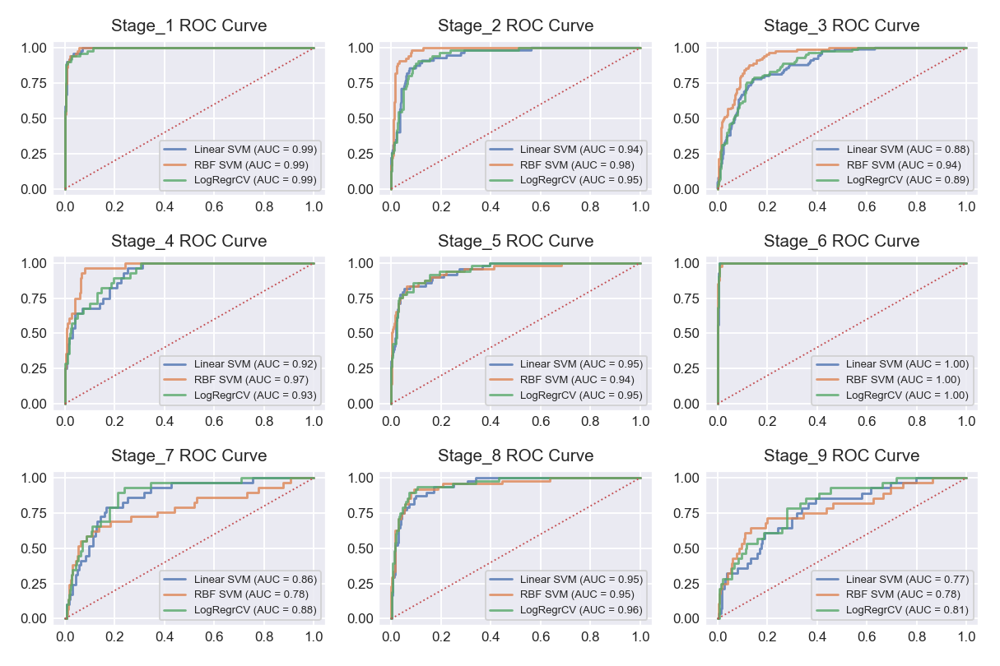

TDA dataset


<IPython.core.display.Javascript object>


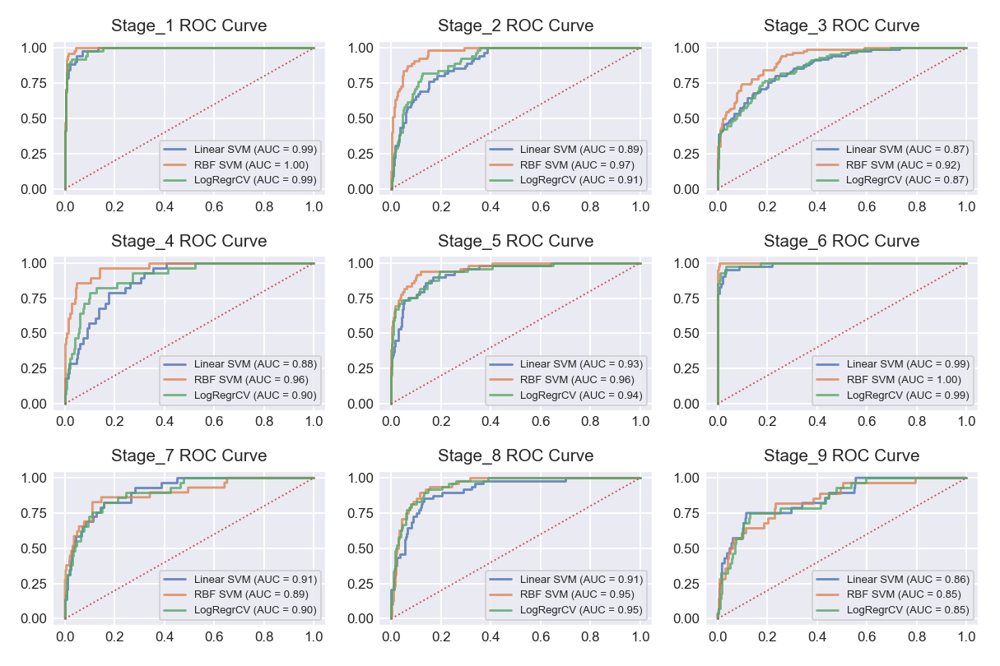

Sync_Ind dataset


<IPython.core.display.Javascript object>


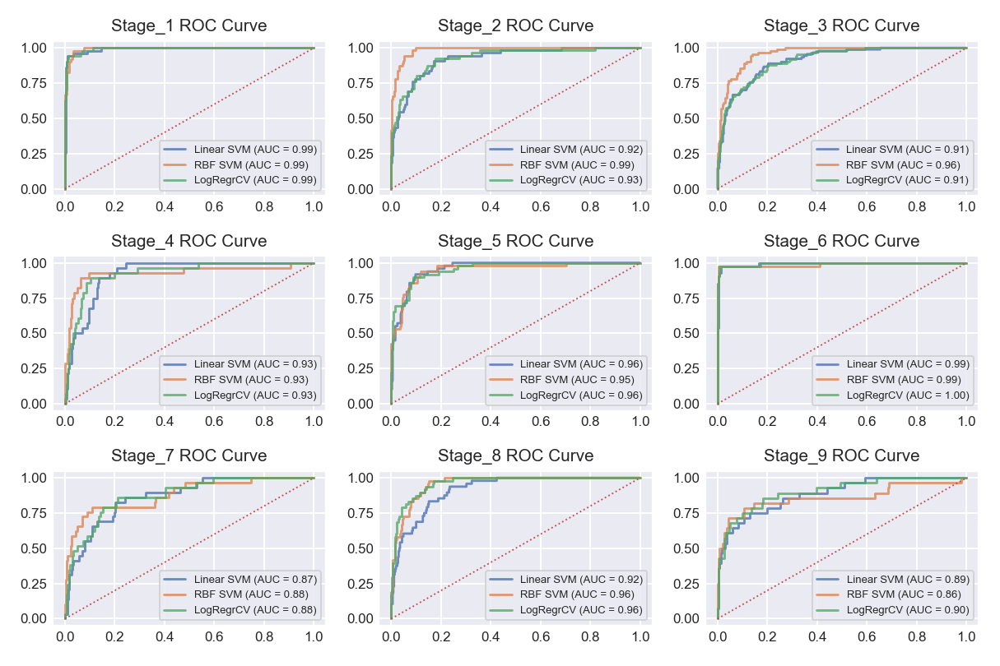

In [194]:
# Plotting ROC curves

n_cols = 3
n_rows = n_stages//3 + int(bool(n_stages%3))

for _ds in range(n_datasets):
    print(datasets[_ds] + ' dataset')
    
    fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(3*n_cols, 2*n_rows))
    plt.subplots_adjust(left=0.02)
    
    for _st in range(n_stages):
        for _mdl in range(n_models):
            RocCurveDisplay.from_predictions(y_test_st_ds[:,_st,_ds], y_prob_st_ds_mdl[:,_st,_ds,_mdl], 
                                             name=mdl_names_bin[_mdl], ax=axs[_st//n_cols, _st%n_cols], alpha=0.8)
                                                                                                          
        axs[_st//n_cols, _st%n_cols].plot([0, 1], [0, 1], linewidth=1, linestyle=":")
        axs[_st//n_cols, _st%n_cols].set_title('Stage_'+str(_st+1)+' ROC Curve', fontsize=11) 
        axs[_st//n_cols, _st%n_cols].tick_params(axis='both', labelsize=9, direction='in')#, grid_alpha=0.5)
        axs[_st//n_cols, _st%n_cols].set_xlabel(None)#"False Positive Rate", fontsize=9)
        axs[_st//n_cols, _st%n_cols].set_ylabel(None)#"True Positive Rate", fontsize=9)
        axs[_st//n_cols, _st%n_cols].legend(fontsize=7)#'x-small')
    
    plt.tight_layout()

    #handles, labels = axs[-1,-1].get_legend_handles_labels()
    #fig.suptitle('PSD in brain regions by spectrum')
    #fig.legend(handles, labels, loc='lower center', ncol=4)#, bbox_to_anchor=(0.5, -0.05))
    plt.savefig(datasets[_ds]+' ROC Curve plots.png')


Stage_1
(1046, 20)
Linear SVM F1 =  0.9
RBF SVM F1 =  0.93
LogRegrCV F1 =  0.92
Rndom Forest F1 =  0.76
XGBoost F1 =  0.87


<IPython.core.display.Javascript object>


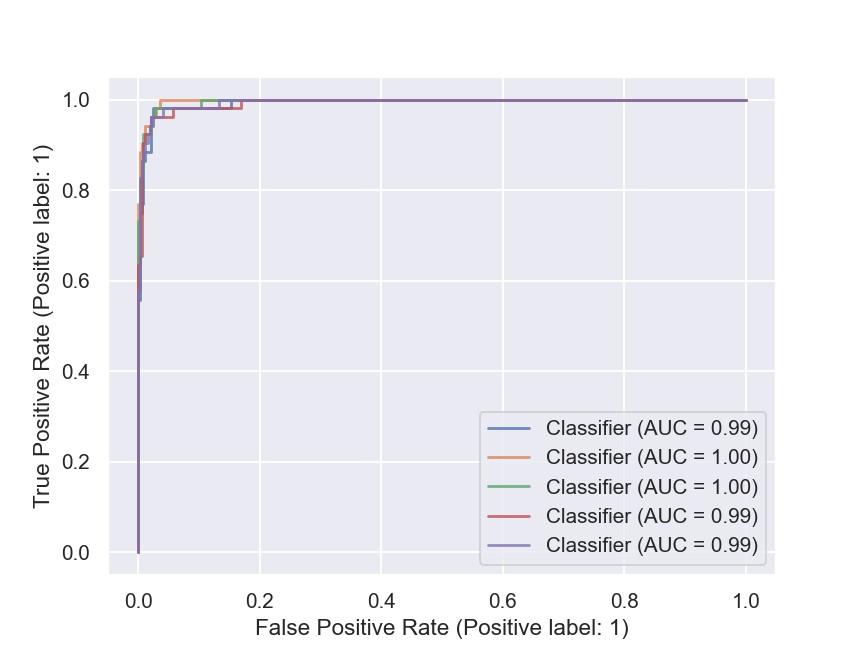

Stage_2
(1046, 17)
Linear SVM F1 =  0.7
RBF SVM F1 =  0.83
LogRegrCV F1 =  0.6
Rndom Forest F1 =  0.54
XGBoost F1 =  0.74


<IPython.core.display.Javascript object>


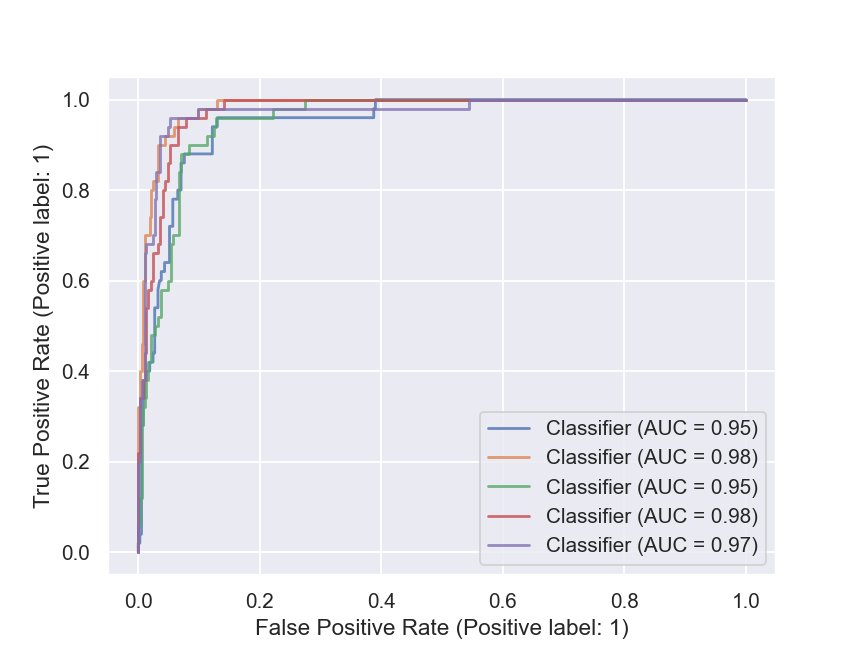

Stage_3
(1046, 12)
Linear SVM F1 =  0.57
RBF SVM F1 =  0.66
LogRegrCV F1 =  0.59
Rndom Forest F1 =  0.41
XGBoost F1 =  0.67


<IPython.core.display.Javascript object>


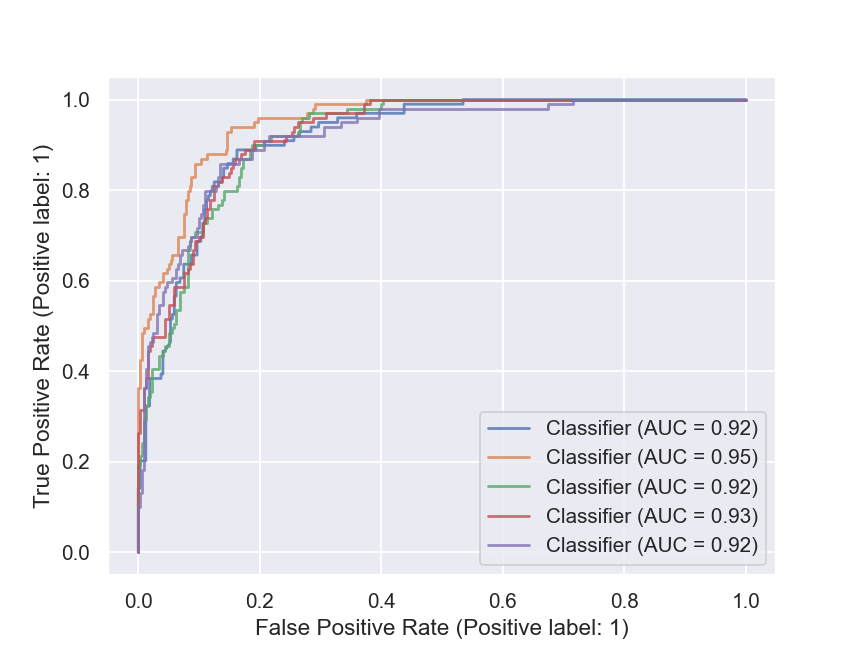

Stage_4
(1046, 21)
Linear SVM F1 =  0.49
RBF SVM F1 =  0.19
LogRegrCV F1 =  0.51
Rndom Forest F1 =  0.0
XGBoost F1 =  0.31


<IPython.core.display.Javascript object>


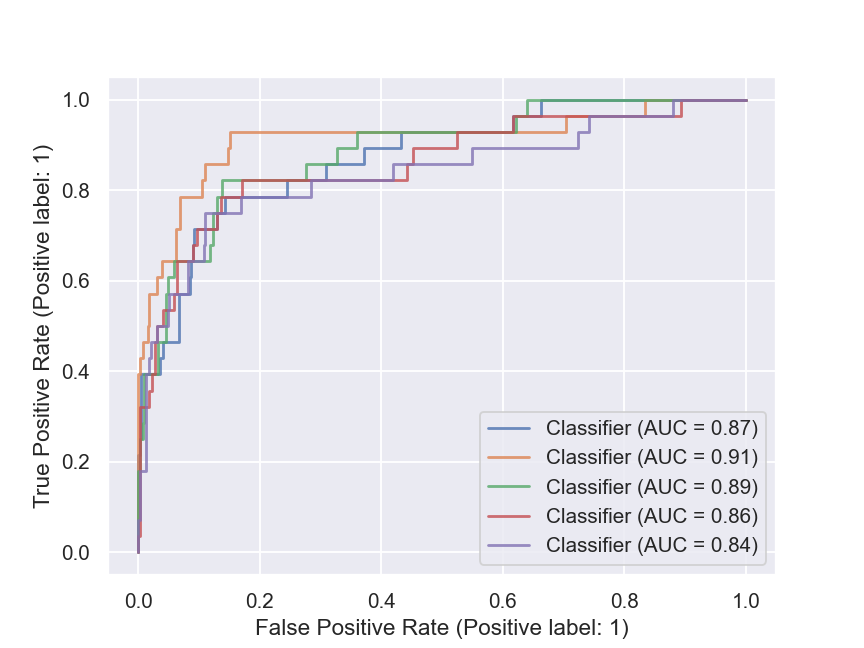

Stage_5
(1046, 21)
Linear SVM F1 =  0.78
RBF SVM F1 =  0.74
LogRegrCV F1 =  0.76
Rndom Forest F1 =  0.61
XGBoost F1 =  0.67


<IPython.core.display.Javascript object>


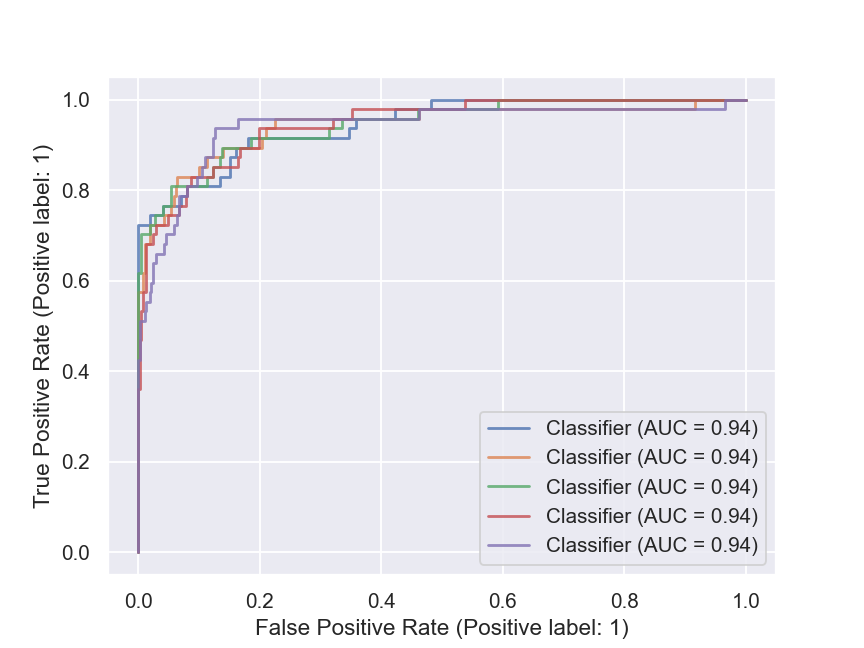

Stage_6
(1046, 19)
Linear SVM F1 =  0.89
RBF SVM F1 =  0.94
LogRegrCV F1 =  0.94
Rndom Forest F1 =  0.83
XGBoost F1 =  0.87


<IPython.core.display.Javascript object>


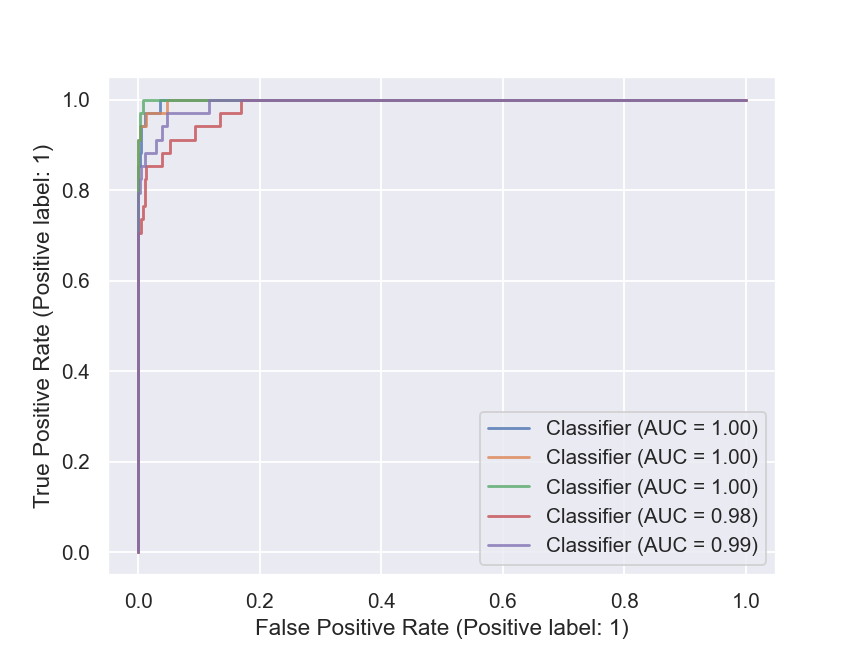

Stage_7
(1046, 15)
Linear SVM F1 =  0.0
RBF SVM F1 =  0.0
LogRegrCV F1 =  0.15
Rndom Forest F1 =  0.11
XGBoost F1 =  0.2


<IPython.core.display.Javascript object>


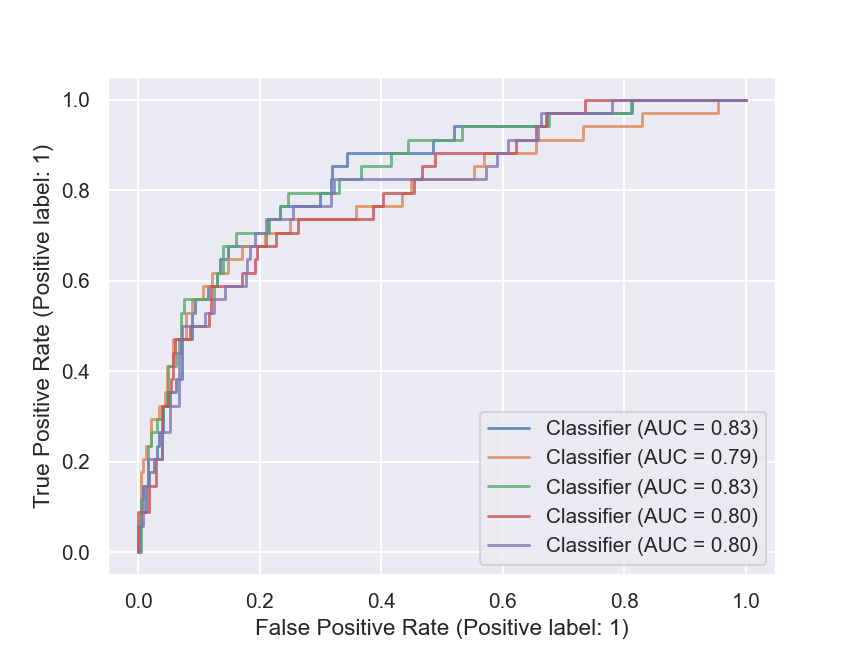

Stage_8
(1046, 19)
Linear SVM F1 =  0.62
RBF SVM F1 =  0.49
LogRegrCV F1 =  0.64
Rndom Forest F1 =  0.15
XGBoost F1 =  0.56


<IPython.core.display.Javascript object>


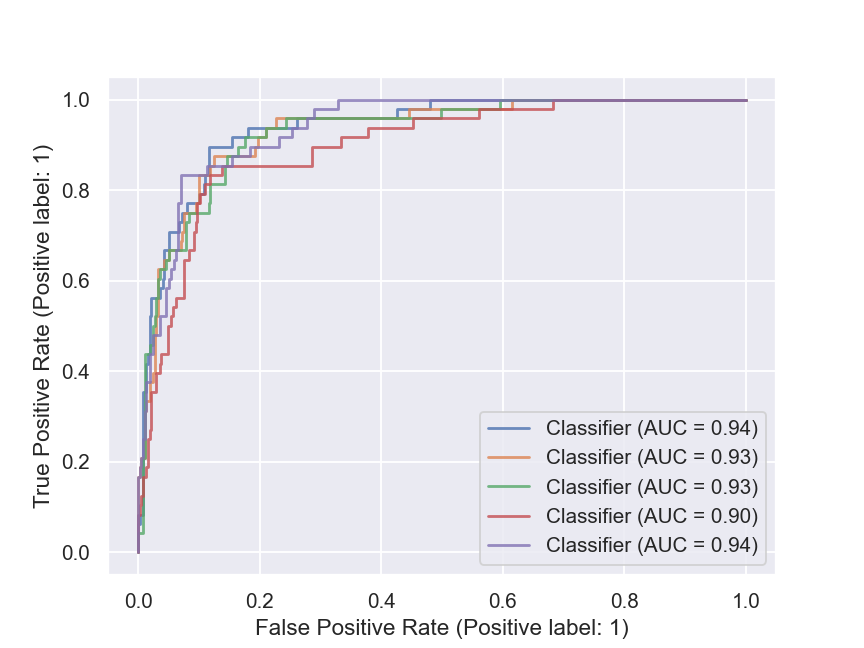

Stage_9
(1046, 15)
Linear SVM F1 =  0.0
RBF SVM F1 =  0.0
LogRegrCV F1 =  0.29
Rndom Forest F1 =  0.0
XGBoost F1 =  0.17


<IPython.core.display.Javascript object>


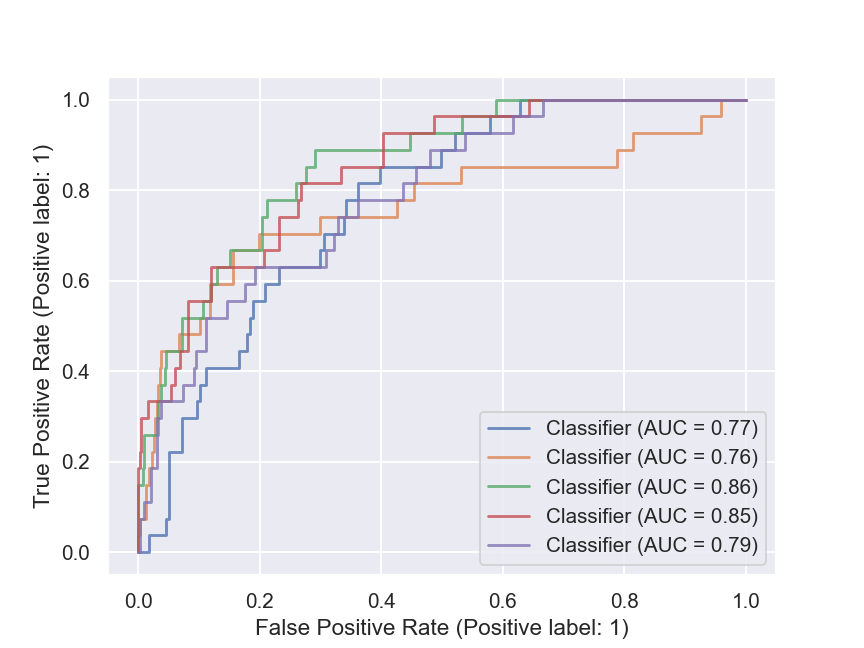

In [114]:
# Binary classification

for i in range(n_stages):
    print('Stage_' + str(i+1))
    X = df_ft_psd_pca_bin[i].to_numpy()
    print(X.shape)
    y = (new_labels==i).astype(int)
    #print(y.shape, y)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=0)
    
    clf_svc_lin = svm.SVC(kernel='linear', C=1, probability=True).fit(X_train, y_train)
    clf_svc_rbf = svm.SVC(kernel='rbf', C=1, probability=True).fit(X_train, y_train)
    #clf_lr = LogisticRegression(solver='liblinear', C=1).fit(X_train, y_train)
    clf_lrCV = LogisticRegressionCV(Cs=10, cv=5, solver='liblinear').fit(X_train, y_train)
    clf_rf = RandomForestClassifier(max_depth=6, n_estimators=1000).fit(X_train, y_train)
    clf_xgb = XGBClassifier(eval_metric='logloss', max_depth=6, n_estimators=1000).fit(X_train, y_train)

    y_pred_svc_lin = clf_svc_lin.predict(X_test)
    y_pred_svc_rbf = clf_svc_rbf.predict(X_test)
    #y_pred_lr = clf_lr.predict(X_test)
    y_pred_lrCV = clf_lrCV.predict(X_test)
    y_pred_rf = clf_rf.predict(X_test)
    y_pred_xgb = clf_xgb.predict(X_test)
    
    y_prob_svc_lin = clf_svc_lin.predict_proba(X_test)
    y_prob_svc_rbf = clf_svc_rbf.predict_proba(X_test)
    #y_prob_lr = clf_lr.predict_proba(X_test)
    y_prob_lrCV = clf_lrCV.predict_proba(X_test)
    y_prob_rf = clf_rf.predict_proba(X_test)
    y_prob_xgb = clf_xgb.predict_proba(X_test)

    
    print('Linear SVM', 'F1 = ', round(f1_score(y_test, y_pred_svc_lin), 2))
    print('RBF SVM', 'F1 = ', round(f1_score(y_test, y_pred_svc_rbf), 2))
    #print('LogRegr', 'F1 = ', round(f1_score(y_test, y_pred_lr), 2))
    print('LogRegrCV', 'F1 = ', round(f1_score(y_test, y_pred_lrCV), 2))
    print('Rndom Forest', 'F1 = ', round(f1_score(y_test, y_pred_rf), 2))
    print('XGBoost', 'F1 = ', round(f1_score(y_test, y_pred_xgb), 2))
    
    # Plotting ROC Curve
    ax = plt.figure().gca()
    
    svc_lin_disp = metrics.RocCurveDisplay.from_predictions(y_test, y_prob_svc_lin[:,1], ax=ax, alpha=0.8)
    svc_rbf_disp = metrics.RocCurveDisplay.from_predictions(y_test, y_prob_svc_rbf[:,1], ax=ax, alpha=0.8)
    #lr_disp = metrics.RocCurveDisplay.from_predictions(y_test, y_prob_lr[:,1], ax=ax, alpha=0.8)
    lrCV_disp = metrics.RocCurveDisplay.from_predictions(y_test, y_prob_lrCV[:,1], ax=ax, alpha=0.8)
    rf_disp = metrics.RocCurveDisplay.from_predictions(y_test, y_prob_rf[:,1], ax=ax, alpha=0.8)
    xgb_disp = metrics.RocCurveDisplay.from_predictions(y_test, y_prob_xgb[:,1], ax=ax, alpha=0.8)
    

# Topomap

In [32]:
print((new_labels==0).astype(int))

[1 1 1 ... 0 0 0]
